## Import all the necessary libraries and packages


In [83]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.preprocessing import StandardScaler
import seaborn as sns
import scipy
import random

In [84]:
data_train = pd.read_csv('data_train_cleaned_sbjs.csv')

In [2]:
mydata = pd.read_csv('/Users/anastasia/Dropbox/renewed_data_presleep.csv')

In [3]:
baseline_awake_df = pd.read_csv('/Users/anastasia/Dropbox/renewed_data_awake.csv')

## Normalise the data by the baseline awake thrrouhgh the z-score methos

In [4]:
baseline_awake_df = baseline_awake_df.drop(['Label', 'Age', 'ifCleanOnset', 'SleepStage', 'Time2Sleep', 'Gender', 'Race'], axis=1)

In [7]:
baseline_awake_df

,Sbj_ID,delta,theta,alpha,beta,DTratio,DAratio,DBratio,TAratio,TBratio,...,TBcouple,ABcouple,DGcouple,TGcouple,AGcouple,BGcouple,Entropy Rate LZ,Aperiodic component (spectral exponent),O-information,S-information
0,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,10,-7.880210,-7.458234,-6.470429,-5.316372,-0.421976,-1.409781,-2.563838,-0.987804,-2.141862,...,0.035960,0.034491,0.946263,0.071083,0.050498,0.032896,0.689125,0.599105,-0.048264,0.468667
2,10,-7.099018,-8.310700,-7.287799,-6.414028,1.211683,0.188782,-0.684990,-1.022901,-1.896673,...,0.056319,0.027840,0.900087,0.050377,0.068540,0.045893,0.640886,0.994026,-0.005588,0.345447
3,10,-6.912435,-8.232057,-7.686320,-6.772119,1.319622,0.773885,-0.140317,-0.545737,-1.459939,...,0.047397,0.023026,0.750739,0.065017,0.059425,0.044463,0.608727,1.000687,0.085376,0.684357
4,10,-6.917331,-7.506361,-6.220501,-5.340351,0.589030,-0.696830,-1.576980,-1.285860,-2.166010,...,0.072222,0.030058,0.590844,0.044952,0.025711,0.059180,0.546706,0.950646,0.033595,0.821478
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29045,6802,-6.576621,-6.162405,-6.000488,-5.529450,-0.414216,-0.576133,-1.047171,-0.161917,-0.632955,...,0.084721,0.031300,0.448778,0.060467,0.018877,0.027266,0.470902,1.182791,-0.004474,0.549697
29046,6802,-6.625748,-5.851030,-5.853518,-5.591575,-0.774718,-0.772230,-1.034173,0.002488,-0.259455,...,0.029080,0.031306,0.377598,0.034917,0.017868,0.031952,0.551300,1.336943,0.008449,0.159707
29047,6802,-6.892483,-6.060916,-5.775741,-5.756101,-0.831567,-1.116742,-1.136382,-0.285175,-0.304815,...,0.038864,0.028635,0.602165,0.072499,0.030715,0.030284,0.629401,1.344690,-0.025281,0.268252
29048,6802,-6.974234,-6.322688,-6.321751,-6.063000,-0.651547,-0.652484,-0.911235,-0.000937,-0.259688,...,0.046296,0.020685,0.313670,0.048354,0.040942,0.032872,0.381316,1.425784,-0.009184,0.366758


In [8]:
unique_subjects_baseline_awake = baseline_awake_df['Sbj_ID'].unique()

In [9]:
# create two new dataframes which store the mean and std of each feature for each subject

# create an empty dataframe
baseline_awake_mean_df = pd.DataFrame()
baseline_awake_std_df = pd.DataFrame()

# for each subject, calculate the mean and std of each feature and store it in the dataframe
for i in range(len(unique_subjects_baseline_awake)):
    # calculate the mean and std of each feature for each subject with 'Label' column dropped
    mean = baseline_awake_df[baseline_awake_df['Sbj_ID'] == unique_subjects_baseline_awake[i]].drop(['Sbj_ID'], axis=1).mean()
    std = baseline_awake_df[baseline_awake_df['Sbj_ID'] == unique_subjects_baseline_awake[i]].drop(['Sbj_ID'], axis=1).std()
    # concatenate the mean to the mean dataframe
    baseline_awake_mean_df = pd.concat([baseline_awake_mean_df, mean], axis=1)
    # concatenate the std to the std dataframe
    baseline_awake_std_df = pd.concat([baseline_awake_std_df, std], axis=1)

# transpose the dataframes
baseline_awake_mean_df = baseline_awake_mean_df.transpose()
baseline_awake_std_df = baseline_awake_std_df.transpose()

# add a column with subject IDs to the start of the dataframes
baseline_awake_mean_df.insert(0, 'Sbj_ID', unique_subjects_baseline_awake)
baseline_awake_std_df.insert(0, 'Sbj_ID', unique_subjects_baseline_awake)
# reset the index in both dataframes

baseline_awake_mean_df.reset_index(drop=True, inplace=True)
baseline_awake_std_df.reset_index(drop=True, inplace=True)


In [80]:
baseline_awake_mean_df

,Sbj_ID,delta,theta,alpha,beta,DTratio,DAratio,DBratio,TAratio,TBratio,...,TBcouple,ABcouple,DGcouple,TGcouple,AGcouple,BGcouple,Entropy Rate LZ,Aperiodic component (spectral exponent),O-information,S-information
0,10,-7.339644,-7.719204,-6.842264,-5.997583,0.379561,-0.497379,-1.342061,-0.876940,-1.721621,...,0.047649,0.031017,0.628398,0.049925,0.044027,0.040608,0.658935,0.997265,0.006996,0.320510
1,12,-5.831957,-5.923270,-5.963901,-6.257921,0.091313,0.131944,0.425964,0.040631,0.334651,...,0.054901,0.032427,0.415304,0.046761,0.031220,0.031128,0.380091,1.430433,0.031135,0.669028
2,54,-6.291330,-6.500105,-6.290674,-5.679531,0.208775,-0.000655,-0.611799,-0.209431,-0.820574,...,0.092110,0.041436,0.434626,0.066781,0.046833,0.043359,0.428682,1.469053,0.028135,0.681040
3,56,-7.569972,-7.022151,-6.259713,-6.253731,-0.547821,-1.310260,-1.316242,-0.762438,-0.768420,...,0.048125,0.029479,0.761802,0.038095,0.026685,0.028392,0.822418,0.917812,-0.001451,0.378155
4,77,-6.705600,-6.880075,-6.536924,-5.912540,0.174474,-0.168676,-0.793060,-0.343151,-0.967535,...,0.051029,0.029833,0.437534,0.034677,0.027127,0.027413,0.535169,1.370733,0.034882,0.499975
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
576,6739,-6.768738,-6.464908,-6.117507,-5.849572,-0.303830,-0.651231,-0.919166,-0.347401,-0.615336,...,0.047575,0.032083,0.445113,0.033402,0.028096,0.029596,0.523407,1.399572,0.046720,0.500696
577,6756,-6.273753,-6.434054,-6.349103,-5.981596,0.160301,0.075350,-0.292157,-0.084951,-0.452458,...,0.063502,0.035669,0.595204,0.063016,0.044162,0.037700,0.371840,1.334749,0.005849,0.420861
578,6786,-7.176326,-6.997546,-6.145727,-5.592308,-0.178779,-1.030599,-1.584018,-0.851819,-1.405239,...,0.047339,0.029484,0.476292,0.038483,0.024701,0.022742,0.521588,1.536340,0.029628,0.414583
579,6790,-7.697394,-7.979450,-7.324471,-5.807534,0.282056,-0.372922,-1.889860,-0.654978,-2.171916,...,0.073975,0.041070,0.559582,0.072580,0.046219,0.047644,0.565588,0.628112,0.022043,0.570098


In [81]:
baseline_awake_mean_df.isnull().sum().sort_values(ascending=False)

Sbj_ID                                0
gammapeak                             0
DN_OutlierInclude_n_001_mdrmd         0
SP_Summaries_welch_rect_area_5_1      0
SB_BinaryStats_diff_longstretch0      0
                                     ..
MD_hrv_classic_pnn40                  0
SB_BinaryStats_mean_longstretch1      0
SB_TransitionMatrix_3ac_sumdiagcov    0
PD_PeriodicityWang_th0_01             0
S-information                         0
Length: 63, dtype: int64

In [82]:
baseline_awake_std_df

,Sbj_ID,delta,theta,alpha,beta,DTratio,DAratio,DBratio,TAratio,TBratio,...,TBcouple,ABcouple,DGcouple,TGcouple,AGcouple,BGcouple,Entropy Rate LZ,Aperiodic component (spectral exponent),O-information,S-information
0,10,0.352050,0.725766,0.697624,0.629067,0.679882,0.735179,0.705920,0.301394,0.360633,...,0.015106,0.008798,0.117708,0.016134,0.014013,0.009676,0.107206,0.208969,0.032577,0.249296
1,12,0.504113,0.754979,0.770167,0.529326,0.359887,0.450488,0.493549,0.304870,0.543797,...,0.023985,0.013251,0.163899,0.015904,0.010574,0.013855,0.123872,0.304761,0.077082,0.356541
2,54,0.365553,0.356403,0.354163,0.297677,0.302161,0.296619,0.355046,0.268496,0.260526,...,0.021275,0.009236,0.097359,0.015957,0.011267,0.011346,0.105078,0.203442,0.051685,0.344472
3,56,0.225300,0.781504,0.808680,0.730936,0.824281,0.849133,0.745995,0.275797,0.415163,...,0.015768,0.008694,0.144945,0.014331,0.008573,0.007593,0.077797,0.127694,0.008852,0.112800
4,77,0.513552,0.531529,0.611924,0.466424,0.546945,0.726882,0.589081,0.410073,0.363340,...,0.019953,0.013322,0.134998,0.015012,0.013951,0.009841,0.133749,0.199591,0.057877,0.419791
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
576,6739,0.487761,0.495273,0.476085,0.414489,0.534797,0.601605,0.567049,0.239122,0.292306,...,0.015018,0.011821,0.177978,0.010399,0.008668,0.011605,0.102059,0.116978,0.066370,0.336811
577,6756,0.528198,0.592060,0.560289,0.482610,0.410475,0.608714,0.644349,0.339223,0.476203,...,0.026736,0.011148,0.199856,0.027587,0.016926,0.010859,0.135549,0.201976,0.051961,0.294062
578,6786,0.436764,0.510295,0.564095,0.321938,0.376276,0.573080,0.521861,0.343374,0.406181,...,0.016810,0.007446,0.164052,0.014249,0.007727,0.008110,0.087690,0.206269,0.053322,0.284325
579,6790,0.729492,1.109559,1.137894,0.918651,1.068425,1.275651,1.302059,0.470511,0.908597,...,0.033946,0.018077,0.212166,0.037232,0.020183,0.018509,0.128395,0.334318,0.046452,0.384420


In [83]:
baseline_awake_std_df.isnull().sum().sort_values(ascending=False)

Sbj_ID                                0
gammapeak                             0
DN_OutlierInclude_n_001_mdrmd         0
SP_Summaries_welch_rect_area_5_1      0
SB_BinaryStats_diff_longstretch0      0
                                     ..
MD_hrv_classic_pnn40                  0
SB_BinaryStats_mean_longstretch1      0
SB_TransitionMatrix_3ac_sumdiagcov    0
PD_PeriodicityWang_th0_01             0
S-information                         0
Length: 63, dtype: int64

In [84]:
# Create a list of unique subject IDs
unique_subjects_baseline_awake = baseline_awake_df['Sbj_ID'].unique()
len(unique_subjects_baseline_awake)

581

In [85]:

mesa_meta = pd.read_csv('/Users/anastasia/Dropbox/mesa-sleep-dataset-0.3.0.csv')

In [86]:
# keep only the subjects (Sbj_ID) that are in the baseline awake dataframe
mydata_normalised_raw = mydata[mydata['Sbj_ID'].isin(unique_subjects_baseline_awake)].copy()


mydata_normalised_raw

,Label,Sbj_ID,Age,Gender,Race,ifCleanOnset,Time2Sleep,SleepStage,delta,theta,...,TBcouple,ABcouple,DGcouple,TGcouple,AGcouple,BGcouple,Entropy Rate LZ,Aperiodic component (spectral exponent),O-information,S-information
0,29.9,10,57,1,1,1,45.0,0,-7.057621,-7.229645,...,0.038993,0.032880,0.293172,0.032609,0.026494,0.033419,0.636292,1.054124,0.007348,0.148436
1,29.8,10,57,1,1,1,45.0,0,-7.324744,-7.808482,...,0.035543,0.023140,0.445740,0.042902,0.035049,0.028911,0.785603,1.177602,-0.001066,0.048745
2,29.7,10,57,1,1,1,45.0,0,-7.438069,-7.372849,...,0.047497,0.021870,0.392344,0.036021,0.029234,0.023586,0.748849,1.195247,0.002069,0.216630
3,29.6,10,57,1,1,1,45.0,0,-7.689482,-7.599893,...,0.027150,0.029555,0.382305,0.059697,0.043319,0.034437,0.746552,1.202218,-0.002163,0.107017
4,29.5,10,57,1,1,1,45.0,0,-7.357161,-7.204591,...,0.043488,0.017912,0.410618,0.044554,0.026695,0.017321,0.783306,1.309472,-0.005458,0.174918
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
174295,0.4,6802,65,0,3,0,89.0,1,-7.208392,-6.523454,...,0.045737,0.026788,0.305682,0.030667,0.017449,0.013536,0.560488,1.413783,-0.055688,0.462334
174296,0.3,6802,65,0,3,0,89.0,1,-7.878968,-7.314247,...,0.030835,0.029769,0.556316,0.015763,0.016855,0.018704,0.643183,1.432267,-0.013944,0.208699
174297,0.2,6802,65,0,3,0,89.0,1,-6.722933,-6.648259,...,0.027342,0.026939,0.543508,0.034203,0.038288,0.029619,0.509953,1.763482,-0.018636,0.844000
174298,0.1,6802,65,0,3,0,89.0,1,-7.010732,-7.105529,...,0.042381,0.019829,0.491535,0.038381,0.008979,0.006879,0.583459,1.460434,-0.024232,0.287681


In [87]:
mydata_normalised = mydata_normalised_raw.copy()

In [88]:
# find the index of delta_power
delta_index = mydata_normalised_raw.columns.get_loc('delta')

In [89]:
# Get the mean and std dataframes as a dictionary for quick access
mean_dict = baseline_awake_mean_df.set_index('Sbj_ID').T.to_dict('list')
std_dict = baseline_awake_std_df.set_index('Sbj_ID').T.to_dict('list')

# Get columns starting from delta_index
cols = mydata_normalised_raw.columns[delta_index:]

# Perform operations on the entire dataframe
for sbj in unique_subjects_baseline_awake:
    print('Normalising subject ' + str(sbj))

    # Get the mean and std for the current subject
    mean = np.array(mean_dict[sbj])
    std = np.array(std_dict[sbj])

    # Get a boolean mask of the rows that match the current subject
    mask = mydata_normalised_raw['Sbj_ID'] == sbj

    # Check if std is zero and assign 0 to normalized values; otherwise perform normalization
    std_nonzero = std != 0
    normalized_values = (mydata_normalised_raw.loc[mask, cols] - mean) / np.where(std_nonzero, std, 1)
    normalized_values = np.where(std_nonzero, normalized_values, 0)

    mydata_normalised.loc[mask, cols] = normalized_values

Normalising subject 10
Normalising subject 12
Normalising subject 54
Normalising subject 56
Normalising subject 77
Normalising subject 99
Normalising subject 105
Normalising subject 107
Normalising subject 110
Normalising subject 125
Normalising subject 140
Normalising subject 159
Normalising subject 188
Normalising subject 193
Normalising subject 195
Normalising subject 219
Normalising subject 220
Normalising subject 271
Normalising subject 284
Normalising subject 285
Normalising subject 288
Normalising subject 323
Normalising subject 332
Normalising subject 363
Normalising subject 381
Normalising subject 382
Normalising subject 384
Normalising subject 392
Normalising subject 399
Normalising subject 405
Normalising subject 416
Normalising subject 419
Normalising subject 458
Normalising subject 459
Normalising subject 460
Normalising subject 464
Normalising subject 485
Normalising subject 490
Normalising subject 491
Normalising subject 499
Normalising subject 518
Normalising subject 51

In [90]:
mydata_normalised_raw

,Label,Sbj_ID,Age,Gender,Race,ifCleanOnset,Time2Sleep,SleepStage,delta,theta,...,TBcouple,ABcouple,DGcouple,TGcouple,AGcouple,BGcouple,Entropy Rate LZ,Aperiodic component (spectral exponent),O-information,S-information
0,29.9,10,57,1,1,1,45.0,0,-7.057621,-7.229645,...,0.038993,0.032880,0.293172,0.032609,0.026494,0.033419,0.636292,1.054124,0.007348,0.148436
1,29.8,10,57,1,1,1,45.0,0,-7.324744,-7.808482,...,0.035543,0.023140,0.445740,0.042902,0.035049,0.028911,0.785603,1.177602,-0.001066,0.048745
2,29.7,10,57,1,1,1,45.0,0,-7.438069,-7.372849,...,0.047497,0.021870,0.392344,0.036021,0.029234,0.023586,0.748849,1.195247,0.002069,0.216630
3,29.6,10,57,1,1,1,45.0,0,-7.689482,-7.599893,...,0.027150,0.029555,0.382305,0.059697,0.043319,0.034437,0.746552,1.202218,-0.002163,0.107017
4,29.5,10,57,1,1,1,45.0,0,-7.357161,-7.204591,...,0.043488,0.017912,0.410618,0.044554,0.026695,0.017321,0.783306,1.309472,-0.005458,0.174918
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
174295,0.4,6802,65,0,3,0,89.0,1,-7.208392,-6.523454,...,0.045737,0.026788,0.305682,0.030667,0.017449,0.013536,0.560488,1.413783,-0.055688,0.462334
174296,0.3,6802,65,0,3,0,89.0,1,-7.878968,-7.314247,...,0.030835,0.029769,0.556316,0.015763,0.016855,0.018704,0.643183,1.432267,-0.013944,0.208699
174297,0.2,6802,65,0,3,0,89.0,1,-6.722933,-6.648259,...,0.027342,0.026939,0.543508,0.034203,0.038288,0.029619,0.509953,1.763482,-0.018636,0.844000
174298,0.1,6802,65,0,3,0,89.0,1,-7.010732,-7.105529,...,0.042381,0.019829,0.491535,0.038381,0.008979,0.006879,0.583459,1.460434,-0.024232,0.287681


In [91]:
mydata_normalised

,Label,Sbj_ID,Age,Gender,Race,ifCleanOnset,Time2Sleep,SleepStage,delta,theta,...,TBcouple,ABcouple,DGcouple,TGcouple,AGcouple,BGcouple,Entropy Rate LZ,Aperiodic component (spectral exponent),O-information,S-information
0,29.9,10,57,1,1,1,45.0,0,0.801086,0.674541,...,-0.572997,0.211761,-2.847936,-1.073235,-1.251211,-0.742995,-0.211208,0.272095,0.010790,-0.690242
1,29.8,10,57,1,1,1,45.0,0,0.042321,-0.123012,...,-0.801385,-0.895290,-1.551783,-0.435301,-0.640704,-1.208823,1.181538,0.862982,-0.247495,-1.090130
2,29.7,10,57,1,1,1,45.0,0,-0.279577,0.477228,...,-0.010044,-1.039752,-2.005411,-0.861775,-1.055667,-1.759121,0.838709,0.947424,-0.151267,-0.416695
3,29.6,10,57,1,1,1,45.0,0,-0.993719,0.164394,...,-1.357015,-0.166221,-2.090705,0.605650,-0.050484,-0.637765,0.817282,0.980783,-0.281153,-0.856383
4,29.5,10,57,1,1,1,45.0,0,-0.049759,0.709062,...,-0.275473,-1.489585,-1.850164,-0.332884,-1.236847,-2.406616,1.160112,1.494034,-0.382312,-0.584014
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
174295,0.4,6802,65,0,3,0,89.0,1,-0.372248,0.650788,...,-0.360391,-0.492787,-0.600156,-0.272777,-1.008631,-1.915632,-1.229827,2.161910,-1.133706,0.371261
174296,0.3,6802,65,0,3,0,89.0,1,-2.728401,-0.399959,...,-1.180100,-0.219907,1.727829,-1.400954,-1.081934,-1.414636,-0.657371,2.230786,0.376823,-0.847272
174297,0.2,6802,65,0,3,0,89.0,1,1.333475,0.484957,...,-1.372215,-0.479013,1.608868,-0.005103,1.565531,-0.356673,-1.579662,3.465000,0.207022,2.204892
174298,0.1,6802,65,0,3,0,89.0,1,0.322255,-0.122630,...,-0.544981,-1.129931,1.126121,0.311136,-2.054847,-2.560816,-1.070812,2.335744,0.004548,-0.467819


In [92]:
mydata.isnull().sum().sort_values(ascending=False)

SB_TransitionMatrix_3ac_sumdiagcov             23013
SC_FluctAnal_2_rsrangefit_50_1_logi_prop_r1    23013
GBratio                                        23013
GAration                                       23013
gamma                                          23013
                                               ...  
Sbj_ID                                             0
ifCleanOnset                                       0
Time2Sleep                                         0
SleepStage                                         0
Label                                              0
Length: 70, dtype: int64

In [93]:
mydata_normalised.isnull().sum().sort_values(ascending=False)

SB_TransitionMatrix_3ac_sumdiagcov         23013
GDratio                                    23013
IN_AutoMutualInfoStats_40_gaussian_fmmi    23013
DN_OutlierInclude_p_001_mdrmd              23013
DN_OutlierInclude_n_001_mdrmd              23013
                                           ...  
ifCleanOnset                                   0
Race                                           0
Gender                                         0
Age                                            0
Label                                          0
Length: 70, dtype: int64

In [94]:
missing_mask_normalised = mydata_normalised.isnull().sum(axis=1).astype(bool).astype(int)

missing_mask_normalised.sum()

23013

In [95]:
# Drop rows with missing values
mydata_normalised_no_nans = mydata_normalised.copy()
mydata_normalised_no_nans.dropna(inplace=True)

In [96]:
mydata_normalised_no_nans

,Label,Sbj_ID,Age,Gender,Race,ifCleanOnset,Time2Sleep,SleepStage,delta,theta,...,TBcouple,ABcouple,DGcouple,TGcouple,AGcouple,BGcouple,Entropy Rate LZ,Aperiodic component (spectral exponent),O-information,S-information
0,29.9,10,57,1,1,1,45.0,0,0.801086,0.674541,...,-0.572997,0.211761,-2.847936,-1.073235,-1.251211,-0.742995,-0.211208,0.272095,0.010790,-0.690242
1,29.8,10,57,1,1,1,45.0,0,0.042321,-0.123012,...,-0.801385,-0.895290,-1.551783,-0.435301,-0.640704,-1.208823,1.181538,0.862982,-0.247495,-1.090130
2,29.7,10,57,1,1,1,45.0,0,-0.279577,0.477228,...,-0.010044,-1.039752,-2.005411,-0.861775,-1.055667,-1.759121,0.838709,0.947424,-0.151267,-0.416695
3,29.6,10,57,1,1,1,45.0,0,-0.993719,0.164394,...,-1.357015,-0.166221,-2.090705,0.605650,-0.050484,-0.637765,0.817282,0.980783,-0.281153,-0.856383
4,29.5,10,57,1,1,1,45.0,0,-0.049759,0.709062,...,-0.275473,-1.489585,-1.850164,-0.332884,-1.236847,-2.406616,1.160112,1.494034,-0.382312,-0.584014
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
174295,0.4,6802,65,0,3,0,89.0,1,-0.372248,0.650788,...,-0.360391,-0.492787,-0.600156,-0.272777,-1.008631,-1.915632,-1.229827,2.161910,-1.133706,0.371261
174296,0.3,6802,65,0,3,0,89.0,1,-2.728401,-0.399959,...,-1.180100,-0.219907,1.727829,-1.400954,-1.081934,-1.414636,-0.657371,2.230786,0.376823,-0.847272
174297,0.2,6802,65,0,3,0,89.0,1,1.333475,0.484957,...,-1.372215,-0.479013,1.608868,-0.005103,1.565531,-0.356673,-1.579662,3.465000,0.207022,2.204892
174298,0.1,6802,65,0,3,0,89.0,1,0.322255,-0.122630,...,-0.544981,-1.129931,1.126121,0.311136,-2.054847,-2.560816,-1.070812,2.335744,0.004548,-0.467819


## Attach metadata to the data ##

In [97]:
# in mesa meta, only leave the subjects that are in unique subjects in mydata
unique_subjects_norm = mydata_normalised_no_nans['Sbj_ID'].unique()
mesa_meta_cleaned_norm= mesa_meta[mesa_meta['mesaid'].isin(unique_subjects_norm)].copy()

In [98]:
# Only leave the following columns in mesa_meta_cleaned: 'wkdaysleepdur5t', 
# 'wkendsleepdur5t', 'nap5', 'trbleslpng5', 'splngpills5', 'sleepy5', 'slpapnea5', 'legdscmfrt', 'rubbnglgs5'
# 'wrserest5', 'wrseltr5', 'slpapnea5', 'cpap5', 'dntaldv5', 'uvula5', 'insmnia5', 'rstlesslgs5', 'whiirsc5c', 
# 'epsipscl5c', 'hoostmeq5c'

mesa_meta_cleaned_norm = mesa_meta_cleaned_norm[['mesaid', 'nap5', 'trbleslpng5', 'slpngpills5', 'sleepy5', 'legsdscmfrt5', 'rubbnglgs5', 'wrserest5', 'wrseltr5', 'slpapnea5', 'cpap5', 'dntaldv5', 'uvula5', 'insmnia5', 'rstlesslgs5', 'whiirs5c', 'epslpscl5c', 'hoostmeq5c']].copy()

In [99]:
mesa_meta_cleaned_norm.isnull().sum()

mesaid            0
nap5             16
trbleslpng5       4
slpngpills5       4
sleepy5           4
legsdscmfrt5      3
rubbnglgs5      295
wrserest5       295
wrseltr5        295
slpapnea5         4
cpap5             4
dntaldv5          4
uvula5            4
insmnia5          5
rstlesslgs5       6
whiirs5c          8
epslpscl5c        5
hoostmeq5c        8
dtype: int64

In [100]:
# Show the range of values for each column in mesa_meta_cleaned_norm 
for col in mesa_meta_cleaned_norm.columns:
    if col != 'mesaid':
        print(col, mesa_meta_cleaned_norm[col].unique())



nap5 [ 1.  0. nan]
trbleslpng5 [ 5.  2.  3.  1.  4. nan]
slpngpills5 [ 1.  5.  4.  3. nan  2.]
sleepy5 [ 2.  3.  1.  4.  5. nan]
legsdscmfrt5 [ 1.  0.  9. nan]
rubbnglgs5 [ 1.  9. nan  0.]
wrserest5 [ 0.  9.  1. nan]
wrseltr5 [ 1.  9. nan  0.]
slpapnea5 [ 1.  0. nan]
cpap5 [ 0.  1. nan]
dntaldv5 [ 0. nan  1.]
uvula5 [ 0. nan  1.]
insmnia5 [ 0. nan  1.]
rstlesslgs5 [ 0.  1. nan]
whiirs5c [18.  8.  9.  7.  4. 13.  5. 10.  6. 11.  1.  3. 16.  2. nan 12. 15.  0.
 14. 17. 19. 20.]
epslpscl5c [ 7.  4.  3.  2.  0.  8. 13.  5. 10. 17.  6. 20.  9.  1. 16. nan 14. 11.
 12. 19. 18. 15. 21.]
hoostmeq5c [16. 18. 17. 23. 15. 19. 22. 20. 21. 11. 12. nan 10. 13. 24. 14. 25.  7.
  8.  9.]


In [101]:
# for all columns apart from whiirs5c epslpscl5c hoostmeq5c, replace nans with -1
mesa_meta_cleaned_norm['nap5'].fillna(-1, inplace=True)
mesa_meta_cleaned_norm['trbleslpng5'].fillna(-1, inplace=True)
mesa_meta_cleaned_norm['slpngpills5'].fillna(-1, inplace=True)
mesa_meta_cleaned_norm['sleepy5'].fillna(-1, inplace=True)
mesa_meta_cleaned_norm['legsdscmfrt5'].fillna(-1, inplace=True)
mesa_meta_cleaned_norm['rubbnglgs5'].fillna(-1, inplace=True)
mesa_meta_cleaned_norm['wrserest5'].fillna(-1, inplace=True)
mesa_meta_cleaned_norm['wrseltr5'].fillna(-1, inplace=True)
mesa_meta_cleaned_norm['slpapnea5'].fillna(-1, inplace=True)
mesa_meta_cleaned_norm['cpap5'].fillna(-1, inplace=True)
mesa_meta_cleaned_norm['dntaldv5'].fillna(-1, inplace=True)
mesa_meta_cleaned_norm['uvula5'].fillna(-1, inplace=True)
mesa_meta_cleaned_norm['insmnia5'].fillna(-1, inplace=True)
mesa_meta_cleaned_norm['rstlesslgs5'].fillna(-1, inplace=True)

# for whiirs5c epslpscl5c hoostmeq5c, replace nans with -100
mesa_meta_cleaned_norm['whiirs5c'].fillna(-100, inplace=True)
mesa_meta_cleaned_norm['epslpscl5c'].fillna(-100, inplace=True)
mesa_meta_cleaned_norm['hoostmeq5c'].fillna(-100, inplace=True)


In [102]:
# make a list of categorical columns
categorical_columns = ['nap5', 'trbleslpng5', 'slpngpills5', 'sleepy5', 'legsdscmfrt5', 'rubbnglgs5', 'wrserest5', 'wrseltr5', 'slpapnea5', 'cpap5', 'dntaldv5', 'uvula5', 'insmnia5', 'rstlesslgs5', 'whiirs5c', 'epslpscl5c', 'hoostmeq5c']

In [103]:
# for each subject in mydata, find the corresponding mesa_meta_cleaned row and add the mesa_meta_cleaned columns to mydata for all datapoints for this subject without map

mydata_normalised_no_nans['nap5'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['nap5'])))
mydata_normalised_no_nans['trbleslpng5'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['trbleslpng5'])))
mydata_normalised_no_nans['slpngpills5'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['slpngpills5'])))
mydata_normalised_no_nans['sleepy5'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['sleepy5'])))
mydata_normalised_no_nans['legsdscmfrt5'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['legsdscmfrt5'])))
mydata_normalised_no_nans['rubbnglgs5'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['rubbnglgs5'])))
mydata_normalised_no_nans['wrserest5'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['wrserest5'])))
mydata_normalised_no_nans['wrseltr5'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['wrseltr5'])))
mydata_normalised_no_nans['slpapnea5'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['slpapnea5'])))
mydata_normalised_no_nans['cpap5'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['cpap5'])))
mydata_normalised_no_nans['dntaldv5'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['dntaldv5'])))
mydata_normalised_no_nans['uvula5'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['uvula5'])))
mydata_normalised_no_nans['insmnia5'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['insmnia5'])))
mydata_normalised_no_nans['rstlesslgs5'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['rstlesslgs5'])))
mydata_normalised_no_nans['whiirs5c'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['whiirs5c'])))
mydata_normalised_no_nans['epslpscl5c'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['epslpscl5c'])))
mydata_normalised_no_nans['hoostmeq5c'] = mydata_normalised_no_nans['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['hoostmeq5c'])))

mydata_normalised_no_nans


,Label,Sbj_ID,Age,Gender,Race,ifCleanOnset,Time2Sleep,SleepStage,delta,theta,...,wrseltr5,slpapnea5,cpap5,dntaldv5,uvula5,insmnia5,rstlesslgs5,whiirs5c,epslpscl5c,hoostmeq5c
0,29.9,10,57,1,1,1,45.0,0,0.801086,0.674541,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,18.0,7.0,16.0
1,29.8,10,57,1,1,1,45.0,0,0.042321,-0.123012,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,18.0,7.0,16.0
2,29.7,10,57,1,1,1,45.0,0,-0.279577,0.477228,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,18.0,7.0,16.0
3,29.6,10,57,1,1,1,45.0,0,-0.993719,0.164394,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,18.0,7.0,16.0
4,29.5,10,57,1,1,1,45.0,0,-0.049759,0.709062,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,18.0,7.0,16.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
174295,0.4,6802,65,0,3,0,89.0,1,-0.372248,0.650788,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,13.0
174296,0.3,6802,65,0,3,0,89.0,1,-2.728401,-0.399959,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,13.0
174297,0.2,6802,65,0,3,0,89.0,1,1.333475,0.484957,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,13.0
174298,0.1,6802,65,0,3,0,89.0,1,0.322255,-0.122630,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,13.0


In [104]:
# let's relocate all the columns after Gender to go after Age

# get the index of Gender
a = mydata_normalised_no_nans.columns.get_loc('Gender')

# get the index of Age
b = mydata_normalised_no_nans.columns.get_loc('Age')

# get the list of columns
cols = list(mydata_normalised_no_nans.columns)

# reidex the list of columns usign reindex()

cols = cols[:b+1] + cols[a:] + cols[b+1:a]

# reindex the dataframe using reindex()
mydata_normalised_no_nans= mydata_normalised_no_nans.reindex(columns = cols)

mydata_normalised_no_nans

,Label,Sbj_ID,Age,Gender,Race,ifCleanOnset,Time2Sleep,SleepStage,delta,theta,...,wrseltr5,slpapnea5,cpap5,dntaldv5,uvula5,insmnia5,rstlesslgs5,whiirs5c,epslpscl5c,hoostmeq5c
0,29.9,10,57,1,1,1,45.0,0,0.801086,0.674541,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,18.0,7.0,16.0
1,29.8,10,57,1,1,1,45.0,0,0.042321,-0.123012,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,18.0,7.0,16.0
2,29.7,10,57,1,1,1,45.0,0,-0.279577,0.477228,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,18.0,7.0,16.0
3,29.6,10,57,1,1,1,45.0,0,-0.993719,0.164394,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,18.0,7.0,16.0
4,29.5,10,57,1,1,1,45.0,0,-0.049759,0.709062,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,18.0,7.0,16.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
174295,0.4,6802,65,0,3,0,89.0,1,-0.372248,0.650788,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,13.0
174296,0.3,6802,65,0,3,0,89.0,1,-2.728401,-0.399959,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,13.0
174297,0.2,6802,65,0,3,0,89.0,1,1.333475,0.484957,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,13.0
174298,0.1,6802,65,0,3,0,89.0,1,0.322255,-0.122630,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,13.0


In [105]:
# reindex the rows to be from 0 until the end
mydata_normalised_no_nans.index = range(len(mydata_normalised_no_nans))

In [106]:
# Perform ordinal encoding on the categorical variables (from 'nap5' to 'hoostmeq5c')

# import the OrdinalEncoder
from sklearn.preprocessing import OrdinalEncoder

# create an instance of the OrdinalEncoder
encoder = OrdinalEncoder()

# fit the encoder on the categorical columns
encoder.fit(mydata_normalised_no_nans[['trbleslpng5', 'slpngpills5', 'sleepy5', 'whiirs5c', 'epslpscl5c', 'hoostmeq5c']])
# make a deep copy of the dataframe
mydata_normalised_preprocessed = mydata_normalised_no_nans.copy()

# transform the categorical columns
mydata_normalised_preprocessed[['trbleslpng5', 'slpngpills5', 'sleepy5',  'whiirs5c', 'epslpscl5c', 'hoostmeq5c']] = encoder.transform(mydata_normalised_no_nans[['trbleslpng5', 'slpngpills5', 'sleepy5', 'whiirs5c', 'epslpscl5c', 'hoostmeq5c']])
mydata_normalised_preprocessed.isnull().sum()







Label          0
Sbj_ID         0
Age            0
Gender         0
Race           0
              ..
insmnia5       0
rstlesslgs5    0
whiirs5c       0
epslpscl5c     0
hoostmeq5c     0
Length: 87, dtype: int64

In [107]:
# Do one-hot-encoding for 'Race' and 'Gender'

# import the OneHotEncoder
from sklearn.preprocessing import OneHotEncoder

# create an instance of the OneHotEncoder
encoder_one_hot = OneHotEncoder(sparse_output=False)

# fit the encoder on the categorical columns
#encoder_one_hot.fit(mydata_normalised_preprocessed[[ 'Gender', 'nap5', 'legsdscmfrt5', 'rubbnglgs5', 'wrserest5', 'wrseltr5', 'slpapnea5', 'cpap5', 'dntaldv5', 'uvula5', 'insmnia5', 'rstlesslgs5']])
encoder_one_hot.fit(mydata_normalised_preprocessed[['Race']])
mydata_normalised_preprocessed_one_hot = mydata_normalised_preprocessed.copy()

# transform the categorical columns
transformed = encoder_one_hot.transform(mydata_normalised_preprocessed[['Race']])
len(transformed)


151287

In [108]:
mydata_normalised_preprocessed_one_hot = mydata_normalised_preprocessed.copy()
mydata_normalised_preprocessed_one_hot

,Label,Sbj_ID,Age,Gender,Race,ifCleanOnset,Time2Sleep,SleepStage,delta,theta,...,wrseltr5,slpapnea5,cpap5,dntaldv5,uvula5,insmnia5,rstlesslgs5,whiirs5c,epslpscl5c,hoostmeq5c
0,29.9,10,57,1,1,1,45.0,0,0.801086,0.674541,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
1,29.8,10,57,1,1,1,45.0,0,0.042321,-0.123012,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
2,29.7,10,57,1,1,1,45.0,0,-0.279577,0.477228,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
3,29.6,10,57,1,1,1,45.0,0,-0.993719,0.164394,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
4,29.5,10,57,1,1,1,45.0,0,-0.049759,0.709062,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151282,0.4,6802,65,0,3,0,89.0,1,-0.372248,0.650788,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
151283,0.3,6802,65,0,3,0,89.0,1,-2.728401,-0.399959,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
151284,0.2,6802,65,0,3,0,89.0,1,1.333475,0.484957,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
151285,0.1,6802,65,0,3,0,89.0,1,0.322255,-0.122630,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0


In [109]:
# reindex the normalised dataframe using reindex()
mydata_normalised_preprocessed_one_hot = mydata_normalised_preprocessed_one_hot.reindex(columns = cols)

In [110]:
mydata_normalised_preprocessed_one_hot

,Label,Sbj_ID,Age,Gender,Race,ifCleanOnset,Time2Sleep,SleepStage,delta,theta,...,wrseltr5,slpapnea5,cpap5,dntaldv5,uvula5,insmnia5,rstlesslgs5,whiirs5c,epslpscl5c,hoostmeq5c
0,29.9,10,57,1,1,1,45.0,0,0.801086,0.674541,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
1,29.8,10,57,1,1,1,45.0,0,0.042321,-0.123012,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
2,29.7,10,57,1,1,1,45.0,0,-0.279577,0.477228,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
3,29.6,10,57,1,1,1,45.0,0,-0.993719,0.164394,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
4,29.5,10,57,1,1,1,45.0,0,-0.049759,0.709062,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151282,0.4,6802,65,0,3,0,89.0,1,-0.372248,0.650788,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
151283,0.3,6802,65,0,3,0,89.0,1,-2.728401,-0.399959,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
151284,0.2,6802,65,0,3,0,89.0,1,1.333475,0.484957,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
151285,0.1,6802,65,0,3,0,89.0,1,0.322255,-0.122630,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0


In [111]:
# create a dataframe from the transformed data
transformed_df = pd.DataFrame(transformed, columns=encoder_one_hot.categories_)
transformed_df

,1,2,3,4
0,1.0,0.0,0.0,0.0
1,1.0,0.0,0.0,0.0
2,1.0,0.0,0.0,0.0
3,1.0,0.0,0.0,0.0
4,1.0,0.0,0.0,0.0
...,...,...,...,...
151282,0.0,0.0,1.0,0.0
151283,0.0,0.0,1.0,0.0
151284,0.0,0.0,1.0,0.0
151285,0.0,0.0,1.0,0.0


In [112]:

# add the new columns back to the original dataframe
mydata_normalised_preprocessed_one_hot = pd.concat([mydata_normalised_preprocessed_one_hot, transformed_df], axis=1)

mydata_normalised_preprocessed_one_hot


,Label,Sbj_ID,Age,Gender,Race,ifCleanOnset,Time2Sleep,SleepStage,delta,theta,...,uvula5,insmnia5,rstlesslgs5,whiirs5c,epslpscl5c,hoostmeq5c,"(1,)","(2,)","(3,)","(4,)"
0,29.9,10,57,1,1,1,45.0,0,0.801086,0.674541,...,0.0,0.0,0.0,19.0,8.0,10.0,1.0,0.0,0.0,0.0
1,29.8,10,57,1,1,1,45.0,0,0.042321,-0.123012,...,0.0,0.0,0.0,19.0,8.0,10.0,1.0,0.0,0.0,0.0
2,29.7,10,57,1,1,1,45.0,0,-0.279577,0.477228,...,0.0,0.0,0.0,19.0,8.0,10.0,1.0,0.0,0.0,0.0
3,29.6,10,57,1,1,1,45.0,0,-0.993719,0.164394,...,0.0,0.0,0.0,19.0,8.0,10.0,1.0,0.0,0.0,0.0
4,29.5,10,57,1,1,1,45.0,0,-0.049759,0.709062,...,0.0,0.0,0.0,19.0,8.0,10.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151282,0.4,6802,65,0,3,0,89.0,1,-0.372248,0.650788,...,0.0,0.0,0.0,4.0,1.0,7.0,0.0,0.0,1.0,0.0
151283,0.3,6802,65,0,3,0,89.0,1,-2.728401,-0.399959,...,0.0,0.0,0.0,4.0,1.0,7.0,0.0,0.0,1.0,0.0
151284,0.2,6802,65,0,3,0,89.0,1,1.333475,0.484957,...,0.0,0.0,0.0,4.0,1.0,7.0,0.0,0.0,1.0,0.0
151285,0.1,6802,65,0,3,0,89.0,1,0.322255,-0.122630,...,0.0,0.0,0.0,4.0,1.0,7.0,0.0,0.0,1.0,0.0


In [113]:
# rename 4 last columns in mydata_normalised_preprocessed_one_hot as 'Race1', 'Race2', 'Race3', 'Race4'
new_names = ['Race1', 'Race2', 'Race3', 'Race4']
old_names = mydata_normalised_preprocessed_one_hot.columns[-4:]
mydata_normalised_preprocessed_one_hot.rename(columns=dict(zip(old_names, new_names)), inplace=True)
mydata_normalised_preprocessed_one_hot


,Label,Sbj_ID,Age,Gender,Race,ifCleanOnset,Time2Sleep,SleepStage,delta,theta,...,uvula5,insmnia5,rstlesslgs5,whiirs5c,epslpscl5c,hoostmeq5c,Race1,Race2,Race3,Race4
0,29.9,10,57,1,1,1,45.0,0,0.801086,0.674541,...,0.0,0.0,0.0,19.0,8.0,10.0,1.0,0.0,0.0,0.0
1,29.8,10,57,1,1,1,45.0,0,0.042321,-0.123012,...,0.0,0.0,0.0,19.0,8.0,10.0,1.0,0.0,0.0,0.0
2,29.7,10,57,1,1,1,45.0,0,-0.279577,0.477228,...,0.0,0.0,0.0,19.0,8.0,10.0,1.0,0.0,0.0,0.0
3,29.6,10,57,1,1,1,45.0,0,-0.993719,0.164394,...,0.0,0.0,0.0,19.0,8.0,10.0,1.0,0.0,0.0,0.0
4,29.5,10,57,1,1,1,45.0,0,-0.049759,0.709062,...,0.0,0.0,0.0,19.0,8.0,10.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151282,0.4,6802,65,0,3,0,89.0,1,-0.372248,0.650788,...,0.0,0.0,0.0,4.0,1.0,7.0,0.0,0.0,1.0,0.0
151283,0.3,6802,65,0,3,0,89.0,1,-2.728401,-0.399959,...,0.0,0.0,0.0,4.0,1.0,7.0,0.0,0.0,1.0,0.0
151284,0.2,6802,65,0,3,0,89.0,1,1.333475,0.484957,...,0.0,0.0,0.0,4.0,1.0,7.0,0.0,0.0,1.0,0.0
151285,0.1,6802,65,0,3,0,89.0,1,0.322255,-0.122630,...,0.0,0.0,0.0,4.0,1.0,7.0,0.0,0.0,1.0,0.0


In [114]:

# put the columns in front of the 'Race' column

# get the index of 'Race' column
a = mydata_normalised_preprocessed_one_hot.columns.get_loc('Race')

# get the index of 'Race4' column
b = mydata_normalised_preprocessed_one_hot.columns.get_loc('Race1')

# get the list of columns
cols = list(mydata_normalised_preprocessed_one_hot.columns)

# reidex the list of columns usign reindex()
cols = cols[:a] + cols[b:] + cols[a:b]

# reindex the dataframe using reindex()
mydata_normalised_preprocessed_one_hot = mydata_normalised_preprocessed_one_hot.reindex(columns = cols)

mydata_normalised_preprocessed_one_hot



,Label,Sbj_ID,Age,Gender,Race1,Race2,Race3,Race4,Race,ifCleanOnset,...,wrseltr5,slpapnea5,cpap5,dntaldv5,uvula5,insmnia5,rstlesslgs5,whiirs5c,epslpscl5c,hoostmeq5c
0,29.9,10,57,1,1.0,0.0,0.0,0.0,1,1,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
1,29.8,10,57,1,1.0,0.0,0.0,0.0,1,1,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
2,29.7,10,57,1,1.0,0.0,0.0,0.0,1,1,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
3,29.6,10,57,1,1.0,0.0,0.0,0.0,1,1,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
4,29.5,10,57,1,1.0,0.0,0.0,0.0,1,1,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151282,0.4,6802,65,0,0.0,0.0,1.0,0.0,3,0,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
151283,0.3,6802,65,0,0.0,0.0,1.0,0.0,3,0,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
151284,0.2,6802,65,0,0.0,0.0,1.0,0.0,3,0,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
151285,0.1,6802,65,0,0.0,0.0,1.0,0.0,3,0,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0


In [115]:
# drop the column named 'Race'

mydata_normalised_preprocessed_one_hot.drop(['Race'], axis=1, inplace=True)




In [116]:
mydata_normalised_preprocessed_one_hot

,Label,Sbj_ID,Age,Gender,Race1,Race2,Race3,Race4,ifCleanOnset,Time2Sleep,...,wrseltr5,slpapnea5,cpap5,dntaldv5,uvula5,insmnia5,rstlesslgs5,whiirs5c,epslpscl5c,hoostmeq5c
0,29.9,10,57,1,1.0,0.0,0.0,0.0,1,45.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
1,29.8,10,57,1,1.0,0.0,0.0,0.0,1,45.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
2,29.7,10,57,1,1.0,0.0,0.0,0.0,1,45.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
3,29.6,10,57,1,1.0,0.0,0.0,0.0,1,45.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
4,29.5,10,57,1,1.0,0.0,0.0,0.0,1,45.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151282,0.4,6802,65,0,0.0,0.0,1.0,0.0,0,89.0,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
151283,0.3,6802,65,0,0.0,0.0,1.0,0.0,0,89.0,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
151284,0.2,6802,65,0,0.0,0.0,1.0,0.0,0,89.0,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
151285,0.1,6802,65,0,0.0,0.0,1.0,0.0,0,89.0,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0


## Split the final dataset into train and test sets

In [3]:
data_train = pd.read_csv('data_train_cleaned_sbjs.csv')

## Define the helper functions for random forest regression

In [11]:

def train_test_split_sbjs(mydata_no_nan, test_size = 0.2, random_seed = 42):
 
    # assert that the data has no NaNs
    assert mydata_no_nan.isnull().sum().sum() == 0, 'There are NaNs in the data'
    
    # get the unique subjects
    unique_subjects = mydata_no_nan['Sbj_ID'].unique()

    # define the train size
    train_size = 1 - test_size

    # define the number of subjects in the test set

    test_size_subjects = int(test_size * len(unique_subjects))

    # Select the unique subjects for the test set

    test_subjects = random.sample(list(unique_subjects), test_size_subjects)

    # Select the unique subjects for the training set
    train_subjects = [x for x in unique_subjects if x not in test_subjects]

    # Create the test and training sets
    test_set = mydata_no_nan[mydata_no_nan['Sbj_ID'].isin(test_subjects)]
    train_set = mydata_no_nan[mydata_no_nan['Sbj_ID'].isin(train_subjects)]

    # Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

    X_train = train_set.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
    y_train = train_set['Label']
    X_test = test_set.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
    y_test = test_set['Label']


    # Create list of sbj_IDs for each sample in the training and test sets
    sbj_train_set = train_set['Sbj_ID'].copy()
    sbj_test_set = test_set['Sbj_ID'].copy()

    # Turn the sbj_IDs into a list
    sbj_train_set = sbj_train_set.tolist()
    sbj_test_set = sbj_test_set.tolist()
    


    return X_train, y_train, X_test, y_test, sbj_train_set, sbj_test_set

In [15]:
import matplotlib.pyplot as plt

# Create a function for plotting the sorted feature importances in a long horizontal bar chart and increased font size

def plot_feature_importances(model, X):
    importances = model.feature_importances_
    indices = np.argsort(importances)[::-1]
    names = [X.columns[i] for i in indices]
    fig, ax = plt.subplots(figsize=(16, 24), dpi=80)
    ax.barh(range(X.shape[1]), importances[indices], align='center')
    ax.set_yticks(range(X.shape[1]))
    ax.set_yticklabels(names, fontsize=16)
    ax.set_xlabel('Importance')
    ax.set_ylabel('Feature')
    ax.set_title('Feature importances')
    plt.show()

    return importances, indices, names

# Create a funciton for evaluating the performance of the model on the test data

def evaluate_performance_test(model, X_test, y_test):

    predictions = model.predict(X_test)

    errors = abs(y_test - predictions)
    mape = 100 * (errors / y_test)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_test, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))


    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1)
    plt.scatter(y_test, predictions, alpha=0.15)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    residuals = y_test - predictions
    plt.scatter(y_test, residuals, alpha=0.15)
    plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Residuals')
    plt.title('Actual vs Residuals')
    plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return predictions, errors, mape, accuracy, residuals

# Create a function for evaluating the performance of the model on the training data given the predictions it produced

def evaluate_performance_train(model, X_train, y_train, predictions):
    
    errors = abs(y_train - predictions)
    mape = 100 * (errors / y_train)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_train, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_train, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))

    plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=1)
    plt.scatter(y_train, predictions, alpha=0.15)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    residuals = y_train - predictions
    plt.scatter(y_train, residuals, alpha=0.15)
    plt.plot([y_train.min(), y_train.max()], [0, 0], 'k--', lw=1)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Residuals')
    plt.title('Actual vs Residuals')
    plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return errors, mape, accuracy, residuals, mse, rmse, r2

In [12]:
# Create test and training sets
X_train, y_train, X_test, y_test, sbj_train_set, sbj_test_set = train_test_split_sbjs(data_train, test_size = 0.2, random_seed = 42)

In [13]:

import pandas as pd
import numpy as np
import sklearn
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict

In [14]:

# Create a random forest Regressor
rf = RandomForestRegressor(n_estimators = 300)

# Perform cross-validation
predictions_cv = cross_val_predict(rf, X_train, y_train, cv=10)



NameError: name 'evaluate_performance_train' is not defined

Mean Absolute Error: 6.47
Accuracy: -inf %.
Mean Squared Error: 60.63
Root Mean Squared Error: 7.79
R2: 0.19


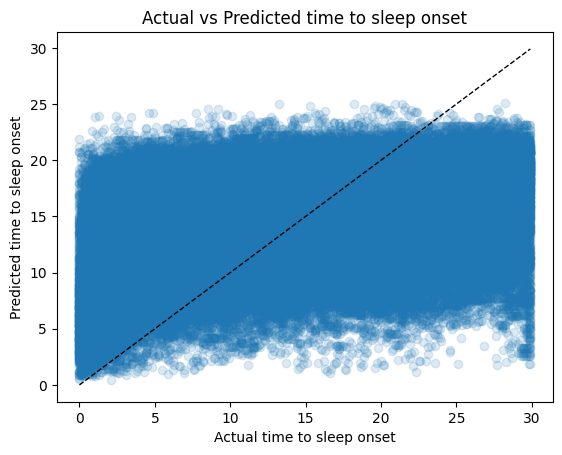

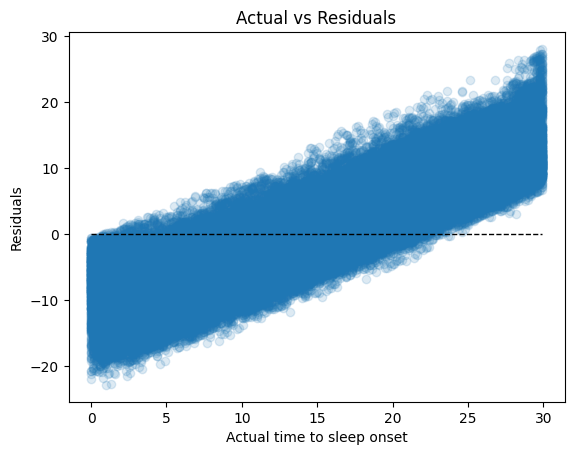

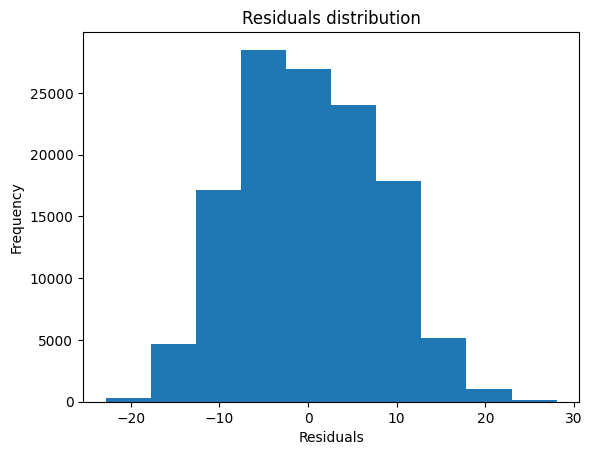

In [16]:

# Evaluate the predictions made during cross-validation
errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf, X_train, y_train, predictions_cv)

Mean Absolute Error: 6.48
Accuracy: -inf %.
Mean Squared Error: 61.21
Root Mean Squared Error: 7.82
R2: 0.18


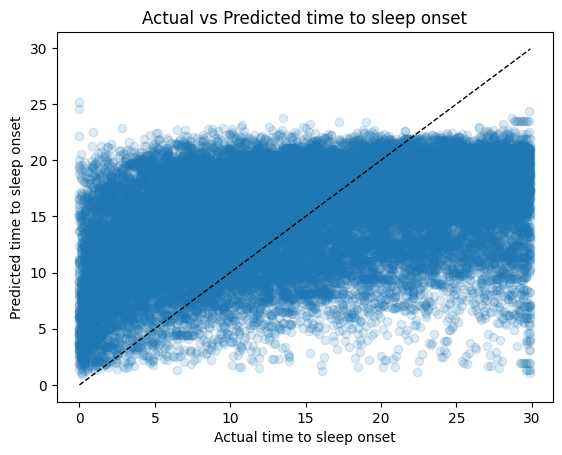

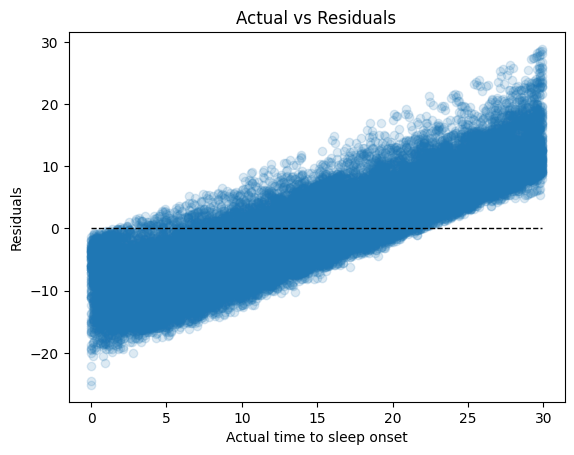

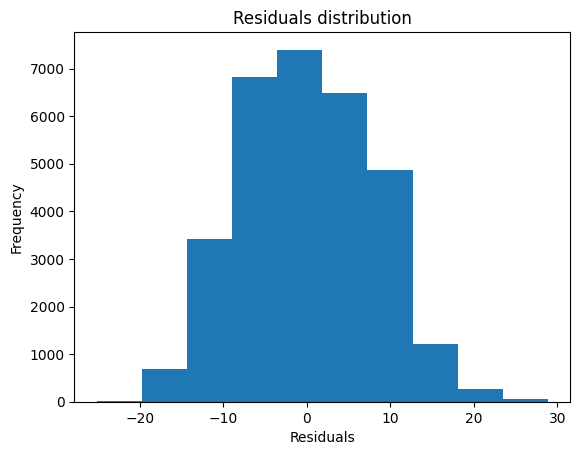

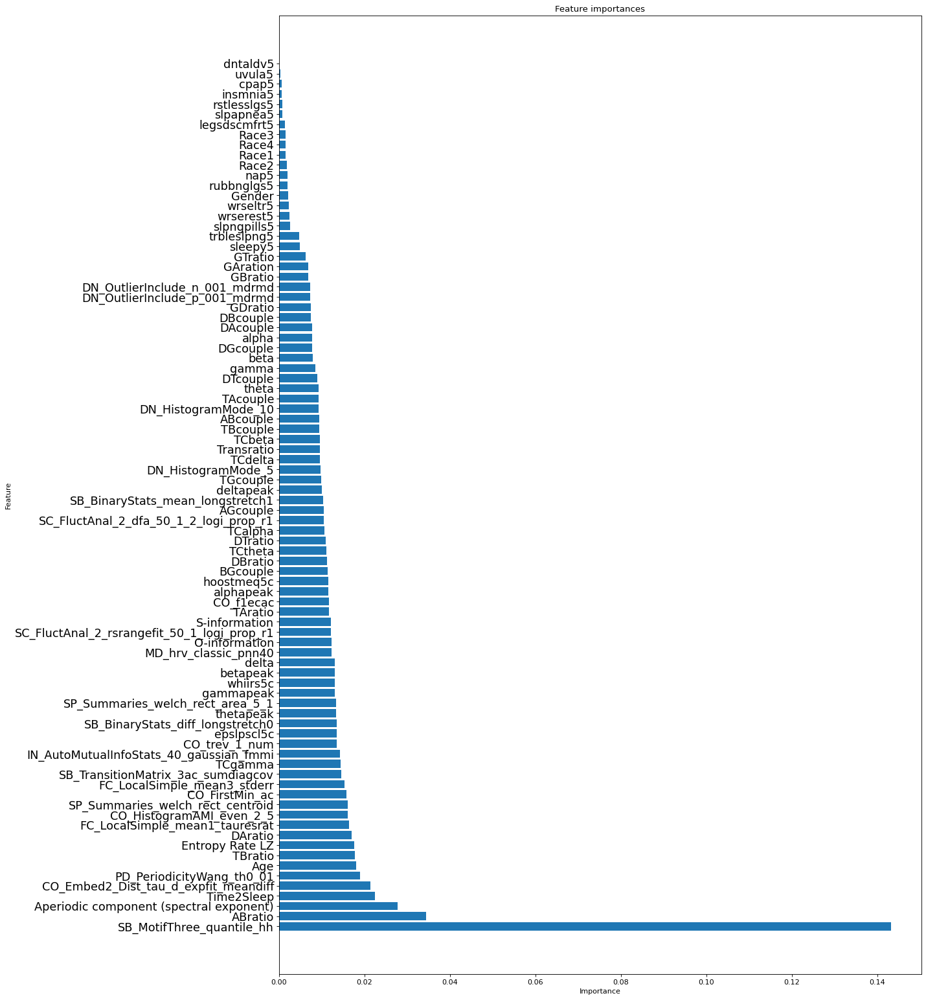

In [17]:

rf.fit(X_train, y_train)
# Predict the labels for the test set
predictions = rf.predict(X_test)

# evaluate the predictions made during cross-validation

errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf, X_test, y_test, predictions)

importances, indices, names = plot_feature_importances(rf, X_train)




## 150 estimators

In [18]:
#Try rf with 150 estimators
rf_150 = RandomForestRegressor(n_estimators = 150)
predictions_cv_150 = cross_val_predict(rf_150, X_train, y_train, cv=10)




Mean Absolute Error: 6.48
Accuracy: -inf %.
Mean Squared Error: 60.81
Root Mean Squared Error: 7.8
R2: 0.19


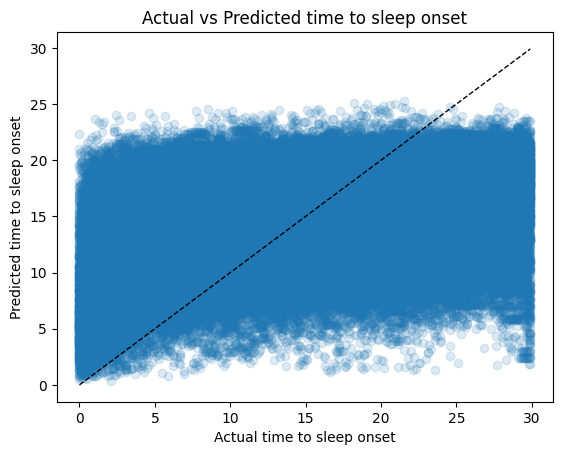

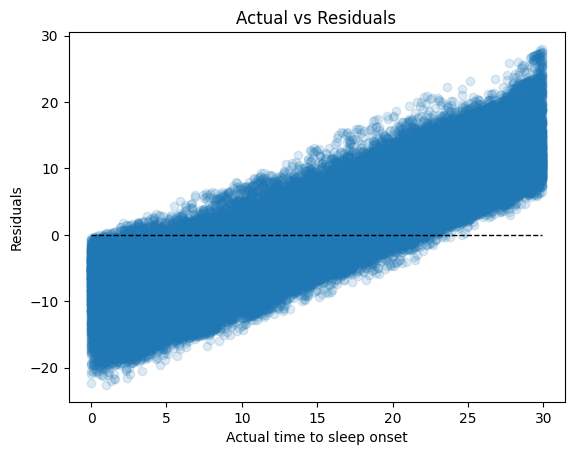

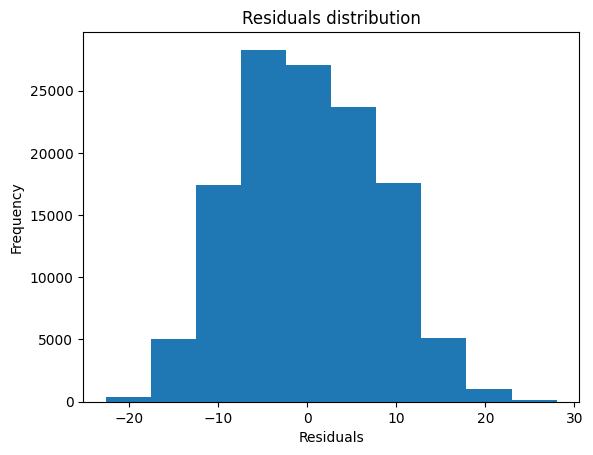

In [19]:
# Evaluate the predictions made during cross-validation
errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf_150, X_train, y_train, predictions_cv_150)




Mean Absolute Error: 6.47
Accuracy: -inf %.
Mean Squared Error: 61.23
Root Mean Squared Error: 7.82
R2: 0.18


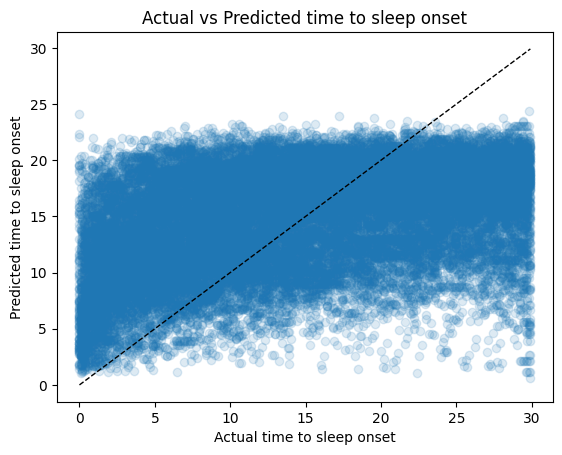

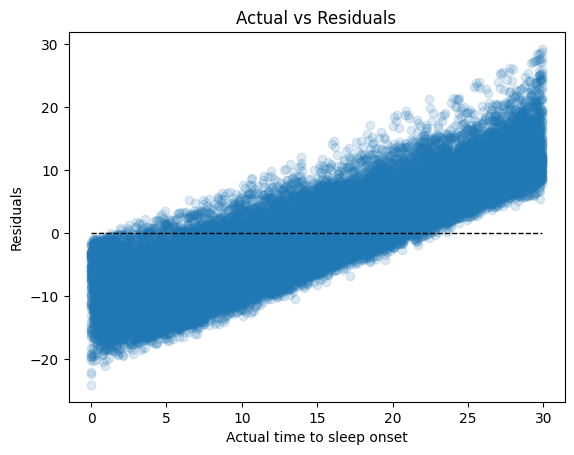

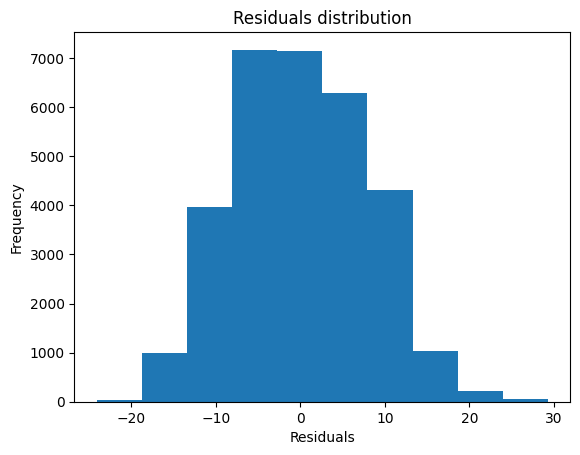

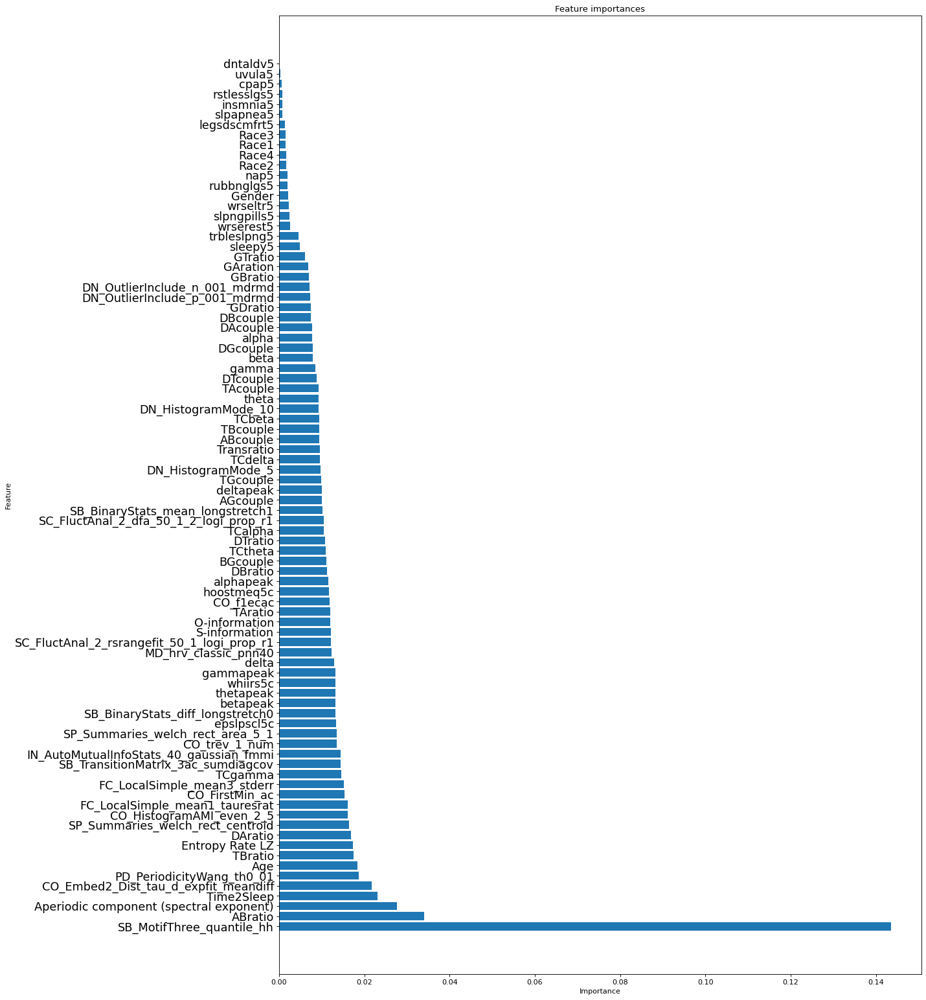

In [20]:
# Fit the model to the training data
rf_150.fit(X_train, y_train)

# Predict the labels for the test set
predictions_150 = rf_150.predict(X_test)

# Evaluate the predictions made during cross-validation
errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf_150, X_test, y_test, predictions_150)

importances, indices, names = plot_feature_importances(rf_150, X_train)

# Try random forest in classification (0-10 minutes prior to sleep onset and 30-20 minutes prior to sleep onset)

In [21]:
# create new dataset only with labels >= 20 and <= 10
mydata_normalised_preprocessed_one_hot_20_10 = data_train[(data_train['Label'] >= 20) | (data_train['Label'] <= 10)].copy()

In [22]:
mydata_normalised_preprocessed_one_hot_20_10

,Label,Sbj_ID,Age,Gender,Race1,Race2,Race3,Race4,ifCleanOnset,Time2Sleep,...,wrseltr5,slpapnea5,cpap5,dntaldv5,uvula5,insmnia5,rstlesslgs5,whiirs5c,epslpscl5c,hoostmeq5c
0,29.9,10,57,1,1.0,0.0,0.0,0.0,1,45.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
1,29.8,10,57,1,1.0,0.0,0.0,0.0,1,45.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
2,29.7,10,57,1,1.0,0.0,0.0,0.0,1,45.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
3,29.6,10,57,1,1.0,0.0,0.0,0.0,1,45.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
4,29.5,10,57,1,1.0,0.0,0.0,0.0,1,45.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
156895,0.4,6802,65,0,0.0,0.0,1.0,0.0,0,89.0,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
156896,0.3,6802,65,0,0.0,0.0,1.0,0.0,0,89.0,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
156897,0.2,6802,65,0,0.0,0.0,1.0,0.0,0,89.0,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
156898,0.1,6802,65,0,0.0,0.0,1.0,0.0,0,89.0,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0


In [23]:
# Swap Label columns into categorical '10 minutes before sleep'  (if Label <= 10) and 'Awake' in the other case

mydata_normalised_preprocessed_one_hot_20_10['Label'] = np.where(mydata_normalised_preprocessed_one_hot_20_10['Label'] <= 10, '10 minutes before sleep', 'Awake')


In [24]:
mydata_normalised_preprocessed_one_hot_20_10

,Label,Sbj_ID,Age,Gender,Race1,Race2,Race3,Race4,ifCleanOnset,Time2Sleep,...,wrseltr5,slpapnea5,cpap5,dntaldv5,uvula5,insmnia5,rstlesslgs5,whiirs5c,epslpscl5c,hoostmeq5c
0,Awake,10,57,1,1.0,0.0,0.0,0.0,1,45.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
1,Awake,10,57,1,1.0,0.0,0.0,0.0,1,45.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
2,Awake,10,57,1,1.0,0.0,0.0,0.0,1,45.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
3,Awake,10,57,1,1.0,0.0,0.0,0.0,1,45.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
4,Awake,10,57,1,1.0,0.0,0.0,0.0,1,45.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,19.0,8.0,10.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
156895,10 minutes before sleep,6802,65,0,0.0,0.0,1.0,0.0,0,89.0,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
156896,10 minutes before sleep,6802,65,0,0.0,0.0,1.0,0.0,0,89.0,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
156897,10 minutes before sleep,6802,65,0,0.0,0.0,1.0,0.0,0,89.0,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0
156898,10 minutes before sleep,6802,65,0,0.0,0.0,1.0,0.0,0,89.0,...,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,7.0


In [25]:
# Show the distribution of the labels 
mydata_normalised_preprocessed_one_hot_20_10['Label'].value_counts()

Label
10 minutes before sleep    52823
Awake                      52300
Name: count, dtype: int64

In [26]:
# Create test and training sets
X_train, y_train, X_test, y_test, sbj_train_set, sbj_test_set = train_test_split_sbjs(mydata_normalised_preprocessed_one_hot_20_10, test_size = 0.2, random_seed = 42)

In [27]:
y_train.value_counts()

Label
10 minutes before sleep    42319
Awake                      41900
Name: count, dtype: int64

In [31]:

# find majority class and the number of samples
majority_class = y_train.mode()[0]

number_samples_majority_class = y_train.value_counts()[0]
number_samples_majority_class


42319

In [32]:
majority_class

'10 minutes before sleep'

In [33]:
from sklearn.ensemble import RandomForestClassifier
# import function to upsample minority class
from sklearn.utils import resample





In [37]:
!pip install imblearn

In [38]:
from sklearn.model_selection import StratifiedKFold
from imblearn.over_sampling import RandomOverSampler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, classification_report, confusion_matrix

def cross_validation(X_train, y_train, model, n_splits=5):
    # Assuming X_train and y_train are your features and target variable

    ros = RandomOverSampler()
    skf = StratifiedKFold(n_splits=n_splits, shuffle=True)

    predictions = [] # list of predictions 
    num_fold = 0 # fold number
    for train_index, test_index in skf.split(X_train, y_train):
        num_fold += 1
        print('-------------- Fold number %s/%s --------------'%(num_fold, n_splits))
      
        X_train_fold, X_test_fold = X_train.iloc[train_index], X_train.iloc[test_index]
        y_train_fold, y_test_fold = y_train.iloc[train_index], y_train.iloc[test_index]
        
        X_train_fold_res, y_train_fold_res = ros.fit_resample(X_train_fold, y_train_fold)
        
        model.fit(X_train_fold_res, y_train_fold_res)
        
        y_pred = model.predict(X_test_fold)
        
        predictions.append(y_pred)
        
        print('Accuracy of fold %s: '%num_fold, accuracy_score(y_test_fold, y_pred))
        print('Overall f1-score of fold %s: '%num_fold, f1_score(y_test_fold, y_pred, average='weighted'))
        print(classification_report(y_test_fold, y_pred))

    #predictions = [item for sublist in predictions for item in sublist]
    predictions = np.concatenate(predictions)
      
    return predictions




In [39]:
from sklearn.model_selection import GroupKFold

def cross_validation_group(X_train, y_train, groups, model, n_splits=5, ifresample=True):
    # Assuming X_train and y_train are your features and target variable

    ros = RandomOverSampler()
    gkf = GroupKFold(n_splits=n_splits)

    predictions = [] # list of predictions 
    actual = [] # list of actual values
    num_fold = 0 # fold number
    for train_index, test_index in gkf.split(X_train, y_train, groups): # groups -> Sbj_ID column
        num_fold += 1
        print('-------------- Fold number %s/%s --------------'%(num_fold, n_splits))
      
        X_train_fold, X_test_fold = X_train.iloc[train_index], X_train.iloc[test_index]
        y_train_fold, y_test_fold = y_train.iloc[train_index], y_train.iloc[test_index]
        
        if ifresample:
            X_train_fold_res, y_train_fold_res = ros.fit_resample(X_train_fold, y_train_fold)
            model.fit(X_train_fold_res, y_train_fold_res)
        else:
            model.fit(X_train_fold, y_train_fold)
    
        y_pred = model.predict(X_test_fold)
        
        predictions.append(y_pred)
        actual.append(y_test_fold)
        
        print('Accuracy of fold %s: '%num_fold, accuracy_score(y_test_fold, y_pred))
        print('Overall f1-score of fold %s: '%num_fold, f1_score(y_test_fold, y_pred, average='weighted'))
        print(classification_report(y_test_fold, y_pred))

    #predictions = [item for sublist in predictions for item in sublist]
    predictions = np.concatenate(predictions)
    actual = np.concatenate(actual)
      
    return predictions, actual

In [40]:
def evaluate_classification (true_labels, predictions, index = ['10 minutes before sleep', 'Awake'], columns = ['10 minutes before sleep', 'Awake']):
    # evaluate the perfromance of the model

    accuracy = accuracy_score(true_labels, predictions)

    print(f'Accuracy: {accuracy}')
    
    print(classification_report(true_labels, predictions))

    # plot the confusion matrix

    # include the names of the classes in the confusion matrix

    # create a normalised confusion matrix where the values in each row sum to 1

    cm = confusion_matrix(true_labels, predictions, normalize='true', labels = index)
    # normalise the confusion matrix
    #cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    cm = pd.DataFrame(cm,
                            index = index,
                            columns = columns)
    plt.figure(figsize=(5.5,4))
    #fig, ax = plt.subplots(figsize=(10,10))
    sns.heatmap(cm, annot=True, fmt='.2f', cmap='Blues')

    #cm = confusion_matrix(true_labels, predictions)

    #cm_df = pd.DataFrame(cm,
                            #index = index,
                            #columns = columns)
    #
                    
    #sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')

    plt.ylabel('True label')
    plt.xlabel('Predicted label')

## Try using other upsampling and downsampling methods (SMOTE, ADASYN, etc.)

In [41]:
# import smote 
from imblearn.over_sampling import SMOTE, ADASYN, RandomOverSampler, BorderlineSMOTE, SVMSMOTE, SMOTENC
from imblearn.under_sampling import RandomUnderSampler, TomekLinks, ClusterCentroids, NearMiss, EditedNearestNeighbours, RepeatedEditedNearestNeighbours, AllKNN, InstanceHardnessThreshold, CondensedNearestNeighbour, OneSidedSelection, NeighbourhoodCleaningRule
from sklearn.model_selection import GroupKFold

categorical_columns = ['nap5', 'trbleslpng5', 'slpngpills5', 'sleepy5', 'legsdscmfrt5', 'rubbnglgs5', 
                        'wrserest5', 'wrseltr5', 'slpapnea5', 'cpap5', 'dntaldv5', 'uvula5', 'insmnia5', 
                        'rstlesslgs5', 'whiirs5c', 'epslpscl5c', 'hoostmeq5c']

def resample_data(X_train, y_train, imbalance_method='oversampling'):
    # Assuming X_train and y_train are your features and target variable
    if imbalance_method == 'Random Oversampling':
        # Define the oversampling method
        resampler = RandomOverSampler()
    elif imbalance_method == 'Random Undersampling':
        # Define the undersampling method
        resampler = RandomUnderSampler()
    elif imbalance_method == 'SMOTE':
        # Define the undersampling method
        resampler = SMOTE()
    elif imbalance_method == 'ADASYN':
        resampler = ADASYN()
    elif imbalance_method == 'BorderlineSMOTE':
        resampler = BorderlineSMOTE()
    elif imbalance_method == 'SVMSMOTE':
        resampler = SVMSMOTE()
    elif imbalance_method == 'SMOTENC':
        resampler = SMOTENC(categorical_features=categorical_columns)
    elif imbalance_method == 'TomekLinks':
        resampler = TomekLinks()
    elif imbalance_method == 'ClusterCentroids':
        resampler = ClusterCentroids()
    elif imbalance_method == 'NearMiss':
        resampler = NearMiss()
    elif imbalance_method == 'EditedNearestNeighbours':
        resampler = EditedNearestNeighbours()
    elif imbalance_method == 'RepeatedEditedNearestNeighbours':
        resampler = RepeatedEditedNearestNeighbours()
    elif imbalance_method == 'AllKNN':
        resampler = AllKNN()
    elif imbalance_method == 'InstanceHardnessThreshold':
        resampler = InstanceHardnessThreshold()
    elif imbalance_method == 'CondensedNearestNeighbour':
        resampler = CondensedNearestNeighbour()
    elif imbalance_method == 'OneSidedSelection':
        resampler = OneSidedSelection()
    elif imbalance_method == 'NeighbourhoodCleaningRule':
        resampler = NeighbourhoodCleaningRule()
    
    X_train_res, y_train_res = resampler.fit_resample(X_train, y_train)
    
    return X_train_res, y_train_res

def cross_validation_group_imbalance(X_train, y_train, groups, model, labels, n_splits=5, imbalance_method='oversampling', ifvocal = True):

    gkf = GroupKFold(n_splits=n_splits)

    predictions = [] # list of predictions 
    actual = [] # list of actual values
    num_fold = 0 # fold number
    for train_index, test_index in gkf.split(X_train, y_train, groups): # groups -> Sbj_ID column
        num_fold += 1
        print('-------------- Fold number %s/%s --------------'%(num_fold, n_splits))
      
        X_train_fold, X_test_fold = X_train.iloc[train_index], X_train.iloc[test_index]
        y_train_fold, y_test_fold = y_train.iloc[train_index], y_train.iloc[test_index]
        
        
        X_train_fold_res, y_train_fold_res = resample_data(X_train_fold, y_train_fold, imbalance_method=imbalance_method)
       
        model.fit(X_train_fold_res, y_train_fold_res)
    
        y_pred = model.predict(X_test_fold)
        
        predictions.append(y_pred)
        actual.append(y_test_fold)
        
        print('Accuracy of fold %s: '%num_fold, accuracy_score(y_test_fold, y_pred))
        print('Overall f1-score of fold %s: '%num_fold, f1_score(y_test_fold, y_pred, average='weighted'))
        f1_scores = f1_score(y_test_fold, y_pred, labels = labels, average=None)
        print('F1-score of {} class {}: '.format(labels[0], f1_scores[0]))
        print('F1-score of {} class {}: '.format(labels[1], f1_scores[1]))
        
        
        if ifvocal:
            print(classification_report(y_test_fold, y_pred))

    #predictions = [item for sublist in predictions for item in sublist]
    predictions = np.concatenate(predictions)
    actual = np.concatenate(actual)
      
    return predictions, actual



### Hyperparameter tune on the best resampling method

In [42]:

# Create a list of all resampling methods to test on Random Forest
# Create a list of all resampling methods to test on Random Forest
resampling_methods = ['Random Oversampling', 'Random Undersampling', 'SMOTE', 'ADASYN', 
                        'BorderlineSMOTE', 'TomekLinks',  'NearMiss', 
                        'EditedNearestNeighbours', 'AllKNN', 
                        'OneSidedSelection']



# Create a dataset 

def try_resampling_methods(resampling_methods, dataset, pre_onset_time = 5, awake_time = 10, model_type = 'Random Forest', test_size = 0.2, n_splits=5, random_seed = 42, ifvocal = False): 
    # Try classification on 5 minutes before sleep and 20+ minutes before sleep
    dataset_refined = dataset[(dataset['Label'] <= pre_onset_time) | (dataset['Label'] >= awake_time)].copy()

    # Swap Label columns into categorical '5 minutes before sleep'  (if Label <= 5) and '20+ minutes before sleep' in the other case
    dataset_refined['Label'] = np.where(dataset_refined['Label'] <= pre_onset_time, f'{pre_onset_time} minutes before sleep', 'Awake')

    # Create X_train, y_train, X_test, y_test
    X_train, y_train, X_test, y_test, sbj_train_set, sbj_test_set = train_test_split_sbjs(dataset_refined, test_size = test_size, random_seed = random_seed)

    # Create a dictionary to store the results
    results = {}

    for resampling_method in resampling_methods:

        # Create a model
        if model_type == 'Random Forest':
            model = RandomForestClassifier(n_estimators=150, random_state=random_seed)
        

        print ('------------------ %s ------------------'%resampling_method)
        print('\n')

        print('CROSS-VALIDATION')
        print('\n')

        # Perform cross-validation
        predictions_cv_class, actuals_cv_class = cross_validation_group_imbalance(X_train, y_train, sbj_train_set, model, labels = [f'{pre_onset_time} minutes before sleep', 'Awake'], n_splits=n_splits, imbalance_method=resampling_method, ifvocal = ifvocal)
        
        # Evaluate the predictions made during cross-validation
        evaluate_classification(actuals_cv_class, predictions_cv_class, index = [f'{pre_onset_time} minutes before sleep', 'Awake'], columns = [f'{pre_onset_time} minutes before sleep', 'Awake'])
        
        f1_weighted = f1_score(actuals_cv_class, predictions_cv_class, average='weighted')
        f1_macro = f1_score(actuals_cv_class, predictions_cv_class, average='macro')
  
        # Store the results
        results[resampling_method] = {'f1_weighted': f1_weighted, 'f1_macro': f1_macro, 'predictions_cv_class': predictions_cv_class, 'actuals_cv_class': actuals_cv_class}

        # resample the xtrain and ytrain
        X_train_res, y_train_res = resample_data(X_train, y_train, imbalance_method=resampling_method)

        # Fit the model on the resampled data
        model.fit(X_train_res, y_train_res)

        importances, indices, names = plot_feature_importances(model, X_train_res)
    
    return results

  

## 0-5 minutes prior to sleep onset and 30-20 minutes prior to sleep onset

------------------ Random Oversampling ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.8060548722800378
Overall f1-score of fold 1:  0.805329400708625
F1-score of 5 minutes before sleep class 0.7085998578535891: 
F1-score of Awake class 0.8546614675646933: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7982497634815515
Overall f1-score of fold 2:  0.7991655287336337
F1-score of 5 minutes before sleep class 0.7070406410990269: 
F1-score of Awake class 0.8461492214272831: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7671870072532324
Overall f1-score of fold 3:  0.7705334690205369
F1-score of 5 minutes before sleep class 0.6782172823362754: 
F1-score of Awake class 0.8176147242295102: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7842951750236519
Overall f1-score of fold 4:  0.7849629773612057
F1-score of 5 minutes before sleep class 0.6847926267281107: 
F1-

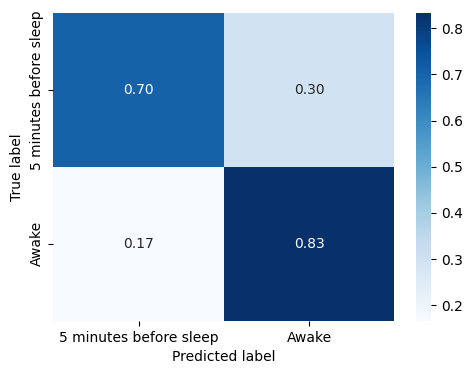

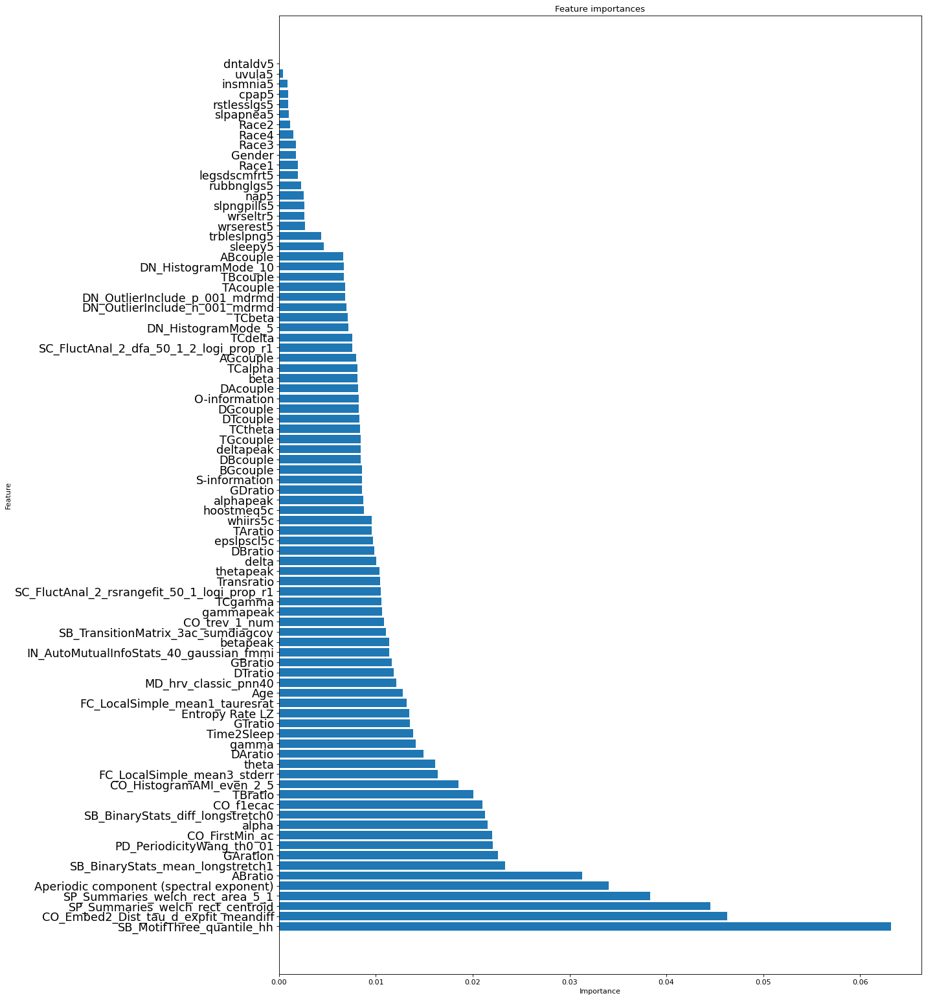

------------------ Random Undersampling ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.783585619678335
Overall f1-score of fold 1:  0.7871249578110986
F1-score of 5 minutes before sleep class 0.7044255410789275: 
F1-score of Awake class 0.8293016603445059: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7946231472721539
Overall f1-score of fold 2:  0.7986515396201218
F1-score of 5 minutes before sleep class 0.7256450763559769: 
F1-score of Awake class 0.8358848358848358: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.749605802585935
Overall f1-score of fold 3:  0.7559382897284481
F1-score of 5 minutes before sleep class 0.6836653386454183: 
F1-score of Awake class 0.7927974947807934: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7650583412172817
Overall f1-score of fold 4:  0.770264132498959
F1-score of 5 minutes before sleep class 0.692593356715494: 
F1-sc

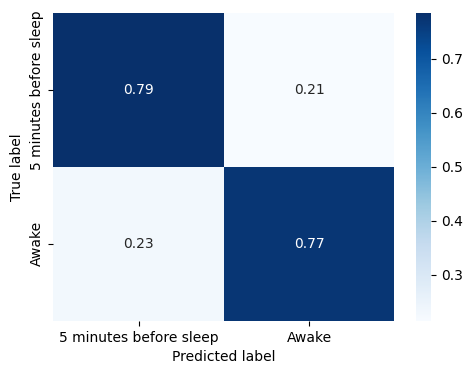

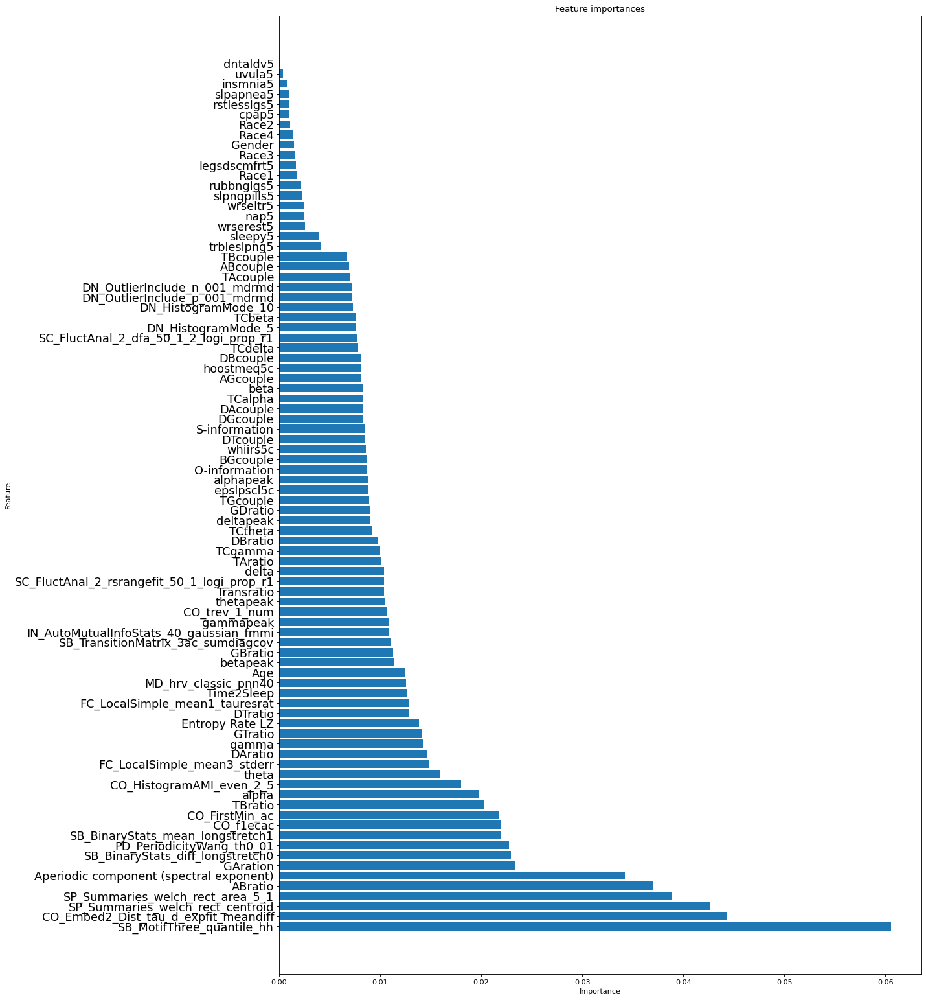

------------------ SMOTE ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.8015610217596972
Overall f1-score of fold 1:  0.8021062178539676
F1-score of 5 minutes before sleep class 0.7095880927656628: 
F1-score of Awake class 0.849290461649003: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7956480605487228
Overall f1-score of fold 2:  0.7975213592838412
F1-score of 5 minutes before sleep class 0.7096123683620883: 
F1-score of Awake class 0.8423549446539351: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7657678965625986
Overall f1-score of fold 3:  0.7703221816920132
F1-score of 5 minutes before sleep class 0.6867025202994832: 
F1-score of Awake class 0.8129682090022033: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7748344370860927
Overall f1-score of fold 4:  0.7772281132262009
F1-score of 5 minutes before sleep class 0.6823843416370107: 
F1-score of Awake

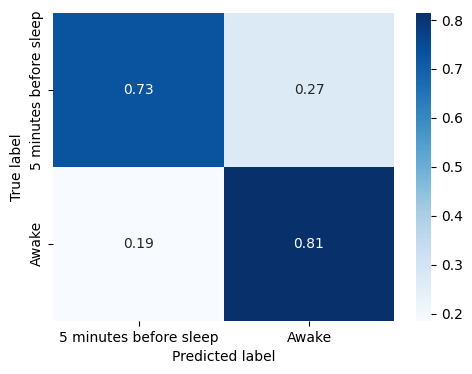

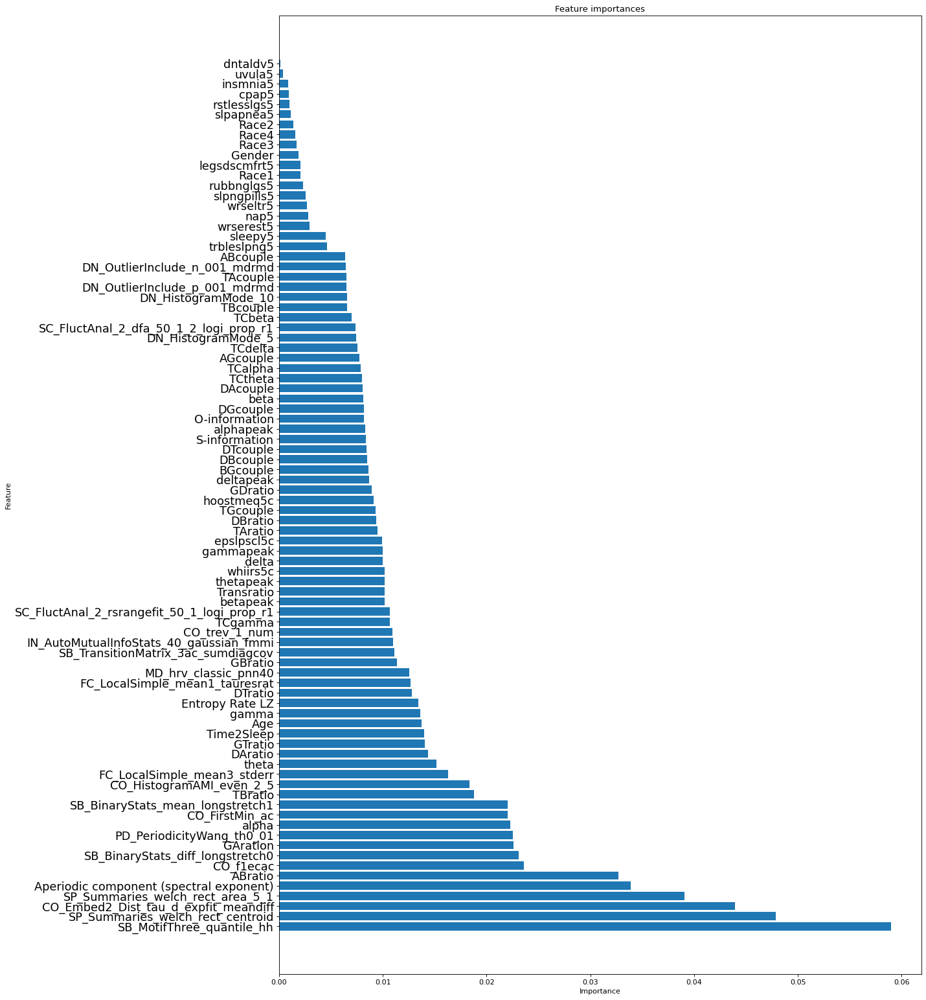

------------------ ADASYN ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.8019552191737622
Overall f1-score of fold 1:  0.8029303936766883
F1-score of 5 minutes before sleep class 0.7129142857142857: 
F1-score of Awake class 0.8488386087375135: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7946231472721539
Overall f1-score of fold 2:  0.7971311192835114
F1-score of 5 minutes before sleep class 0.7126943862358002: 
F1-score of Awake class 0.8401938531378443: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7622201198360139
Overall f1-score of fold 3:  0.7671585020763598
F1-score of 5 minutes before sleep class 0.6851774530271398: 
F1-score of Awake class 0.808968837091462: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7784610532954904
Overall f1-score of fold 4:  0.7812966538734402
F1-score of 5 minutes before sleep class 0.6910729991204926: 
F1-score of Awak

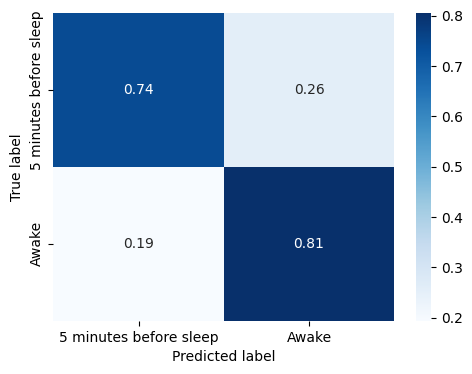

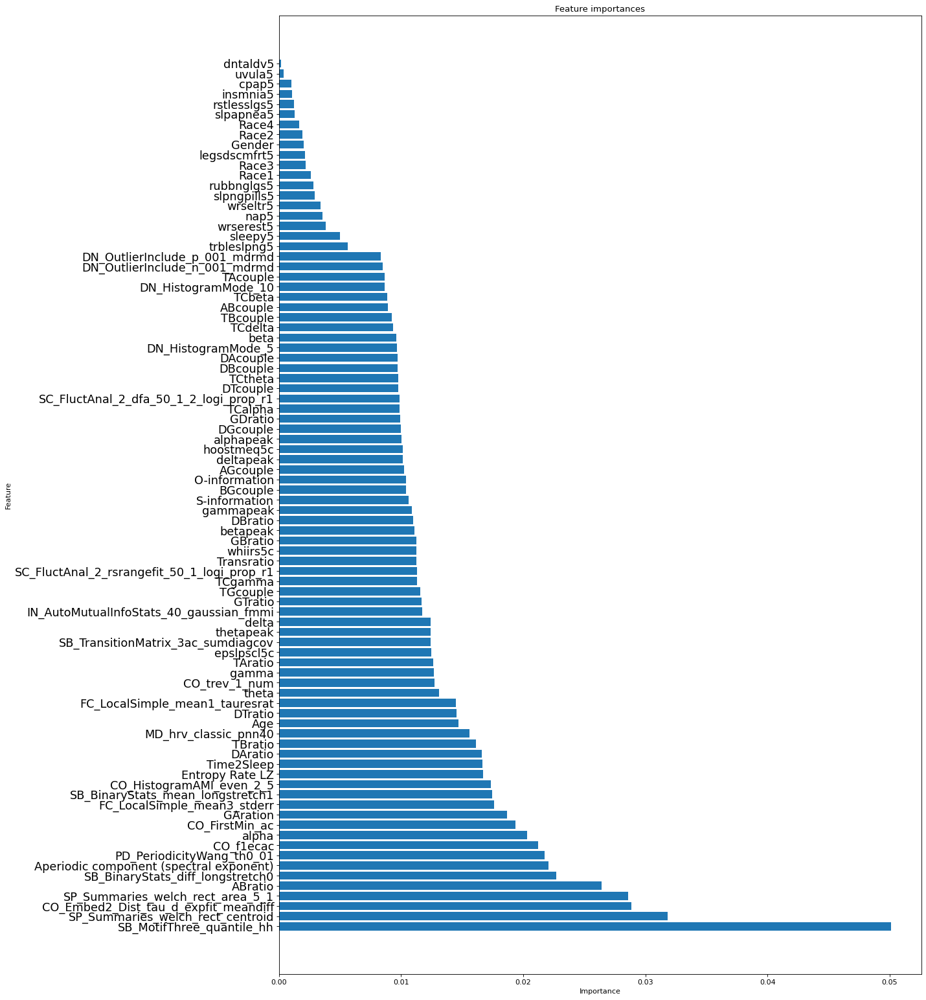

------------------ BorderlineSMOTE ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.803768527278461
Overall f1-score of fold 1:  0.8042013666901743
F1-score of 5 minutes before sleep class 0.7121545044524112: 
F1-score of Awake class 0.8511452664314335: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7985651214128036
Overall f1-score of fold 2:  0.8005608250737114
F1-score of 5 minutes before sleep class 0.7148119209733229: 
F1-score of Awake class 0.8442927661649096: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7619836013875749
Overall f1-score of fold 3:  0.7667780087925259
F1-score of 5 minutes before sleep class 0.6833106052659184: 
F1-score of Awake class 0.8093463845910956: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7786975717439294
Overall f1-score of fold 4:  0.7807212312411369
F1-score of 5 minutes before sleep class 0.6854901960784314: 
F1-scor

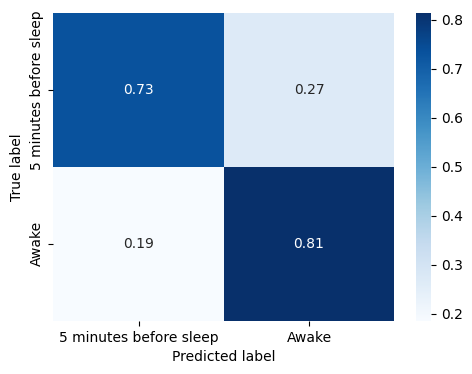

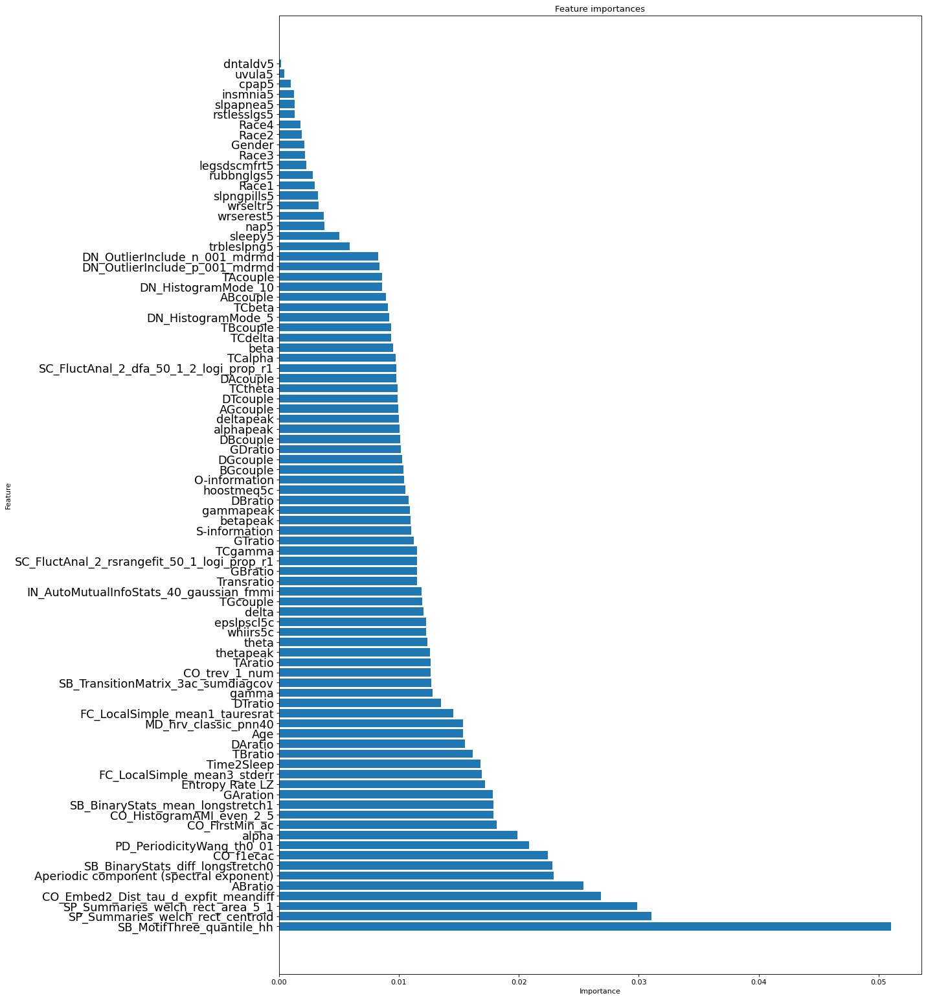

------------------ TomekLinks ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.805029959003469
Overall f1-score of fold 1:  0.803471327764816
F1-score of 5 minutes before sleep class 0.7023709230954387: 
F1-score of Awake class 0.8550325341461984: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7973036896877956
Overall f1-score of fold 2:  0.7977175848809763
F1-score of 5 minutes before sleep class 0.7024649924777224: 
F1-score of Awake class 0.846296407006636: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7732576474298328
Overall f1-score of fold 3:  0.775579109518054
F1-score of 5 minutes before sleep class 0.6795186093158011: 
F1-score of Awake class 0.8245699646212029: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7868968779564806
Overall f1-score of fold 4:  0.7864039929331119
F1-score of 5 minutes before sleep class 0.6815879373306633: 
F1-score of Awa

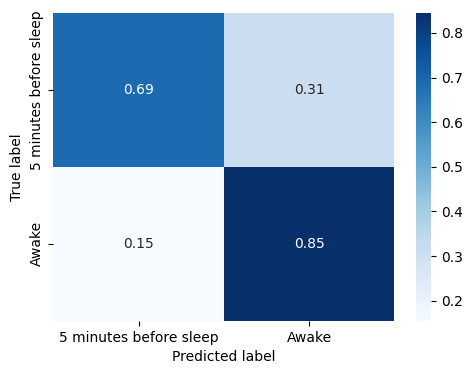

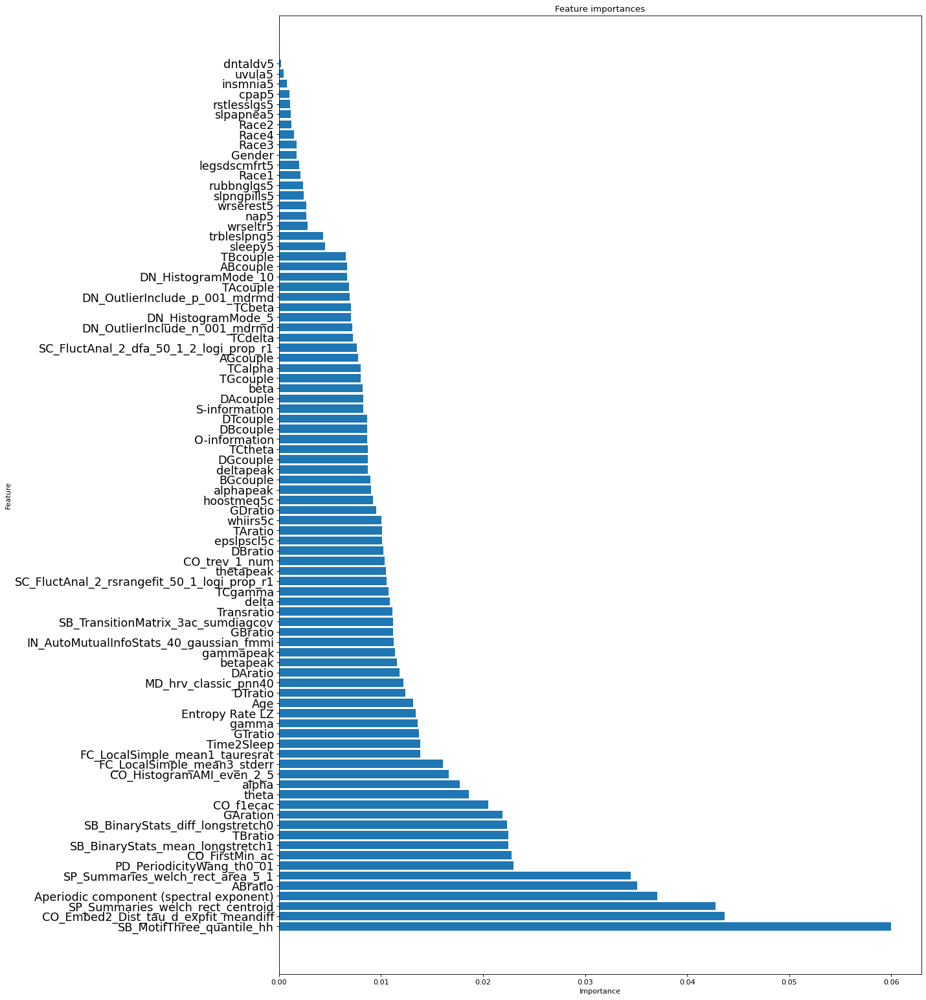

------------------ NearMiss ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.7224061810154525
Overall f1-score of fold 1:  0.7298393313144452
F1-score of 5 minutes before sleep class 0.6600366901612436: 
F1-score of Awake class 0.7654386783025781: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.76080100914538
Overall f1-score of fold 2:  0.7671410103312228
F1-score of 5 minutes before sleep class 0.7046339563862929: 
F1-score of Awake class 0.7990196078431372: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.6988331756543678
Overall f1-score of fold 3:  0.7069065913571216
F1-score of 5 minutes before sleep class 0.6453110492107706: 
F1-score of Awake class 0.7383203178517606: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7216177861873226
Overall f1-score of fold 4:  0.7291023676288142
F1-score of 5 minutes before sleep class 0.660578679227146: 
F1-score of Awak

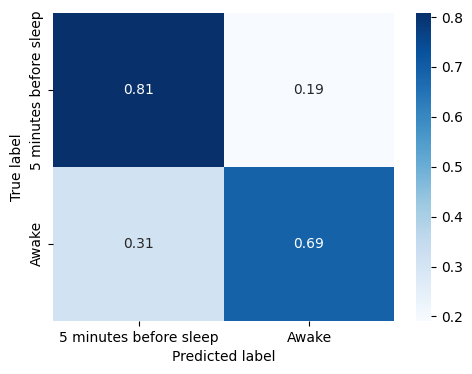

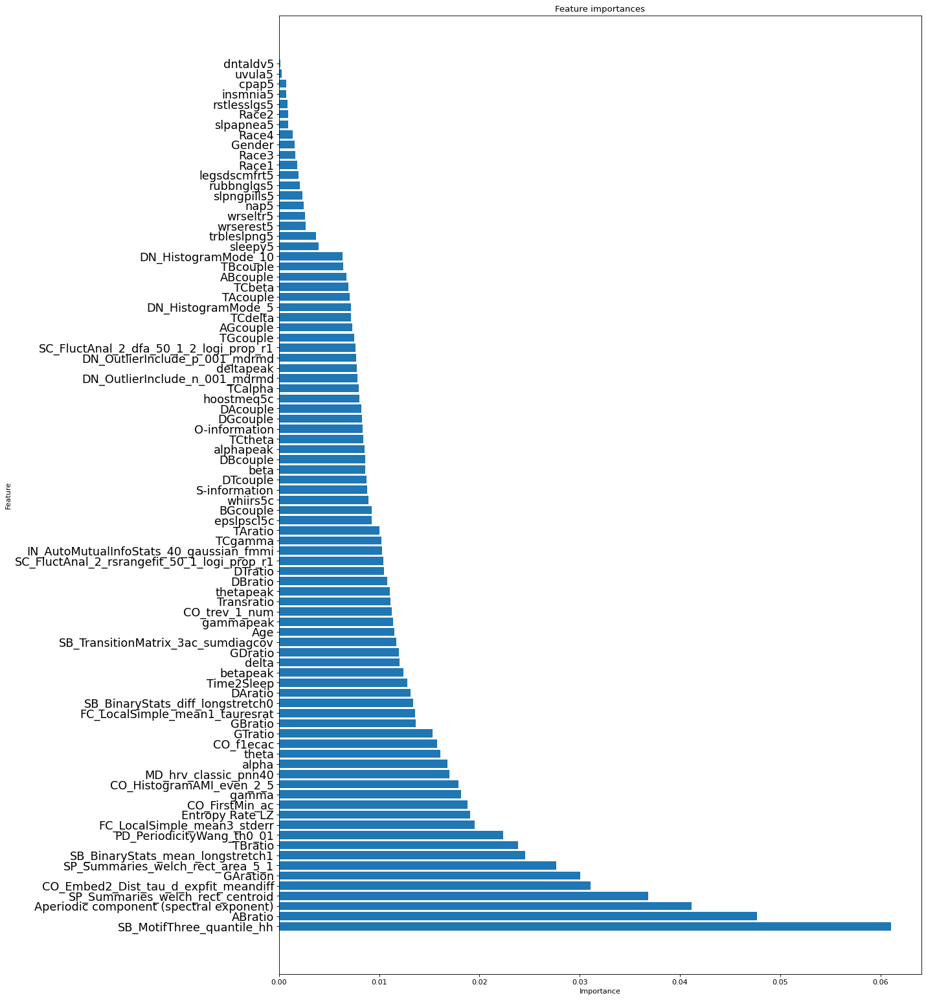

------------------ EditedNearestNeighbours ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.8025859350362662
Overall f1-score of fold 1:  0.8021706596506768
F1-score of 5 minutes before sleep class 0.7052730696798493: 
F1-score of Awake class 0.8515884305357989: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7954115421002839
Overall f1-score of fold 2:  0.7972823637587282
F1-score of 5 minutes before sleep class 0.7092436974789915: 
F1-score of Awake class 0.8421820835613939: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7690791548407443
Overall f1-score of fold 3:  0.7729577839339992
F1-score of 5 minutes before sleep class 0.685493396327714: 
F1-score of Awake class 0.8175646216132046: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7798801639861243
Overall f1-score of fold 4:  0.781888008109212
F1-score of 5 minutes before sleep class 0.6871358135365307: 


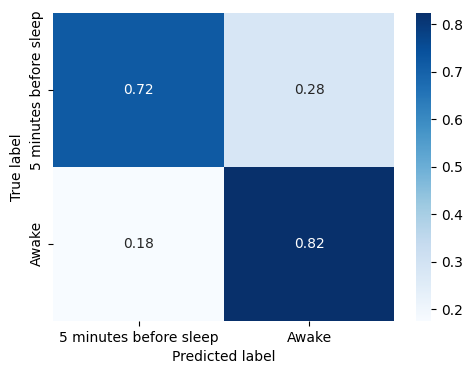

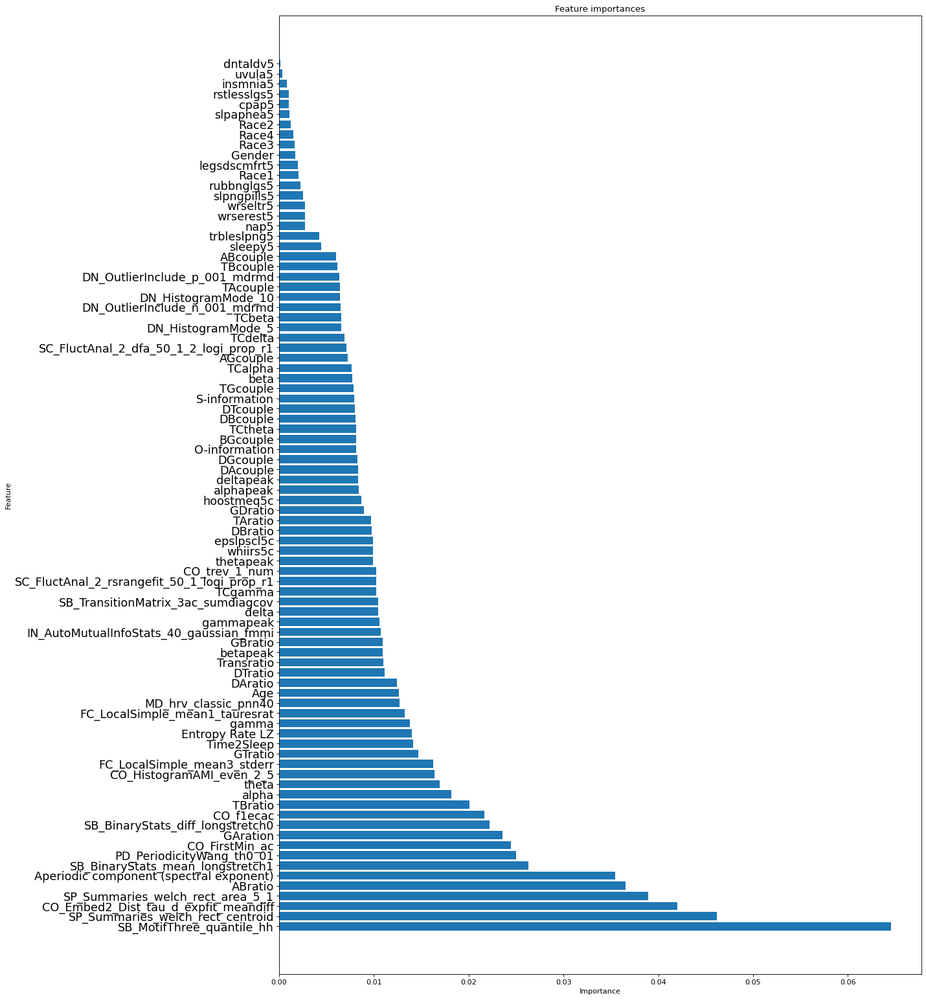

------------------ AllKNN ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.8013245033112583
Overall f1-score of fold 1:  0.8015932815689844
F1-score of 5 minutes before sleep class 0.7075208913649026: 
F1-score of Awake class 0.849570200573066: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7986439608956165
Overall f1-score of fold 2:  0.8006700641540345
F1-score of 5 minutes before sleep class 0.7151461075172875: 
F1-score of Awake class 0.8442872820387757: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7665562913907285
Overall f1-score of fold 3:  0.7706314881863214
F1-score of 5 minutes before sleep class 0.6834170854271358: 
F1-score of Awake class 0.8151108335935061: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.782639545884579
Overall f1-score of fold 4:  0.784850630051847
F1-score of 5 minutes before sleep class 0.6926764017389365: 
F1-score of Awake 

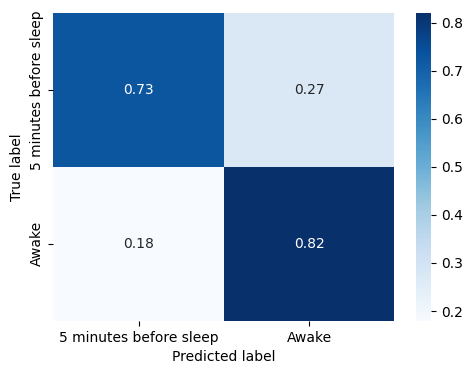

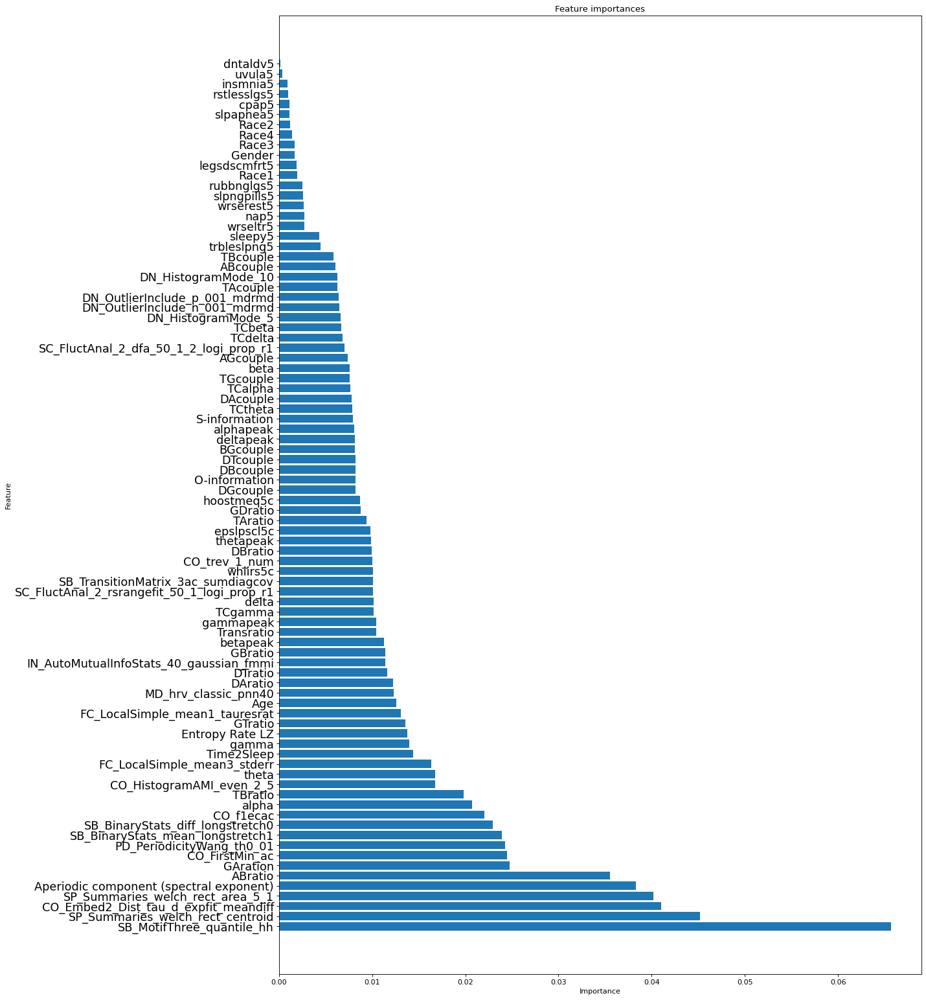

------------------ OneSidedSelection ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.8072374645222328
Overall f1-score of fold 1:  0.8051733323850563
F1-score of 5 minutes before sleep class 0.7028800583302953: 
F1-score of Awake class 0.8573429021529844: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7967518133081047
Overall f1-score of fold 2:  0.7970380615033396
F1-score of 5 minutes before sleep class 0.7008586679043862: 
F1-score of Awake class 0.8460895522388059: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7750709555345316
Overall f1-score of fold 3:  0.7774474856033272
F1-score of 5 minutes before sleep class 0.6826120814328623: 
F1-score of Awake class 0.8258135417302643: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7848470514033428
Overall f1-score of fold 4:  0.78437518254006
F1-score of 5 minutes before sleep class 0.678676557164724: 
F1-scor

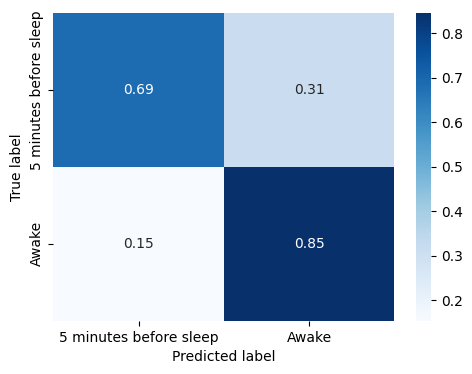

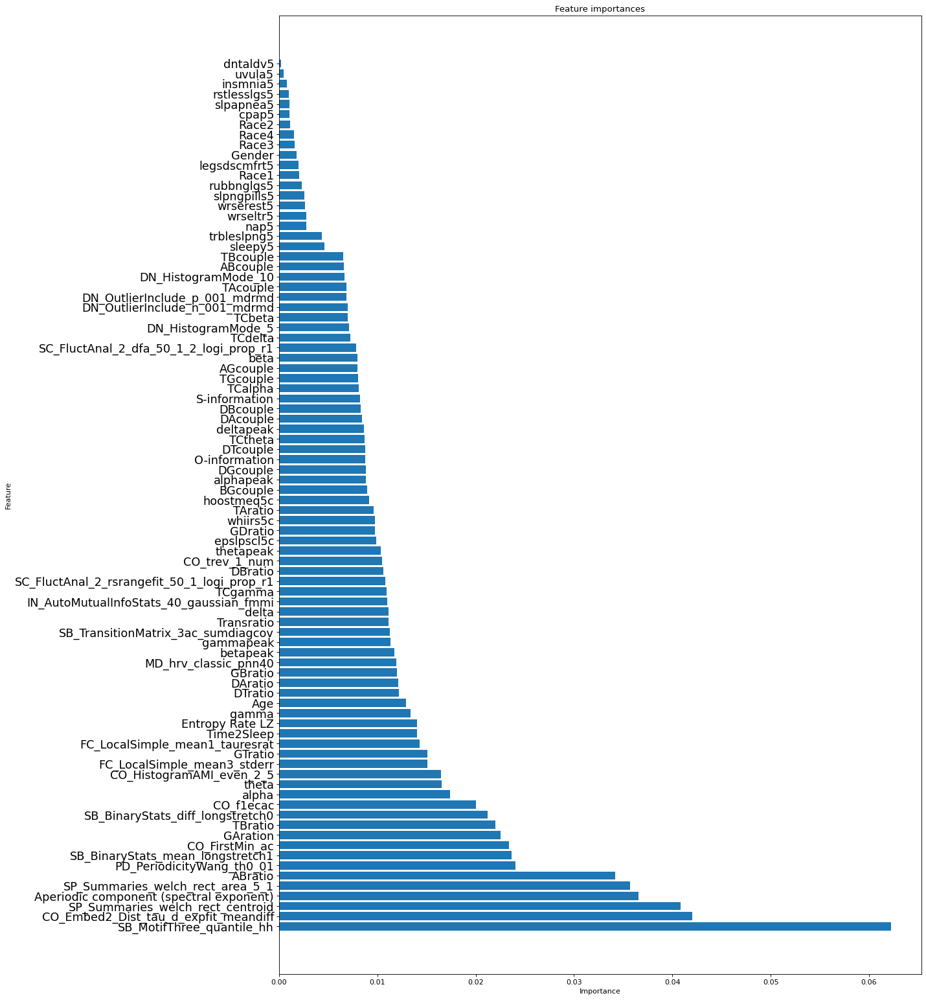

In [44]:
  

results = try_resampling_methods(resampling_methods, data_train, pre_onset_time = 5, awake_time = 20, model_type = 'Random Forest', test_size = 0.2, n_splits=5, random_seed = 42)


In [139]:
# Create a list of all resampling methods to test on Random Forest
resampling_methods = ['Random Oversampling', 'Random Undersampling', 'SMOTE', 'ADASYN', 
                        'BorderlineSMOTE', 'TomekLinks',  'NearMiss', 
                        'EditedNearestNeighbours', 'AllKNN', 
                        'OneSidedSelection']

In [45]:
# Sort the results by f1_weighted
results_sorted = {k: v for k, v in sorted(results.items(), key=lambda item: item[1]['f1_weighted'], reverse=True)}

# Print the results
for key, value in results_sorted.items():
    print(key, '->', value['f1_weighted'], value['f1_macro'])

    

OneSidedSelection -> 0.79229065673025 0.7674855279147408
TomekLinks -> 0.7917335630547156 0.7669622530435047
Random Oversampling -> 0.7910602655639762 0.7673371584094886
AllKNN -> 0.7907830418978418 0.7684132823291527
EditedNearestNeighbours -> 0.7900419227442184 0.7671911141934111
BorderlineSMOTE -> 0.7883417608937997 0.7661689769748746
SMOTE -> 0.78819512435036 0.7659327073697091
ADASYN -> 0.7872328625794291 0.765678144816093
Random Undersampling -> 0.7802189566383404 0.7612163813047297
NearMiss -> 0.7371135788755381 0.7204423662410315


------------------ Random Oversampling ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------


Accuracy of fold 1:  0.831151584139632
Overall f1-score of fold 1:  0.8215408256800295
F1-score of 5 minutes before sleep class 0.5241913926757551: 
F1-score of Awake class 0.8973649310961195: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.8257920698159742
Overall f1-score of fold 2:  0.8091603982813
F1-score of 5 minutes before sleep class 0.4694496605517839: 
F1-score of Awake class 0.8957866364023266: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.8132707266173401
Overall f1-score of fold 3:  0.8052163133775448
F1-score of 5 minutes before sleep class 0.4894306834392427: 
F1-score of Awake class 0.8857416490118118: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.813982166571808
Overall f1-score of fold 4:  0.8091971042067934
F1-score of 5 minutes before sleep class 0.5114598903836572: 
F1-score of Awake class 0.8851200937316931: 
-------------- Fold number 5/5 --------------
Accuracy of fold 5:  0.8033408534536552
O

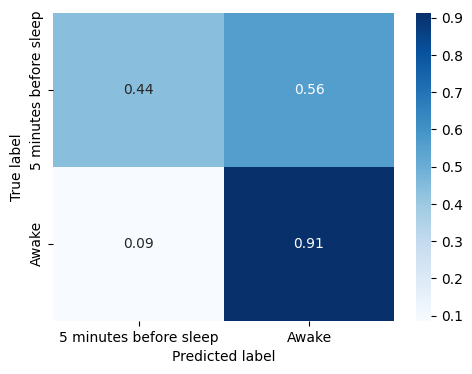

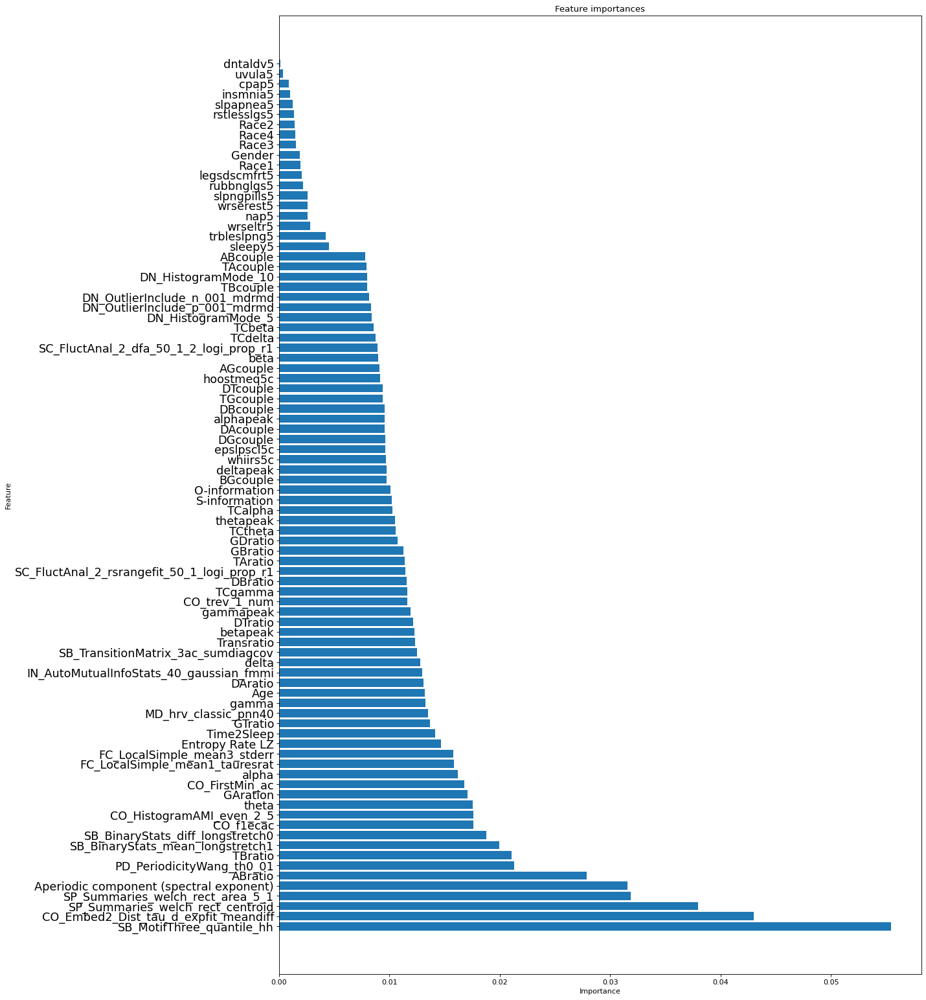

------------------ Random Undersampling ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.7746632517548853
Overall f1-score of fold 1:  0.7915231975435363
F1-score of 5 minutes before sleep class 0.5753865403521315: 
F1-score of Awake class 0.8466380451273444: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.74867197875166
Overall f1-score of fold 2:  0.7684557820976355
F1-score of 5 minutes before sleep class 0.5365981635330127: 
F1-score of Awake class 0.8275794748316143: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7200246632517548
Overall f1-score of fold 3:  0.743978751221407
F1-score of 5 minutes before sleep class 0.5060664379549829: 
F1-score of Awake class 0.8046463911043452: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7335420223866439
Overall f1-score of fold 4:  0.7568043648336281
F1-score of 5 minutes before sleep class 0.53600925008259: 
F1-sco

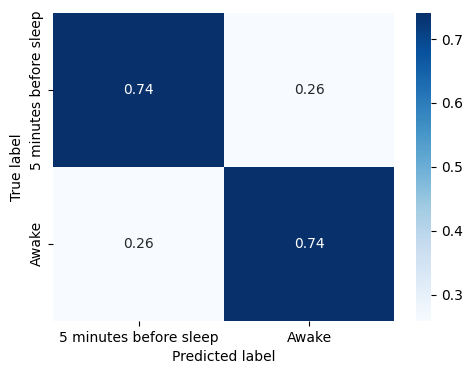

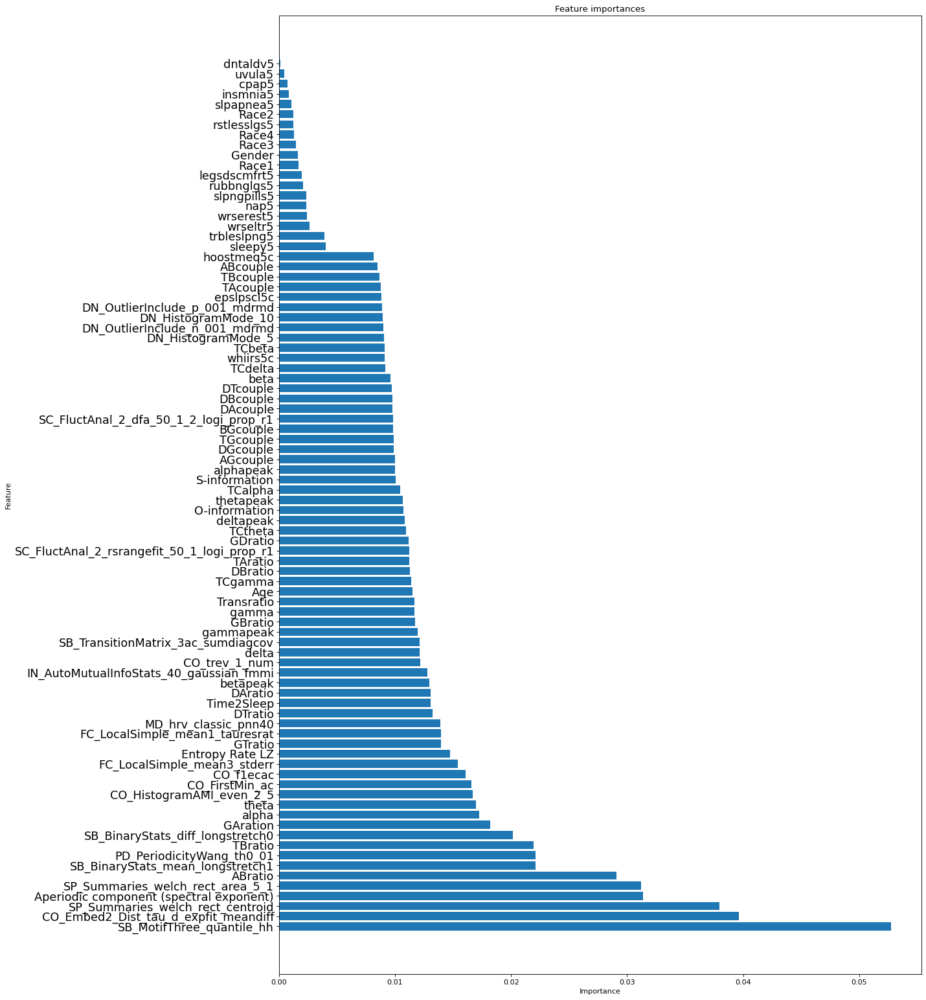

------------------ SMOTE ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.8145987478656801
Overall f1-score of fold 1:  0.8162859809004105
F1-score of 5 minutes before sleep class 0.5550369948776323: 
F1-score of Awake class 0.8829044723362189: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.8066780497059381
Overall f1-score of fold 2:  0.8048677836585463
F1-score of 5 minutes before sleep class 0.5124401913875598: 
F1-score of Awake class 0.8794368196876479: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7971921836463669
Overall f1-score of fold 3:  0.800493371676284
F1-score of 5 minutes before sleep class 0.5231935771632472: 
F1-score of Awake class 0.8712048192771085: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7927812559286663
Overall f1-score of fold 4:  0.7984662524235397
F1-score of 5 minutes before sleep class 0.5290503395494233: 
F1-score of Awake

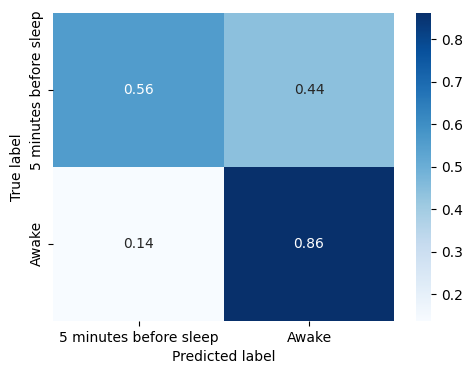

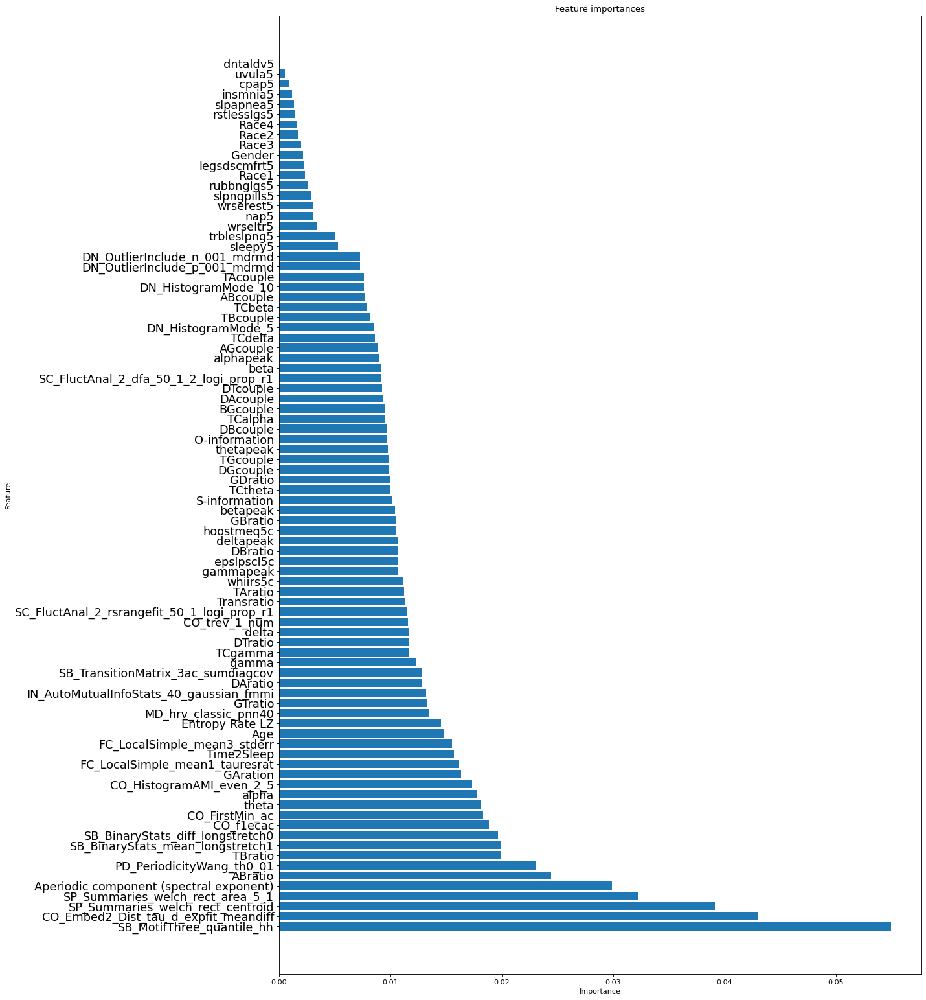

------------------ ADASYN ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.8210965661164864
Overall f1-score of fold 1:  0.819237235853272
F1-score of 5 minutes before sleep class 0.5476133365315423: 
F1-score of Awake class 0.8885013301803132: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.8085752229178524
Overall f1-score of fold 2:  0.8040666836765403
F1-score of 5 minutes before sleep class 0.49987608426270136: 
F1-score of Awake class 0.8816352865270691: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7928286852589641
Overall f1-score of fold 3:  0.7947056572240224
F1-score of 5 minutes before sleep class 0.5027322404371584: 
F1-score of Awake class 0.8691588785046729: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7905995067349649
Overall f1-score of fold 4:  0.7956741324225105
F1-score of 5 minutes before sleep class 0.5193249863908548: 
F1-score of Awa

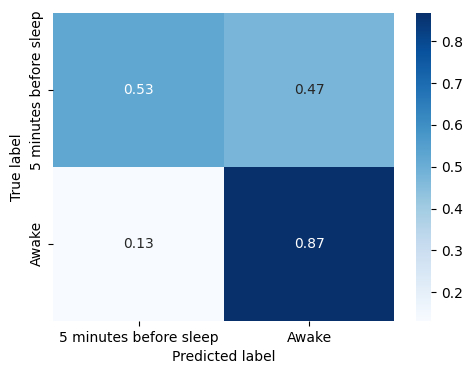

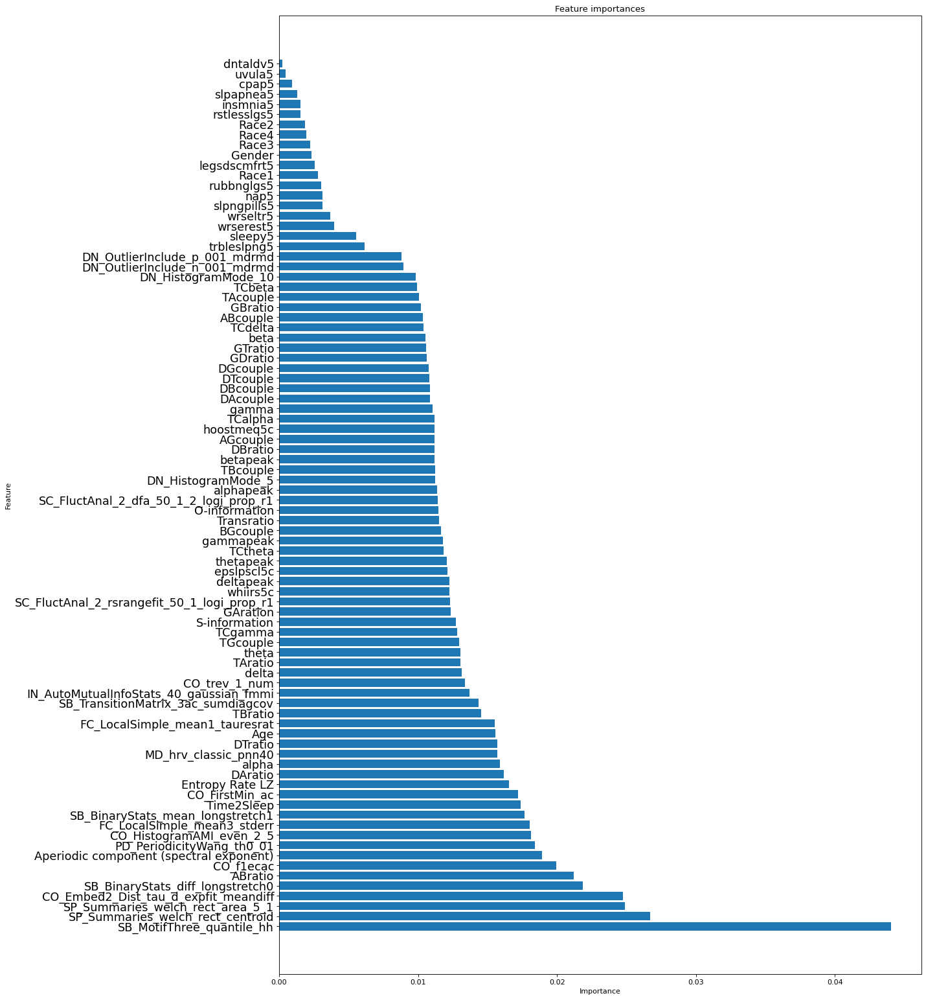

------------------ BorderlineSMOTE ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.8238948966040599
Overall f1-score of fold 1:  0.819593060691677
F1-score of 5 minutes before sleep class 0.5389295914566: 
F1-score of Awake class 0.8911622453466217: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.8176342250047429
Overall f1-score of fold 2:  0.8100831969265644
F1-score of 5 minutes before sleep class 0.5032941480428885: 
F1-score of Awake class 0.8883144043919017: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7983779169038133
Overall f1-score of fold 3:  0.7969095588922634
F1-score of 5 minutes before sleep class 0.4942296252230815: 
F1-score of Awake class 0.8740929419779048: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7966704610130905
Overall f1-score of fold 4:  0.798896138629626
F1-score of 5 minutes before sleep class 0.5145510134752576: 
F1-score of

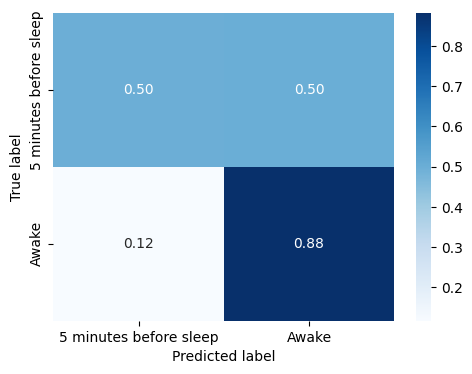

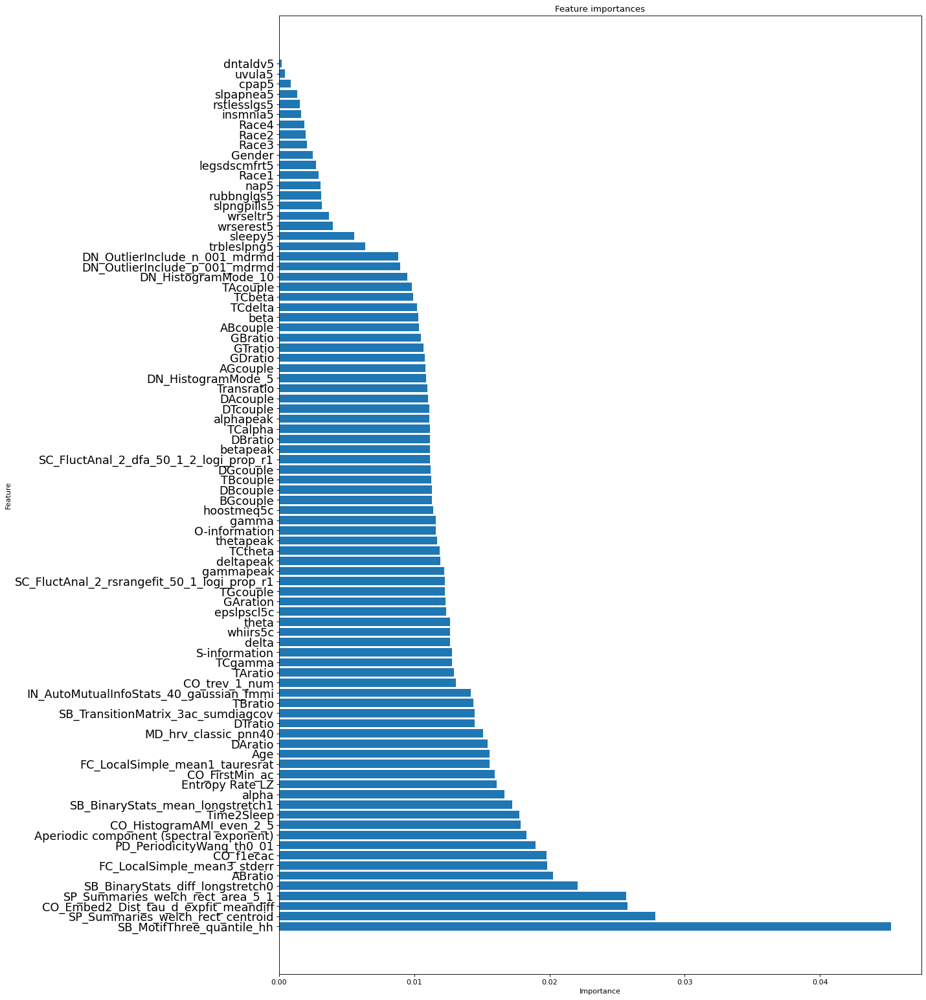

------------------ TomekLinks ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.829823562891292
Overall f1-score of fold 1:  0.8184538454407617
F1-score of 5 minutes before sleep class 0.5103711790393012: 
F1-score of Awake class 0.8970149253731342: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.8251280591918042
Overall f1-score of fold 2:  0.809838982214541
F1-score of 5 minutes before sleep class 0.4756080216185465: 
F1-score of Awake class 0.8950678771665196: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.8184405236198065
Overall f1-score of fold 3:  0.8060700399777824
F1-score of 5 minutes before sleep class 0.47619047619047616: 
F1-score of Awake class 0.8901893287435455: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.8188673875924872
Overall f1-score of fold 4:  0.8105894963693339
F1-score of 5 minutes before sleep class 0.5018912221207774: 
F1-score of 

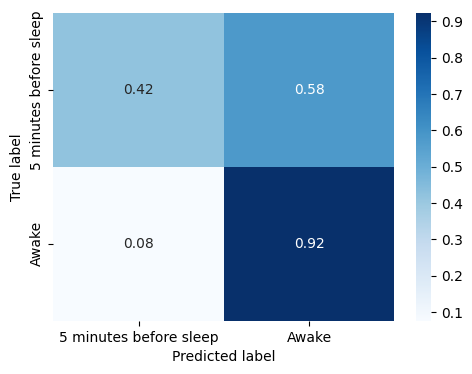

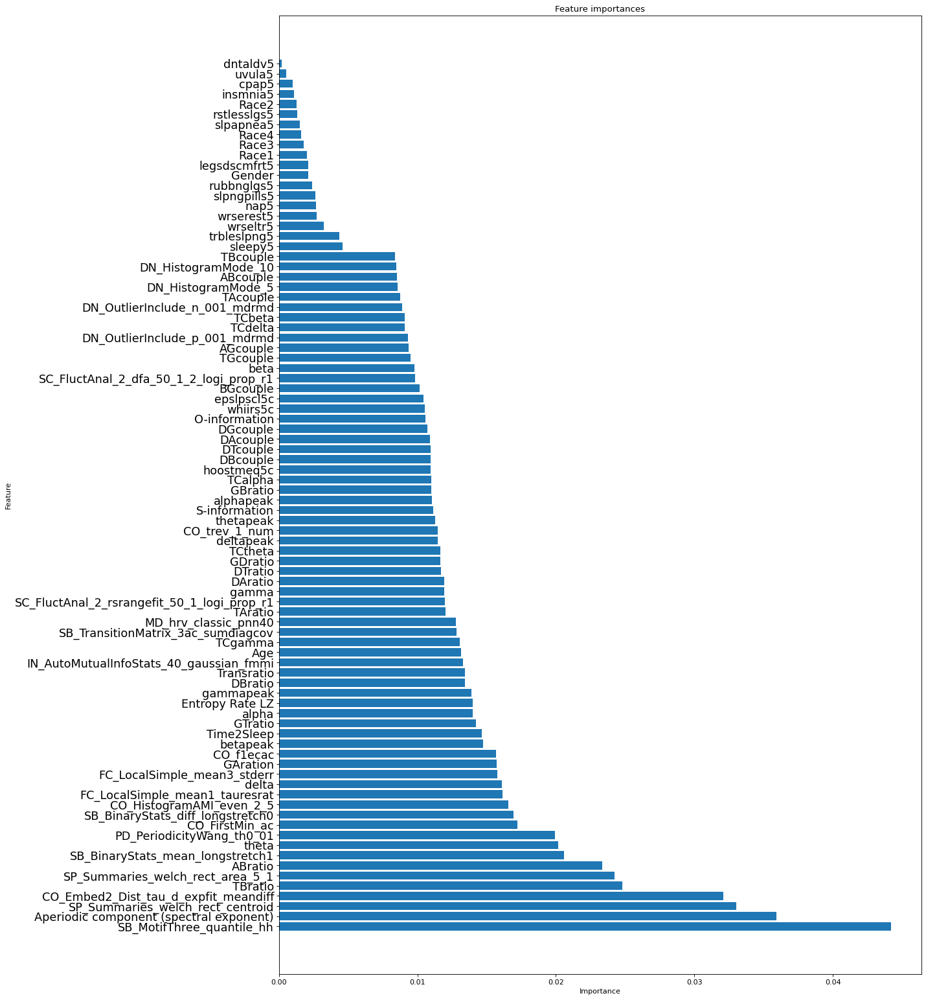

------------------ NearMiss ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.5901631568962247
Overall f1-score of fold 1:  0.6273776896527148
F1-score of 5 minutes before sleep class 0.4574621711558988: 
F1-score of Awake class 0.6707061468694029: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.5973724151014987
Overall f1-score of fold 2:  0.6355236164613306
F1-score of 5 minutes before sleep class 0.4449094356895311: 
F1-score of Awake class 0.6841302325581395: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.5492316448491747
Overall f1-score of fold 3:  0.5883200765593034
F1-score of 5 minutes before sleep class 0.4208409506398538: 
F1-score of Awake class 0.6310272536687631: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.5979415670650731
Overall f1-score of fold 4:  0.6357576928352686
F1-score of 5 minutes before sleep class 0.45050884812341996: 
F1-score of 

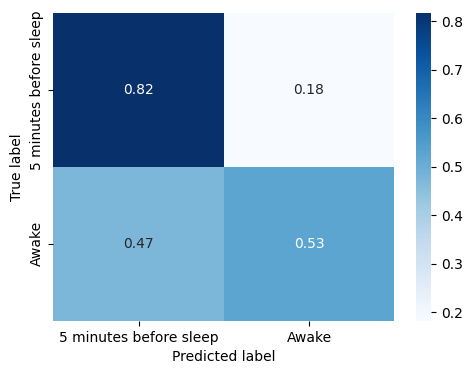

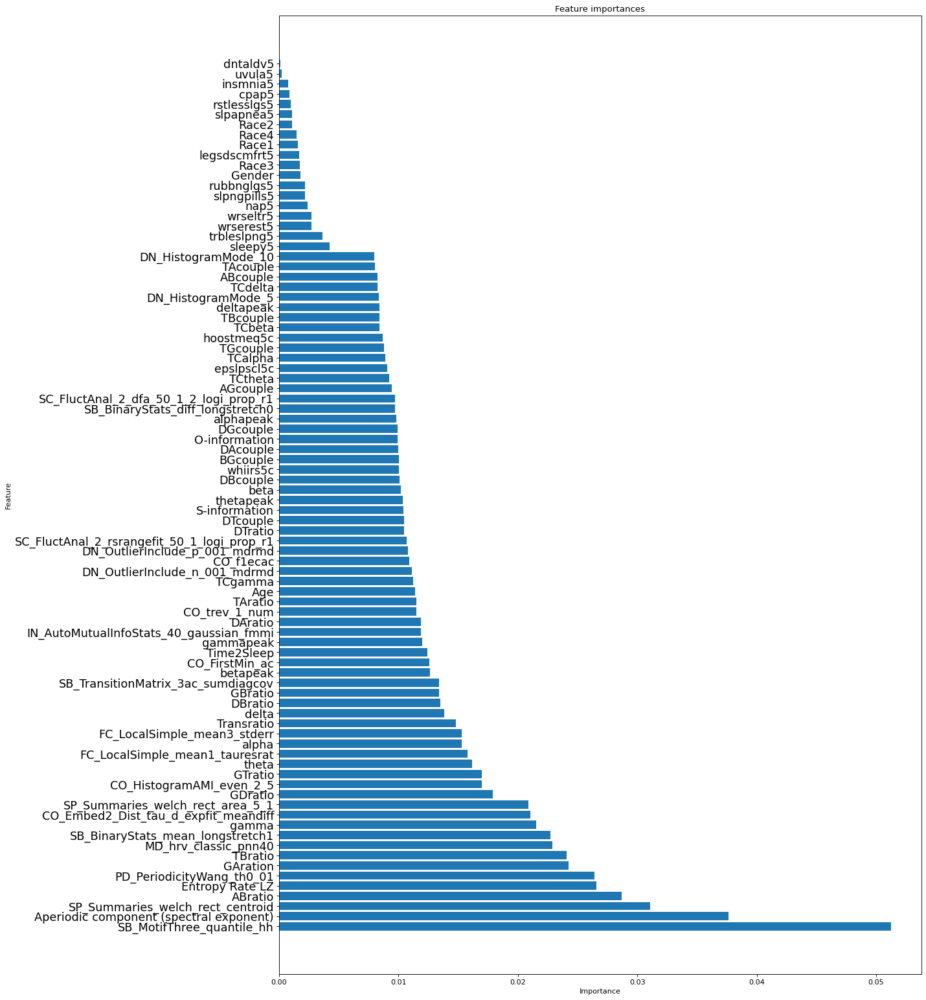

------------------ EditedNearestNeighbours ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.8254126351735913
Overall f1-score of fold 1:  0.8212378530681963
F1-score of 5 minutes before sleep class 0.5434701723924097: 
F1-score of Awake class 0.8920686116405219: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.8165433504078923
Overall f1-score of fold 2:  0.8099303077038339
F1-score of 5 minutes before sleep class 0.5063808065339458: 
F1-score of Awake class 0.8873354305021555: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.8113735534054259
Overall f1-score of fold 3:  0.8069212377883763
F1-score of 5 minutes before sleep class 0.5071260379229149: 
F1-score of Awake class 0.883369013754069: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.8065831910453425
Overall f1-score of fold 4:  0.8076207405269423
F1-score of 5 minutes before sleep class 0.5309408787669657: 

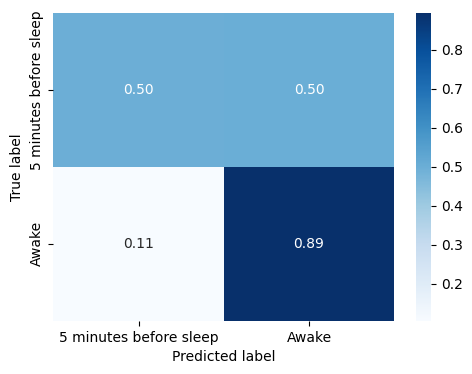

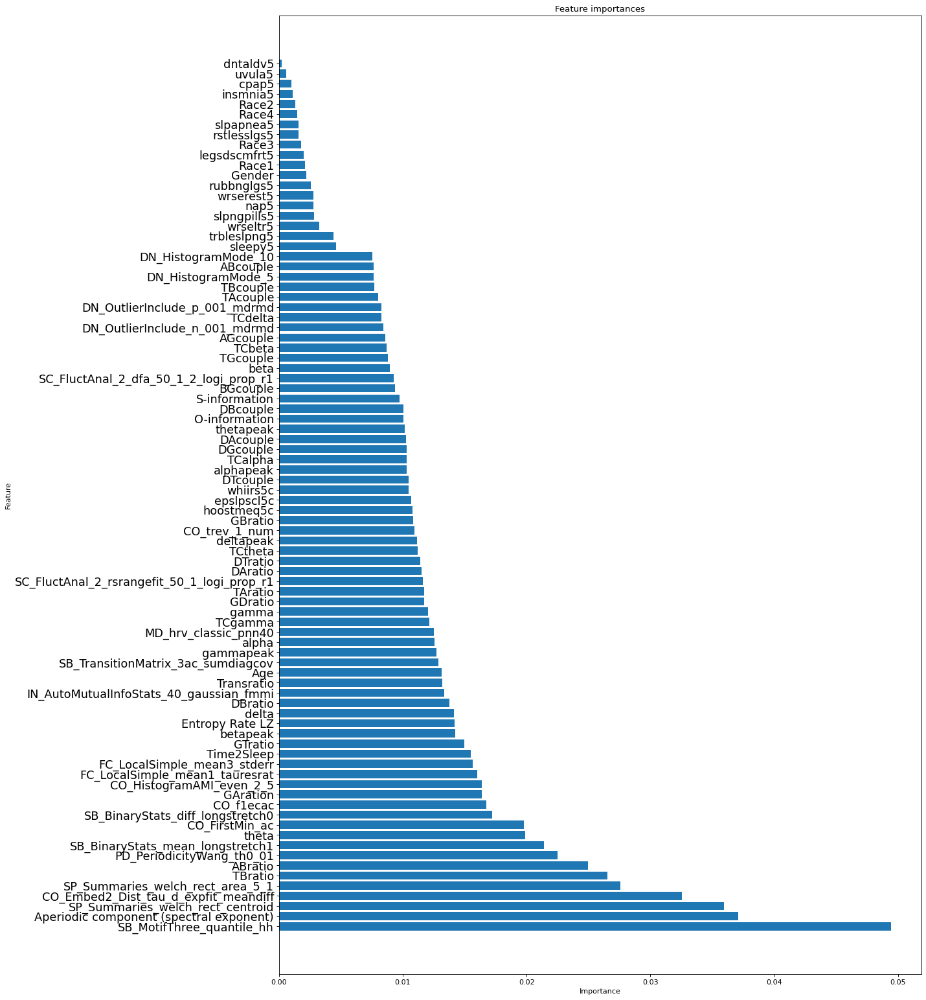

------------------ AllKNN ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.8224720166951243
Overall f1-score of fold 1:  0.819667345170621
F1-score of 5 minutes before sleep class 0.5449240121580547: 
F1-score of Awake class 0.8897268950888254: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.8118952760387024
Overall f1-score of fold 2:  0.8077148951429756
F1-score of 5 minutes before sleep class 0.5101284584980237: 
F1-score of Awake class 0.8835994364874383: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.8081957882754696
Overall f1-score of fold 3:  0.8060760371126179
F1-score of 5 minutes before sleep class 0.5141758769822201: 
F1-score of Awake class 0.8805105779458692: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.8061088977423638
Overall f1-score of fold 4:  0.8075179283053984
F1-score of 5 minutes before sleep class 0.5322654462242563: 
F1-score of Awak

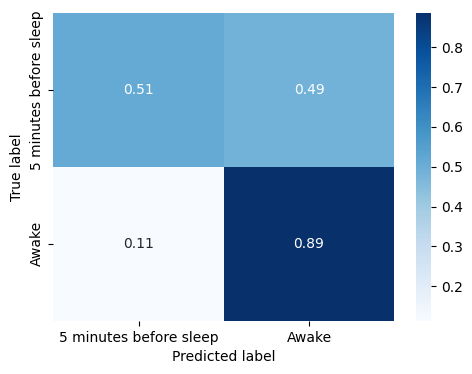

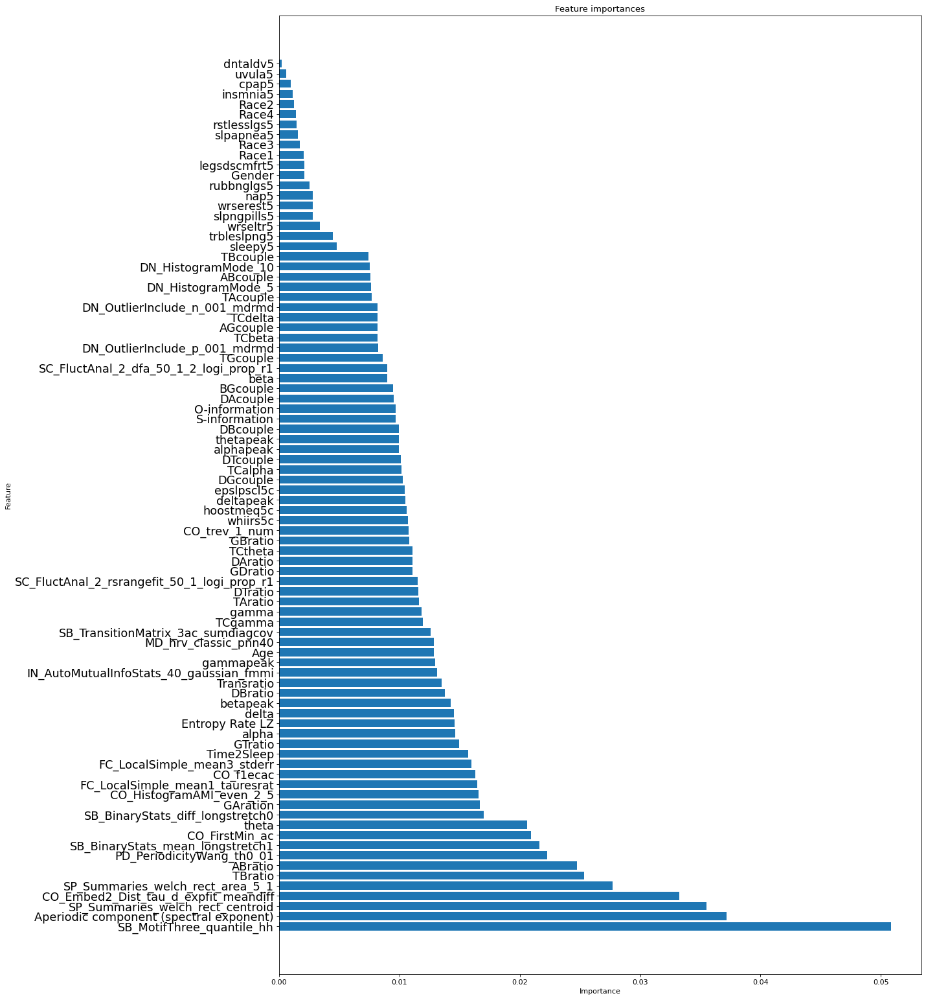

------------------ OneSidedSelection ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.8321950294061848
Overall f1-score of fold 1:  0.820895115589067
F1-score of 5 minutes before sleep class 0.5166666666666666: 
F1-score of Awake class 0.8984733700642792: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.8238948966040599
Overall f1-score of fold 2:  0.808446509061661
F1-score of 5 minutes before sleep class 0.4716095061904084: 
F1-score of Awake class 0.8943399447938306: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.8178239423259344
Overall f1-score of fold 3:  0.8053266841892329
F1-score of 5 minutes before sleep class 0.4739076838789207: 
F1-score of Awake class 0.8898385292683626: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.8185828116107
Overall f1-score of fold 4:  0.8098625873356234
F1-score of 5 minutes before sleep class 0.4984921987675365: 
F1-score 

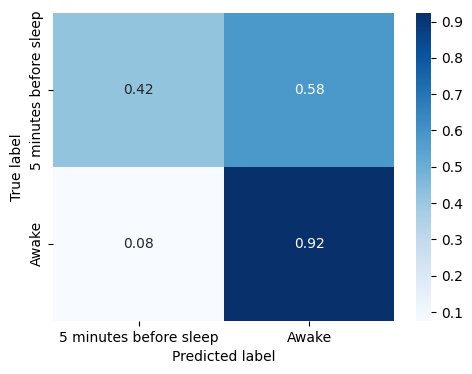

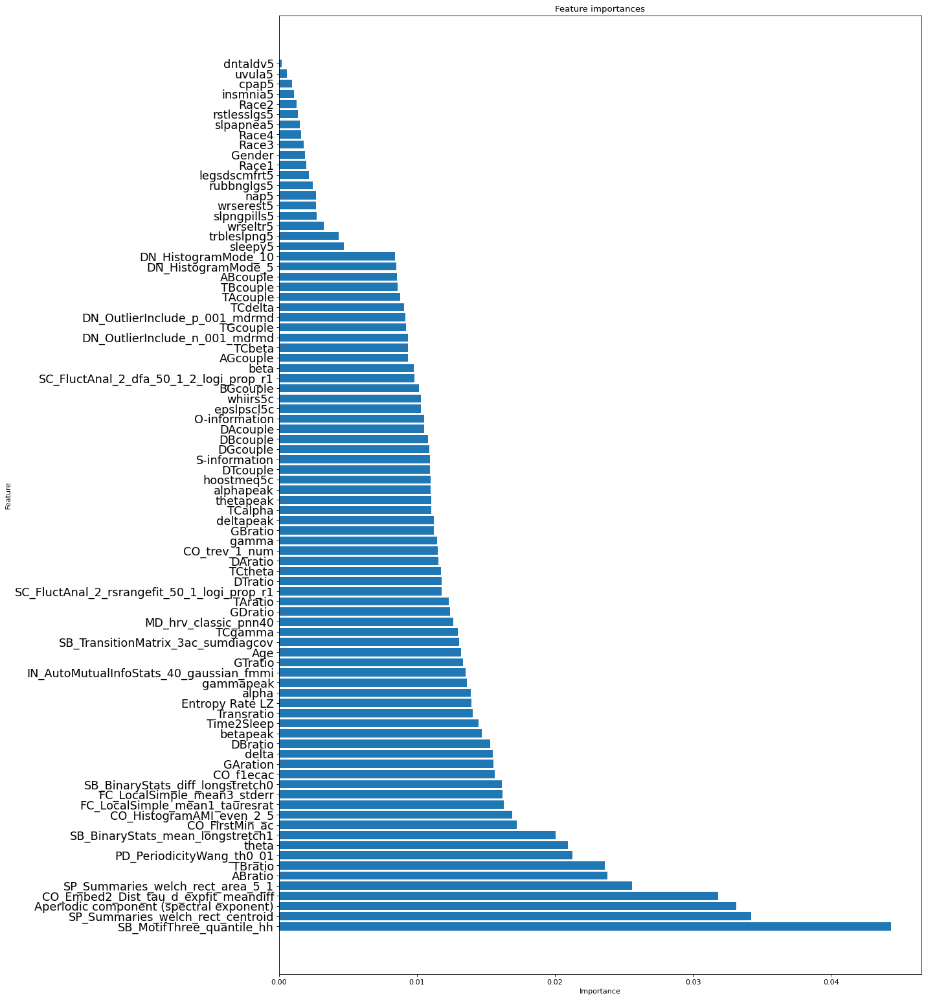

In [47]:

results_5_10 = try_resampling_methods(resampling_methods, data_train, pre_onset_time = 5, awake_time = 10, model_type = 'Random Forest', test_size = 0.2, n_splits=5, random_seed = 42)


In [ ]:
# 

## Try 5 minutes prior to sleep onset and 15-30 first minute before sleep

------------------ Random Oversampling ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.7935915659796257
Overall f1-score of fold 1:  0.7901964398307068
F1-score of 5 minutes before sleep class 0.5735959867857581: 
F1-score of Awake class 0.8638405938659893: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7957829898128406
Overall f1-score of fold 2:  0.7954818514992091
F1-score of 5 minutes before sleep class 0.5957796014067995: 
F1-score of Awake class 0.8633806165306284: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7877280265339967
Overall f1-score of fold 3:  0.7863081941286943
F1-score of 5 minutes before sleep class 0.5733333333333334: 
F1-score of Awake class 0.8587196467991172: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.8097607202084814
Overall f1-score of fold 4:  0.8094355149686447
F1-score of 5 minutes before sleep class 0.6231816048803379: 
F1

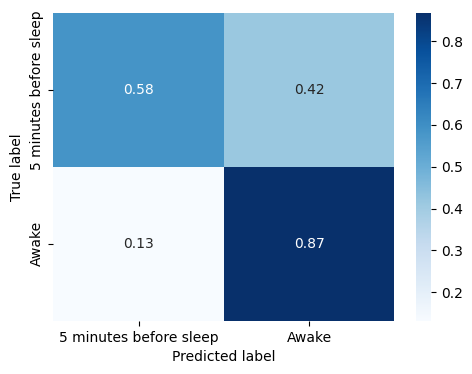

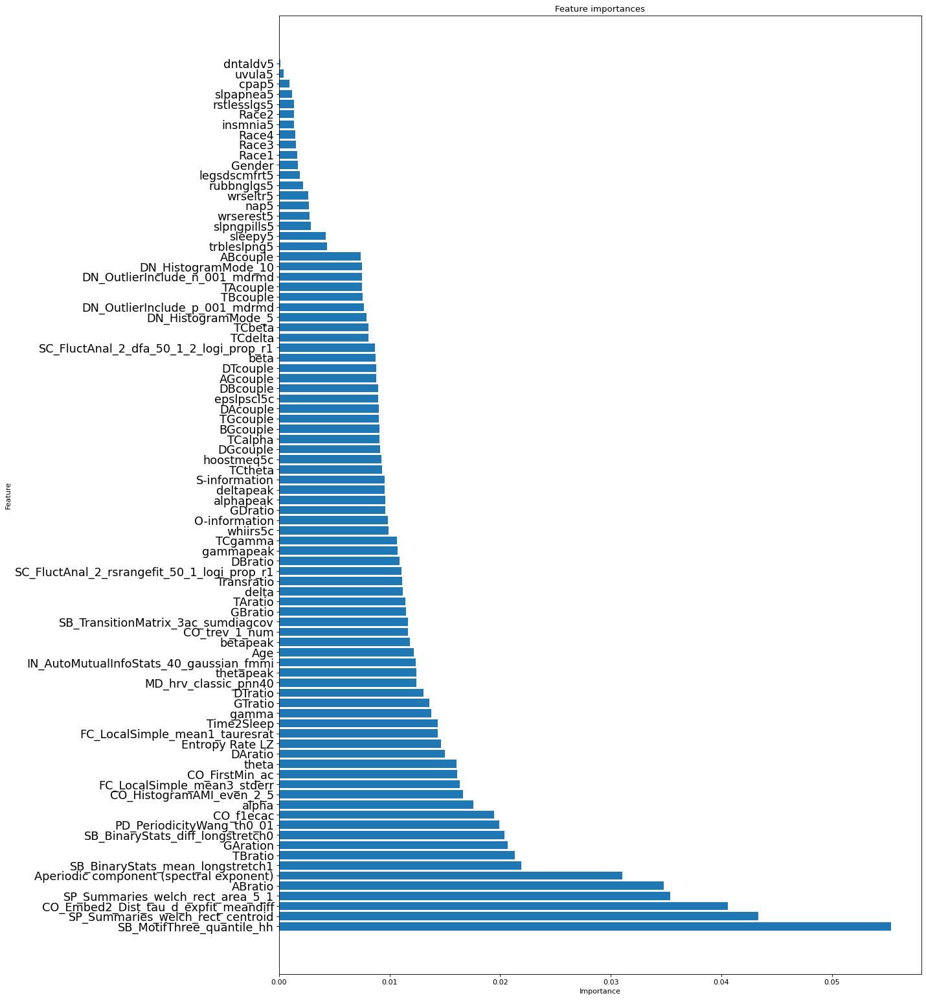

------------------ Random Undersampling ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.7475124378109452
Overall f1-score of fold 1:  0.7605323733019664
F1-score of 5 minutes before sleep class 0.5967268943335541: 
F1-score of Awake class 0.8162262361512265: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.763563136697465
Overall f1-score of fold 2:  0.7758010695806191
F1-score of 5 minutes before sleep class 0.6228269085411943: 
F1-score of Awake class 0.8278122843340234: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7356669035773513
Overall f1-score of fold 3:  0.7500450316291802
F1-score of 5 minutes before sleep class 0.5857235681797085: 
F1-score of Awake class 0.8059143292020006: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7786069651741293
Overall f1-score of fold 4:  0.7906465148944848
F1-score of 5 minutes before sleep class 0.6529892313405125: 
F1

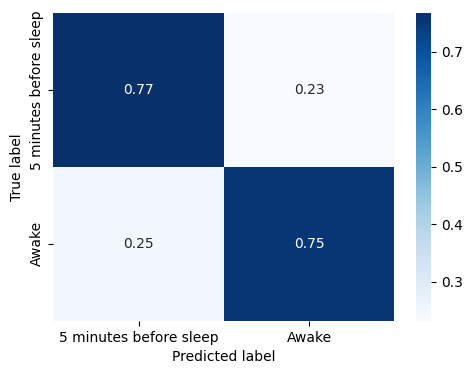

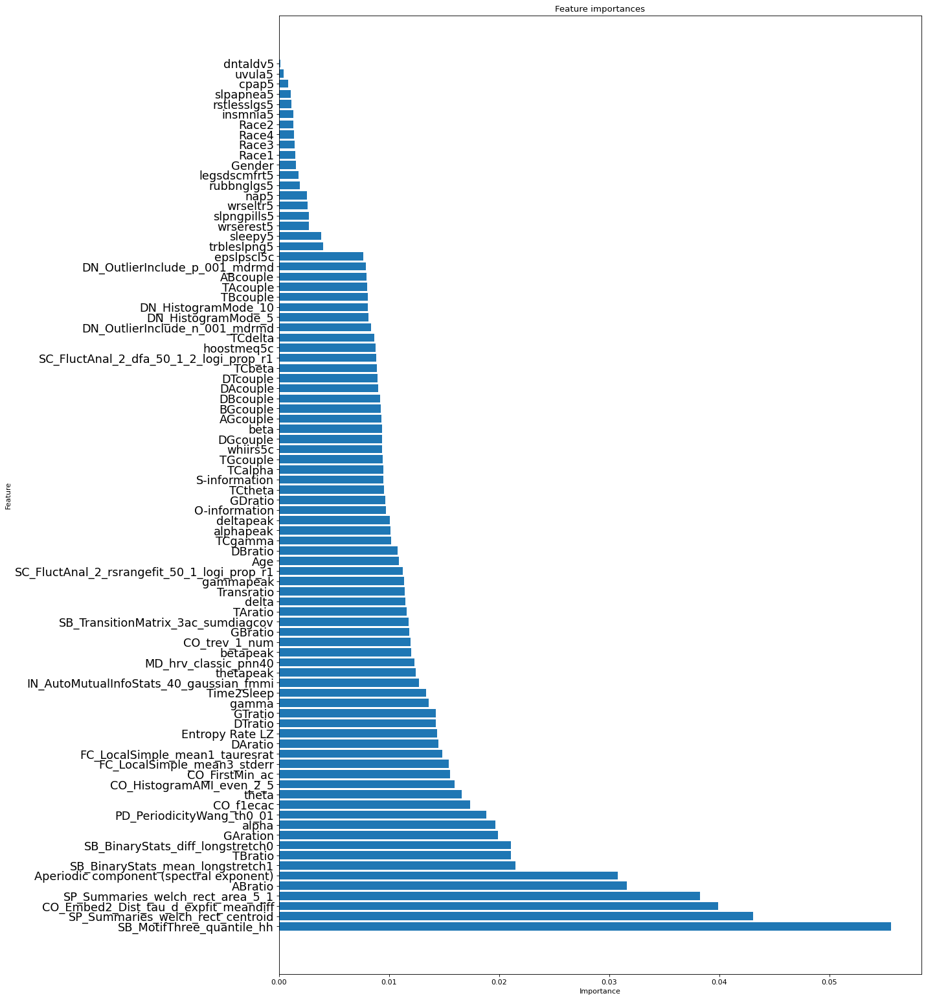

------------------ SMOTE ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.7864842454394693
Overall f1-score of fold 1:  0.7894046654531074
F1-score of 5 minutes before sleep class 0.5972517037202547: 
F1-score of Awake class 0.8547366724422775: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7864250177683013
Overall f1-score of fold 2:  0.7911654544642291
F1-score of 5 minutes before sleep class 0.6090633130962706: 
F1-score of Awake class 0.853080182529335: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7712035062781332
Overall f1-score of fold 3:  0.7765157450119534
F1-score of 5 minutes before sleep class 0.5827843179609029: 
F1-score of Awake class 0.8423844302093108: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7990405117270789
Overall f1-score of fold 4:  0.8040515413863549
F1-score of 5 minutes before sleep class 0.6359051400364846: 
F1-score of Awake

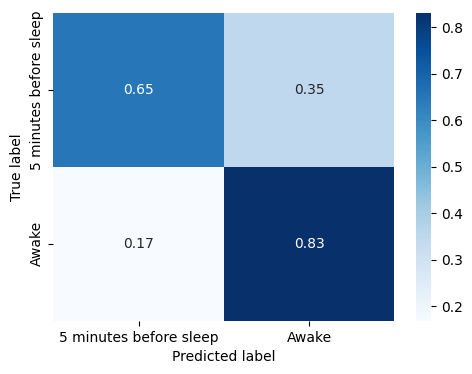

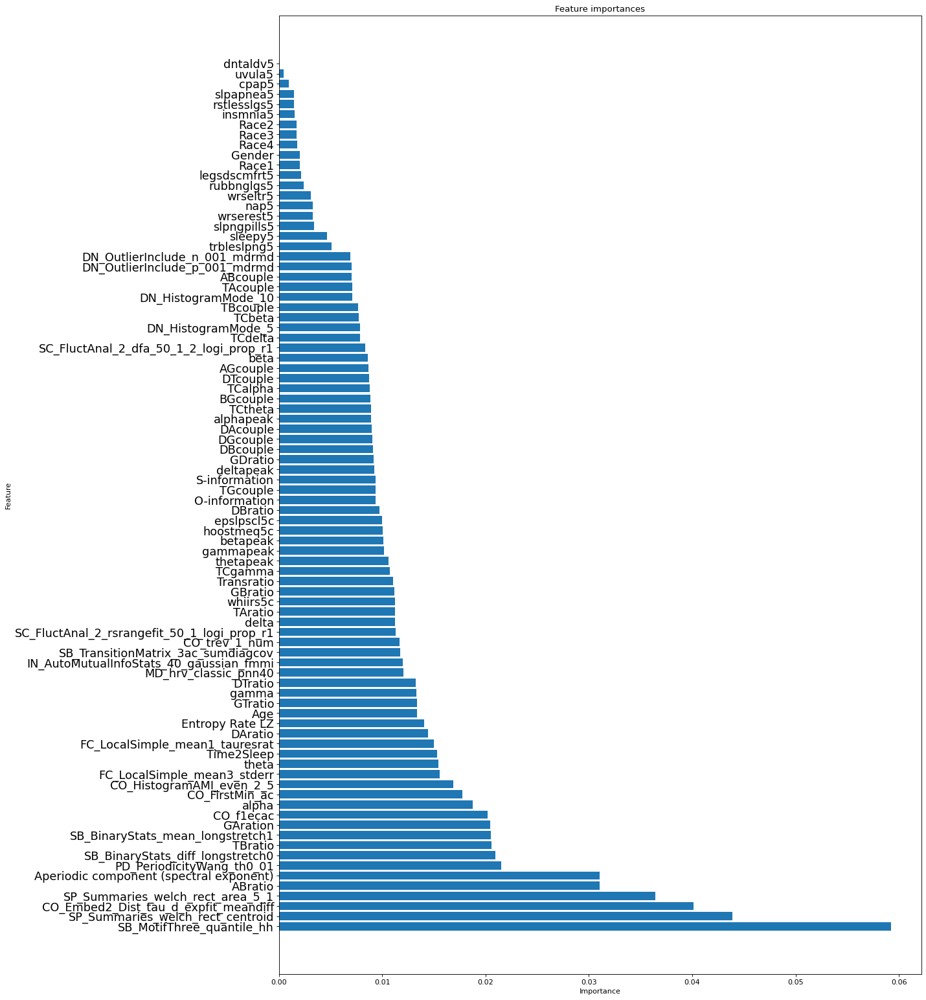

------------------ ADASYN ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.7783700544894575
Overall f1-score of fold 1:  0.781173202706348
F1-score of 5 minutes before sleep class 0.5804932735426008: 
F1-score of Awake class 0.849404378622022: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7901563610518835
Overall f1-score of fold 2:  0.794520730821946
F1-score of 5 minutes before sleep class 0.6139261196469435: 
F1-score of Awake class 0.8559228986214468: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7620232172470979
Overall f1-score of fold 3:  0.7685570576844344
F1-score of 5 minutes before sleep class 0.5730074388947928: 
F1-score of Awake class 0.8350439280729124: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.8028310826818289
Overall f1-score of fold 4:  0.8079575143243365
F1-score of 5 minutes before sleep class 0.644223575932457: 
F1-score of Awake c

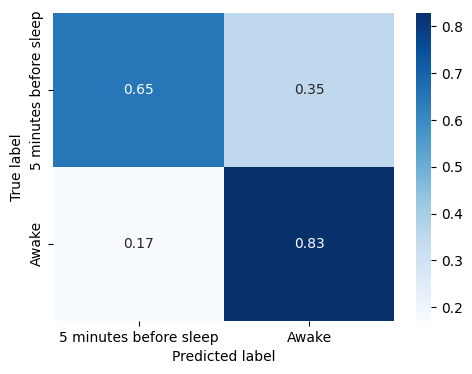

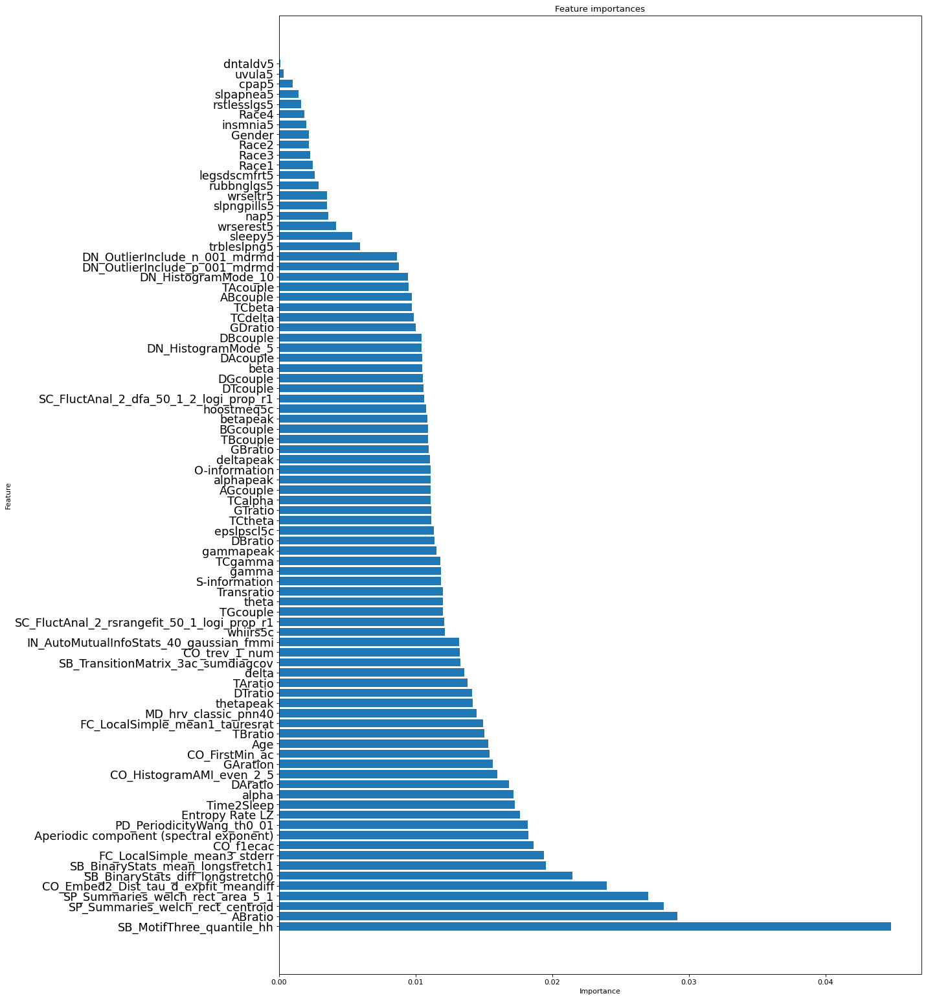

------------------ BorderlineSMOTE ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.7887348969438521
Overall f1-score of fold 1:  0.7887755416385855
F1-score of 5 minutes before sleep class 0.5839262801819667: 
F1-score of Awake class 0.858424290533836: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7916370528310827
Overall f1-score of fold 2:  0.7948879095007172
F1-score of 5 minutes before sleep class 0.6095449500554938: 
F1-score of Awake class 0.857904515712093: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.771558872305141
Overall f1-score of fold 3:  0.7757233683188403
F1-score of 5 minutes before sleep class 0.575827559661278: 
F1-score of Awake class 0.8436879432624114: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.8063847429519071
Overall f1-score of fold 4:  0.8098176379817302
F1-score of 5 minutes before sleep class 0.6398589842458963: 
F1-score o

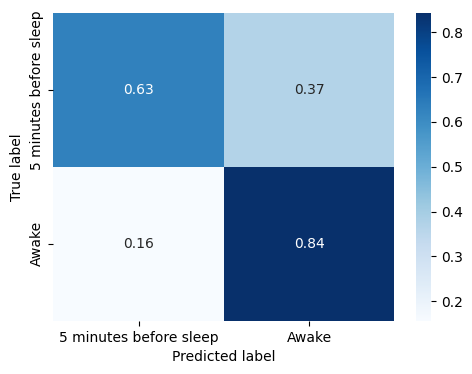

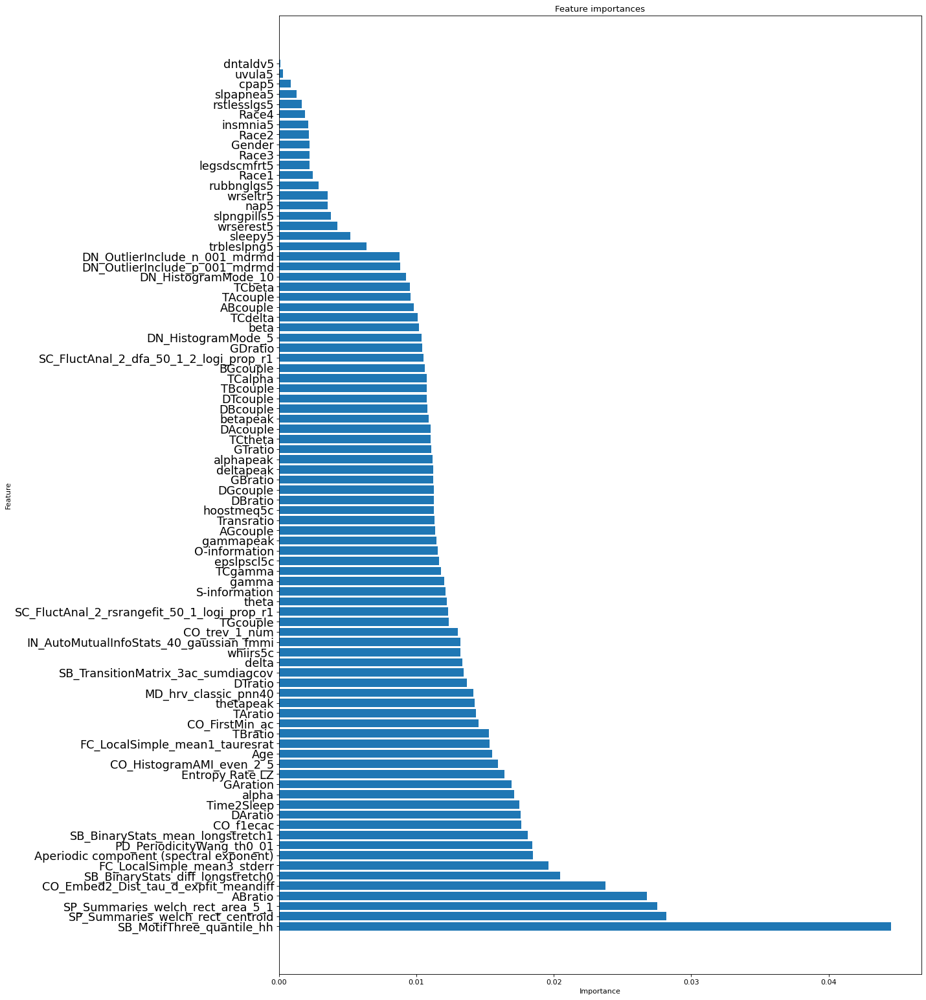

------------------ TomekLinks ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.793058516939114
Overall f1-score of fold 1:  0.7885816577383936
F1-score of 5 minutes before sleep class 0.5665012406947891: 
F1-score of Awake class 0.8640889995332192: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.8005212035062781
Overall f1-score of fold 2:  0.7977625681627157
F1-score of 5 minutes before sleep class 0.5908649173955296: 
F1-score of Awake class 0.8681077694235589: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7947168917318171
Overall f1-score of fold 3:  0.7904676502014352
F1-score of 5 minutes before sleep class 0.571039603960396: 
F1-score of Awake class 0.8650731859233884: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.816453447050462
Overall f1-score of fold 4:  0.8122839262188514
F1-score of 5 minutes before sleep class 0.614408361328854: 
F1-score of Awa

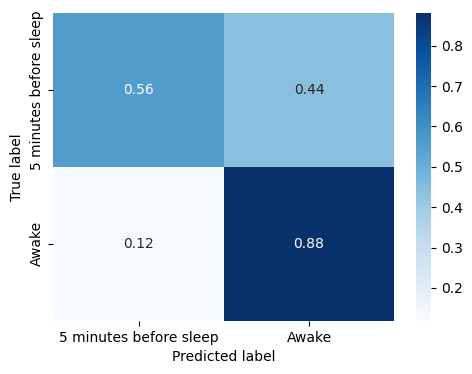

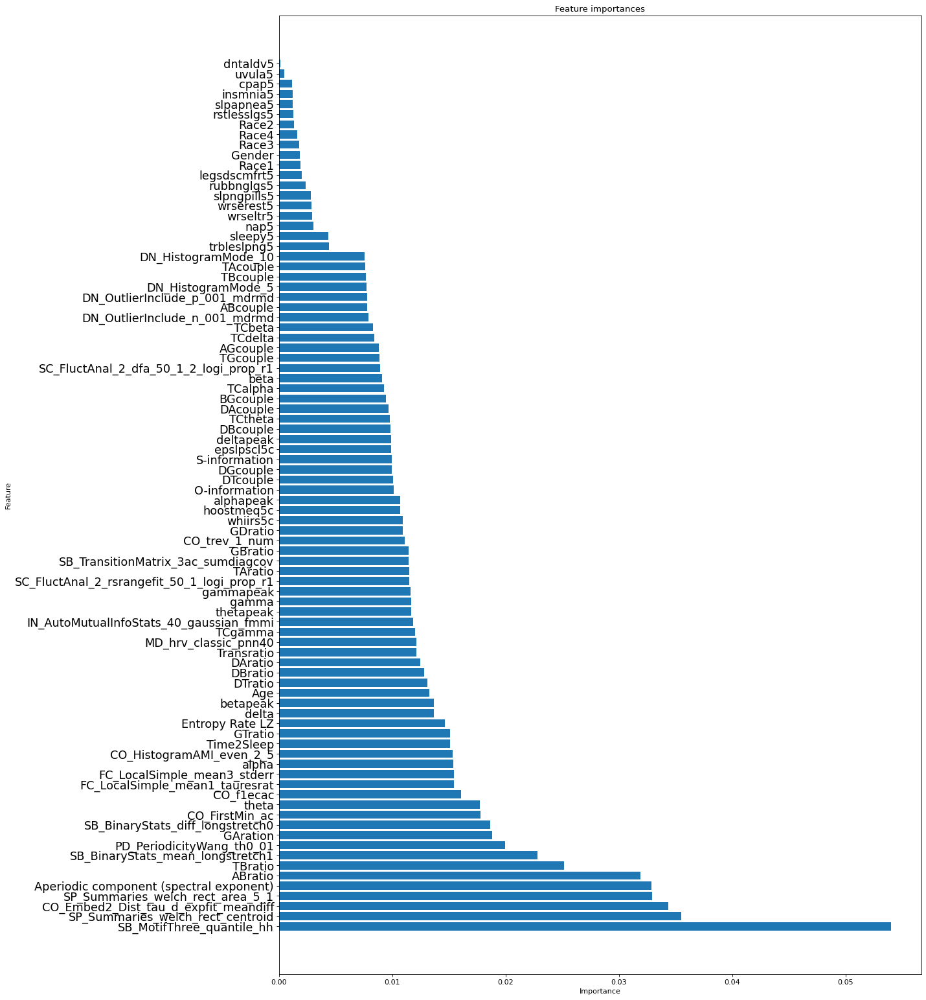

------------------ NearMiss ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.6617507699597251
Overall f1-score of fold 1:  0.683570316461789
F1-score of 5 minutes before sleep class 0.5521837998902219: 
F1-score of Awake class 0.7282417320961219: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.6571902392797915
Overall f1-score of fold 2:  0.6792591355650526
F1-score of 5 minutes before sleep class 0.5480949406620862: 
F1-score of Awake class 0.7238549618320611: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.6451670220326937
Overall f1-score of fold 3:  0.6681438006341067
F1-score of 5 minutes before sleep class 0.5247878162925359: 
F1-score of Awake class 0.7168848353102406: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.6539919450367212
Overall f1-score of fold 4:  0.6757066557963006
F1-score of 5 minutes before sleep class 0.5580269329701922: 
F1-score of Aw

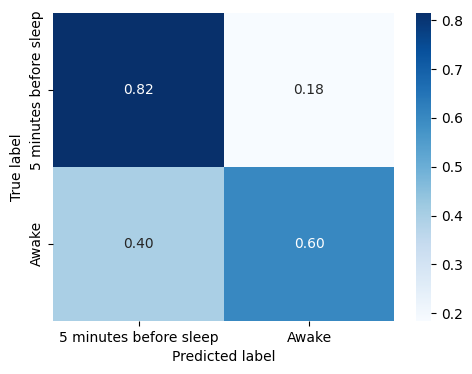

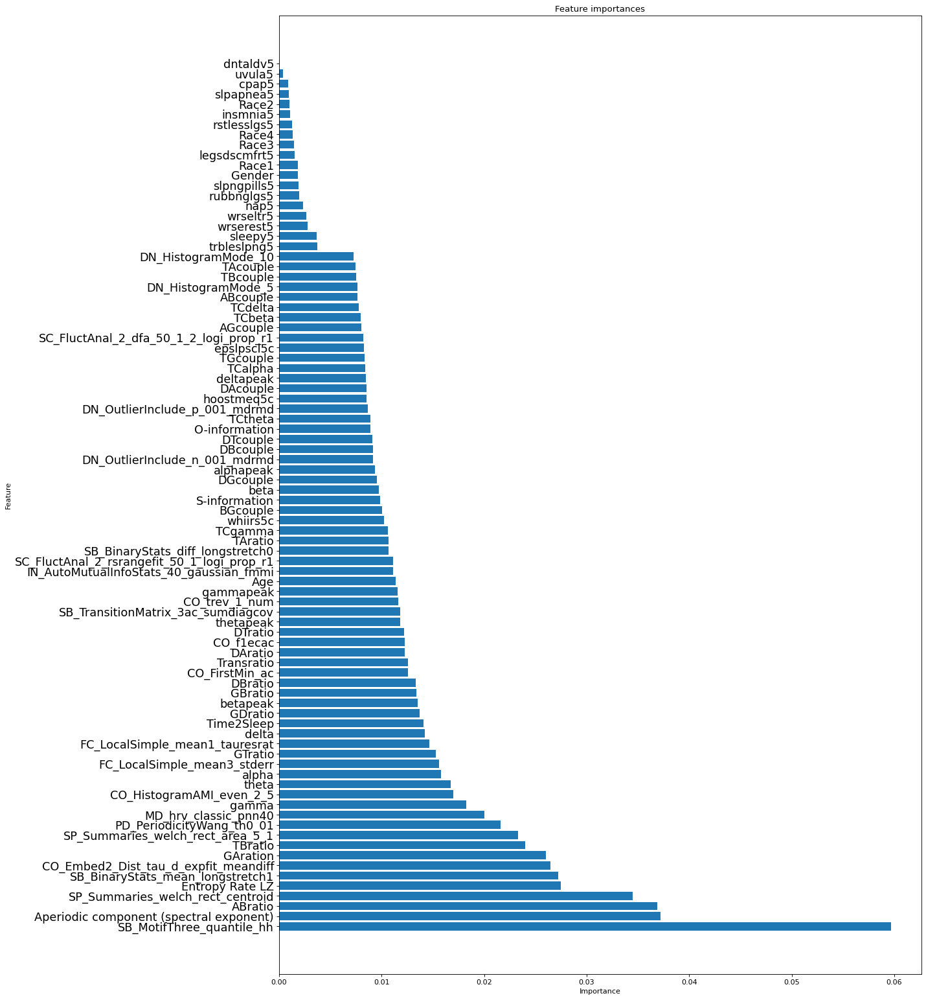

------------------ EditedNearestNeighbours ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.7866027007818053
Overall f1-score of fold 1:  0.786953136172631
F1-score of 5 minutes before sleep class 0.5815816978283591: 
F1-score of Awake class 0.8567794252096833: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7912816868040748
Overall f1-score of fold 2:  0.7929456550259208
F1-score of 5 minutes before sleep class 0.598816029143898: 
F1-score of Awake class 0.8589497278258086: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7839374555792467
Overall f1-score of fold 3:  0.7841856345696583
F1-score of 5 minutes before sleep class 0.575715282623866: 
F1-score of Awake class 0.8550655542312277: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.808753849798626
Overall f1-score of fold 4:  0.8098473325241502
F1-score of 5 minutes before sleep class 0.6297442953789704: 
F1

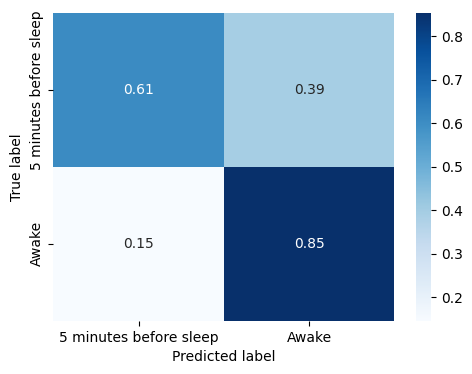

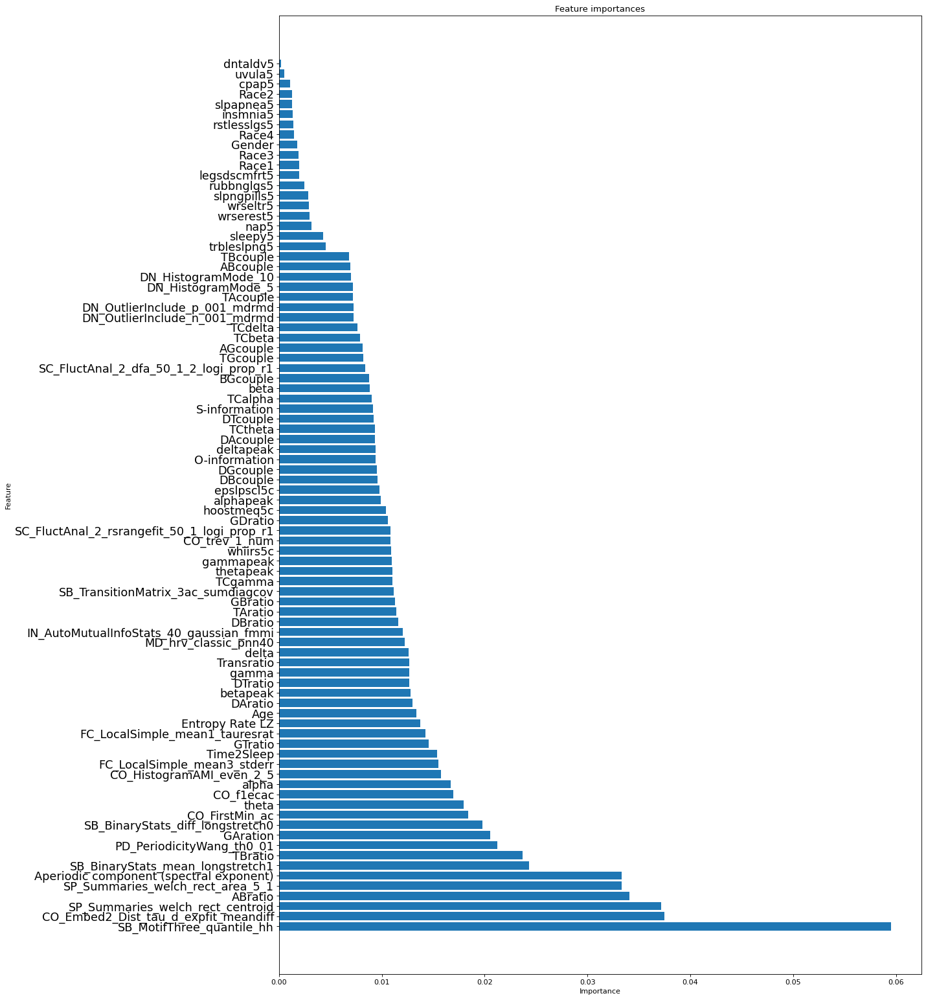

------------------ AllKNN ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.7860104240701256
Overall f1-score of fold 1:  0.7873267892912412
F1-score of 5 minutes before sleep class 0.5862819191572197: 
F1-score of Awake class 0.8556820451368085: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7935323383084577
Overall f1-score of fold 2:  0.7954534852258517
F1-score of 5 minutes before sleep class 0.6048515075946498: 
F1-score of Awake class 0.8602581576204603: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7786069651741293
Overall f1-score of fold 3:  0.7800406116038606
F1-score of 5 minutes before sleep class 0.5724090597117364: 
F1-score of Awake class 0.8506353392471828: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.8123667377398721
Overall f1-score of fold 4:  0.8141517609246482
F1-score of 5 minutes before sleep class 0.6411418214771183: 
F1-score of Awa

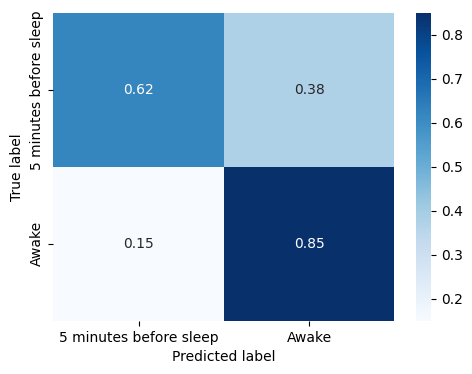

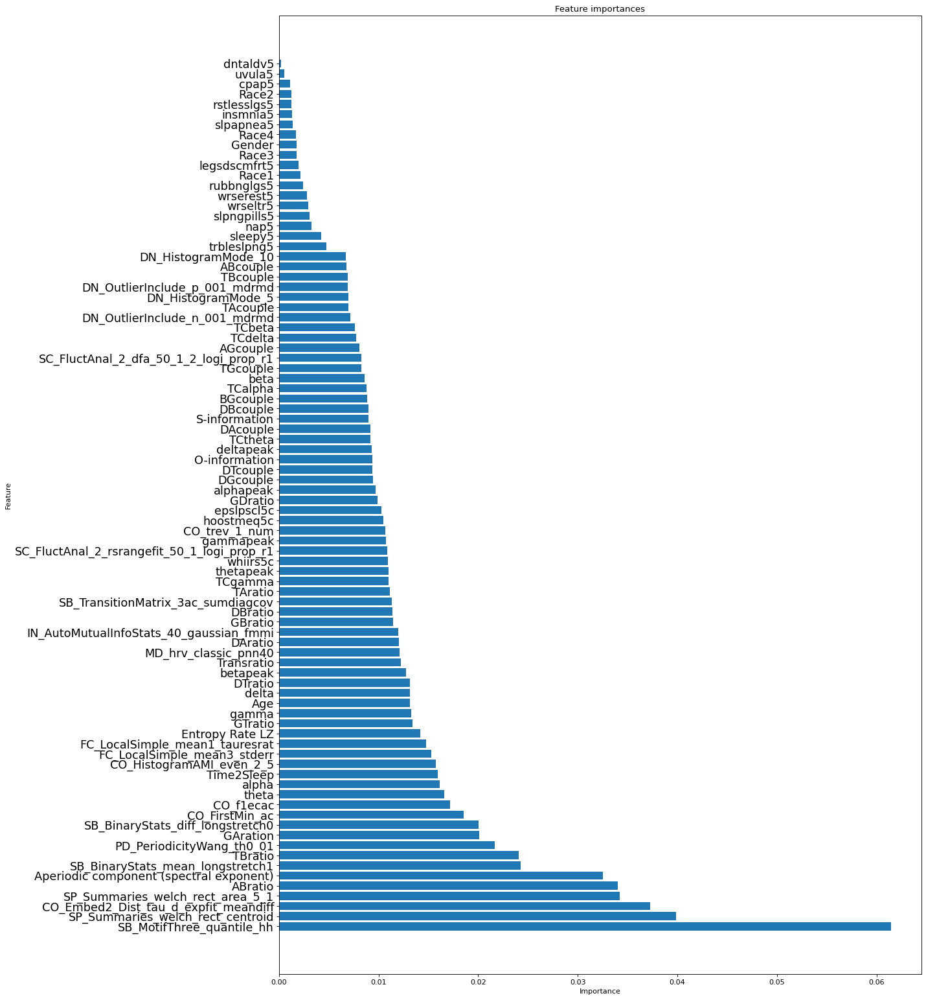

------------------ OneSidedSelection ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.7956645344705047
Overall f1-score of fold 1:  0.7909937572303992
F1-score of 5 minutes before sleep class 0.5705750560119491: 
F1-score of Awake class 0.8659361156446724: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7990997393982469
Overall f1-score of fold 2:  0.7965844822083508
F1-score of 5 minutes before sleep class 0.589445654805132: 
F1-score of Awake class 0.867011683525445: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.7938284766642976
Overall f1-score of fold 3:  0.7895896047810632
F1-score of 5 minutes before sleep class 0.5693430656934305: 
F1-score of Awake class 0.8644734280708584: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.8126628760957119
Overall f1-score of fold 4:  0.8086013429221703
F1-score of 5 minutes before sleep class 0.6075195433676635: 
F1-sco

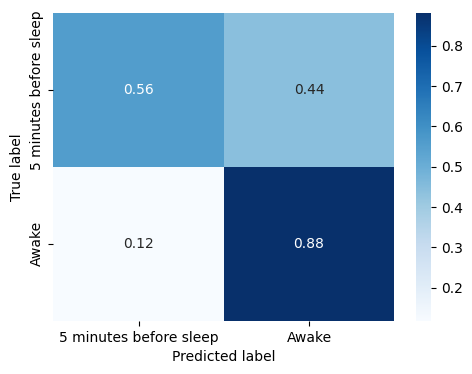

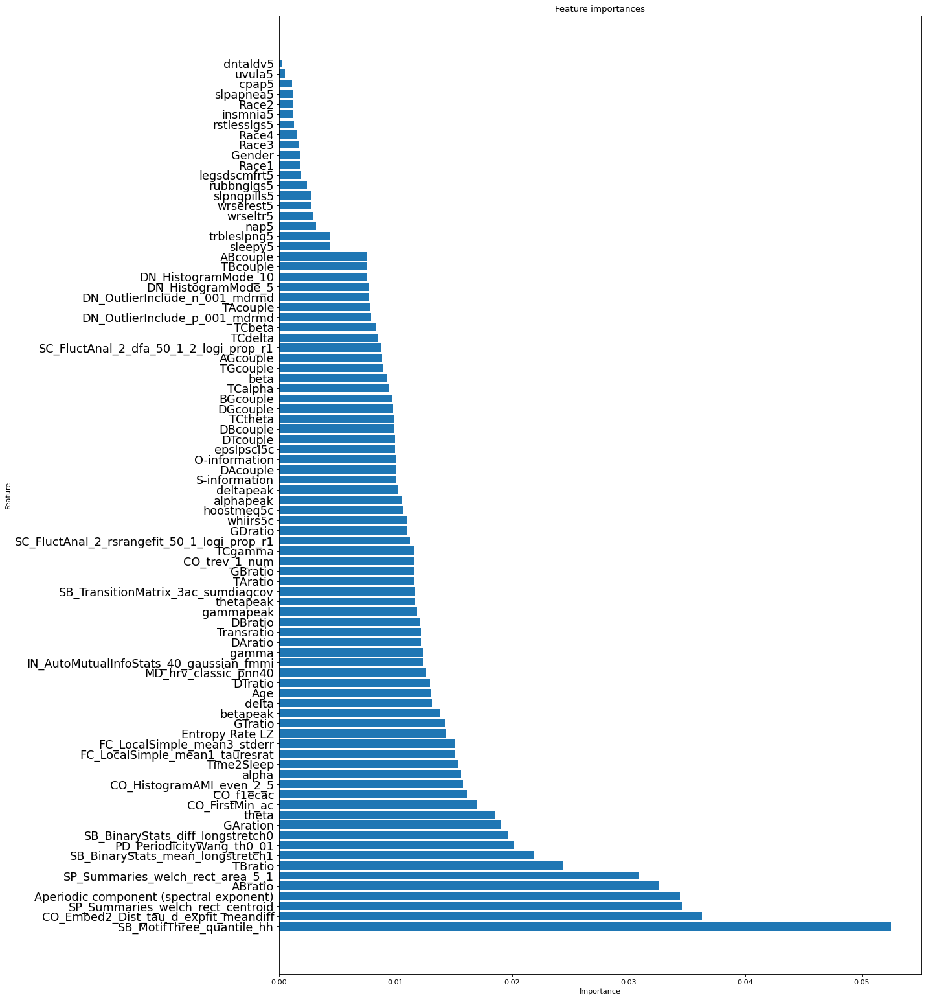

In [50]:
results_5_15 = try_resampling_methods(resampling_methods, data_train, pre_onset_time = 5, awake_time = 15, model_type = 'Random Forest', test_size = 0.2, n_splits=5, random_seed = 42)

------------------ Random Oversampling ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.7009920634920634
Overall f1-score of fold 1:  0.699663975277002
F1-score of 10 minutes before sleep class 0.5481259370314843: 
F1-score of Awake class 0.7765752409191994: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.6994444444444444
Overall f1-score of fold 2:  0.6960707340415333
F1-score of 10 minutes before sleep class 0.5344806392132759: 
F1-score of Awake class 0.7780837972458247: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.6882539682539682
Overall f1-score of fold 3:  0.685384732018251
F1-score of 10 minutes before sleep class 0.5205663371170512: 
F1-score of Awake class 0.7690362791791615: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7047222222222222
Overall f1-score of fold 4:  0.6976970291514264
F1-score of 10 minutes before sleep class 0.5235930597349381: 


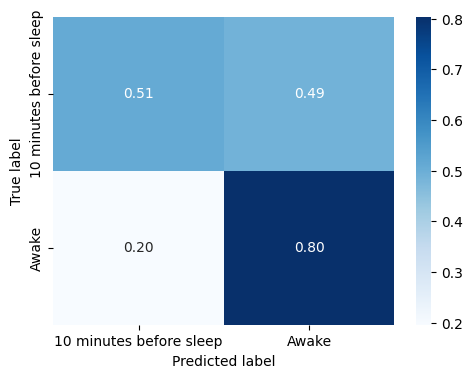

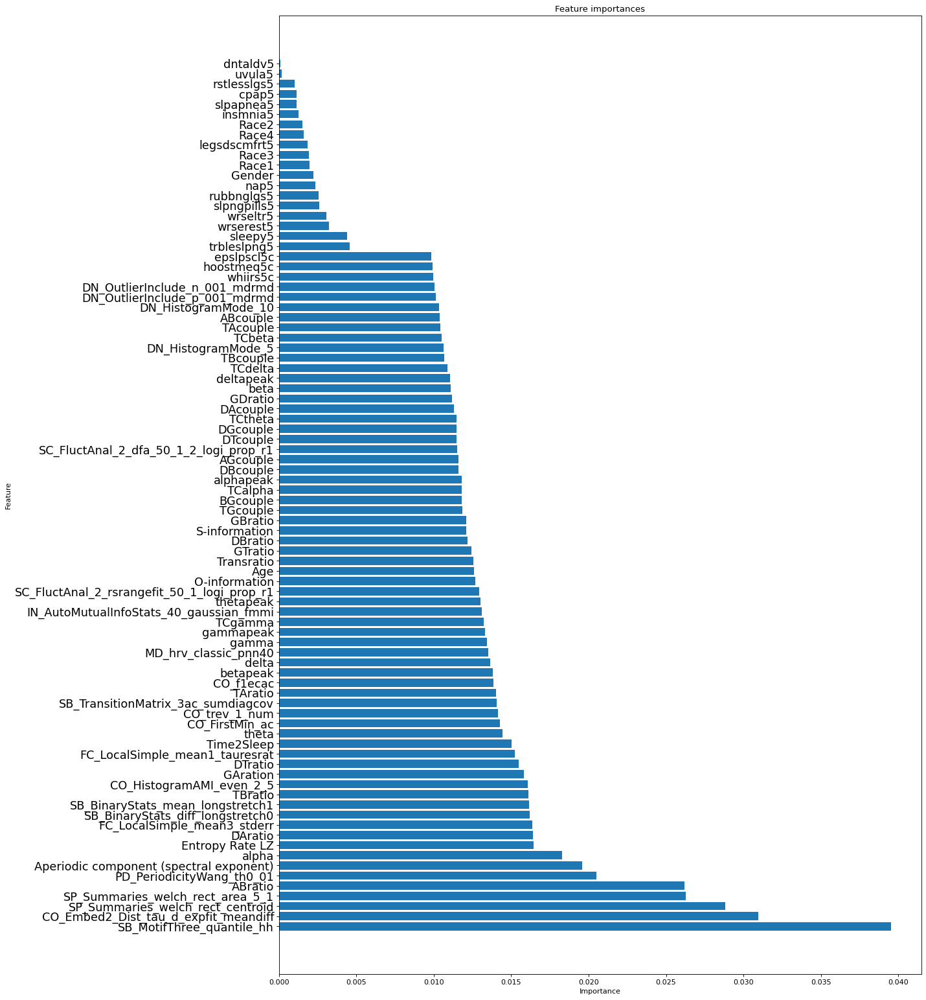

------------------ Random Undersampling ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.682936507936508
Overall f1-score of fold 1:  0.6908754922929782
F1-score of 10 minutes before sleep class 0.5954020660320033: 
F1-score of Awake class 0.7393318543651312: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.6777380952380953
Overall f1-score of fold 2:  0.6857192351143087
F1-score of 10 minutes before sleep class 0.58736852802195: 
F1-score of Awake class 0.7356359256486212: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.652063492063492
Overall f1-score of fold 3:  0.6604890865724685
F1-score of 10 minutes before sleep class 0.5516465534874208: 
F1-score of Awake class 0.7157307742186486: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.6867460317460318
Overall f1-score of fold 4:  0.693058508100605
F1-score of 10 minutes before sleep class 0.5813978152508219: 
F1

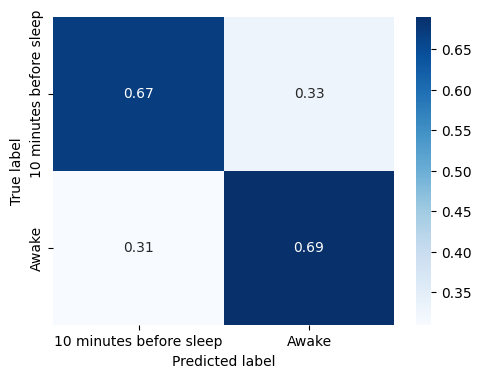

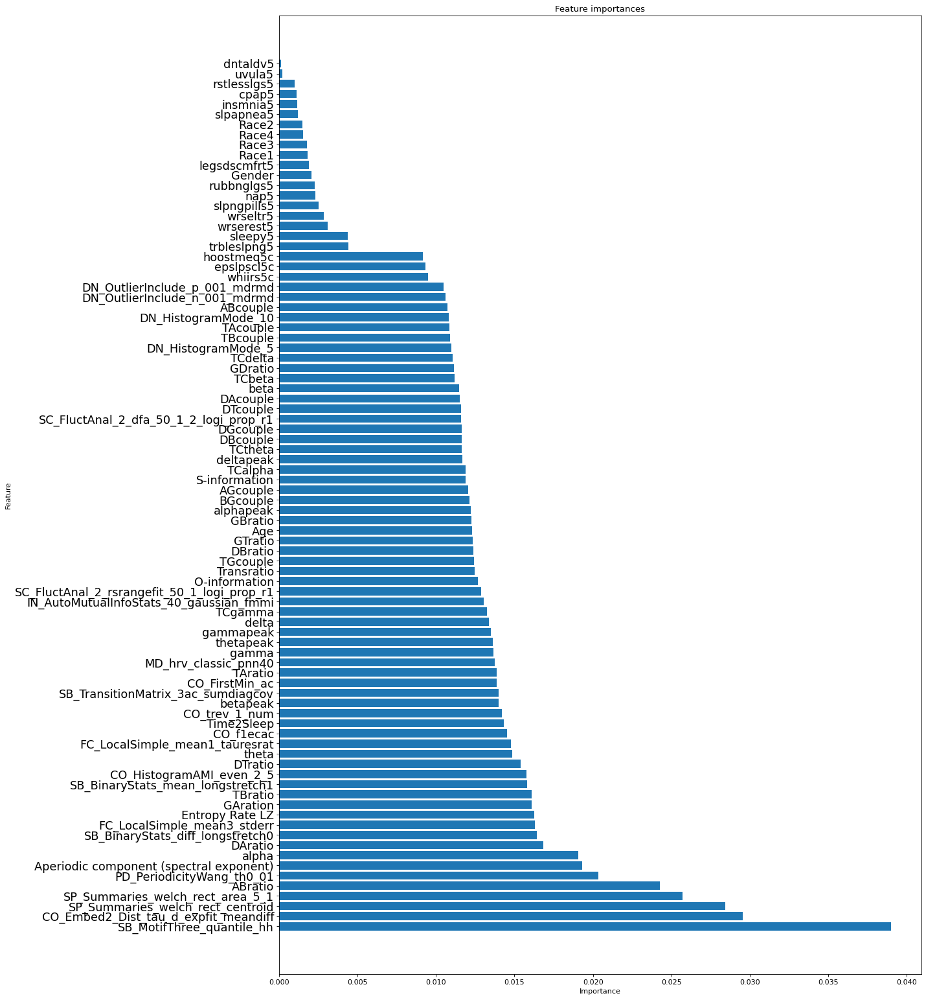

------------------ SMOTE ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.6979761904761905
Overall f1-score of fold 1:  0.701130491527331
F1-score of 10 minutes before sleep class 0.5720551026145628: 
F1-score of Awake class 0.7666411160508968: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.6947619047619048
Overall f1-score of fold 2:  0.6958689690794413
F1-score of 10 minutes before sleep class 0.553517529602972: 
F1-score of Awake class 0.76811768961775: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.6775
Overall f1-score of fold 3:  0.6801947889748056
F1-score of 10 minutes before sleep class 0.5383173322729079: 
F1-score of Awake class 0.7522029453913467: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.6972222222222222
Overall f1-score of fold 4:  0.6957957885596212
F1-score of 10 minutes before sleep class 0.5419618201464761: 
F1-score of Awake class 0.77

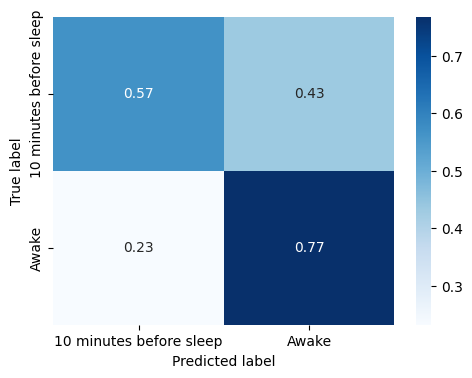

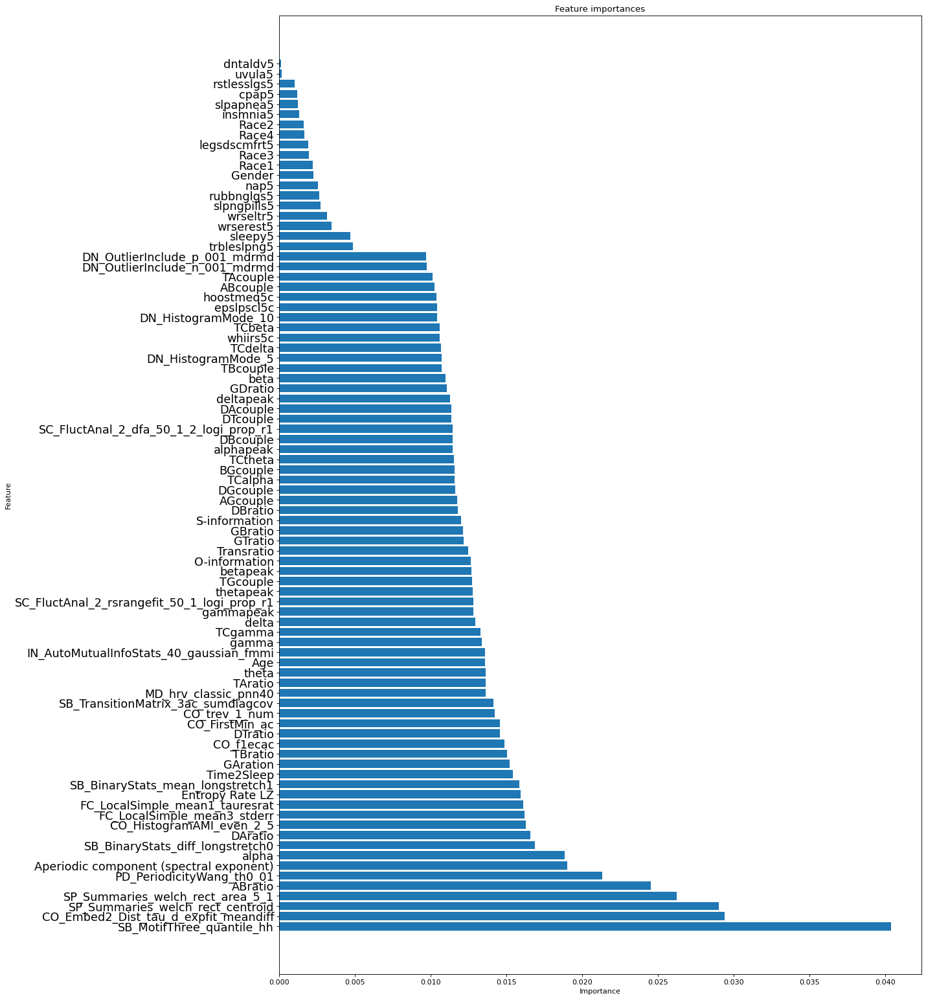

------------------ ADASYN ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.6925793650793651
Overall f1-score of fold 1:  0.6958309187781853
F1-score of 10 minutes before sleep class 0.5647019160532674: 
F1-score of Awake class 0.7623838297089225: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.6928174603174603
Overall f1-score of fold 2:  0.6946084275616261
F1-score of 10 minutes before sleep class 0.5550382249813186: 
F1-score of Awake class 0.7654455655546465: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.6757142857142857
Overall f1-score of fold 3:  0.6790033606032934
F1-score of 10 minutes before sleep class 0.5398130420092352: 
F1-score of Awake class 0.7496476931560566: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.6943253968253968
Overall f1-score of fold 4:  0.6938979476082106
F1-score of 10 minutes before sleep class 0.543471818882238: 
F1-score of 

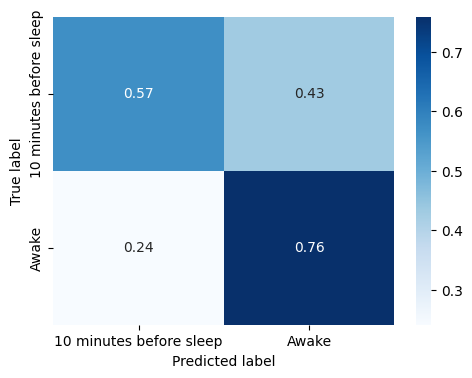

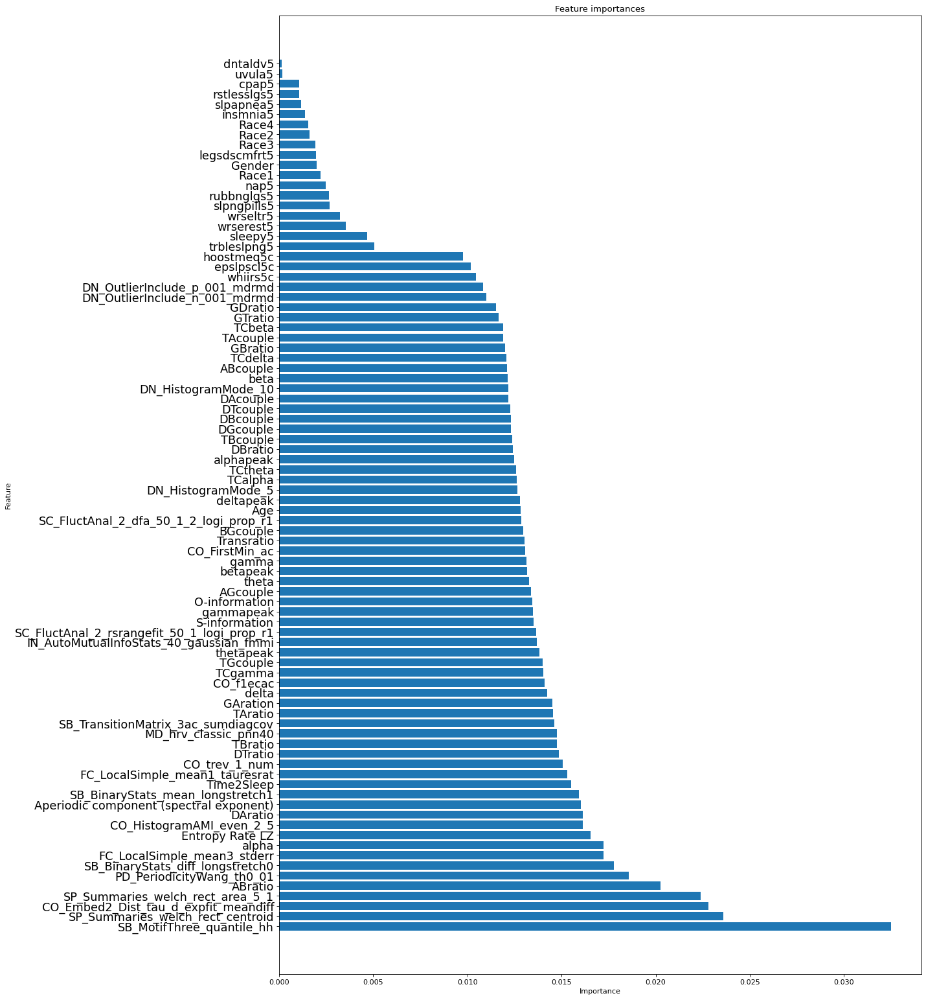

------------------ BorderlineSMOTE ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.6934920634920635
Overall f1-score of fold 1:  0.6958295480300887
F1-score of 10 minutes before sleep class 0.5596853266446243: 
F1-score of Awake class 0.7649278714468318: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.6951984126984126
Overall f1-score of fold 2:  0.6958343131282692
F1-score of 10 minutes before sleep class 0.5512123867952089: 
F1-score of Awake class 0.7692353913174103: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.6758730158730158
Overall f1-score of fold 3:  0.6784229597150174
F1-score of 10 minutes before sleep class 0.5349049083247922: 
F1-score of Awake class 0.7512637797673428: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.6933333333333334
Overall f1-score of fold 4:  0.6915041912801684
F1-score of 10 minutes before sleep class 0.5338962605548855: 
F1

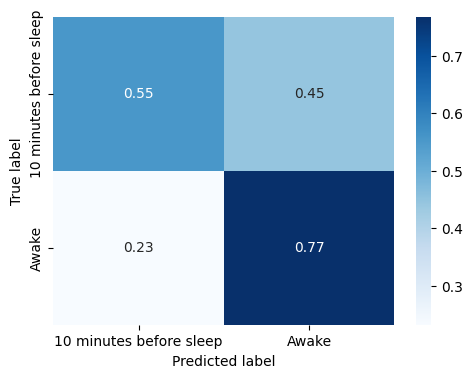

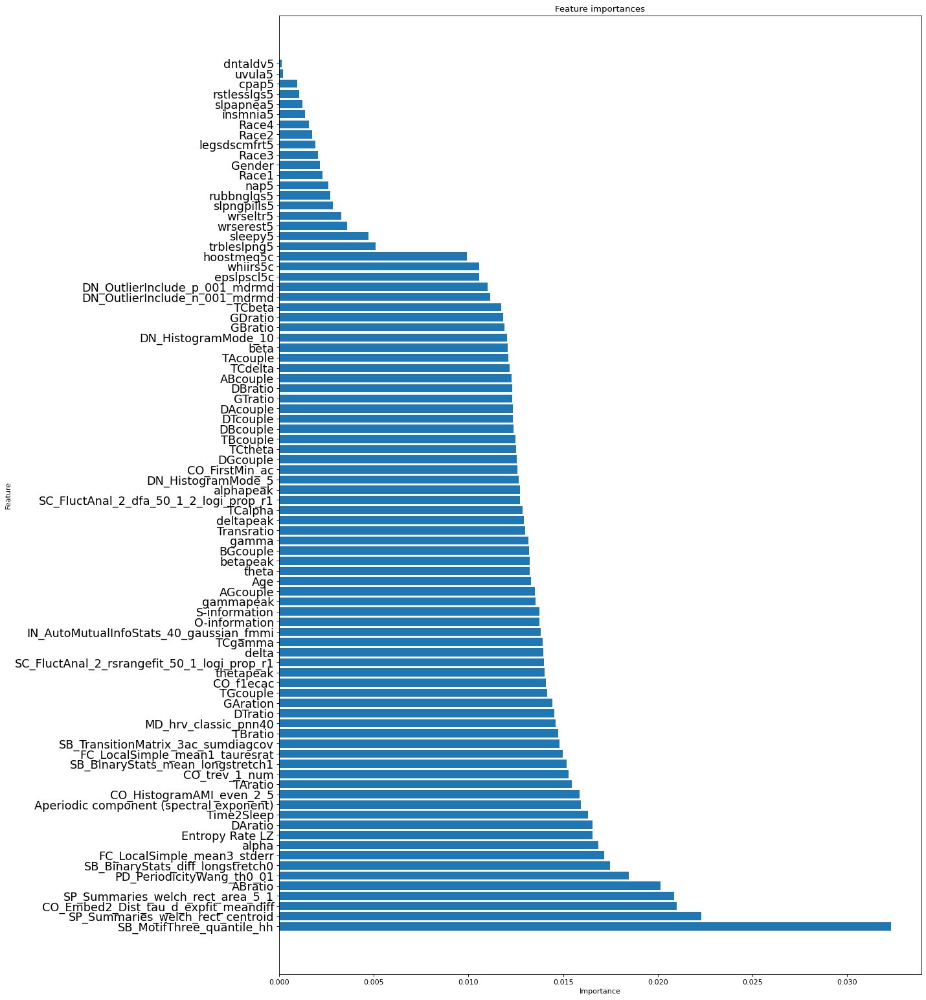

------------------ TomekLinks ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.6976984126984127
Overall f1-score of fold 1:  0.6953769465808767
F1-score of 10 minutes before sleep class 0.5376304928380674: 
F1-score of Awake class 0.7754392170734583: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.6986904761904762
Overall f1-score of fold 2:  0.6950884347455715
F1-score of 10 minutes before sleep class 0.5321338344938074: 
F1-score of Awake class 0.7777940358783764: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.6907539682539683
Overall f1-score of fold 3:  0.6855435455441624
F1-score of 10 minutes before sleep class 0.5118697150015659: 
F1-score of Awake class 0.7736895600406561: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7128571428571429
Overall f1-score of fold 4:  0.7027345764924561
F1-score of 10 minutes before sleep class 0.5209850390573282: 
F1-scor

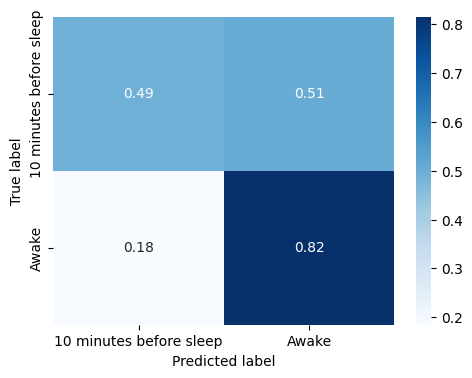

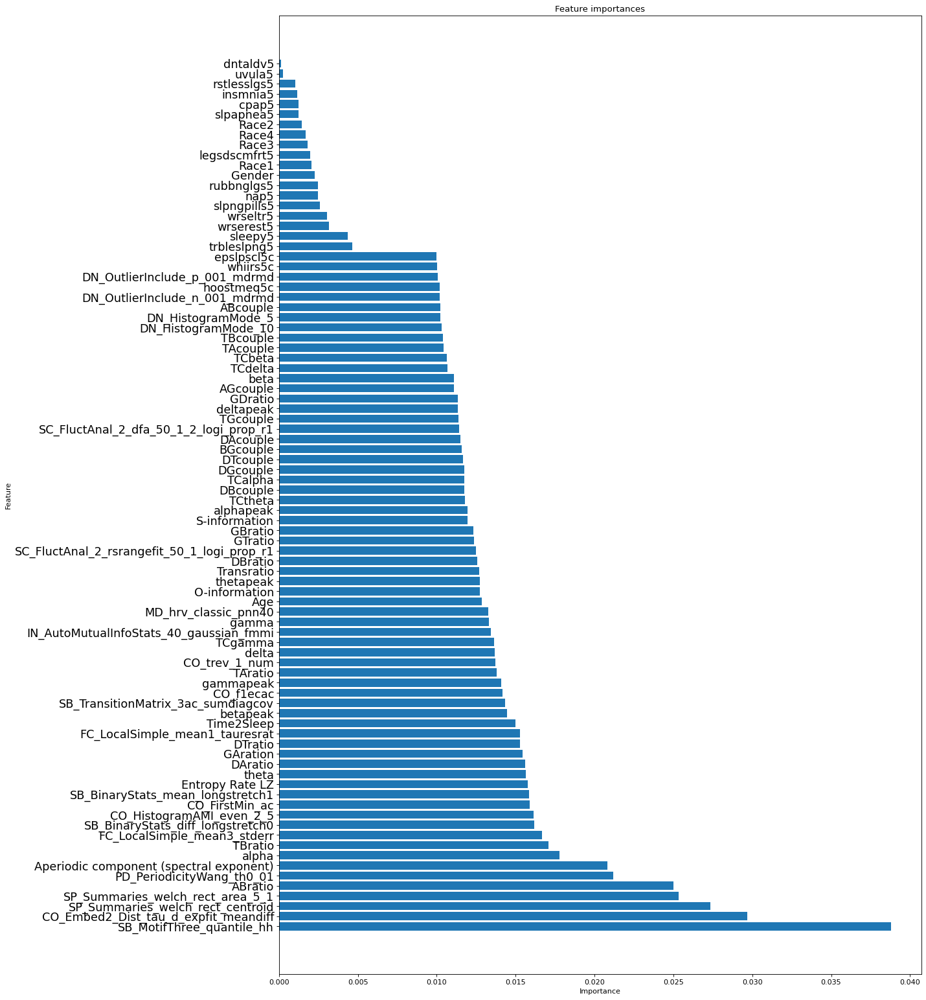

------------------ NearMiss ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.6142460317460318
Overall f1-score of fold 1:  0.6231563671108186
F1-score of 10 minutes before sleep class 0.570646172872223: 
F1-score of Awake class 0.6498072697143269: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.6146428571428572
Overall f1-score of fold 2:  0.6237401065746833
F1-score of 10 minutes before sleep class 0.5691468121922002: 
F1-score of Awake class 0.651448261010014: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.5992063492063492
Overall f1-score of fold 3:  0.60943200063419
F1-score of 10 minutes before sleep class 0.5425310263610835: 
F1-score of Awake class 0.6433867664712943: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.6087698412698412
Overall f1-score of fold 4:  0.6189523273456078
F1-score of 10 minutes before sleep class 0.5501665373910662: 
F1-score of A

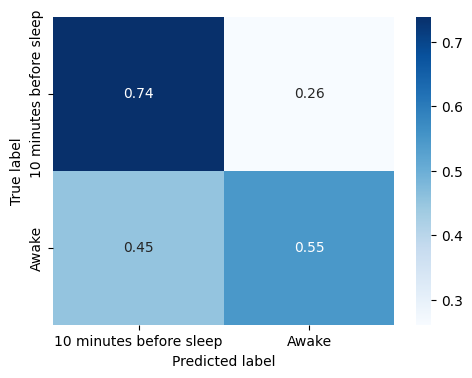

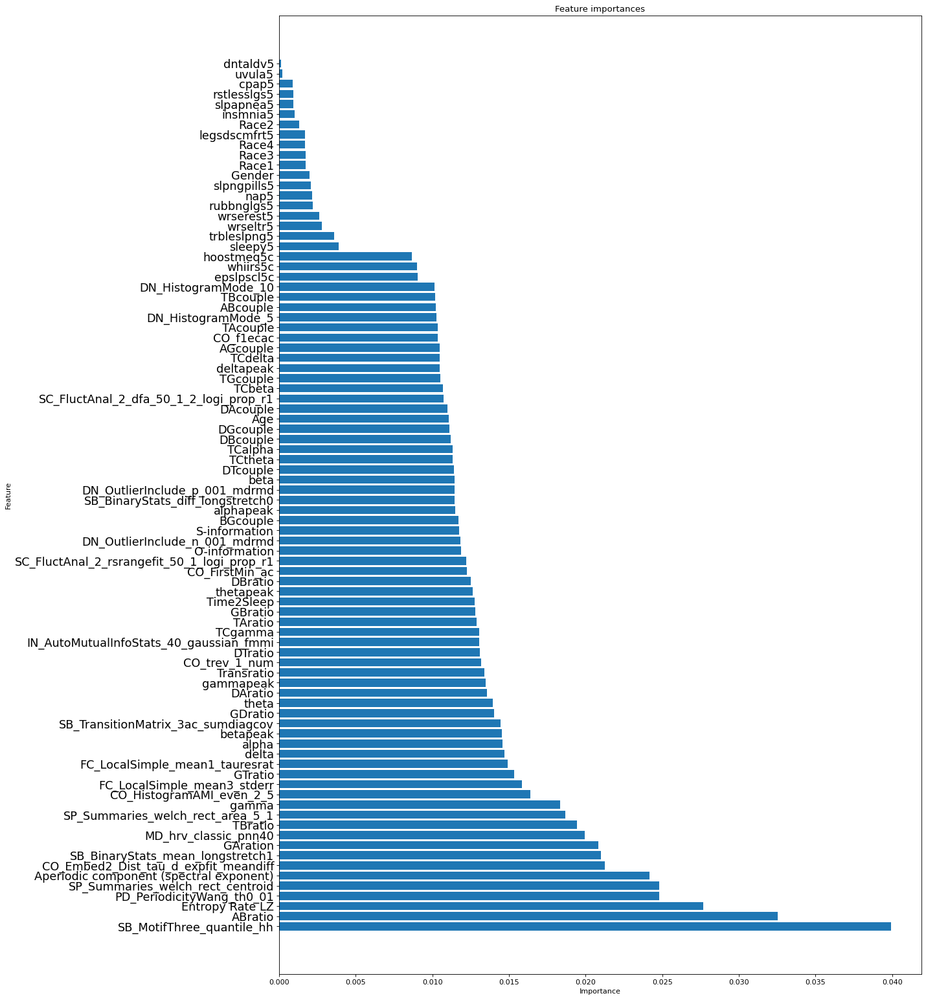

------------------ EditedNearestNeighbours ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.6929761904761905
Overall f1-score of fold 1:  0.6984356254298074
F1-score of 10 minutes before sleep class 0.5828435865638647: 
F1-score of Awake class 0.7571029416381503: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.6856746031746032
Overall f1-score of fold 2:  0.6906124865722593
F1-score of 10 minutes before sleep class 0.567323974436008: 
F1-score of Awake class 0.7531860530333717: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.6680952380952381
Overall f1-score of fold 3:  0.6731230190158727
F1-score of 10 minutes before sleep class 0.5415981585004933: 
F1-score of Awake class 0.7398768426945326: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.6978968253968254
Overall f1-score of fold 4:  0.7000128742893375
F1-score of 10 minutes before sleep class 0.56474758447201

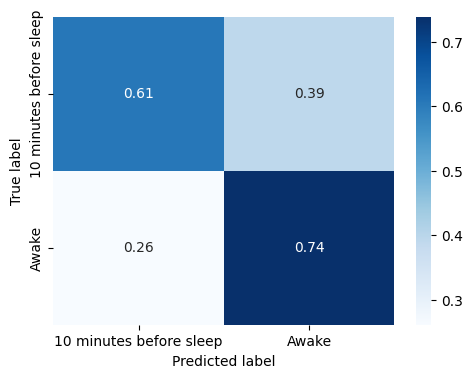

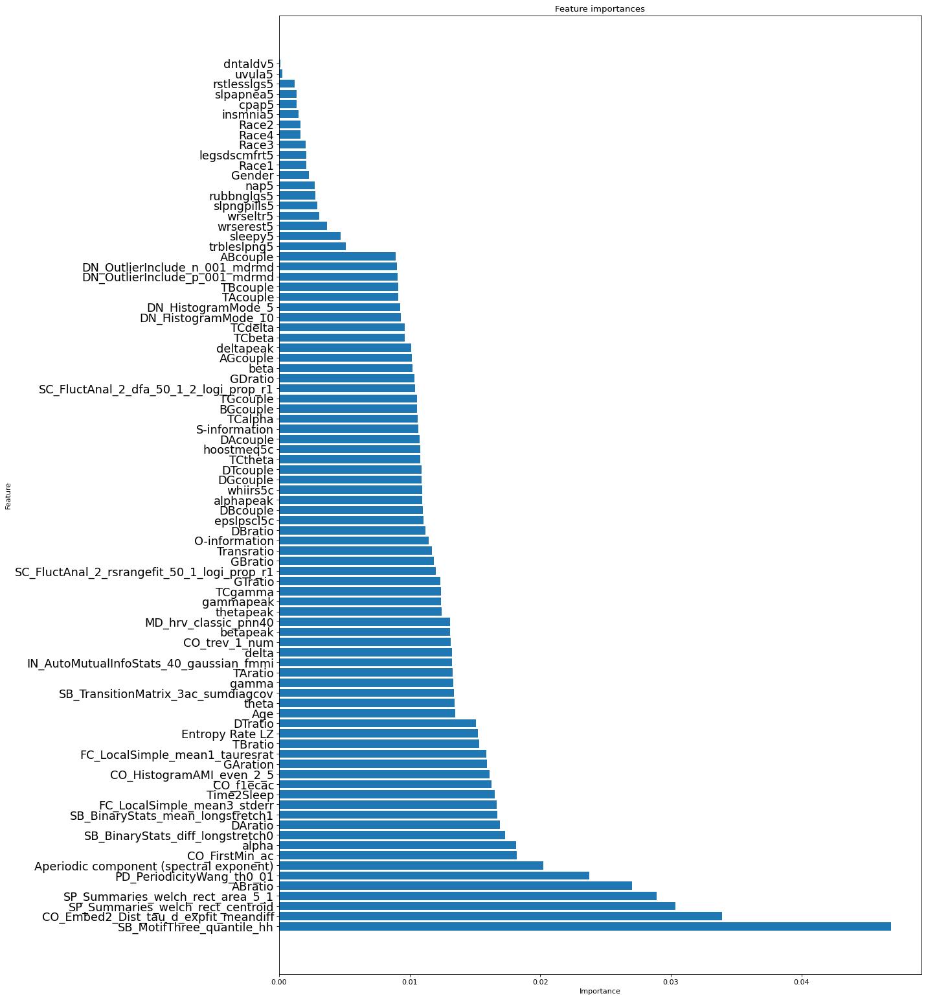

------------------ AllKNN ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.6904365079365079
Overall f1-score of fold 1:  0.697027882520268
F1-score of 10 minutes before sleep class 0.5900036789824985: 
F1-score of Awake class 0.7513466993911961: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.6843253968253968
Overall f1-score of fold 2:  0.690603473228961
F1-score of 10 minutes before sleep class 0.5773338292333032: 
F1-score of Awake class 0.7480920865131893: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.6636111111111112
Overall f1-score of fold 3:  0.6699038904329092
F1-score of 10 minutes before sleep class 0.5457857793495151: 
F1-score of Awake class 0.7328985096259887: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.691031746031746
Overall f1-score of fold 4:  0.6951501000937442
F1-score of 10 minutes before sleep class 0.5688337578912392: 
F1-score of Aw

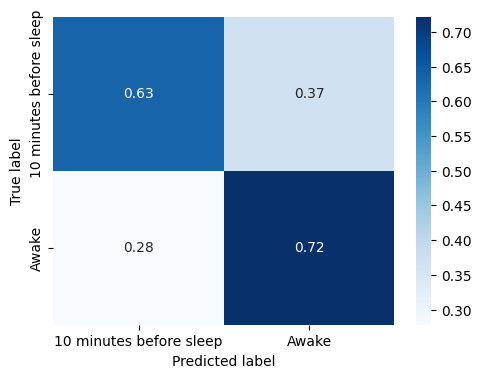

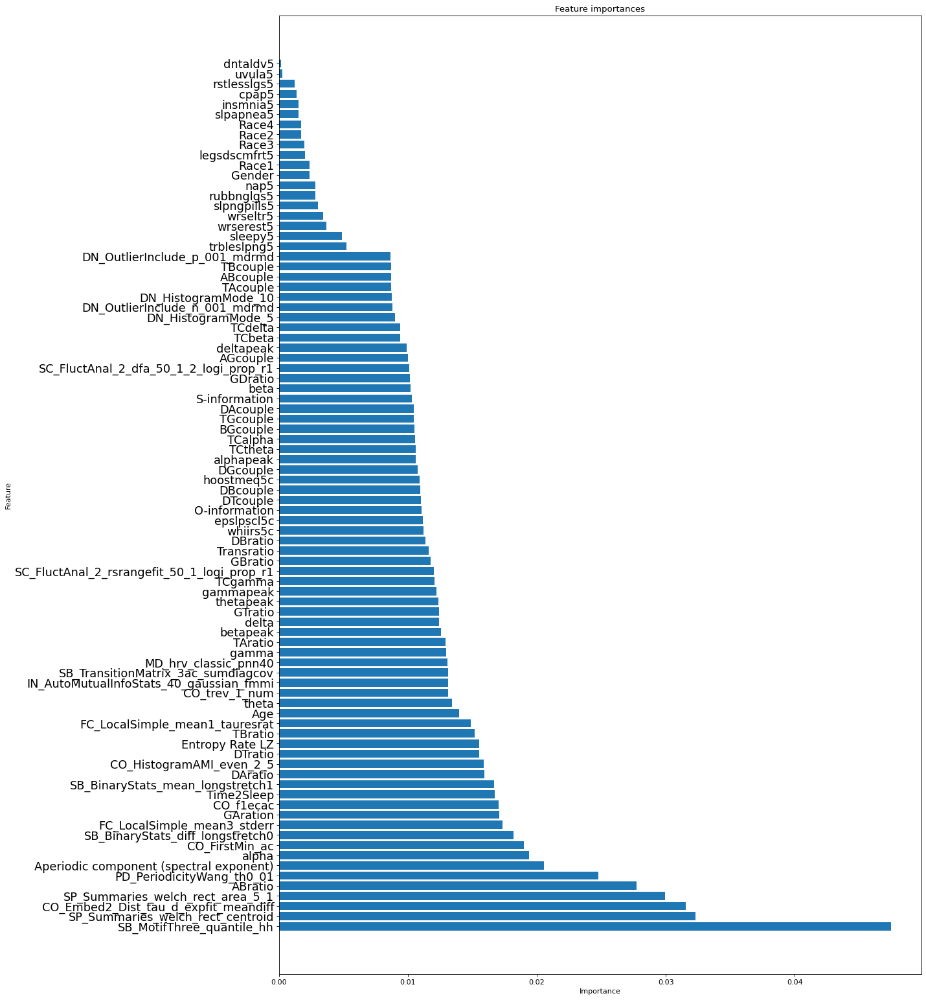

------------------ OneSidedSelection ------------------


CROSS-VALIDATION


-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.6985317460317461
Overall f1-score of fold 1:  0.6961408756744518
F1-score of 10 minutes before sleep class 0.5384849037118038: 
F1-score of Awake class 0.7761572232534842: 
-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.6977380952380953
Overall f1-score of fold 2:  0.6936983056371449
F1-score of 10 minutes before sleep class 0.5283883350876106: 
F1-score of Awake class 0.7775993459663055: 
-------------- Fold number 3/5 --------------
Accuracy of fold 3:  0.6896825396825397
Overall f1-score of fold 3:  0.6850244167500537
F1-score of 10 minutes before sleep class 0.5131365956916947: 
F1-score of Awake class 0.7722639641213817: 
-------------- Fold number 4/5 --------------
Accuracy of fold 4:  0.7093253968253969
Overall f1-score of fold 4:  0.6998617104402711
F1-score of 10 minutes before sleep class 0.5187569804874844: 


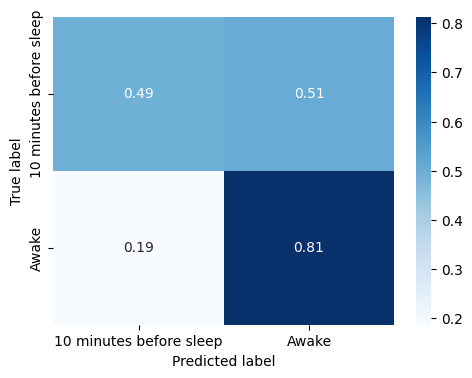

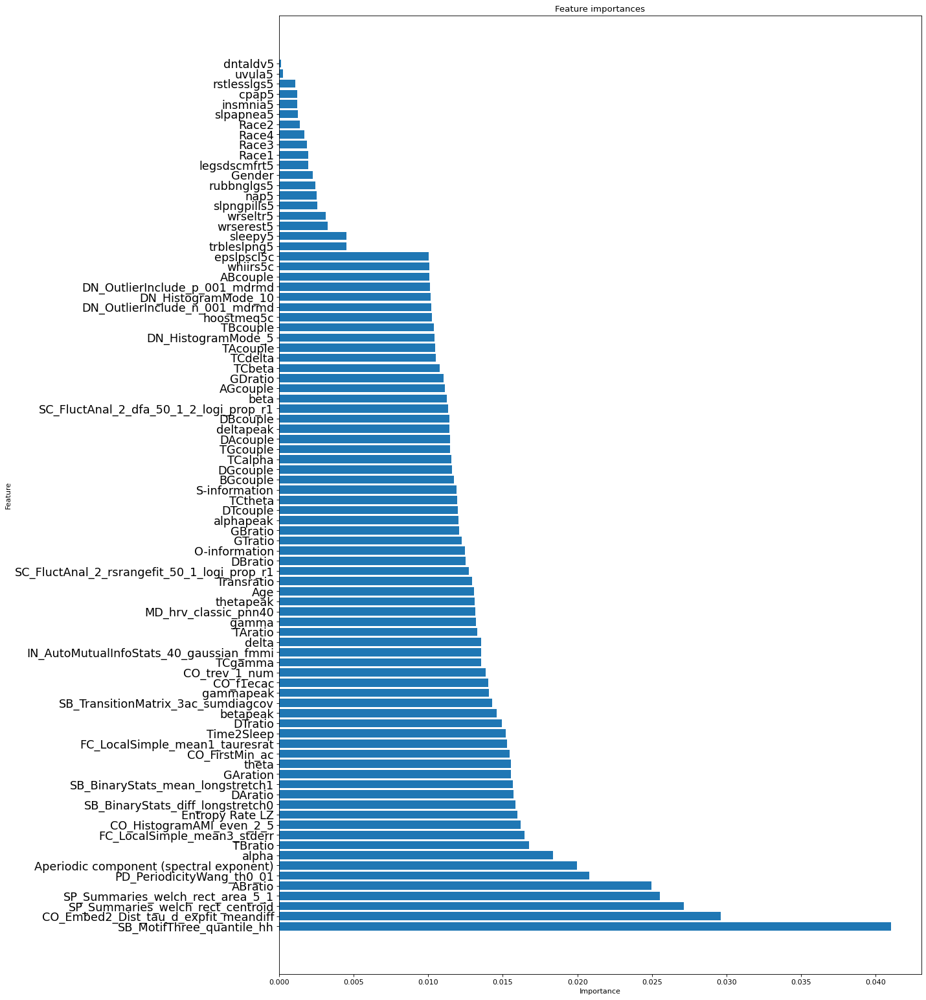

In [51]:
results_10_10 = try_resampling_methods(resampling_methods, data_train, pre_onset_time = 10, awake_time = 10, model_type = 'Random Forest', test_size = 0.2, n_splits=5, random_seed = 42)

# 5 minutes prior to sleep onset and 10-30 first minute before sleep

## Try Balanced Random Forest Classifier

In [52]:
# import balanced random forest classifier
from imblearn.ensemble import BalancedRandomForestClassifier


In [53]:
mydata_normalised_preprocessed_one_hot = data_train.copy()

In [54]:

# Try classification on 5 minutes before sleep and 20+ minutes before sleep
mydata_normalised_preprocessed_one_hot_5_10 = mydata_normalised_preprocessed_one_hot[(mydata_normalised_preprocessed_one_hot['Label'] <= 5) | (mydata_normalised_preprocessed_one_hot['Label'] >= 10)].copy()

# Swap Label columns into categorical '5 minutes before sleep'  (if Label <= 5) and '20+ minutes before sleep' in the other case

mydata_normalised_preprocessed_one_hot_5_10['Label'] = np.where(mydata_normalised_preprocessed_one_hot_5_10['Label'] <= 5, '5 minutes before sleep', 'Awake')


CROSS-VALIDATION
-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.723629292354392
Overall f1-score of fold 1:  0.7477068543716417
                        precision    recall  f1-score   support

5 minutes before sleep       0.40      0.73      0.52      4284
                 Awake       0.91      0.72      0.81     16800

              accuracy                           0.72     21084
             macro avg       0.66      0.73      0.66     21084
          weighted avg       0.81      0.72      0.75     21084

-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7032821096566116
Overall f1-score of fold 2:  0.7313739698949587
                        precision    recall  f1-score   support

5 minutes before sleep       0.39      0.79      0.52      4284
                 Awake       0.93      0.68      0.79     16800

              accuracy                           0.70     21084
             macro avg       0.66      0.74      0.65     21084
       

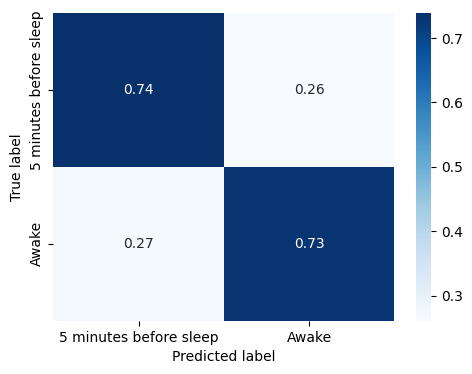

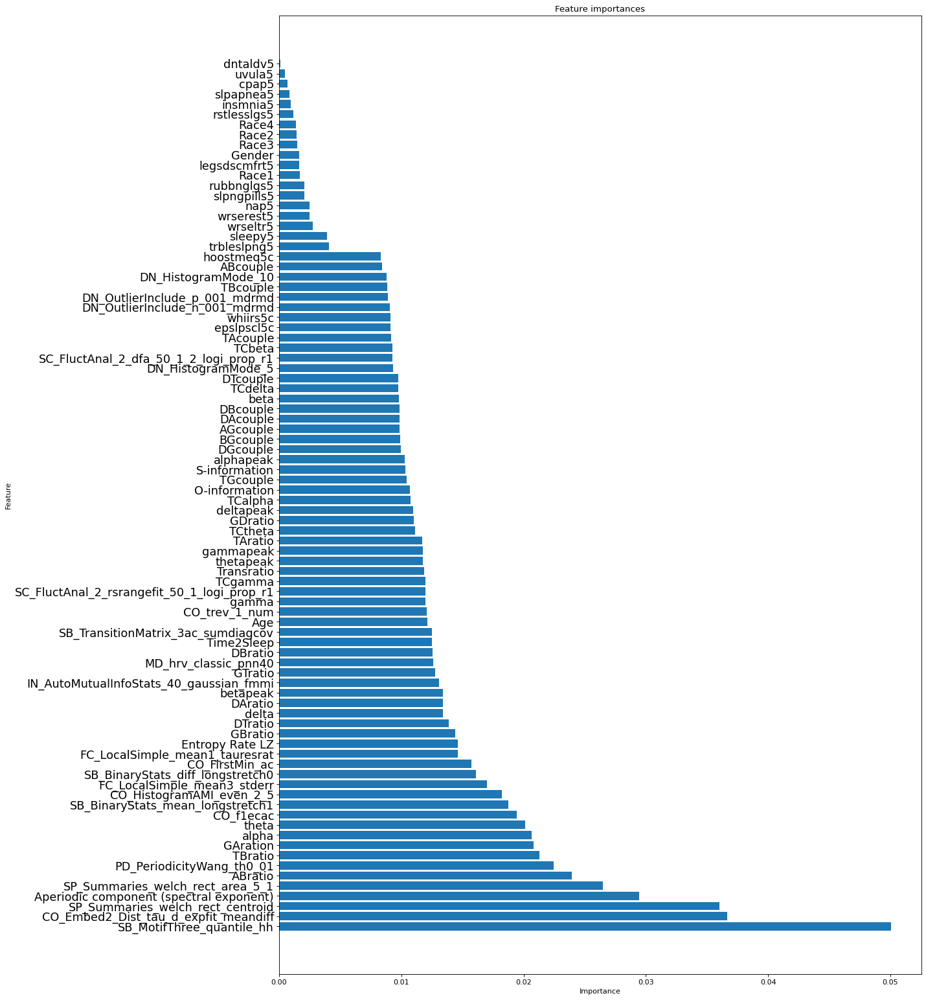

In [55]:
# Split test,  and training sets
X_train_5, y_train_5, X_test_5, y_test_5, sbj_train_set_5, sbj_test_set_5 = train_test_split_sbjs(mydata_normalised_preprocessed_one_hot_5_10, test_size = 0.2, random_seed = 42)

# Create a random forest classifier
brfc = BalancedRandomForestClassifier(n_estimators=150, random_state=42, sampling_strategy='all', replacement=False)

print('CROSS-VALIDATION')

# Perform cross-validation
predictions_cv_class_5_10, actuals_cv_class_5_10 = cross_validation_group(X_train_5, y_train_5, sbj_train_set_5, brfc, n_splits=5, ifresample = False)

# Evaluate the predictions made during cross-validation
evaluate_classification(actuals_cv_class_5_10, predictions_cv_class_5_10, index = ['5 minutes before sleep', 'Awake'], columns = ['5 minutes before sleep', 'Awake'])


brfc.fit(X_train_5, y_train_5)

importances, indices, names = plot_feature_importances(brfc, X_train_5)


In [331]:
!pip install graphviz
!conda install graphviz -y

Solving environment: done


==> WARNING: A newer version of conda exists. <==
  current version: 23.5.0
  latest version: 23.5.2

Please update conda by running

    $ conda update -n base -c conda-forge conda

Or to minimize the number of packages updated during conda update use

     conda install conda=23.5.2



## Package Plan ##

  environment location: /usr/local/Caskroom/miniforge/base/envs/myenv

  added / updated specs:
    - graphviz


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    boost-cpp-1.73.0           |      h1a28f6b_12          17 KB
    c-ares-1.19.0              |       h80987f9_0         104 KB
    cairo-1.16.0               |       h302bd0f_5         1.0 MB
    expat-2.4.9                |       hc377ac9_0         127 KB
    font-ttf-dejavu-sans-mono-2.37|       hd3eb1b0_0         335 KB
    font-ttf-inconsolata-2.001 |       hcb22688_0          83 KB
    font-ttf-

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.038355 to fit


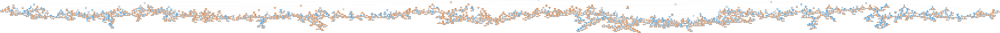

In [332]:
# look at the decision tree 
from sklearn.tree import export_graphviz



# Export as dot file
export_graphviz(brfc.estimators_[0], out_file='tree.dot',
                feature_names = names,
                class_names = ['5 minutes before sleep', 'Awake'],
                rounded = True, proportion = False,
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')



TEST SET
Accuracy: 0.6665993129925237
                        precision    recall  f1-score   support

5 minutes before sleep       0.51      0.65      0.58      1713
                 Awake       0.79      0.67      0.73      3236

              accuracy                           0.67      4949
             macro avg       0.65      0.66      0.65      4949
          weighted avg       0.69      0.67      0.67      4949



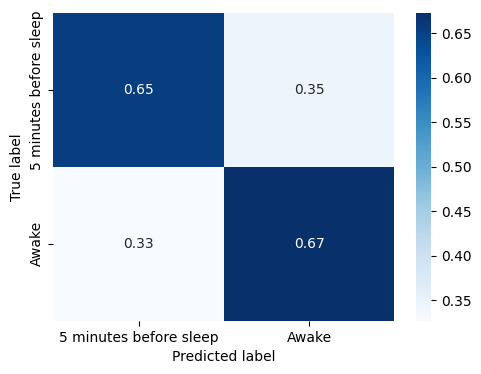

In [ ]:

print('TEST SET')

# Predict the labels for the test set
predictions_class_5_10= brfc.predict(X_test_5)

# Evaluate the predictions made during cross-validation
evaluate_classification(y_test_5, predictions_class_5_10, index = ['5 minutes before sleep', 'Awake'], columns = ['5 minutes before sleep', 'Awake'])


## Try Balanced Bagging Classifier

CROSS-VALIDATION
-------------- Fold number 1/5 --------------


/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/imblearn/ensemble/_bagging.py:362: FutureWarning: `base_estimator` was renamed to `estimator` in version 0.10 and will be removed in 0.12.
  warnings.warn(


Accuracy of fold 1:  0.754600645038892
Overall f1-score of fold 1:  0.7702447499378228
                        precision    recall  f1-score   support

5 minutes before sleep       0.43      0.63      0.51      4284
                 Awake       0.89      0.79      0.84     16800

              accuracy                           0.75     21084
             macro avg       0.66      0.71      0.67     21084
          weighted avg       0.80      0.75      0.77     21084

-------------- Fold number 2/5 --------------


/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/imblearn/ensemble/_bagging.py:362: FutureWarning: `base_estimator` was renamed to `estimator` in version 0.10 and will be removed in 0.12.
  warnings.warn(


Accuracy of fold 2:  0.7454467842914058
Overall f1-score of fold 2:  0.7594201511698593
                        precision    recall  f1-score   support

5 minutes before sleep       0.41      0.57      0.47      4284
                 Awake       0.88      0.79      0.83     16800

              accuracy                           0.75     21084
             macro avg       0.64      0.68      0.65     21084
          weighted avg       0.78      0.75      0.76     21084

-------------- Fold number 3/5 --------------


/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/imblearn/ensemble/_bagging.py:362: FutureWarning: `base_estimator` was renamed to `estimator` in version 0.10 and will be removed in 0.12.
  warnings.warn(


Accuracy of fold 3:  0.7431227471068108
Overall f1-score of fold 3:  0.7619262672484524
                        precision    recall  f1-score   support

5 minutes before sleep       0.42      0.66      0.51      4284
                 Awake       0.90      0.76      0.83     16800

              accuracy                           0.74     21084
             macro avg       0.66      0.71      0.67     21084
          weighted avg       0.80      0.74      0.76     21084

-------------- Fold number 4/5 --------------


/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/imblearn/ensemble/_bagging.py:362: FutureWarning: `base_estimator` was renamed to `estimator` in version 0.10 and will be removed in 0.12.
  warnings.warn(


Accuracy of fold 4:  0.7631379244925062
Overall f1-score of fold 4:  0.7786534501351206
                        precision    recall  f1-score   support

5 minutes before sleep       0.44      0.66      0.53      4284
                 Awake       0.90      0.79      0.84     16800

              accuracy                           0.76     21084
             macro avg       0.67      0.73      0.69     21084
          weighted avg       0.81      0.76      0.78     21084

-------------- Fold number 5/5 --------------


/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/imblearn/ensemble/_bagging.py:362: FutureWarning: `base_estimator` was renamed to `estimator` in version 0.10 and will be removed in 0.12.
  warnings.warn(


Accuracy of fold 5:  0.7662362597801565
Overall f1-score of fold 5:  0.7812199196483596
                        precision    recall  f1-score   support

5 minutes before sleep       0.45      0.66      0.54      4233
                 Awake       0.90      0.79      0.84     16600

              accuracy                           0.77     20833
             macro avg       0.68      0.73      0.69     20833
          weighted avg       0.81      0.77      0.78     20833

Accuracy: 0.7544808831499776
                        precision    recall  f1-score   support

5 minutes before sleep       0.43      0.64      0.51     21369
                 Awake       0.89      0.78      0.84     83800

              accuracy                           0.75    105169
             macro avg       0.66      0.71      0.67    105169
          weighted avg       0.80      0.75      0.77    105169



/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/imblearn/ensemble/_bagging.py:362: FutureWarning: `base_estimator` was renamed to `estimator` in version 0.10 and will be removed in 0.12.
  warnings.warn(


AttributeError: 'BalancedBaggingClassifier' object has no attribute 'feature_importances_'

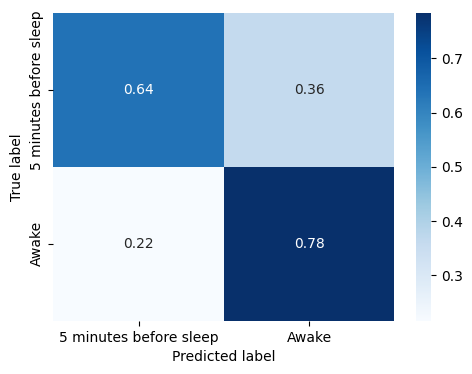

In [56]:
from imblearn.ensemble import BalancedBaggingClassifier
from sklearn.tree import DecisionTreeClassifier

# Split test,  and training sets
X_train_5, y_train_5, X_test_5, y_test_5, sbj_train_set_5, sbj_test_set_5 = train_test_split_sbjs(mydata_normalised_preprocessed_one_hot_5_10, test_size = 0.2, random_seed = 42)

# Create a balanced bagging classifier
bbc = BalancedBaggingClassifier(base_estimator=DecisionTreeClassifier(), n_estimators=30, random_state=42, sampling_strategy='all', replacement=False)

print('CROSS-VALIDATION')

# Perform cross-validation
predictions_cv_class_5_10, actuals_cv_class_5_10 = cross_validation_group(X_train_5, y_train_5, sbj_train_set_5, bbc, n_splits=5, ifresample = False)

# Evaluate the predictions made during cross-validation
evaluate_classification(actuals_cv_class_5_10, predictions_cv_class_5_10, index = ['5 minutes before sleep', 'Awake'], columns = ['5 minutes before sleep', 'Awake'])

bbc.fit(X_train_5, y_train_5)

#importances, indices, names = plot_feature_importances(bbc, X_train_5)



## Try Easy Ensemble Classifier

CROSS-VALIDATION
-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.7357237715803453
Overall f1-score of fold 1:  0.7592705377397604
                        precision    recall  f1-score   support

5 minutes before sleep       0.42      0.78      0.55      4284
                 Awake       0.93      0.72      0.81     16800

              accuracy                           0.74     21084
             macro avg       0.67      0.75      0.68     21084
          weighted avg       0.83      0.74      0.76     21084

-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7499051413394043
Overall f1-score of fold 2:  0.7699004383818284
                        precision    recall  f1-score   support

5 minutes before sleep       0.43      0.73      0.54      4284
                 Awake       0.92      0.76      0.83     16800

              accuracy                           0.75     21084
             macro avg       0.67      0.74      0.69     21084
      

EasyEnsembleClassifier(n_estimators=30, random_state=42,
                       sampling_strategy='all')

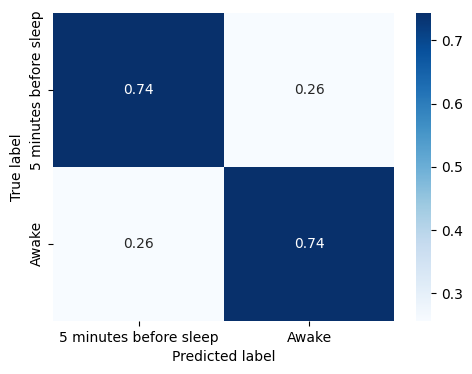

In [57]:
from imblearn.ensemble import EasyEnsembleClassifier

# Split test,  and training sets
X_train_5, y_train_5, X_test_5, y_test_5, sbj_train_set_5, sbj_test_set_5 = train_test_split_sbjs(mydata_normalised_preprocessed_one_hot_5_10, test_size = 0.2, random_seed = 42)

# Create an easy ensemble  classifier
esc = EasyEnsembleClassifier(n_estimators=30, random_state=42, sampling_strategy='all', replacement=False)

print('CROSS-VALIDATION')

# Perform cross-validation
predictions_cv_class_5_10, actuals_cv_class_5_10 = cross_validation_group(X_train_5, y_train_5, sbj_train_set_5, esc, n_splits=5, ifresample = False)

# Evaluate the predictions made during cross-validation
evaluate_classification(actuals_cv_class_5_10, predictions_cv_class_5_10, index = ['5 minutes before sleep', 'Awake'], columns = ['5 minutes before sleep', 'Awake'])


esc.fit(X_train_5, y_train_5)

#importances, indices, names = plot_feature_importances(esc, X_train_5)

## Try RUSBoost Classifier




CROSS-VALIDATION
-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.47917852399924116
Overall f1-score of fold 1:  0.5058928288207002
                        precision    recall  f1-score   support

5 minutes before sleep       0.27      0.92      0.42      4284
                 Awake       0.95      0.37      0.53     16800

              accuracy                           0.48     21084
             macro avg       0.61      0.65      0.47     21084
          weighted avg       0.81      0.48      0.51     21084

-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7482451147789794
Overall f1-score of fold 2:  0.7691852845115592
                        precision    recall  f1-score   support

5 minutes before sleep       0.43      0.75      0.55      4284
                 Awake       0.92      0.75      0.83     16800

              accuracy                           0.75     21084
             macro avg       0.68      0.75      0.69     21084
     

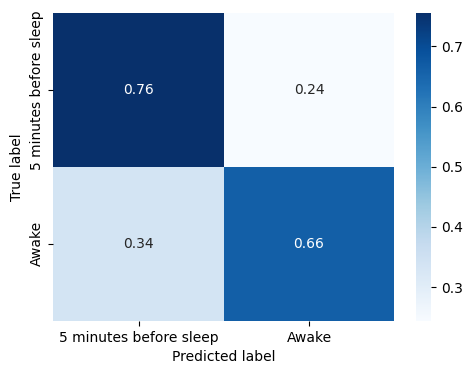

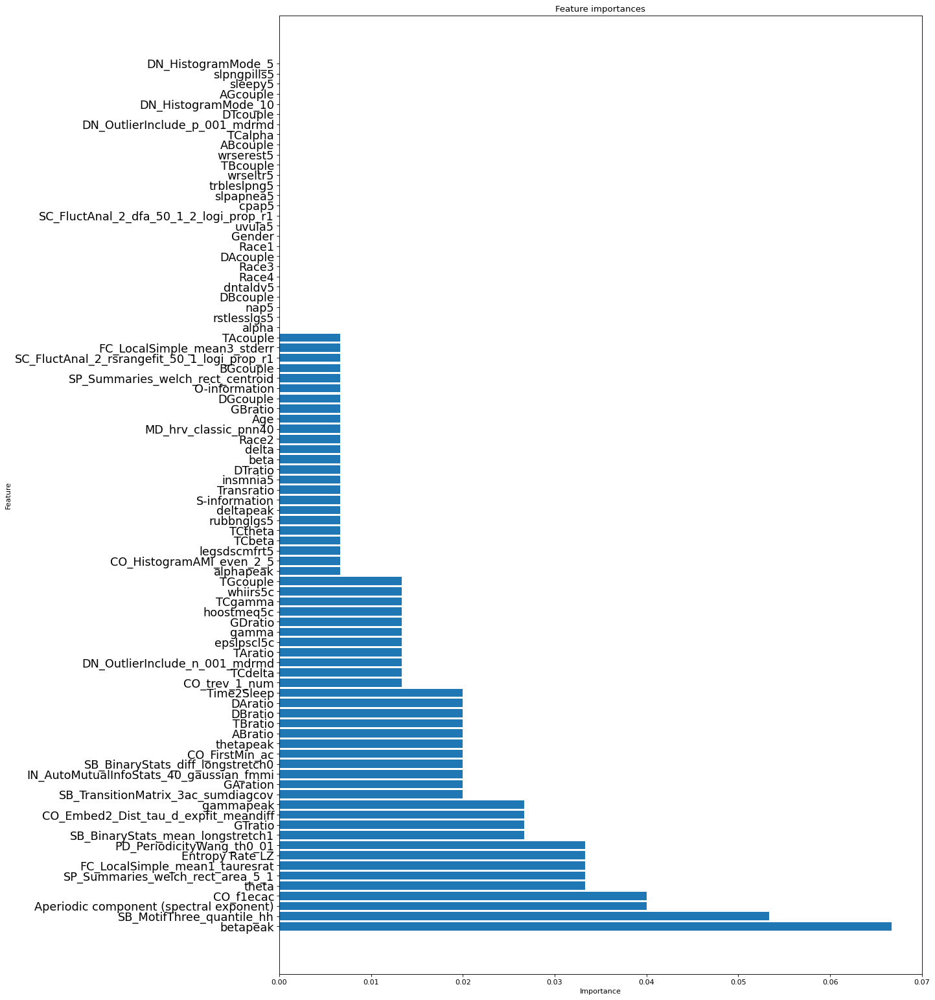

In [58]:
from imblearn.ensemble import RUSBoostClassifier

# Split test,  and training sets
X_train_5, y_train_5, X_test_5, y_test_5, sbj_train_set_5, sbj_test_set_5 = train_test_split_sbjs(mydata_normalised_preprocessed_one_hot_5_10, test_size = 0.2, random_seed = 42)

# Create a random forest classifier
rusbc = RUSBoostClassifier(n_estimators=150, random_state=42, sampling_strategy='all', replacement=False)

print('CROSS-VALIDATION')

# Perform cross-validation
predictions_cv_class_5_10, actuals_cv_class_5_10 = cross_validation_group(X_train_5, y_train_5, sbj_train_set_5, rusbc, n_splits=5, ifresample = False)

# Evaluate the predictions made during cross-validation
evaluate_classification(actuals_cv_class_5_10, predictions_cv_class_5_10, index = ['5 minutes before sleep', 'Awake'], columns = ['5 minutes before sleep', 'Awake'])


rusbc.fit(X_train_5, y_train_5)

importances, indices, names = plot_feature_importances(rusbc, X_train_5)

# Do it for 5 minutes prior to sleep and 15-30 minutes prior to sleep onset 

In [59]:

# Try classification on 5 minutes before sleep and 20+ minutes before sleep
mydata_normalised_preprocessed_one_hot_5_15 = mydata_normalised_preprocessed_one_hot[(mydata_normalised_preprocessed_one_hot['Label'] <= 5) | (mydata_normalised_preprocessed_one_hot['Label'] >= 15)].copy()

# Swap Label columns into categorical '5 minutes before sleep'  (if Label <= 5) and '20+ minutes before sleep' in the other case

mydata_normalised_preprocessed_one_hot_5_15['Label'] = np.where(mydata_normalised_preprocessed_one_hot_5_15['Label'] <= 5, '5 minutes before sleep', 'Awake')


CROSS-VALIDATION
-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.7862473347547975
Overall f1-score of fold 1:  0.7964095127484535
                        precision    recall  f1-score   support

5 minutes before sleep       0.56      0.78      0.65      4284
                 Awake       0.91      0.79      0.85     12600

              accuracy                           0.79     16884
             macro avg       0.74      0.79      0.75     16884
          weighted avg       0.82      0.79      0.80     16884

-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7631485429992892
Overall f1-score of fold 2:  0.7758934307481586
                        precision    recall  f1-score   support

5 minutes before sleep       0.52      0.79      0.63      4284
                 Awake       0.91      0.76      0.83     12600

              accuracy                           0.76     16884
             macro avg       0.72      0.77      0.73     16884
      

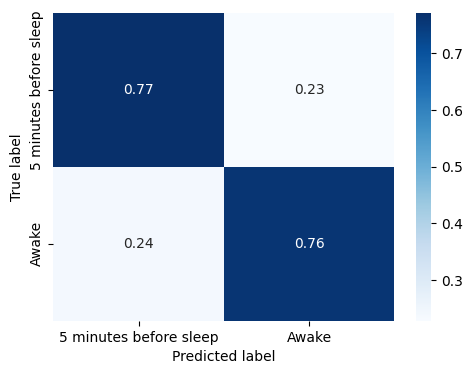

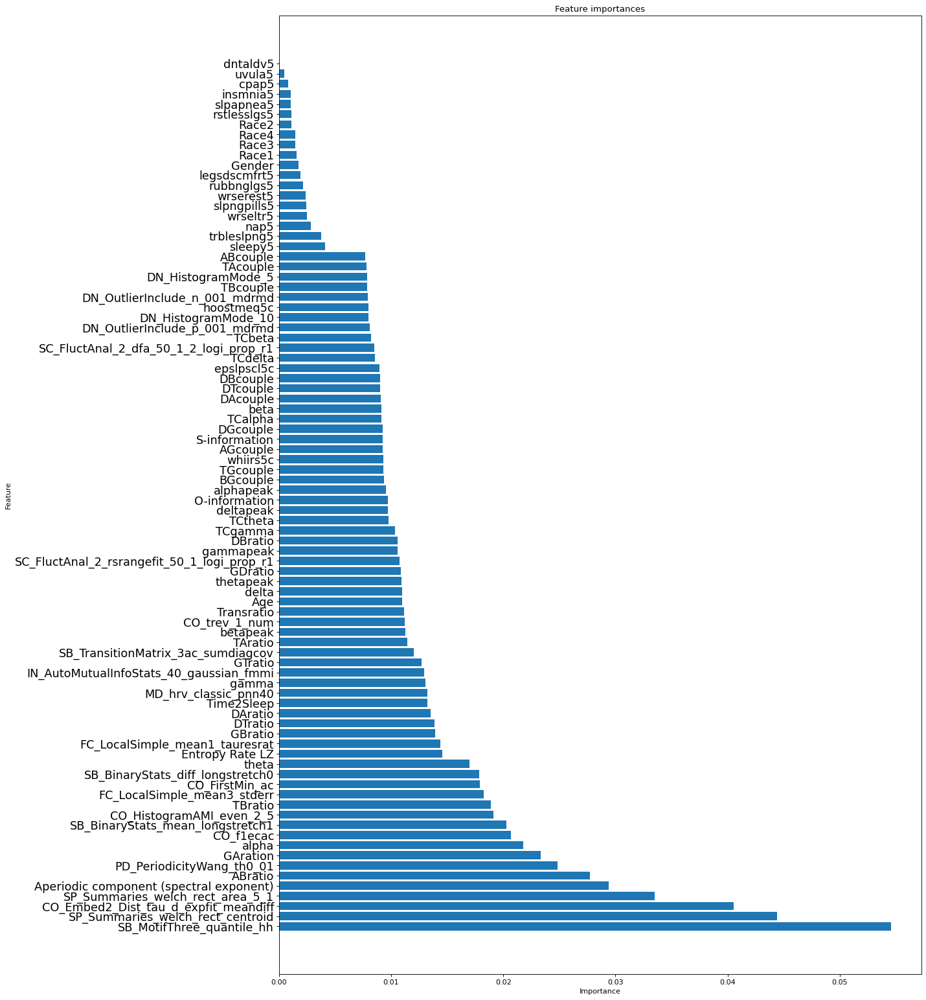

In [60]:
# Split test,  and training sets
X_train_5, y_train_5, X_test_5, y_test_5, sbj_train_set_5, sbj_test_set_5 = train_test_split_sbjs(mydata_normalised_preprocessed_one_hot_5_15, test_size = 0.2, random_seed = 42)

# Create a random forest classifier
brfc = BalancedRandomForestClassifier(n_estimators=150, random_state=42, sampling_strategy='all', replacement=False)

print('CROSS-VALIDATION')

# Perform cross-validation
predictions_cv_class_5_10, actuals_cv_class_5_10 = cross_validation_group(X_train_5, y_train_5, sbj_train_set_5, brfc, n_splits=5, ifresample = False)

# Evaluate the predictions made during cross-validation
evaluate_classification(actuals_cv_class_5_10, predictions_cv_class_5_10, index = ['5 minutes before sleep', 'Awake'], columns = ['5 minutes before sleep', 'Awake'])


brfc.fit(X_train_5, y_train_5)

importances, indices, names = plot_feature_importances(brfc, X_train_5)

CROSS-VALIDATION
-------------- Fold number 1/5 --------------


/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/imblearn/ensemble/_bagging.py:362: FutureWarning: `base_estimator` was renamed to `estimator` in version 0.10 and will be removed in 0.12.
  warnings.warn(


Accuracy of fold 1:  0.756260671599317
Overall f1-score of fold 1:  0.7723015969972129
                        precision    recall  f1-score   support

5 minutes before sleep       0.43      0.65      0.52      4284
                 Awake       0.90      0.78      0.84     16800

              accuracy                           0.76     21084
             macro avg       0.67      0.72      0.68     21084
          weighted avg       0.80      0.76      0.77     21084

-------------- Fold number 2/5 --------------


/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/imblearn/ensemble/_bagging.py:362: FutureWarning: `base_estimator` was renamed to `estimator` in version 0.10 and will be removed in 0.12.
  warnings.warn(


Accuracy of fold 2:  0.7511857332574464
Overall f1-score of fold 2:  0.7690734377689757
                        precision    recall  f1-score   support

5 minutes before sleep       0.43      0.67      0.52      4284
                 Awake       0.90      0.77      0.83     16800

              accuracy                           0.75     21084
             macro avg       0.67      0.72      0.68     21084
          weighted avg       0.81      0.75      0.77     21084

-------------- Fold number 3/5 --------------


/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/imblearn/ensemble/_bagging.py:362: FutureWarning: `base_estimator` was renamed to `estimator` in version 0.10 and will be removed in 0.12.
  warnings.warn(


Accuracy of fold 3:  0.7502845759817871
Overall f1-score of fold 3:  0.7655358194656499
                        precision    recall  f1-score   support

5 minutes before sleep       0.42      0.61      0.50      4284
                 Awake       0.89      0.79      0.83     16800

              accuracy                           0.75     21084
             macro avg       0.65      0.70      0.67     21084
          weighted avg       0.79      0.75      0.77     21084

-------------- Fold number 4/5 --------------


/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/imblearn/ensemble/_bagging.py:362: FutureWarning: `base_estimator` was renamed to `estimator` in version 0.10 and will be removed in 0.12.
  warnings.warn(


Accuracy of fold 4:  0.7732878011762474
Overall f1-score of fold 4:  0.7854686502823397
                        precision    recall  f1-score   support

5 minutes before sleep       0.46      0.63      0.53      4284
                 Awake       0.90      0.81      0.85     16800

              accuracy                           0.77     21084
             macro avg       0.68      0.72      0.69     21084
          weighted avg       0.81      0.77      0.79     21084

-------------- Fold number 5/5 --------------


/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/imblearn/ensemble/_bagging.py:362: FutureWarning: `base_estimator` was renamed to `estimator` in version 0.10 and will be removed in 0.12.
  warnings.warn(


Accuracy of fold 5:  0.7607641722267556
Overall f1-score of fold 5:  0.7779684411172212
                        precision    recall  f1-score   support

5 minutes before sleep       0.44      0.70      0.54      4233
                 Awake       0.91      0.78      0.84     16600

              accuracy                           0.76     20833
             macro avg       0.68      0.74      0.69     20833
          weighted avg       0.81      0.76      0.78     20833

Accuracy: 0.758350844830701
                        precision    recall  f1-score   support

5 minutes before sleep       0.44      0.65      0.52     21369
                 Awake       0.90      0.79      0.84     83800

              accuracy                           0.76    105169
             macro avg       0.67      0.72      0.68    105169
          weighted avg       0.80      0.76      0.77    105169



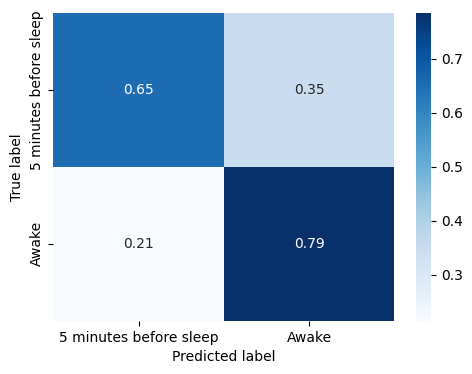

In [61]:
from imblearn.ensemble import BalancedBaggingClassifier
from sklearn.tree import DecisionTreeClassifier

# Split test,  and training sets
X_train_5, y_train_5, X_test_5, y_test_5, sbj_train_set_5, sbj_test_set_5 = train_test_split_sbjs(mydata_normalised_preprocessed_one_hot_5_10, test_size = 0.2, random_seed = 42)

# Create a balanced bagging classifier
bbc = BalancedBaggingClassifier(base_estimator=DecisionTreeClassifier(), n_estimators=30, random_state=42, sampling_strategy='all', replacement=False)

print('CROSS-VALIDATION')

# Perform cross-validation
predictions_cv_class_5_10, actuals_cv_class_5_10 = cross_validation_group(X_train_5, y_train_5, sbj_train_set_5, bbc, n_splits=5, ifresample = False)

# Evaluate the predictions made during cross-validation
evaluate_classification(actuals_cv_class_5_10, predictions_cv_class_5_10, index = ['5 minutes before sleep', 'Awake'], columns = ['5 minutes before sleep', 'Awake'])

#bbc.fit(X_train_5, y_train_5)

#importances, indices, names = plot_feature_importances(bbc, X_train_5)

CROSS-VALIDATION
-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.7418895845190666
Overall f1-score of fold 1:  0.7635412752935334
                        precision    recall  f1-score   support

5 minutes before sleep       0.42      0.74      0.54      4284
                 Awake       0.92      0.74      0.82     16800

              accuracy                           0.74     21084
             macro avg       0.67      0.74      0.68     21084
          weighted avg       0.82      0.74      0.76     21084

-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7618099032441662
Overall f1-score of fold 2:  0.7800096407318353
                        precision    recall  f1-score   support

5 minutes before sleep       0.45      0.73      0.56      4284
                 Awake       0.92      0.77      0.84     16800

              accuracy                           0.76     21084
             macro avg       0.68      0.75      0.70     21084
      

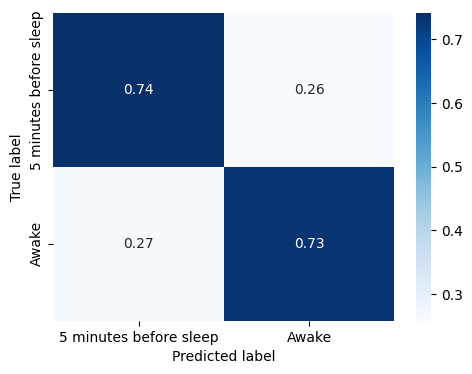

In [62]:
from imblearn.ensemble import EasyEnsembleClassifier

# Split test,  and training sets
X_train_5, y_train_5, X_test_5, y_test_5, sbj_train_set_5, sbj_test_set_5 = train_test_split_sbjs(mydata_normalised_preprocessed_one_hot_5_10, test_size = 0.2, random_seed = 42)

# Create an easy ensemble  classifier
esc = EasyEnsembleClassifier(n_estimators=30, random_state=42, sampling_strategy='all', replacement=False)

print('CROSS-VALIDATION')

# Perform cross-validation
predictions_cv_class_5_10, actuals_cv_class_5_10 = cross_validation_group(X_train_5, y_train_5, sbj_train_set_5, esc, n_splits=5, ifresample = False)

# Evaluate the predictions made during cross-validation
evaluate_classification(actuals_cv_class_5_10, predictions_cv_class_5_10, index = ['5 minutes before sleep', 'Awake'], columns = ['5 minutes before sleep', 'Awake'])


#esc.fit(X_train_5, y_train_5)

#importances, indices, names = plot_feature_importances(esc, X_train_5)

CROSS-VALIDATION
-------------- Fold number 1/5 --------------


Accuracy of fold 1:  0.7202143805729463
Overall f1-score of fold 1:  0.7444062068781989
                        precision    recall  f1-score   support

5 minutes before sleep       0.40      0.72      0.51      4284
                 Awake       0.91      0.72      0.80     16800

              accuracy                           0.72     21084
             macro avg       0.65      0.72      0.66     21084
          weighted avg       0.80      0.72      0.74     21084

-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.7208783911971163
Overall f1-score of fold 2:  0.7449504973704903
                        precision    recall  f1-score   support

5 minutes before sleep       0.40      0.71      0.51      4284
                 Awake       0.91      0.72      0.80     16800

              accuracy                           0.72     21084
             macro avg       0.65      0.72      0.66     21084
          weighted avg       0.80      0.72      0.74     21084

----

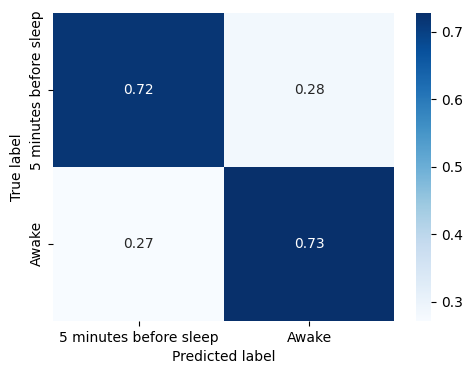

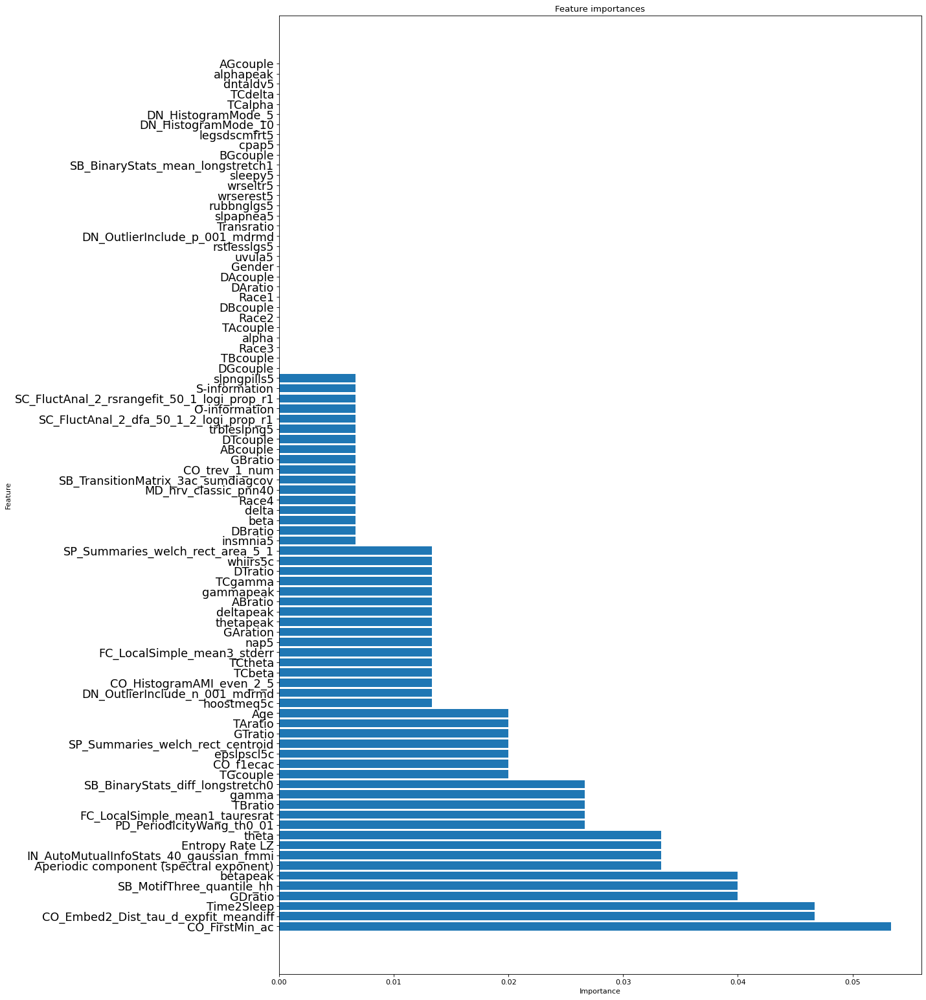

In [63]:
from imblearn.ensemble import RUSBoostClassifier

# Split test,  and training sets
X_train_5, y_train_5, X_test_5, y_test_5, sbj_train_set_5, sbj_test_set_5 = train_test_split_sbjs(mydata_normalised_preprocessed_one_hot_5_10, test_size = 0.2, random_seed = 42)

# Create a random forest classifier
rusbc = RUSBoostClassifier(n_estimators=150, random_state=42, sampling_strategy='all', replacement=False)

print('CROSS-VALIDATION')

# Perform cross-validation
predictions_cv_class_5_10, actuals_cv_class_5_10 = cross_validation_group(X_train_5, y_train_5, sbj_train_set_5, rusbc, n_splits=5, ifresample = False)

# Evaluate the predictions made during cross-validation
evaluate_classification(actuals_cv_class_5_10, predictions_cv_class_5_10, index = ['5 minutes before sleep', 'Awake'], columns = ['5 minutes before sleep', 'Awake'])


#rusbc.fit(X_train_5, y_train_5)

importances, indices, names = plot_feature_importances(rusbc, X_train_5)

# Try it on 10 minutes prior to sleep onset and 10-30 minutes prior to sleep onset

In [64]:

# Try classification on 5 minutes before sleep and 20+ minutes before sleep
mydata_normalised_preprocessed_one_hot_10_10 = mydata_normalised_preprocessed_one_hot[(mydata_normalised_preprocessed_one_hot['Label'] < 10) | (mydata_normalised_preprocessed_one_hot['Label'] >= 10)].copy()

# Swap Label columns into categorical '5 minutes before sleep'  (if Label <= 5) and '20+ minutes before sleep' in the other case

mydata_normalised_preprocessed_one_hot_10_10['Label'] = np.where(mydata_normalised_preprocessed_one_hot_10_10['Label'] < 10, '10 minutes before sleep', 'Awake')


## Balanced Random Forest Classifier

CROSS-VALIDATION
-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.6942857142857143
Overall f1-score of fold 1:  0.701894493895175
                         precision    recall  f1-score   support

10 minutes before sleep       0.53      0.69      0.60      8400
                  Awake       0.82      0.69      0.75     16800

               accuracy                           0.69     25200
              macro avg       0.68      0.69      0.68     25200
           weighted avg       0.72      0.69      0.70     25200

-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.6938095238095238
Overall f1-score of fold 2:  0.7009444560604918
                         precision    recall  f1-score   support

10 minutes before sleep       0.53      0.68      0.60      8400
                  Awake       0.81      0.70      0.75     16800

               accuracy                           0.69     25200
              macro avg       0.67      0.69      0.67     25

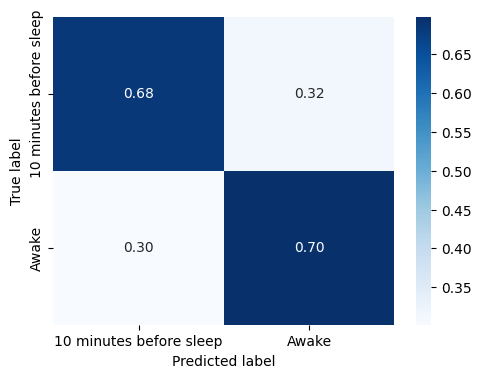

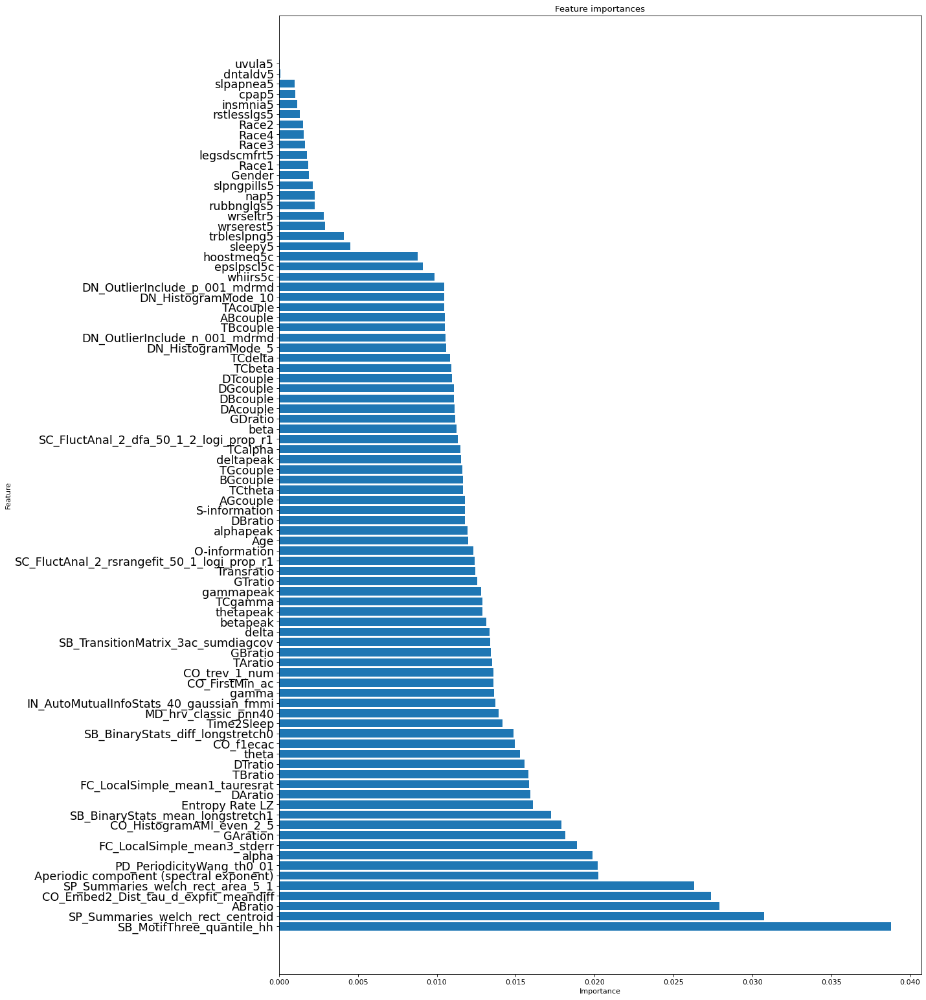

In [65]:
# # Split test,  and training sets
X_train_10, y_train_10, X_test_10, y_test_10, sbj_train_set_10, sbj_test_set_10 = train_test_split_sbjs(mydata_normalised_preprocessed_one_hot_10_10, test_size = 0.2, random_seed = 42)

# Create a random forest classifier
brfc = BalancedRandomForestClassifier(n_estimators=150, random_state=42, sampling_strategy='all', replacement=False)

print('CROSS-VALIDATION')

# Perform cross-validation
predictions_cv_class_10_10, actuals_cv_class_10_10 = cross_validation_group(X_train_10, y_train_10, sbj_train_set_10, brfc, n_splits=5, ifresample = False)

# Evaluate the predictions made during cross-validation
evaluate_classification(actuals_cv_class_10_10, predictions_cv_class_10_10, index = ['10 minutes before sleep', 'Awake'], columns = ['10 minutes before sleep', 'Awake'])


brfc.fit(X_train_10, y_train_10)

importances, indices, names = plot_feature_importances(brfc, X_train_10)

## Balanced Bagging Classifier

CROSS-VALIDATION
-------------- Fold number 1/5 --------------


/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/imblearn/ensemble/_bagging.py:362: FutureWarning: `base_estimator` was renamed to `estimator` in version 0.10 and will be removed in 0.12.
  warnings.warn(


Accuracy of fold 1:  0.6545238095238095
Overall f1-score of fold 1:  0.6628740152561414
                         precision    recall  f1-score   support

10 minutes before sleep       0.49      0.63      0.55      8400
                  Awake       0.78      0.67      0.72     16800

               accuracy                           0.65     25200
              macro avg       0.63      0.65      0.63     25200
           weighted avg       0.68      0.65      0.66     25200

-------------- Fold number 2/5 --------------


/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/imblearn/ensemble/_bagging.py:362: FutureWarning: `base_estimator` was renamed to `estimator` in version 0.10 and will be removed in 0.12.
  warnings.warn(


Accuracy of fold 2:  0.6909126984126984
Overall f1-score of fold 2:  0.6962683704478106
                         precision    recall  f1-score   support

10 minutes before sleep       0.53      0.62      0.57      8400
                  Awake       0.79      0.72      0.76     16800

               accuracy                           0.69     25200
              macro avg       0.66      0.67      0.67     25200
           weighted avg       0.71      0.69      0.70     25200

-------------- Fold number 3/5 --------------


/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/imblearn/ensemble/_bagging.py:362: FutureWarning: `base_estimator` was renamed to `estimator` in version 0.10 and will be removed in 0.12.
  warnings.warn(


Accuracy of fold 3:  0.6839285714285714
Overall f1-score of fold 3:  0.687290151014834
                         precision    recall  f1-score   support

10 minutes before sleep       0.52      0.57      0.55      8400
                  Awake       0.78      0.74      0.76     16800

               accuracy                           0.68     25200
              macro avg       0.65      0.66      0.65     25200
           weighted avg       0.69      0.68      0.69     25200

-------------- Fold number 4/5 --------------


/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/imblearn/ensemble/_bagging.py:362: FutureWarning: `base_estimator` was renamed to `estimator` in version 0.10 and will be removed in 0.12.
  warnings.warn(


Accuracy of fold 4:  0.7042063492063492
Overall f1-score of fold 4:  0.7079911024354796
                         precision    recall  f1-score   support

10 minutes before sleep       0.55      0.62      0.58      8400
                  Awake       0.80      0.75      0.77     16800

               accuracy                           0.70     25200
              macro avg       0.67      0.68      0.68     25200
           weighted avg       0.71      0.70      0.71     25200

-------------- Fold number 5/5 --------------


/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/imblearn/ensemble/_bagging.py:362: FutureWarning: `base_estimator` was renamed to `estimator` in version 0.10 and will be removed in 0.12.
  warnings.warn(


Accuracy of fold 5:  0.685863453815261
Overall f1-score of fold 5:  0.6889857519608911
                         precision    recall  f1-score   support

10 minutes before sleep       0.53      0.57      0.55      8300
                  Awake       0.78      0.74      0.76     16600

               accuracy                           0.69     24900
              macro avg       0.65      0.66      0.65     24900
           weighted avg       0.69      0.69      0.69     24900

Accuracy: 0.6838822593476531
                         precision    recall  f1-score   support

10 minutes before sleep       0.52      0.60      0.56     41900
                  Awake       0.78      0.72      0.75     83800

               accuracy                           0.68    125700
              macro avg       0.65      0.66      0.66    125700
           weighted avg       0.70      0.68      0.69    125700



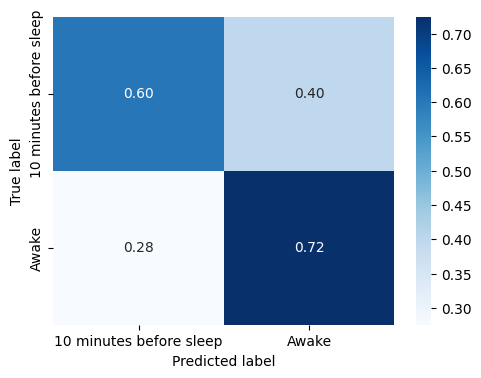

In [66]:
from imblearn.ensemble import BalancedBaggingClassifier
from sklearn.tree import DecisionTreeClassifier

# Split test,  and training sets
X_train_10, y_train_10, X_test_10, y_test_10, sbj_train_set_10, sbj_test_set_10 = train_test_split_sbjs(mydata_normalised_preprocessed_one_hot_10_10, test_size = 0.2, random_seed = 42)

# Create a balanced bagging classifier
bbc = BalancedBaggingClassifier(base_estimator=DecisionTreeClassifier(), n_estimators=30, random_state=42, sampling_strategy='all', replacement=False)

print('CROSS-VALIDATION')

# Perform cross-validation
predictions_cv_class_10_10, actuals_cv_class_10_10 = cross_validation_group(X_train_10, y_train_10, sbj_train_set_10, bbc, n_splits=5, ifresample = False)

# Evaluate the predictions made during cross-validation
evaluate_classification(actuals_cv_class_10_10, predictions_cv_class_10_10, index = ['10 minutes before sleep', 'Awake'], columns = ['10 minutes before sleep', 'Awake'])

#bbc.fit(X_train_5, y_train_5)

#importances, indices, names = plot_feature_importances(bbc, X_train_5)

## Easy Ensemble Classifier

In [67]:
from imblearn.ensemble import EasyEnsembleClassifier

# Split test,  and training sets
#X_train_5, y_train_5, X_test_5, y_test_5, sbj_train_set_5, sbj_test_set_5 = train_test_split_sbjs(mydata_normalised_preprocessed_one_hot_5_10, test_size = 0.2, random_seed = 42)

# Create an easy ensemble  classifier
esc = EasyEnsembleClassifier(n_estimators=30, random_state=42, sampling_strategy='all', replacement=False)

print('CROSS-VALIDATION')

# Perform cross-validation
predictions_cv_class_10_10, actuals_cv_class_10_10 = cross_validation_group(X_train_10, y_train_10, sbj_train_set_10, esc, n_splits=5, ifresample = False)

# Evaluate the predictions made during cross-validation
evaluate_classification(actuals_cv_class_10_10, predictions_cv_class_10_10, index = ['10 minutes before sleep', 'Awake'], columns = ['10 minutes before sleep', 'Awake'])


#esc.fit(X_train_5, y_train_5)

#importances, indices, names = plot_feature_importances(esc, X_train_5)

CROSS-VALIDATION
-------------- Fold number 1/5 --------------


Accuracy of fold 1:  0.661547619047619
Overall f1-score of fold 1:  0.6711444934831929
                         precision    recall  f1-score   support

10 minutes before sleep       0.49      0.71      0.58      8400
                  Awake       0.82      0.64      0.71     16800

               accuracy                           0.66     25200
              macro avg       0.66      0.67      0.65     25200
           weighted avg       0.71      0.66      0.67     25200

-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.6892063492063492
Overall f1-score of fold 2:  0.6966531911282524
                         precision    recall  f1-score   support

10 minutes before sleep       0.53      0.68      0.59      8400
                  Awake       0.81      0.70      0.75     16800

               accuracy                           0.69     25200
              macro avg       0.67      0.69      0.67     25200
           weighted avg       0.72      0.69      0.70     

## RUSBoost Classifier


CROSS-VALIDATION
-------------- Fold number 1/5 --------------
Accuracy of fold 1:  0.6064607882974401
Overall f1-score of fold 1:  0.6061587478915301
                         precision    recall  f1-score   support

10 minutes before sleep       0.62      0.58      0.60      2497
                  Awake       0.59      0.64      0.61      2425

               accuracy                           0.61      4922
              macro avg       0.61      0.61      0.61      4922
           weighted avg       0.61      0.61      0.61      4922

-------------- Fold number 2/5 --------------
Accuracy of fold 2:  0.6066639577407558
Overall f1-score of fold 2:  0.6068134545883739
                         precision    recall  f1-score   support

10 minutes before sleep       0.63      0.62      0.63      2613
                  Awake       0.58      0.59      0.58      2309

               accuracy                           0.61      4922
              macro avg       0.61      0.61      0.61      

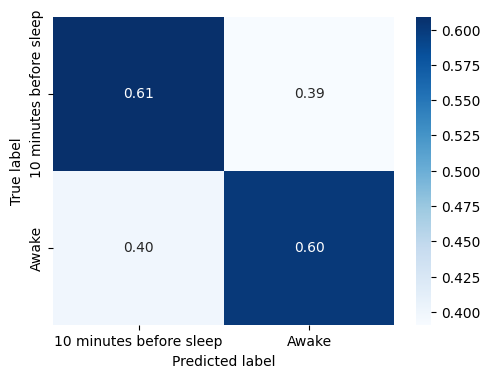

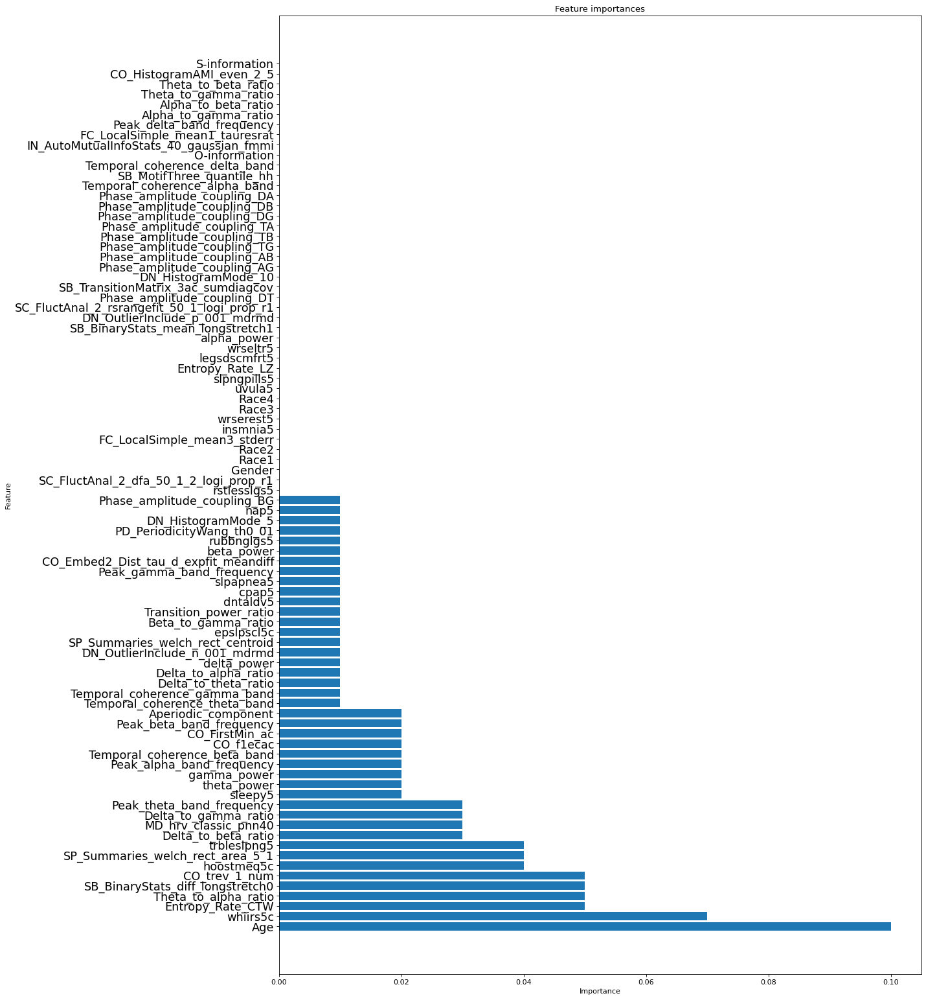

In [ ]:
from imblearn.ensemble import RUSBoostClassifier

# Split test,  and training sets
X_train_10, y_train_10, X_test_10, y_test_10, sbj_train_set_10, sbj_test_set_10 = train_test_split_sbjs(mydata_normalised_preprocessed_one_hot_10_10, test_size = 0.2, random_seed = 42)

# Create a random forest classifier
rusbc = RUSBoostClassifier(n_estimators=100, random_state=42, sampling_strategy='all', replacement=False)

print('CROSS-VALIDATION')

# Perform cross-validation
predictions_cv_class_10_10, actuals_cv_class_10_10 = cross_validation_group(X_train_10, y_train_10, sbj_train_set_10, rusbc, n_splits=5, ifresample = False)

# Evaluate the predictions made during cross-validation
evaluate_classification(actuals_cv_class_10_10, predictions_cv_class_10_10, index = ['10 minutes before sleep', 'Awake'], columns = ['10 minutes before sleep', 'Awake'])


#rusbc.fit(X_train_5, y_train_5)

importances, indices, names = plot_feature_importances(rusbc, X_train_10)

# Test the most optimal model -> Balanced Random Forest Classifier


## Define the helper functions

In [86]:

def get_timeline(mydata_no_nan):
 
    # assert that the data has no NaNs
    assert mydata_no_nan.isnull().sum().sum() == 0, 'There are NaNs in the data'
    

    # Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)
    X_all = mydata_no_nan.drop(['Label', 'Old_label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Time2Sleep'], axis=1)
    y_all = mydata_no_nan['Label']
    y_old_all = mydata_no_nan['Old_label']
    y_sleepstage_all = mydata_no_nan['SleepStage']

    

    return X_all, y_all, y_old_all, y_sleepstage_all

In [87]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import pandas as pd
import os
from sklearn.metrics import (accuracy_score, classification_report, confusion_matrix, 
                             roc_curve, roc_auc_score, auc)
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import f1_score

def evaluate_classification(true_labels, predictions, prediction_probabilities,
                            index=['10 minutes before sleep', 'Awake'], 
                            columns=['10 minutes before sleep', 'Awake'], 
                            save_path='confusion_matrix.png', ifsaveplots = False, 
                            output_path=None, iftest = False, ifplot = True, classes = None, ifvocal = True):
    
    # Evaluate the performance of the model
    accuracy = accuracy_score(true_labels, predictions)
    if iftest:
        if ifvocal:
            print(f'Accuracy: {accuracy}')

    # Classification report 
    report = classification_report(true_labels, predictions)
    if iftest:
        if ifvocal:
            print(report)
    
    # Decide on the filename based on iftest
    report_filename = 'test_classification_report.txt' if iftest else 'crossval_classification_report.txt'
    
    # Dictionary to store all metrics
    metrics_dict = {}
    metrics_dict['accuracy'] = accuracy
    # Classification report 
    true_labels_report = true_labels != 'Awake'
    true_labels_report = true_labels_report.astype(int)

    predictions_report = predictions != 'Awake'
    predictions_report = predictions_report.astype(int)

    precision, recall, _, _ = precision_recall_fscore_support(true_labels_report, predictions_report, average='binary')
    f1_weighted = f1_score(true_labels_report, predictions_report, average='weighted')
    f1_macro = f1_score(true_labels_report, predictions_report, average='macro')
    f1_pre_sleep = f1_score(true_labels_report, predictions_report, average=None)[0]
    f1_awake = f1_score(true_labels_report, predictions_report, average=None)[1]
    
    metrics_dict['precision'] = precision
    metrics_dict['recall'] = recall
    metrics_dict['f1_weighted'] = f1_weighted
    metrics_dict['f1_macro'] = f1_macro
    metrics_dict['f1_pre_sleep'] = f1_pre_sleep
    metrics_dict['f1_awake'] = f1_awake

    if iftest:
        if ifvocal:
            print('F1 pre-sleep: ', f1_pre_sleep)
            print('F1 awake: ', f1_awake)
    


    # Save classification report to a .txt file
    if ifsaveplots:
        if output_path:
            report_filename = os.path.join(output_path, report_filename)
        with open(report_filename, 'w') as f:
            f.write(report)
    # Plot the confusion matrix

    # Include the names of the classes in the confusion matrix
    cm = confusion_matrix(true_labels, predictions, normalize='true', labels=index)
    cm = pd.DataFrame(cm, index=index, columns=columns)

    # Rename the columns and rows to the names of the classes
    cm.index = columns
    plt.figure(figsize=(5.5, 4))
    sns.heatmap(cm, annot=True, fmt='.2f', cmap='Blues')

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.title('Confusion Matrix for times before sleep')
    
    if iftest:
        saving_prefix = 'test'
    else: 
        saving_prefix = 'crossval'

    save_path = f'{saving_prefix}_{save_path}'

    if ifsaveplots:
        if output_path:
            save_path = os.path.join(output_path, save_path)
        # Save the confusion matrix to a file
        plt.savefig(save_path)
    
    # Display the confusion matrix
    if ifplot:
        plt.show()
    plt.close()

    roc_path = f'{saving_prefix}_roc_curve.png'
    
    # ROC and AUC

    # if array is 2D
    if len(prediction_probabilities.shape) == 2:
        class_idx = np.where(classes != 'Awake')[0][0]
        prediction_probabilities = prediction_probabilities[:,class_idx]
    else:
        prediction_probabilities = prediction_probabilities.ravel()

    
    fpr, tpr, _ = roc_curve(true_labels_report, prediction_probabilities.ravel())
    roc_auc = auc(fpr, tpr)
    #metrics_dict['roc_curve'] = (fpr, tpr)
    metrics_dict['auc'] = roc_auc

    plt.figure(figsize=(7, 7))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC)')
    plt.legend(loc="lower right")
    

    if ifsaveplots:
        if output_path:
            roc_path = os.path.join(output_path, roc_path)
        plt.savefig(roc_path)
    
    if ifplot:
        plt.show()
    plt.close()
    
    return metrics_dict
    

In [88]:
import numpy as np
import matplotlib.pyplot as plt
import os

def preprocess_data(y_pred, y_true, timeline, sleep_stage):
    y_pred = np.array(y_pred)
    y_true = np.array(y_true)
    timeline = np.array(timeline)
    sleep_stage = np.array(sleep_stage)
    timeline = np.round(timeline, 1)
    return y_pred, y_true, timeline, sleep_stage

def get_indices_for_unique_values(timeline):
    unique_values = np.unique(timeline)
    unique_values_sorted = np.sort(unique_values)
    indices = {}
    for value in unique_values:
        indices[value] = np.where(timeline == value)[0]
    return dict(sorted(indices.items())), unique_values_sorted

def update_indices_with_missing_values(indices, rnn_window):
    timegrid = np.arange(0, 30.1 - rnn_window, 0.1)
    timegrid = np.round(timegrid, 1)
    missing_values = np.setdiff1d(timegrid, list(indices.keys()))
    for value in missing_values:
        indices[value] = np.nan
    return dict(sorted(indices.items())), timegrid

def sort_predictions_by_time(y_pred, indices, timegrid):
    y_pred_sorted = [np.mean(y_pred[indices[value]]) if not np.isnan(indices[value]).any() else np.nan for value in timegrid]
    y_pred_std = [np.std(y_pred[indices[value]]) if not np.isnan(indices[value]).any() else np.nan for value in timegrid]
    return y_pred_sorted, y_pred_std

def downsample_data(data, window_for_averaging):
    return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]

def plot_data(y_pred_mean, y_pred_std, 
             sleep_stage_mean, sleep_stage_std,
              timegrid, window_for_averaging, 
              rnn_window, pre_sleep_window=None, 
              awake_window=None, ifsaveplots=False,
              output_path=None, ifplot = False,
              ifsubjecttest = False):
    
    # convert to numpy arrays to avoid errors
    y_pred_mean = np.array(y_pred_mean)
    y_pred_std = np.array(y_pred_std)
    sleep_stage_mean = np.array(sleep_stage_mean)
    sleep_stage_std = np.array(sleep_stage_std)


    if ifsubjecttest:
        label_sleep_st ='Sleep Stages'
        label_proba = 'Predicted probability of pre-sleep onset'
    else:
        label_sleep_st  = 'Mean of Sleep Stages'
        label_proba = 'Mean of predicted probability of pre-sleep onset'


    filename=f"sleep_probabilities_averaged_over_{window_for_averaging}.jpg"
    plt.figure(figsize=(20,10))
    plt.xlabel('Minutes', fontsize=14)
    xticks = np.arange(0, len(y_pred_mean), 10//window_for_averaging)
    plt.xticks(xticks, timegrid[xticks*window_for_averaging], fontsize=12)
    plt.yticks(fontsize=12)

    

    # plot the mean predictions              
    plt.plot(y_pred_mean, label=label_proba, color='blue')
    # plot the average sleep stage
    plt.plot(sleep_stage_mean, label=label_sleep_st, color='purple', linestyle='--')
    plt.hlines(0.5, linestyle='--', color='r', label='Threshold for classifying as pre-sleep onset', xmin=0, xmax=len(y_pred_mean))
    
    if awake_window is not None:
        awake_window_probas = int((awake_window - rnn_window)* 10//window_for_averaging) 
        plt.axvspan(awake_window_probas, len(y_pred_mean), facecolor='g', alpha=0.2, label='Awake window')
        
    if pre_sleep_window is not None:
        pre_sleep_window_probas = int((pre_sleep_window - rnn_window) * 10//window_for_averaging) 
        plt.axvspan(pre_sleep_window_probas, 0, facecolor='r', alpha=0.2, label='Pre-sleep window')
        
    plt.ylim(-0.1, 1.1)
    plt.legend(loc='upper right', fontsize=12)
    if ifsaveplots:
        if output_path:
            filename = os.path.join(output_path, filename)
        plt.savefig(filename, format='jpg', dpi=300)
    if ifplot:
        plt.show()
    plt.close()


    filename=f"with_std_sleep_probabilities_averaged_over_{window_for_averaging}.jpg"
    plt.figure(figsize=(20,10))
    plt.xlabel('Minutes', fontsize=14)
    xticks = np.arange(0, len(y_pred_mean), 10//window_for_averaging)
    plt.xticks(xticks, timegrid[xticks*window_for_averaging], fontsize=12)
    plt.yticks(fontsize=12)

    # plot the mean predictions              
    plt.plot(y_pred_mean, label= label_proba, color='blue')
    # plot the standard deviation of predictions as a shaded area
    plt.fill_between(np.arange(len(y_pred_mean)), y_pred_mean - y_pred_std, y_pred_mean + y_pred_std, alpha=0.1, color='blue')
    # plot the average sleep stage
   
    plt.plot(sleep_stage_mean, label = label_sleep_st, color='purple', linestyle='--')
    # plot the standard deviation of sleep stage as a shaded area
    plt.fill_between(np.arange(len(sleep_stage_mean)), sleep_stage_mean - sleep_stage_std, sleep_stage_mean + sleep_stage_std, alpha=0.1, color='purple')
    plt.hlines(0.5, linestyle='--', color='r', label='Threshold for classifying as pre-sleep onset', xmin=0, xmax=len(y_pred_mean))
    
    if awake_window is not None:
        awake_window_probas = int((awake_window - rnn_window)* 10//window_for_averaging) 
        plt.axvspan(awake_window_probas, len(y_pred_mean), facecolor='g', alpha=0.2, label='Awake window')
        
    if pre_sleep_window is not None:
        pre_sleep_window_probas = int((pre_sleep_window - rnn_window) * 10//window_for_averaging) 
        plt.axvspan(pre_sleep_window_probas, 0, facecolor='r', alpha=0.2, label='Pre-sleep window')
        
    plt.ylim(-0.1, 1.1)
    plt.legend(loc='upper right', fontsize=12)
    if ifsaveplots:
        if output_path:
            filename = os.path.join(output_path, filename)
        plt.savefig(filename, format='jpg', dpi=300)
    if ifplot:
        plt.show()
    plt.close()


def calculate_metrics(y_pred, y_true, timegrid, indices):
    correct = y_true == y_pred

    y_pred_binarised = np.where(y_pred != 'Awake', 1, 0)
    y_true_binarised = np.where(y_true != 'Awake', 1, 0)

    accuracies = [np.mean(correct[indices[value]]) if not np.isnan(indices[value]).any() else np.nan for value in timegrid]
    
    prediction_dict_by_time = {value: y_pred_binarised[indices[value]] if indices[value] is not np.nan else np.nan for value in timegrid}
    true_values_dict_by_time = {value: y_true_binarised[indices[value]] if indices[value] is not np.nan else np.nan for value in timegrid}
    
    tp = {value: np.sum(np.logical_and(prediction_dict_by_time[value] == 1, true_values_dict_by_time[value] == 1))
          if not np.isnan(indices[value]).any() else np.nan for value in timegrid}
    tn = {value: np.sum(np.logical_and(prediction_dict_by_time[value] == 0, true_values_dict_by_time[value] == 0))
          if not np.isnan(indices[value]).any() else np.nan for value in timegrid}
    fp = {value: np.sum(np.logical_and(prediction_dict_by_time[value] == 1, true_values_dict_by_time[value] == 0))
          if not np.isnan(indices[value]).any() else np.nan for value in timegrid}
    fn = {value: np.sum(np.logical_and(prediction_dict_by_time[value] == 0, true_values_dict_by_time[value] == 1))
          if not np.isnan(indices[value]).any() else np.nan for value in timegrid}

    recall = [tp[value] / (tp[value] + fn[value]) if (tp[value] + fn[value]) != 0 else 0 for value in timegrid]
    precision = [tp[value] / (tp[value] + fp[value]) if (tp[value] + fp[value]) != 0 else 0 for value in timegrid]
    f1 = [2 * (precision[i] * recall[i]) / (precision[i] + recall[i]) if precision[i] + recall[i] != 0 else np.nan for i in range(len(precision))]

    return accuracies, recall, precision, f1

def plot_metric(metric_values, metric_name, color, timegrid, window_for_averaging, rnn_window, 
                pre_sleep_window=None, awake_window=None, ifsaveplots=False, output_path=None,
                ifplot = False):
    
    plt.figure(figsize=(20,10))
    plt.xlabel('Minutes', fontsize=14)
    xticks = np.arange(0, len(metric_values), 10//window_for_averaging)
    plt.xticks(xticks, timegrid[xticks*window_for_averaging], fontsize=12)
    plt.yticks(fontsize=12)
    
    plt.plot(metric_values, label=metric_name, color=color)
    plt.hlines(0.5, linestyle='--', color='r', label='Threshold for classifying as pre-sleep onset', xmin=0, xmax=len(metric_values))
    
    if awake_window is not None:
        awake_window_probas = int((awake_window - rnn_window)* 10//window_for_averaging) 
        plt.axvspan(awake_window_probas, len(metric_values), facecolor='g', alpha=0.2, label='Awake window')
        
    if pre_sleep_window is not None:
        pre_sleep_window_probas = int((pre_sleep_window - rnn_window) * 10//window_for_averaging) 
        plt.axvspan(pre_sleep_window_probas, 0, facecolor='r', alpha=0.2, label='Pre-sleep window')
        
    plt.ylim(-0.1, 1.1)
    plt.legend(loc='upper right', fontsize=12)
    if ifsaveplots:
        filename = f"{metric_name}_metric_averaged_over_{window_for_averaging}.jpg"
        if output_path:
            filename = os.path.join(output_path, filename)
        plt.savefig(filename, format='jpg', dpi=300)
    
    if ifplot:
        plt.show()
    plt.close()


def plot_metrics(accuracies, recall, precision, f1, 
                 timegrid, window_for_averaging, rnn_window, 
                 pre_sleep_window=None, awake_window=None, 
                 ifsaveplots=False, output_path=None, ifplot = False):
    
    plot_metric(accuracies, 'Accuracy', 'blue', timegrid, window_for_averaging, rnn_window, 
                pre_sleep_window, awake_window, ifsaveplots, output_path, ifplot = ifplot)
    
    plot_metric(recall, 'Recall', 'green', timegrid, window_for_averaging, rnn_window, 
                pre_sleep_window, awake_window, ifsaveplots, output_path, ifplot = ifplot)
    
    plot_metric(precision, 'Precision', 'purple', timegrid, window_for_averaging, rnn_window, 
                pre_sleep_window, awake_window, ifsaveplots, output_path, ifplot = ifplot)
    
    plot_metric(f1, 'F1', 'red', timegrid, window_for_averaging, rnn_window, 
                pre_sleep_window, awake_window, ifsaveplots, output_path, ifplot = ifplot)

    



In [89]:
def check_accuracy_timeline(y_pred, y_true, timeline, sleep_stage, window_for_averaging=1, 
                            if_proba=False, classes=None, pre_sleep_window=None, 
                            awake_window=None, rnn_window=None, ifsaveplots=False, output_path=None,
                            ifplot = False, ifsubjecttest = False):
    y_pred, y_true, timeline, sleep_stage = preprocess_data(y_pred, y_true, timeline, sleep_stage)
    
    indices, unique_values_sorted = get_indices_for_unique_values(timeline)
    indices, timegrid = update_indices_with_missing_values(indices, rnn_window)
    
    if if_proba:
        if classes is not None:
            class_idx = np.where(classes != 'Awake')[0][0]
            

            y_pred = y_pred[:,class_idx]
        
        y_pred_mean, y_pred_std = sort_predictions_by_time(y_pred, indices, timegrid)
        sleep_stage_mean, sleep_stage_std = sort_predictions_by_time(sleep_stage, indices, timegrid)

        if window_for_averaging > 1:
            y_pred_mean = downsample_data(y_pred_mean, window_for_averaging)
            y_pred_std = downsample_data(y_pred_std, window_for_averaging)
            sleep_stage_mean= downsample_data(sleep_stage_mean, window_for_averaging)
            sleep_stage_std = downsample_data(sleep_stage_std, window_for_averaging)
            downsampled_timegrid = downsample_data(timegrid, window_for_averaging)
            print(downsampled_timegrid)

        plot_data(y_pred_mean, y_pred_std, sleep_stage_mean, sleep_stage_std,
                  timegrid, window_for_averaging, rnn_window, 
                  pre_sleep_window, awake_window, ifsaveplots, 
                  output_path, ifplot = ifplot, ifsubjecttest = ifsubjecttest)

        if window_for_averaging > 1:
            dict_pred_time = {downsampled_timegrid[i]: y_pred_mean[i] for i in range(len(y_pred_mean))}
            return dict_pred_time
        else:
            return y_pred_mean

    else:
        accuracies, recall, precision, f1 = calculate_metrics(y_pred, y_true, timegrid, indices)
        if window_for_averaging > 1:
            accuracies = downsample_data(accuracies, window_for_averaging)
            recall = downsample_data(recall, window_for_averaging)
            precision = downsample_data(precision, window_for_averaging)
            f1 = downsample_data(f1, window_for_averaging)

        
        plot_metrics(accuracies, recall, precision, f1, 
                     timegrid, window_for_averaging, rnn_window, 
                     pre_sleep_window, awake_window, ifsaveplots, 
                     output_path, ifplot = ifplot)
        
        
        return accuracies, recall, precision, f1
        


In [90]:
def evaluate_regression(predictions, y_test, ifsave = False, savepath = None, ifplot = False, iftest = False):

    # check if the predictions are in the correct format
   
    predictions = np.array(predictions)

    # check if the y_test is in the correct format
    
    y_test = np.array(y_test)

    errors = abs(y_test - predictions)
    mape = np.where(y_test != 0, 100 * (errors / y_test), 0)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_test, predictions)
    squared_errors = np.square(y_test - predictions)
    weights = 1.0 /(abs(y_test) + 0.1)
    custom_mse = np.mean(weights * squared_errors)

    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))
    print('Custom MSE:', round(custom_mse, 2))

    


    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1)
    plt.scatter(y_test, predictions, alpha=0.2)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    if ifsave:
        if iftest:
            plt.savefig(os.path.join(savepath, 'test_actual_vs_predicted.png'))
        else:
            plt.savefig(os.path.join(savepath, 'crossval_actual_vs_predicted.png'))
    if ifplot:
        plt.show()
    plt.close()

    residuals = y_test - predictions
    plt.scatter(y_test, residuals, alpha=0.2)
    plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Residuals')
    plt.title('Actual vs Residuals for predicted time to sleep onset')
    if ifsave:
        if iftest:
            plt.savefig(os.path.join(savepath, 'test_actual_vs_residuals.png'))
        else:
            plt.savefig(os.path.join(savepath, 'crossval_actual_vs_residuals.png'))
    if ifplot:
        plt.show()
    plt.close()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    if ifsave:
        if iftest:
            plt.savefig(os.path.join(savepath, 'test_residuals_distribution.png'))
        else:
            plt.savefig(os.path.join(savepath, 'crossval_residuals_distribution.png'))
    if ifplot:
        plt.show()
    plt.close()

    # for each actual, plot the mean residual 
    # round y_test to 0.1 decimal place
    y_test = np.round(y_test, 1)

    predictions_residuals_dict = {}
    for i in range(len(y_test)):
        if y_test[i] not in predictions_residuals_dict:
            predictions_residuals_dict[y_test[i]] = []
        predictions_residuals_dict[y_test[i]].append(residuals[i])
    
    # sort it in ascending order of keys
    predictions_residuals_dict = dict(sorted(predictions_residuals_dict.items()))


    actual_predictions_dict = {}
    for i in range(len(y_test)):
        if y_test[i] not in actual_predictions_dict:
            actual_predictions_dict[y_test[i]] = []
        actual_predictions_dict[y_test[i]].append(predictions[i])
    
    # sort it in ascending order of keys
    actual_predictions_dict = dict(sorted(actual_predictions_dict.items()))

    
    predictions_residuals_mean_dict = {}
    for key in predictions_residuals_dict:
        predictions_residuals_mean_dict[key] = np.mean(predictions_residuals_dict[key])
    
    # sort it in ascending order of keys
    predictions_residuals_mean_dict = dict(sorted(predictions_residuals_mean_dict.items()))


    residuals_std_dict = {}
    for key in predictions_residuals_dict:
        residuals_std_dict[key] = np.std(predictions_residuals_dict[key])
    # sort it in ascending order of keys
    residuals_std_dict = dict(sorted(residuals_std_dict.items()))

    
    actuals_predictions_mean_dict = {}
    for key in actual_predictions_dict:
        actuals_predictions_mean_dict[key] = np.mean(actual_predictions_dict[key])
    
    # sort it in ascending order of keys
    actuals_predictions_mean_dict = dict(sorted(actuals_predictions_mean_dict.items()))

    predictions_std_dict = {}
    for key in actual_predictions_dict:
        predictions_std_dict[key] = np.std(actual_predictions_dict[key])
    # sort it in ascending order of keys
    predictions_std_dict = dict(sorted(predictions_std_dict.items()))

    plt.plot(list(predictions_residuals_mean_dict.keys()), list(predictions_residuals_mean_dict.values()))
    # create std shading
    plt.fill_between(list(predictions_residuals_mean_dict.keys()),
                        np.array(list(predictions_residuals_mean_dict.values())) - np.array(list(residuals_std_dict.values())),
                        np.array(list(predictions_residuals_mean_dict.values())) + np.array(list(residuals_std_dict.values())),
                        alpha=0.2)
    # plot ideal line (x = 0)
    plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
    plt.legend(['Mean of residuals', 'STD of residuals', 'Ideal residuals line'])
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Residuals for this actual')
    plt.title('Mean residual of predictions for each actual time to sleep onset')
    if ifsave:
        if iftest:
            plt.savefig(os.path.join(savepath, 'test_mean_residuals_across_time.png'))
        else:
            plt.savefig(os.path.join(savepath, 'crossval_mean_residuals_across_time.png'))
    if ifplot:
        plt.show()
    plt.close()

    plt.plot(list(actuals_predictions_mean_dict.keys()), list(actuals_predictions_mean_dict.values()))
    # create std shading
    plt.fill_between(list(actuals_predictions_mean_dict.keys()),
                        np.array(list(actuals_predictions_mean_dict.values())) - np.array(list(predictions_std_dict.values())),
                        np.array(list(actuals_predictions_mean_dict.values())) + np.array(list(predictions_std_dict.values())),
                        alpha=0.2)
    # plot ideal line (x = y)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')
    plt.legend(['Mean of predictions', 'STD of predictions', 'Ideal actual = prediction line (x = y)'])
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Mean prediction for this actual')
    plt.title('Mean prediction for each actual time to sleep onset')
    if ifsave:
        if iftest:
            plt.savefig(os.path.join(savepath, 'test_mean_predictions_across_time.png'))
        else:
             plt.savefig(os.path.join(savepath, 'crossval_mean_predictions_across_time.png'))
    if ifplot:
        plt.show()
    plt.close()

    test_metrics = {'MAE': round(np.mean(errors), 2), 'Accuracy': round(accuracy, 2), 
    'MSE': round(mse, 2), 'RMSE': round(rmse, 2), 'R2': round(r2, 2), 'custom_MSE': round(custom_mse, 2)}
    return test_metrics

In [91]:
def select_random_participants(df, n_participants):
    """Selects a random sample of participants from the dataset.

    Args:
        df (pandas.DataFrame): The dataset.
        n_participants (int): The number of participants to select.

    Returns:
        pandas.DataFrame: A random sample of participants.
    """
    # Select a random sample of participants
    participants = df['Sbj_ID'].unique()
    selected_participants = np.random.choice(participants, n_participants, replace=False)

    # Filter the dataset
    df = df[df['Sbj_ID'].isin(selected_participants)].copy()

    return df, selected_participants

In [92]:
def test_on_random_participants(participants, data, model, random_seed, ifplot, output_path_new, index, brfc_classes, awake_window, pre_sleep_window): 
    
    """
    Test the model on a random subset of participants. 
    """
    # Set random seed

    # create a new folder for the results
    output_path_new = os.path.join(output_path_new, 'random_participants')
    if not os.path.exists(output_path_new):
        os.makedirs(output_path_new)
    
    # intialise empty dataframe to store results
    df_all = pd.DataFrame()

    
    participant_probas = {}
    participant_timeline = {}

    for sbj in data['Sbj_ID'].unique():
        # create a folder for each participant
        output_path_participant = os.path.join(output_path_new, str(sbj))
        if not os.path.exists(output_path_participant):
            os.makedirs(output_path_participant)


        participant_data = data[data['Sbj_ID'] == sbj].copy()
        y = participant_data['Label']
        timeline = participant_data['Old_label']
        sleep_stages = participant_data['SleepStage']
        X = participant_data.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Time2Sleep', 'Old_label'], axis=1)

        predictions = model.predict(X)
        prediction_probabilities = model.predict_proba(X)
        

        class_idx = np.where(brfc_classes != 'Awake')[0][0]
        prediction_probas_sleep =prediction_probabilities[:,class_idx]
        participant_probas[sbj] = prediction_probas_sleep
        participant_timeline[sbj] = timeline



        # get the accuracy of each timepoint
        if ifplot:
            print('Predict for participant: ', sbj)

            print('--------------------------------------Evaluate classificaiton ----------------------------------------')
        
        test_metrics = evaluate_classification(y, predictions, prediction_probabilities, index = index, iftest=True,
                                ifplot=ifplot, output_path=output_path_participant, ifsaveplots= True, classes = brfc_classes, ifvocal = False)
        
        df = pd.DataFrame(test_metrics, index = [sbj])
        df_all = pd.concat([df_all, df])
        if ifplot:
            print('------------------------------------------- No averaging ----------------------------------------')
            print('Accuracy')
            
        accuracies, precision, recall, f1 = check_accuracy_timeline(y_pred = predictions, y_true = y,
                                                                    timeline = timeline, sleep_stage = sleep_stages, 
                                                                    window_for_averaging=1, awake_window=awake_window, pre_sleep_window=pre_sleep_window,
                                                                    if_proba=False, classes=None, rnn_window = 0, 
                                                                    ifsaveplots=True, output_path=output_path_participant, ifplot = ifplot)
        if ifplot:
            print('Probability of sleep as predicted by the model')
        
        
        y_pred_sorted = check_accuracy_timeline(y_pred = prediction_probabilities, y_true = y,
                                                timeline = timeline, sleep_stage = sleep_stages, 
                                                window_for_averaging=1, awake_window=awake_window, pre_sleep_window=pre_sleep_window,
                                                if_proba=True, classes=brfc_classes, rnn_window = 0, 
                                                ifsaveplots=True, output_path=output_path_participant, ifplot = ifplot, ifsubjecttest = True)


        if ifplot:
            print('-------------------------------Averaging of accuracy over 30 seconds---------------------------------')
            print('Accuracy')
        accuracies, precision, recall, f1 = check_accuracy_timeline(y_pred = predictions, y_true = y,
                                                                    timeline = timeline, sleep_stage = sleep_stages, 
                                                                    window_for_averaging=5, awake_window=awake_window, pre_sleep_window=pre_sleep_window,
                                                                    if_proba=False, classes=None, rnn_window = 0, 
                                                                    ifsaveplots=True, output_path=output_path_participant, ifplot = ifplot)
        if ifplot:
            print('Probability of sleep as predicted by the model')
        
        
        y_pred_sorted = check_accuracy_timeline(y_pred = prediction_probabilities, y_true = y,
                                                timeline = timeline, sleep_stage = sleep_stages, 
                                                window_for_averaging=5, awake_window=awake_window, pre_sleep_window=pre_sleep_window,
                                                if_proba=True, classes=brfc_classes, rnn_window = 0, 
                                                ifsaveplots=True, output_path=output_path_participant, ifplot = ifplot, ifsubjecttest = True)

    df_all.to_csv(os.path.join(output_path_new, 'classification_results_random_participants.csv'))
    
    return participant_probas, participant_timeline

In [93]:
def test_reg_on_random_participants(participant_probas, participant_timeline, model, random_seed, ifplot, output_path_new, index, brfc_classes, awake_window, pre_sleep_window): 
    
    """
    Test the model on a random subset of participants. 
    """
    # Set random seed

    # create a new folder for the results
    output_path_new = os.path.join(output_path_new, 'random_participants')
    if not os.path.exists(output_path_new):
        os.makedirs(output_path_new)
    
    # intialise empty dataframe to store results
    df_all = pd.DataFrame()

    
    for sbj in list(participant_probas.keys()):
        # create a folder for each participant
        
        output_path_participant = os.path.join(output_path_new, str(sbj))
        if not os.path.exists(output_path_participant):
            os.makedirs(output_path_participant)

        y_test_timeline = participant_timeline[sbj]
        probas = participant_probas[sbj]

        # check if y_test_timeline and probas are the same length
        if len(y_test_timeline) != len(probas):
            error = 'y_test_timeline and probas are not the same length'

        if np.isnan(probas).any():
                    for i in range(len(probas)):
                        if np.isnan(probas[i]):
                            # omit the corresponding y_times2sleep
                            y_test_timeline.pop(i)
                            probas.pop(i)


        probas = np.array(probas).reshape(-1, 1)
        

        timeline_predicted = model.predict(probas)
       

        # get the accuracy of each timepoint
        if ifplot:
            print('Predict for participant: ', sbj)

            print('--------------------------------------Evaluate regression ----------------------------------------')
        
        test_metrics = evaluate_regression(timeline_predicted, y_test_timeline, iftest=True,
                                ifplot=ifplot, savepath =output_path_participant, ifsave= True)
        
        df = pd.DataFrame(test_metrics, index = [sbj])
        df_all = pd.concat([df_all, df])

    df_all.to_csv(os.path.join(output_path_new, 'regression_results_random_participants.csv'))
    
   

In [94]:
import matplotlib.pyplot as plt
import os

# Create a function for plotting the sorted feature importances in a long horizontal bar chart and increased font size

def plot_feature_importances(model, X, output_path, ifsaveplots = False, save_name = 'feature_importances.png', ifplot = True):
    save_path = os.path.join(output_path, save_name)
    importances = model.feature_importances_
    indices = np.argsort(importances)[::-1]
    names = [X.columns[i] for i in indices]
    
    fig, ax = plt.subplots(figsize=(16, 24), dpi=80)
    ax.barh(range(X.shape[1]), importances[indices], align='center')
    ax.set_yticks(range(X.shape[1]))
    ax.set_yticklabels(names, fontsize=16)
    ax.set_xlabel('Importance')
    ax.set_ylabel('Feature')
    ax.set_title('Feature importances')
    if ifplot:
        plt.show()
    if ifsaveplots:
        fig.savefig(save_path, bbox_inches='tight')
    plt.close(fig)
    


    return importances, indices, names

In [95]:

def train_test_split_sbjs(mydata_no_nan, test_size = 0.2, random_seed = 42):
 
    # assert that the data has no NaNs
    assert mydata_no_nan.isnull().sum().sum() == 0, 'There are NaNs in the data'
    
    # get the unique subjects
    unique_subjects = mydata_no_nan['Sbj_ID'].unique()

    # define the train size
    train_size = 1 - test_size

    # define the number of subjects in the test set

    test_size_subjects = int(test_size * len(unique_subjects))

    # Select the unique subjects for the test set

    test_subjects = random.sample(list(unique_subjects), test_size_subjects)

    # Select the unique subjects for the training set
    train_subjects = [x for x in unique_subjects if x not in test_subjects]

    # Create the test and training sets
    test_set = mydata_no_nan[mydata_no_nan['Sbj_ID'].isin(test_subjects)]
    train_set = mydata_no_nan[mydata_no_nan['Sbj_ID'].isin(train_subjects)]

    # Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

    X_train = train_set.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Time2Sleep'], axis=1)
    y_train = train_set['Label']
    X_test = test_set.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Time2Sleep'], axis=1)
    y_test = test_set['Label']


    # Create list of sbj_IDs for each sample in the training and test sets
    sbj_train_set = train_set['Sbj_ID'].copy()
    sbj_test_set = test_set['Sbj_ID'].copy()

    # Turn the sbj_IDs into a list
    sbj_train_set = sbj_train_set.tolist()
    sbj_test_set = sbj_test_set.tolist()
    


    return X_train, y_train, X_test, y_test, sbj_train_set, sbj_test_set

In [28]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming feature_importances is a 2D array of shape (len(pre_sleep_times), len(awake_times))
# And pre_sleep_times and awake_times are lists of the unique values you've trained with

def plot_feature_heatmap(feature_importances, pre_sleep_times, awake_times, feature_name):
    plt.figure(figsize=(10, 8))
    sns.heatmap(feature_importances, annot=True, cmap="YlGnBu", 
                xticklabels=awake_times, yticklabels=pre_sleep_times)
    plt.title(f'Feature Importance for {feature_name}')
    plt.xlabel('Awake Time')
    plt.ylabel('Pre Sleep Time')
    plt.show()



In [96]:
def get_rid_of_nans(probabilities, y_times2sleep = None):
    if np.isnan(probabilities).any():
        for i in range(len(probabilities)):
            if np.isnan(probabilities[i]):
                # omit the corresponding y_times2sleep
                if y_times2sleep is not None:
                    y_times2sleep.pop(i)
                probabilities.pop(i)
    return probabilities, y_times2sleep

In [100]:
data_test = pd.read_csv('data_test_cleaned_sbjs.csv')
data_test.dropna(inplace=True)
data_train.dropna(inplace=True)
select_data, selected_participants = select_random_participants(data_test, 10)

In [101]:
# import balanced random forest classifier
import warnings
from imblearn.ensemble import BalancedRandomForestClassifier
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.svm import SVR
# import random forest regressor
from sklearn.ensemble import RandomForestRegressor
def explore_classifier_sleep_probabilities(classifier_type, pre_sleep_awake_times, mydata_normalised_preprocessed_one_hot, 
                                           selected_participant_data = None, selected_participants = None,
                                           output_path = 'Balanced_Random_Forest', ifsaveplots = True, ifplot = True, random_seed = 42):

    """
    This function is used to explore the probabilities and accuracies outputted by classifier in predicting sleep onset.
    """
    
    warnings.filterwarnings('ignore', category=RuntimeWarning)

    


    # Initialize a DataFrame to store results
    columns = ['pre_sleep_window', 'awake_window', 'pos_class_weight',
           'crossval_accuracy', 'crossval_precision', 
           'crossval_recall', 'crossval_f1_weighted',
           'crossval_f1_macro', 'crossval_f1_pre_sleep', 'crossval_f1_awake'
           'crossval_auc', 'crossval_mae', 'crossval_mse', 'crossval_rmse', 'crossval_r2',
            'crossval_custom_mse', 'test_accuracy', 'test_precision',
           'test_recall', 'test_f1_weighted', 'test_f1_macro', 
           'test_f1_pre_sleep', 'test_f1_awake', 'test_auc', 
           'test_mae', 'test_mse', 'test_rmse', 'test_r2', 'test_custom_mse']
    results_df = pd.DataFrame(columns=columns)
    results_dir = output_path

    # get pre_sleep_windows from keys of pre_sleep_awake_times
    pre_sleep_windows = list(pre_sleep_awake_times.keys())

    # New: Initialize dictionary to store feature importances over various pre-sleep and awake times
    
    just_features = mydata_normalised_preprocessed_one_hot.drop(['Sbj_ID', 'Label', 'ifCleanOnset', 'Time2Sleep', 'SleepStage'], axis=1)
    feature_importances_over_time = {(pre_sleep, awake): {name: None for name in just_features.columns} for pre_sleep in pre_sleep_windows for awake in pre_sleep_awake_times[pre_sleep]}

    
    for pre_sleep_window in pre_sleep_windows:
        
        # Create a new dataframe to store the probabilities and accuracies
        mydata_all_labels = mydata_normalised_preprocessed_one_hot.copy()
        mydata_all_labels['Old_label'] = mydata_all_labels['Label'].copy()

        if selected_participants is not None:
            selected_participant_data2process = selected_participant_data.copy()
            selected_participant_data2process['Old_label'] = selected_participant_data2process['Label'].copy()
            selected_participant_data2process['Label'] = np.where(selected_participant_data2process['Label'] <= pre_sleep_window, f'{pre_sleep_window} minutes before sleep', 'Awake')

        
        # Swap Label columns into categorical '5 minutes before sleep'  (if Label <= 5) and '15+ minutes before sleep' in the other case
        index = [f'{pre_sleep_window} minutes before sleep', 'Awake']
        label = [f'{pre_sleep_window} minutes before sleep', 'Awake']
        mydata_all_labels['Label'] = np.where(mydata_all_labels['Label'] <= pre_sleep_window, f'{pre_sleep_window} minutes before sleep', 'Awake')
        

        print('\n')
        print('_'*110)
        print(f'                                    PRE-SLEEP WINDOW: {pre_sleep_window} minutes                                   ')
        print('_'*110)
        print('\n')

        # get awake_windows from values of pre_sleep_awake_times
        awake_windows = pre_sleep_awake_times[pre_sleep_window]

        for awake_window in awake_windows:

            print(f'--------------------------------------- AWAKE-WINDOW: {awake_window}+ minutes ------------------------------------------------')
            print('\n')


            # Try classification on 5 minutes before sleep and 15+ minutes before sleep
            mydata_for_training = mydata_normalised_preprocessed_one_hot[(mydata_normalised_preprocessed_one_hot['Label'] <= pre_sleep_window) | (mydata_normalised_preprocessed_one_hot['Label'] > awake_window)].copy()

            # Swap Label columns into categorical '5 minutes before sleep'  (if Label <= 5) and '15+ minutes before sleep' in the other case
            mydata_for_training['Label'] = np.where(mydata_for_training['Label'] <= pre_sleep_window, f'{pre_sleep_window} minutes before sleep', 'Awake')

            # Split test, and training sets for training the model
            X_train, y_train, X_test, y_test, sbj_train_set, sbj_test_set = train_test_split_sbjs(mydata_for_training, test_size = 0.2, random_seed = 42)

            # Get the timeline for checking the model performance
            X_all, y_all, y_old_all, y_sleepstage_all = get_timeline(mydata_all_labels)

            # get only the subjects from sbj_test_set_5_5 in mydata_all_labels_5
            mydata_all_labels_test = mydata_all_labels[mydata_all_labels['Sbj_ID'].isin(sbj_test_set)]

            # Get the timeline for checking the model performance
            X_all_test, y_all_test, y_old_all_test, y_sleepstage_all_test = get_timeline(mydata_all_labels_test)
            
            folder_name = f'{pre_sleep_window}_minute_presleep_{awake_window}_minute_awake'
            if not os.path.exists(os.path.join(output_path, folder_name)):
                os.makedirs(os.path.join(output_path, folder_name))

            output_path_new = os.path.join(output_path, folder_name)
            
            # get the positive class weight for y_all
            pos_class_weight = len(y_all[y_all == 'Awake'])/len(y_all[y_all == f'{pre_sleep_window} minutes before sleep'])

            if classifier_type == 'brfc':
                # Create a random forest classifier
                brfc = BalancedRandomForestClassifier(n_estimators=150, random_state=42, sampling_strategy='all', replacement=False)


                brfc.fit(X_train, y_train)
                
                # get the sorted feature importances and their names
                importances, indices, names = plot_feature_importances(brfc, X_train, ifsaveplots = ifsaveplots, output_path=output_path_new, ifplot = ifplot)
                for name, importance in zip(names, importances[indices]):
                    feature_importances_over_time[(pre_sleep_window, awake_window)][name] = importance


                brfc_classes = brfc.classes_

                brfc_predictions = brfc.predict(X_all) 
                print('Predictions:', brfc_predictions)
                brfc_predictions_proba = brfc.predict_proba(X_all)
                brfc_predictions_test_proba = brfc.predict_proba(X_all_test)
                brfc_predictions_test = brfc.predict(X_all_test)

                # transform predicitons and labels for evalution 
                

                crossval_metrics = evaluate_classification(y_all, brfc_predictions, brfc_predictions_proba, index= index, 
                                                        ifplot=ifplot, output_path=output_path_new, ifsaveplots= True, classes = brfc_classes)
                crossval_metrics['pos_class_weight'] = pos_class_weight
                
                test_metrics = evaluate_classification(y_all_test, brfc_predictions_test, brfc_predictions_test_proba, index= index, iftest=True,
                                                         ifplot=ifplot, output_path=output_path_new, ifsaveplots= True, classes = brfc_classes)
                
                if selected_participants is not None:
                    participant_probas, participant_timeline = test_on_random_participants(selected_participants, selected_participant_data2process, brfc, random_seed = 42, 
                                                                                            ifplot = False, output_path_new = output_path_new, index = index, 
                                                                                            brfc_classes = brfc_classes, awake_window = awake_window, pre_sleep_window = pre_sleep_window)

                # get the accuracy of each timepoint
                print('Now trying only on the unseen test data')
                print('------------------------------------------- No averaging ----------------------------------------')
                print('Accuracy')
                
                accuracies, precision, recall, f1 = check_accuracy_timeline(y_pred = brfc_predictions_test, y_true = y_all_test,
                                                                            timeline = y_old_all_test, sleep_stage = y_sleepstage_all_test, 
                                                                            window_for_averaging=1, awake_window=awake_window, pre_sleep_window=pre_sleep_window,
                                                                            if_proba=False, classes=None, rnn_window = 0, 
                                                                            ifsaveplots=True, output_path=output_path_new, ifplot = ifplot)
                print('Probability of sleep as predicted by the model')
               
                
                y_pred_sorted = check_accuracy_timeline(y_pred = brfc_predictions_test_proba, y_true = y_all_test,
                                                        timeline = y_old_all_test, sleep_stage = y_sleepstage_all_test, 
                                                        window_for_averaging=1, awake_window=awake_window, pre_sleep_window=pre_sleep_window,
                                                        if_proba=True, classes=brfc_classes, rnn_window = 0, 
                                                        ifsaveplots=True, output_path=output_path_new, ifplot = ifplot)



                print('-------------------------------Averaging of accuracy over 30 seconds---------------------------------')
                print('Accuracy')
                accuracies, precision, recall, f1 = check_accuracy_timeline(y_pred = brfc_predictions_test, y_true = y_all_test,
                                                                            timeline = y_old_all_test, sleep_stage = y_sleepstage_all_test, 
                                                                            window_for_averaging=5, awake_window=awake_window, pre_sleep_window=pre_sleep_window,
                                                                            if_proba=False, classes=None, rnn_window = 0, 
                                                                            ifsaveplots=True, output_path=output_path_new, ifplot = ifplot)
                print('Probability of sleep as predicted by the model')
                
                y_pred_sorted = check_accuracy_timeline(y_pred = brfc_predictions_test_proba, y_true = y_all_test,
                                                        timeline = y_old_all_test, sleep_stage = y_sleepstage_all_test, 
                                                        window_for_averaging=5, awake_window=awake_window, pre_sleep_window=pre_sleep_window,
                                                        if_proba=True, classes=brfc_classes, rnn_window = 0, 
                                                        ifsaveplots=True, output_path=output_path_new, ifplot = ifplot)

                
                # Perform regression to predict the time to sleep onset

                y_pred_sorted = check_accuracy_timeline(y_pred = brfc_predictions_proba, y_true = y_all,
                                                        timeline = y_old_all, sleep_stage = y_sleepstage_all, 
                                                        window_for_averaging=5, awake_window=awake_window, pre_sleep_window=pre_sleep_window,
                                                        if_proba=True, classes=brfc_classes, rnn_window = 0, 
                                                        ifsaveplots=False, output_path=output_path_new, ifplot = ifplot)

                
                # From averqaged probabilities, try to do regression to predict the time to sleep onset
                y_times2sleep = list(y_pred_sorted.keys())
                probabilities = list(y_pred_sorted.values())
                probabilities, y_times2sleep = get_rid_of_nans(probabilities, y_times2sleep)

                # build a regressor to predict the time to sleep onset using svm
                #svr = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1)
                rf = RandomForestRegressor(n_estimators=150, random_state=42)

                
                    
                probabilities = np.array(probabilities).reshape(-1, 1)

               
                rf.fit(probabilities, y_times2sleep)
                rf_predictions = rf.predict(probabilities)
                crossval_regression_metrics = evaluate_regression(rf_predictions, y_times2sleep, ifsave = ifsaveplots, 
                                                                  ifplot=ifplot, savepath=output_path_new, iftest = False)

                # get the predictions for the test data 
                class_idx = np.where(brfc_classes != 'Awake')[0][0]
                probs_test = brfc_predictions_test_proba[:,class_idx]
                probs_test, y_old_all_test = get_rid_of_nans(probs_test, y_old_all_test)
                y_pred_times2sleep = rf.predict(probs_test.reshape(-1, 1))
                test_regression_metrics = evaluate_regression(y_pred_times2sleep, y_old_all_test, ifsave = ifsaveplots, 
                                                                  ifplot=ifplot, savepath=output_path_new, iftest = True)
                if selected_participants is not None:
                    test_reg_on_random_participants(participant_probas, participant_timeline, rf, random_seed, ifplot, 
                                                    output_path_new, index, brfc_classes, awake_window, pre_sleep_window)


                new_row = pd.DataFrame({
                        'pre_sleep_window': [pre_sleep_window],
                        'awake_window': [awake_window],
                        'pos_class_weight': [crossval_metrics['pos_class_weight']],
                        'crossval_accuracy': [crossval_metrics['accuracy']],
                        'crossval_precision': [crossval_metrics['precision']],
                        'crossval_recall': [crossval_metrics['recall']],
                        'crossval_f1_weighted': [crossval_metrics['f1_weighted']],
                        'crossval_f1_macro': [crossval_metrics['f1_macro']],
                        'crossval_f1_pre_sleep': [crossval_metrics['f1_pre_sleep']],
                        'crossval_f1_awake': [crossval_metrics['f1_awake']],
                        'crossval_auc': [crossval_metrics['auc']],
                        'cross_val_mae': [crossval_regression_metrics['MAE']],
                        'cross_val_mse': [crossval_regression_metrics['MSE']],
                        'cross_val_rmse': [crossval_regression_metrics['RMSE']],
                        'cross_val_r2': [crossval_regression_metrics['R2']],
                        'cross_val_custom_mse': [crossval_regression_metrics['custom_MSE']],
                        'test_accuracy': [test_metrics['accuracy']],
                        'test_precision': [test_metrics['precision']],
                        'test_recall': [test_metrics['recall']],
                        'test_f1_weighted': [test_metrics['f1_weighted']],
                        'test_f1_macro': [test_metrics['f1_macro']],
                        'test_f1_pre_sleep': [test_metrics['f1_pre_sleep']],
                        'test_f1_awake': [test_metrics['f1_awake']],
                        'test_auc': [test_metrics['auc']],
                        'test_mae': [test_regression_metrics['MAE']],
                        'test_mse': [test_regression_metrics['MSE']],
                        'test_rmse': [test_regression_metrics['RMSE']],
                        'test_r2': [test_regression_metrics['R2']],
                        'test_custom_mse':[test_regression_metrics['custom_MSE']]
                    })
                results_df = pd.concat([results_df, new_row], ignore_index=True)
     
     # Save results to CSV
    results_df.to_csv(os.path.join(results_dir, 'results.csv'), index=False) 

    # New: After the loop, create a plot for each feature name based on its importances over time
    feature_importances_dir = os.path.join(results_dir, 'feature_importances')
    if not os.path.exists(feature_importances_dir):
        os.makedirs(feature_importances_dir)

    ## Let's capture the evolution of feature importance 
    # for each feature across the combinations of pre_sleep_window and awake_window.

    # To store the importance values and combination strings for each feature
    feature_importance_over_combinations = {feature: ([], []) for feature in just_features.columns}

    # Populate the above dictionary
    for combination, importances_dict in feature_importances_over_time.items():
        combinations_str = f"{combination[0]}-{combination[1]}"
        for feature_name, importance in importances_dict.items():
            feature_importance_over_combinations[feature_name][0].append(combinations_str)
            feature_importance_over_combinations[feature_name][1].append(importance)

    # Now, plot the results for each feature
    for feature_name, (combinations_str, importances) in feature_importance_over_combinations.items():
        plt.figure(figsize=(10, 6))
        plt.plot(combinations_str, importances, '-o')
        plt.xticks(rotation=45)
        plt.title(f"Importance of '{feature_name}' over time")
        plt.xlabel('Pre-sleep and Awake Window Combinations')
        plt.ylabel('Feature Importance') 
        plt.tight_layout()

        # Save and show the plot
        plt.savefig(os.path.join(feature_importances_dir, f"{feature_name}_importance_over_time.png"))
        if ifplot:
            plt.show()
        plt.close()

    # Convert the dictionary into a DataFrame with a MultiIndex (combinations as index and features as columns)
    importance_df = pd.DataFrame.from_dict(feature_importances_over_time, orient='index')

    # Split the multi-index into separate lists for pre_sleep_window and awake_window
    importance_df['pre_sleep'] = [x[0] for x in importance_df.index]
    importance_df['awake'] = [x[1] for x in importance_df.index]
    print(importance_df['pre_sleep'].dtype)
    # Loop through each feature to create its heatmap
    for feature in [col for col in importance_df.columns if col not in ['pre_sleep', 'awake']]:  
        plt.figure(figsize=(12, 10))
        
        # Pivot the DataFrame to get a matrix-like structure suitable for heatmapping
        heatmap_data = importance_df.pivot_table(index='awake', columns='pre_sleep', values=feature, aggfunc='mean')
        
        sns.heatmap(heatmap_data, cmap="YlGnBu", annot=True, linewidths=.5, fmt=".2f")
        plt.title(f"Feature Importance of {feature} Over Time")
        plt.xlabel("Pre-sleep Window")
        plt.ylabel("Awake Window")
        plt.tight_layout()
        
        plt.savefig(os.path.join(feature_importances_dir, f"{feature}_importance_heatmap.png"))
        if ifplot:
            plt.show()
        plt.close()

                

## Hypereparameter tune for window selection

In [102]:
awake_windows_1 = [1, 2.5, 5, 10, 15, 20, 25, 29]
awake_windows_25 = [2.5, 5, 10, 15, 20, 25]
awake_windows_5 = [5, 10, 15, 20, 25]
awake_windows_75 = [7.5, 10, 15, 20]
awake_windows_10 = [10, 15, 20]

# create a dictionary of where pre_sleep_windows are the keys and awake_windows are the values
pre_sleep_awake_times = {1: awake_windows_1, 2.5: awake_windows_25, 5: awake_windows_5, 7.5: awake_windows_75, 10: awake_windows_10}

classifier_type = 'brfc'

explore_classifier_sleep_probabilities(classifier_type, pre_sleep_awake_times, data_train, 
                                    output_path = 'Balanced_Random_Forest_hyperparam_tuning', ifsaveplots = True, ifplot = False, 
                                    selected_participant_data= select_data, selected_participants = selected_participants)





______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 1 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 1+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '1 minutes before sleep'
 '1 minutes before sleep' '1 minutes before sleep']
Accuracy: 0.8602191738830561
                        precision    recall  f1-score   support

1 minutes before sleep       0.20      0.78      0.31      1066
                 Awake       0.99      0.86      0.92     25032

              accuracy                           0.86     26098
             macro avg       0.59      0.82      0.62     26098
          weighted avg       0.96      0.86      0.90     26098

F1 pre-sleep:  0.9222075

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.12
Accuracy: -14.6 %.
Mean Squared Error: 136.42
Root Mean Squared Error: 11.68
R2: -0.78
Custom MSE: 17.28


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.75
Accuracy: 4.08 %.
Mean Squared Error: 205.87
Root Mean Squared Error: 14.35
R2: -1.6
Custom MSE: 12.44


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.8
Accuracy: 9.98 %.
Mean Squared Error: 83.69
Root Mean Squared Error: 9.15
R2: -0.17
Custom MSE: 10.56


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.69
Accuracy: 24.92 %.
Mean Squared Error: 69.83
Root Mean Squared Error: 8.36
R2: -0.02
Custom MSE: 7.67


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.69
Accuracy: -8.21 %.
Mean Squared Error: 87.68
Root Mean Squared Error: 9.36
R2: -0.22
Custom MSE: 10.95


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.53
Accuracy: 13.38 %.
Mean Squared Error: 168.91
Root Mean Squared Error: 13.0
R2: -1.17
Custom MSE: 9.13


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.04
Accuracy: -118.85 %.
Mean Squared Error: 138.25
Root Mean Squared Error: 11.76
R2: -0.72
Custom MSE: 38.55


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.96
Accuracy: 41.79 %.
Mean Squared Error: 115.95
Root Mean Squared Error: 10.77
R2: -0.51
Custom MSE: 6.11


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.56
Accuracy: 36.66 %.
Mean Squared Error: 75.97
Root Mean Squared Error: 8.72
R2: -0.02
Custom MSE: 6.74


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.79
Accuracy: 40.47 %.
Mean Squared Error: 84.29
Root Mean Squared Error: 9.18
R2: -0.06
Custom MSE: 5.38


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.61
Accuracy: -129.23 %.
Mean Squared Error: 199.4
Root Mean Squared Error: 14.12
R2: -1.62
Custom MSE: 43.64


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 2.5+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '1 minutes before sleep'
 '1 minutes before sleep' '1 minutes before sleep']
Accuracy: 0.7893860803592165
                        precision    recall  f1-score   support

1 minutes before sleep       0.14      0.84      0.25      1052
                 Awake       0.99      0.79      0.88     24782

              accuracy                           0.79     25834
             macro avg       0.57      0.81      0.56     25834
          weighted avg       0.96      0.79      0.85     25834

F1 pre-sleep:  0.8776065684399956
F1 awake:  0.2456675447109386
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.27
Accuracy: -11.33 %.
Mean Squared Error: 140.63
Root Mean Squared Error: 11.86
R2: -0.85
Custom MSE: 16.99


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.91
Accuracy: -30.61 %.
Mean Squared Error: 223.66
Root Mean Squared Error: 14.96
R2: -1.83
Custom MSE: 20.16


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.3
Accuracy: 8.99 %.
Mean Squared Error: 95.66
Root Mean Squared Error: 9.78
R2: -0.34
Custom MSE: 11.01


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.35
Accuracy: 15.81 %.
Mean Squared Error: 103.04
Root Mean Squared Error: 10.15
R2: -0.51
Custom MSE: 9.62


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.29
Accuracy: -21.52 %.
Mean Squared Error: 116.79
Root Mean Squared Error: 10.81
R2: -0.63
Custom MSE: 13.83


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.78
Accuracy: 14.88 %.
Mean Squared Error: 204.36
Root Mean Squared Error: 14.3
R2: -1.63
Custom MSE: 9.99


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.74
Accuracy: -122.92 %.
Mean Squared Error: 153.91
Root Mean Squared Error: 12.41
R2: -0.92
Custom MSE: 40.8


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.71
Accuracy: 41.36 %.
Mean Squared Error: 115.3
Root Mean Squared Error: 10.74
R2: -0.5
Custom MSE: 6.16


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.45
Accuracy: 25.6 %.
Mean Squared Error: 95.63
Root Mean Squared Error: 9.78
R2: -0.28
Custom MSE: 9.69


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.82
Accuracy: 35.87 %.
Mean Squared Error: 80.8
Root Mean Squared Error: 8.99
R2: -0.01
Custom MSE: 5.73


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.67
Accuracy: -147.3 %.
Mean Squared Error: 200.64
Root Mean Squared Error: 14.16
R2: -1.64
Custom MSE: 48.6


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 5+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '1 minutes before sleep'
 '1 minutes before sleep' '1 minutes before sleep']
Accuracy: 0.7908084844758684
                        precision    recall  f1-score   support

1 minutes before sleep       0.14      0.83      0.25      1070
                 Awake       0.99      0.79      0.88     24954

              accuracy                           0.79     26024
             macro avg       0.57      0.81      0.56     26024
          weighted avg       0.96      0.79      0.85     26024

F1 pre-sleep:  0.8785797127308413
F1 awake:  0.24514697726012202
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.34
Accuracy: -12.83 %.
Mean Squared Error: 142.43
Root Mean Squared Error: 11.93
R2: -0.87
Custom MSE: 17.2


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.6
Accuracy: -38.67 %.
Mean Squared Error: 219.51
Root Mean Squared Error: 14.82
R2: -1.78
Custom MSE: 22.55


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.87
Accuracy: 13.97 %.
Mean Squared Error: 86.59
Root Mean Squared Error: 9.31
R2: -0.21
Custom MSE: 9.99


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.79
Accuracy: 25.28 %.
Mean Squared Error: 95.03
Root Mean Squared Error: 9.75
R2: -0.39
Custom MSE: 7.47


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.6
Accuracy: -10.27 %.
Mean Squared Error: 107.46
Root Mean Squared Error: 10.37
R2: -0.5
Custom MSE: 12.09


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.52
Accuracy: 5.46 %.
Mean Squared Error: 166.53
Root Mean Squared Error: 12.9
R2: -1.14
Custom MSE: 10.11


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.48
Accuracy: -151.67 %.
Mean Squared Error: 151.72
Root Mean Squared Error: 12.32
R2: -0.89
Custom MSE: 59.82


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.89
Accuracy: 40.67 %.
Mean Squared Error: 113.53
Root Mean Squared Error: 10.66
R2: -0.47
Custom MSE: 6.09


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.2
Accuracy: 25.12 %.
Mean Squared Error: 92.41
Root Mean Squared Error: 9.61
R2: -0.24
Custom MSE: 9.93


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.33
Accuracy: 44.36 %.
Mean Squared Error: 72.43
Root Mean Squared Error: 8.51
R2: 0.09
Custom MSE: 4.61


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.88
Accuracy: -153.4 %.
Mean Squared Error: 205.33
Root Mean Squared Error: 14.33
R2: -1.7
Custom MSE: 50.39


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 10+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '1 minutes before sleep'
 '1 minutes before sleep' '1 minutes before sleep']
Accuracy: 0.8081330727070637
                        precision    recall  f1-score   support

1 minutes before sleep       0.15      0.80      0.26      1071
                 Awake       0.99      0.81      0.89     25020

              accuracy                           0.81     26091
             macro avg       0.57      0.81      0.57     26091
          weighted avg       0.96      0.81      0.86     26091

F1 pre-sleep:  0.8898763693959258
F1 awake:  0.2555026769779893
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.72
Accuracy: -15.93 %.
Mean Squared Error: 125.22
Root Mean Squared Error: 11.19
R2: -0.64
Custom MSE: 17.29


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.29
Accuracy: 14.04 %.
Mean Squared Error: 192.83
Root Mean Squared Error: 13.89
R2: -1.44
Custom MSE: 10.77


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.71
Accuracy: 22.38 %.
Mean Squared Error: 81.54
Root Mean Squared Error: 9.03
R2: -0.14
Custom MSE: 8.08


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.04
Accuracy: 23.58 %.
Mean Squared Error: 94.37
Root Mean Squared Error: 9.71
R2: -0.38
Custom MSE: 7.07


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.88
Accuracy: -12.4 %.
Mean Squared Error: 87.0
Root Mean Squared Error: 9.33
R2: -0.21
Custom MSE: 9.55


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.64
Accuracy: 10.08 %.
Mean Squared Error: 198.19
Root Mean Squared Error: 14.08
R2: -1.55
Custom MSE: 10.44


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.67
Accuracy: -123.38 %.
Mean Squared Error: 132.9
Root Mean Squared Error: 11.53
R2: -0.66
Custom MSE: 47.56


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.91
Accuracy: 46.57 %.
Mean Squared Error: 95.13
Root Mean Squared Error: 9.75
R2: -0.24
Custom MSE: 5.12


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.5
Accuracy: 25.16 %.
Mean Squared Error: 96.45
Root Mean Squared Error: 9.82
R2: -0.29
Custom MSE: 9.63


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.27
Accuracy: 41.27 %.
Mean Squared Error: 69.99
Root Mean Squared Error: 8.37
R2: 0.12
Custom MSE: 4.71


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.07
Accuracy: -139.56 %.
Mean Squared Error: 183.35
Root Mean Squared Error: 13.54
R2: -1.41
Custom MSE: 43.53


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 15+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '1 minutes before sleep'
 '1 minutes before sleep' '1 minutes before sleep']
Accuracy: 0.7972049569547929
                        precision    recall  f1-score   support

1 minutes before sleep       0.14      0.80      0.24      1060
                 Awake       0.99      0.80      0.88     24843

              accuracy                           0.80     25903
             macro avg       0.57      0.80      0.56     25903
          weighted avg       0.95      0.80      0.86     25903

F1 pre-sleep:  0.8828840880208683
F1 awake:  0.24449877750611249
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.67
Accuracy: -17.0 %.
Mean Squared Error: 124.21
Root Mean Squared Error: 11.15
R2: -0.63
Custom MSE: 17.5


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.01
Accuracy: 18.56 %.
Mean Squared Error: 184.31
Root Mean Squared Error: 13.58
R2: -1.33
Custom MSE: 9.96


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.14
Accuracy: 11.63 %.
Mean Squared Error: 90.63
Root Mean Squared Error: 9.52
R2: -0.27
Custom MSE: 10.32


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.65
Accuracy: 18.45 %.
Mean Squared Error: 106.05
Root Mean Squared Error: 10.3
R2: -0.55
Custom MSE: 7.77


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.51
Accuracy: -4.57 %.
Mean Squared Error: 81.14
Root Mean Squared Error: 9.01
R2: -0.13
Custom MSE: 8.33


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.3
Accuracy: 12.24 %.
Mean Squared Error: 220.18
Root Mean Squared Error: 14.84
R2: -1.83
Custom MSE: 10.56


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.25
Accuracy: -137.67 %.
Mean Squared Error: 142.16
Root Mean Squared Error: 11.92
R2: -0.77
Custom MSE: 52.15


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.55
Accuracy: 42.32 %.
Mean Squared Error: 98.96
Root Mean Squared Error: 9.95
R2: -0.28
Custom MSE: 5.78


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.36
Accuracy: 18.69 %.
Mean Squared Error: 115.52
Root Mean Squared Error: 10.75
R2: -0.55
Custom MSE: 11.38


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.44
Accuracy: 48.44 %.
Mean Squared Error: 73.25
Root Mean Squared Error: 8.56
R2: 0.08
Custom MSE: 4.19


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.22
Accuracy: -177.71 %.
Mean Squared Error: 214.2
Root Mean Squared Error: 14.64
R2: -1.82
Custom MSE: 49.47


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 20+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '1 minutes before sleep'
 '1 minutes before sleep' '1 minutes before sleep']
Accuracy: 0.7565622353937341
                        precision    recall  f1-score   support

1 minutes before sleep       0.12      0.81      0.21      1064
                 Awake       0.99      0.75      0.86     24918

              accuracy                           0.76     25982
             macro avg       0.56      0.78      0.53     25982
          weighted avg       0.95      0.76      0.83     25982

F1 pre-sleep:  0.8560045532157086
F1 awake:  0.21321059833312603
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.53
Accuracy: -21.25 %.
Mean Squared Error: 121.24
Root Mean Squared Error: 11.01
R2: -0.59
Custom MSE: 18.33


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.05
Accuracy: 35.42 %.
Mean Squared Error: 167.98
Root Mean Squared Error: 12.96
R2: -1.13
Custom MSE: 7.83


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.31
Accuracy: 14.98 %.
Mean Squared Error: 88.93
Root Mean Squared Error: 9.43
R2: -0.24
Custom MSE: 8.57


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.61
Accuracy: 9.15 %.
Mean Squared Error: 130.35
Root Mean Squared Error: 11.42
R2: -0.9
Custom MSE: 10.76


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.43
Accuracy: -20.08 %.
Mean Squared Error: 99.33
Root Mean Squared Error: 9.97
R2: -0.38
Custom MSE: 10.84


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 13.23
Accuracy: 12.27 %.
Mean Squared Error: 250.35
Root Mean Squared Error: 15.82
R2: -2.22
Custom MSE: 11.88


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.61
Accuracy: -139.95 %.
Mean Squared Error: 128.67
Root Mean Squared Error: 11.34
R2: -0.6
Custom MSE: 64.79


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.54
Accuracy: 39.92 %.
Mean Squared Error: 97.51
Root Mean Squared Error: 9.87
R2: -0.27
Custom MSE: 5.74


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.07
Accuracy: 17.17 %.
Mean Squared Error: 109.61
Root Mean Squared Error: 10.47
R2: -0.47
Custom MSE: 11.3


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.9
Accuracy: 48.36 %.
Mean Squared Error: 64.02
Root Mean Squared Error: 8.0
R2: 0.2
Custom MSE: 3.9


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.16
Accuracy: -175.32 %.
Mean Squared Error: 184.25
Root Mean Squared Error: 13.57
R2: -1.43
Custom MSE: 46.41


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 25+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '1 minutes before sleep'
 '1 minutes before sleep' '1 minutes before sleep']
Accuracy: 0.7249460376194882
                        precision    recall  f1-score   support

1 minutes before sleep       0.11      0.84      0.20      1071
                 Awake       0.99      0.72      0.83     24873

              accuracy                           0.72     25944
             macro avg       0.55      0.78      0.52     25944
          weighted avg       0.95      0.72      0.81     25944

F1 pre-sleep:  0.8338301043219077
F1 awake:  0.20214669051878353
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.5
Accuracy: -13.94 %.
Mean Squared Error: 120.4
Root Mean Squared Error: 10.97
R2: -0.58
Custom MSE: 16.33


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.86
Accuracy: 38.58 %.
Mean Squared Error: 161.35
Root Mean Squared Error: 12.7
R2: -1.04
Custom MSE: 7.47


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.32
Accuracy: 10.54 %.
Mean Squared Error: 87.22
Root Mean Squared Error: 9.34
R2: -0.22
Custom MSE: 9.46


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.85
Accuracy: -1.29 %.
Mean Squared Error: 164.27
Root Mean Squared Error: 12.82
R2: -1.4
Custom MSE: 12.54


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.17
Accuracy: -78.56 %.
Mean Squared Error: 133.8
Root Mean Squared Error: 11.57
R2: -0.86
Custom MSE: 19.3


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 13.57
Accuracy: 9.75 %.
Mean Squared Error: 261.42
Root Mean Squared Error: 16.17
R2: -2.36
Custom MSE: 12.48


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.99
Accuracy: -192.81 %.
Mean Squared Error: 138.46
Root Mean Squared Error: 11.77
R2: -0.73
Custom MSE: 75.07


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.2
Accuracy: 42.98 %.
Mean Squared Error: 87.58
Root Mean Squared Error: 9.36
R2: -0.14
Custom MSE: 5.15


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.76
Accuracy: 20.58 %.
Mean Squared Error: 100.65
Root Mean Squared Error: 10.03
R2: -0.35
Custom MSE: 10.23


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.95
Accuracy: 48.17 %.
Mean Squared Error: 65.92
Root Mean Squared Error: 8.12
R2: 0.17
Custom MSE: 3.88


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.93
Accuracy: -169.46 %.
Mean Squared Error: 178.38
Root Mean Squared Error: 13.36
R2: -1.35
Custom MSE: 49.38


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 29+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '1 minutes before sleep'
 '1 minutes before sleep' '1 minutes before sleep']
Accuracy: 0.6642610364683301
                        precision    recall  f1-score   support

1 minutes before sleep       0.10      0.87      0.18      1066
                 Awake       0.99      0.66      0.79     24984

              accuracy                           0.66     26050
             macro avg       0.54      0.76      0.48     26050
          weighted avg       0.96      0.66      0.76     26050

F1 pre-sleep:  0.7892225381982938
F1 awake:  0.175372430699604
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.49
Accuracy: -19.1 %.
Mean Squared Error: 144.4
Root Mean Squared Error: 12.02
R2: -0.91
Custom MSE: 18.24


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.0
Accuracy: 34.24 %.
Mean Squared Error: 163.72
Root Mean Squared Error: 12.8
R2: -1.07
Custom MSE: 7.71


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.0
Accuracy: -2.83 %.
Mean Squared Error: 104.0
Root Mean Squared Error: 10.2
R2: -0.46
Custom MSE: 12.32


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.47
Accuracy: -8.69 %.
Mean Squared Error: 184.03
Root Mean Squared Error: 13.57
R2: -1.69
Custom MSE: 14.64


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.43
Accuracy: -65.41 %.
Mean Squared Error: 144.93
Root Mean Squared Error: 12.04
R2: -1.02
Custom MSE: 18.82


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 13.81
Accuracy: 8.39 %.
Mean Squared Error: 269.78
Root Mean Squared Error: 16.42
R2: -2.47
Custom MSE: 12.9


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.84
Accuracy: -146.07 %.
Mean Squared Error: 155.46
Root Mean Squared Error: 12.47
R2: -0.94
Custom MSE: 74.74


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.75
Accuracy: 39.03 %.
Mean Squared Error: 98.47
Root Mean Squared Error: 9.92
R2: -0.28
Custom MSE: 5.83


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.48
Accuracy: 16.39 %.
Mean Squared Error: 117.96
Root Mean Squared Error: 10.86
R2: -0.58
Custom MSE: 11.82


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.65
Accuracy: 45.83 %.
Mean Squared Error: 74.53
Root Mean Squared Error: 8.63
R2: 0.07
Custom MSE: 4.59


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.91
Accuracy: -217.89 %.
Mean Squared Error: 233.85
Root Mean Squared Error: 15.29
R2: -2.08
Custom MSE: 63.14


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 2.5 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 2.5+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '2.5 minutes before sleep'
 '2.5 minutes before sleep' '2.5 minutes before sleep']
Accuracy: 0.7518601767167881
                          precision    recall  f1-score   support

2.5 minutes before sleep       0.24      0.74      0.36      2459
                   Awake       0.97      0.75      0.85     23345

                accuracy                           0.75     25804
               macro avg       0.60      0.75      0.60     25804
            weighted avg       0.90      0.75      0.80     25804

F1

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.49
Accuracy: 2.5 %.
Mean Squared Error: 120.81
Root Mean Squared Error: 10.99
R2: -0.58
Custom MSE: 12.22


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.99
Accuracy: 14.87 %.
Mean Squared Error: 188.13
Root Mean Squared Error: 13.72
R2: -1.38
Custom MSE: 9.75


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.28
Accuracy: 22.39 %.
Mean Squared Error: 92.23
Root Mean Squared Error: 9.6
R2: -0.29
Custom MSE: 7.87


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.2
Accuracy: 8.68 %.
Mean Squared Error: 150.62
Root Mean Squared Error: 12.27
R2: -1.2
Custom MSE: 9.03


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.83
Accuracy: -24.54 %.
Mean Squared Error: 126.22
Root Mean Squared Error: 11.23
R2: -0.76
Custom MSE: 12.11


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.35
Accuracy: 10.99 %.
Mean Squared Error: 221.85
Root Mean Squared Error: 14.89
R2: -1.85
Custom MSE: 10.75


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.62
Accuracy: -137.86 %.
Mean Squared Error: 128.43
Root Mean Squared Error: 11.33
R2: -0.6
Custom MSE: 41.47


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.95
Accuracy: 41.89 %.
Mean Squared Error: 89.1
Root Mean Squared Error: 9.44
R2: -0.16
Custom MSE: 4.83


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.55
Accuracy: 23.55 %.
Mean Squared Error: 98.6
Root Mean Squared Error: 9.93
R2: -0.32
Custom MSE: 9.54


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.27
Accuracy: 40.53 %.
Mean Squared Error: 71.85
Root Mean Squared Error: 8.48
R2: 0.1
Custom MSE: 4.01


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.71
Accuracy: -118.07 %.
Mean Squared Error: 174.91
Root Mean Squared Error: 13.23
R2: -1.3
Custom MSE: 37.6


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 5+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '2.5 minutes before sleep'
 '2.5 minutes before sleep' '2.5 minutes before sleep']
Accuracy: 0.7257175881333077
                          precision    recall  f1-score   support

2.5 minutes before sleep       0.23      0.78      0.35      2493
                   Awake       0.97      0.72      0.83     23462

                accuracy                           0.73     25955
               macro avg       0.60      0.75      0.59     25955
            weighted avg       0.90      0.73      0.78     25955

F1 pre-sleep:  0.8259966269889766
F1 awake:  0.3526416295353278
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.73
Accuracy: -4.11 %.
Mean Squared Error: 126.17
Root Mean Squared Error: 11.23
R2: -0.65
Custom MSE: 14.11


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.16
Accuracy: 22.04 %.
Mean Squared Error: 192.6
Root Mean Squared Error: 13.88
R2: -1.44
Custom MSE: 9.16


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.42
Accuracy: 20.88 %.
Mean Squared Error: 92.45
Root Mean Squared Error: 9.62
R2: -0.29
Custom MSE: 7.35


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.52
Accuracy: 12.99 %.
Mean Squared Error: 161.92
Root Mean Squared Error: 12.72
R2: -1.37
Custom MSE: 9.31


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.41
Accuracy: -15.1 %.
Mean Squared Error: 119.37
Root Mean Squared Error: 10.93
R2: -0.66
Custom MSE: 10.62


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.51
Accuracy: 8.83 %.
Mean Squared Error: 227.26
Root Mean Squared Error: 15.08
R2: -1.92
Custom MSE: 11.12


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.04
Accuracy: -118.17 %.
Mean Squared Error: 134.73
Root Mean Squared Error: 11.61
R2: -0.68
Custom MSE: 41.4


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.8
Accuracy: 38.03 %.
Mean Squared Error: 100.94
Root Mean Squared Error: 10.05
R2: -0.31
Custom MSE: 5.51


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.05
Accuracy: 21.38 %.
Mean Squared Error: 110.91
Root Mean Squared Error: 10.53
R2: -0.49
Custom MSE: 10.68


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.52
Accuracy: 43.31 %.
Mean Squared Error: 75.7
Root Mean Squared Error: 8.7
R2: 0.05
Custom MSE: 4.17


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.71
Accuracy: -140.29 %.
Mean Squared Error: 200.92
Root Mean Squared Error: 14.17
R2: -1.64
Custom MSE: 42.3


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 10+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '2.5 minutes before sleep'
 '2.5 minutes before sleep' '2.5 minutes before sleep']
Accuracy: 0.7119227053140097
                          precision    recall  f1-score   support

2.5 minutes before sleep       0.22      0.80      0.35      2465
                   Awake       0.97      0.70      0.82     23410

                accuracy                           0.71     25875
               macro avg       0.60      0.75      0.58     25875
            weighted avg       0.90      0.71      0.77     25875

F1 pre-sleep:  0.8152023006743355
F1 awake:  0.3469423514981602
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.06
Accuracy: 3.47 %.
Mean Squared Error: 108.68
Root Mean Squared Error: 10.43
R2: -0.43
Custom MSE: 11.36


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.14
Accuracy: 30.18 %.
Mean Squared Error: 166.3
Root Mean Squared Error: 12.9
R2: -1.1
Custom MSE: 8.11


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.88
Accuracy: 10.7 %.
Mean Squared Error: 98.27
Root Mean Squared Error: 9.91
R2: -0.37
Custom MSE: 8.69


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.57
Accuracy: 9.57 %.
Mean Squared Error: 163.12
Root Mean Squared Error: 12.77
R2: -1.38
Custom MSE: 9.49


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.86
Accuracy: -15.39 %.
Mean Squared Error: 127.15
Root Mean Squared Error: 11.28
R2: -0.77
Custom MSE: 10.12


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.46
Accuracy: 9.18 %.
Mean Squared Error: 226.26
Root Mean Squared Error: 15.04
R2: -1.91
Custom MSE: 11.0


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.69
Accuracy: -132.29 %.
Mean Squared Error: 126.86
Root Mean Squared Error: 11.26
R2: -0.58
Custom MSE: 42.65


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.29
Accuracy: 36.8 %.
Mean Squared Error: 85.99
Root Mean Squared Error: 9.27
R2: -0.12
Custom MSE: 5.06


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.24
Accuracy: 24.92 %.
Mean Squared Error: 91.6
Root Mean Squared Error: 9.57
R2: -0.23
Custom MSE: 8.96


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.23
Accuracy: 43.78 %.
Mean Squared Error: 67.93
Root Mean Squared Error: 8.24
R2: 0.15
Custom MSE: 3.81


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.6
Accuracy: -153.57 %.
Mean Squared Error: 170.48
Root Mean Squared Error: 13.06
R2: -1.24
Custom MSE: 39.73


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 15+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '2.5 minutes before sleep'
 '2.5 minutes before sleep' '2.5 minutes before sleep']
Accuracy: 0.6759694134999806
                          precision    recall  f1-score   support

2.5 minutes before sleep       0.21      0.86      0.34      2472
                   Awake       0.98      0.66      0.79     23291

                accuracy                           0.68     25763
               macro avg       0.59      0.76      0.56     25763
            weighted avg       0.90      0.68      0.74     25763

F1 pre-sleep:  0.7856629351956453
F1 awake:  0.3363014787724599
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.12
Accuracy: 4.86 %.
Mean Squared Error: 110.12
Root Mean Squared Error: 10.49
R2: -0.43
Custom MSE: 11.31


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.29
Accuracy: 29.01 %.
Mean Squared Error: 169.17
Root Mean Squared Error: 13.01
R2: -1.14
Custom MSE: 7.94


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.69
Accuracy: 6.52 %.
Mean Squared Error: 93.64
Root Mean Squared Error: 9.68
R2: -0.31
Custom MSE: 9.48


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.68
Accuracy: 1.43 %.
Mean Squared Error: 166.65
Root Mean Squared Error: 12.91
R2: -1.43
Custom MSE: 10.88


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.04
Accuracy: -30.71 %.
Mean Squared Error: 109.29
Root Mean Squared Error: 10.45
R2: -0.52
Custom MSE: 11.06


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.76
Accuracy: 8.29 %.
Mean Squared Error: 237.64
Root Mean Squared Error: 15.42
R2: -2.05
Custom MSE: 11.57


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.97
Accuracy: -140.79 %.
Mean Squared Error: 127.15
Root Mean Squared Error: 11.28
R2: -0.58
Custom MSE: 52.35


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.04
Accuracy: 38.26 %.
Mean Squared Error: 79.92
Root Mean Squared Error: 8.94
R2: -0.04
Custom MSE: 4.68


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.12
Accuracy: 49.52 %.
Mean Squared Error: 46.86
Root Mean Squared Error: 6.85
R2: 0.37
Custom MSE: 4.0


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.24
Accuracy: 47.23 %.
Mean Squared Error: 69.58
Root Mean Squared Error: 8.34
R2: 0.13
Custom MSE: 3.78


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.56
Accuracy: -157.14 %.
Mean Squared Error: 190.84
Root Mean Squared Error: 13.81
R2: -1.51
Custom MSE: 39.74


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 20+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '2.5 minutes before sleep'
 '2.5 minutes before sleep' '2.5 minutes before sleep']
Accuracy: 0.6220905790177719
                          precision    recall  f1-score   support

2.5 minutes before sleep       0.18      0.87      0.30      2492
                   Awake       0.98      0.60      0.74     23673

                accuracy                           0.62     26165
               macro avg       0.58      0.73      0.52     26165
            weighted avg       0.90      0.62      0.70     26165

F1 pre-sleep:  0.7406358199559333
F1 awake:  0.3039560748979305
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.15
Accuracy: 0.33 %.
Mean Squared Error: 110.57
Root Mean Squared Error: 10.52
R2: -0.45
Custom MSE: 12.43


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.69
Accuracy: 33.74 %.
Mean Squared Error: 154.57
Root Mean Squared Error: 12.43
R2: -0.96
Custom MSE: 7.27


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.08
Accuracy: 2.62 %.
Mean Squared Error: 118.73
Root Mean Squared Error: 10.9
R2: -0.66
Custom MSE: 9.29


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.81
Accuracy: -4.33 %.
Mean Squared Error: 170.01
Root Mean Squared Error: 13.04
R2: -1.48
Custom MSE: 11.42


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.73
Accuracy: -34.45 %.
Mean Squared Error: 123.35
Root Mean Squared Error: 11.11
R2: -0.72
Custom MSE: 12.58


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 13.14
Accuracy: 7.09 %.
Mean Squared Error: 248.85
Root Mean Squared Error: 15.77
R2: -2.2
Custom MSE: 12.1


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.78
Accuracy: -144.02 %.
Mean Squared Error: 124.33
Root Mean Squared Error: 11.15
R2: -0.55
Custom MSE: 53.07


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.97
Accuracy: 39.74 %.
Mean Squared Error: 78.53
Root Mean Squared Error: 8.86
R2: -0.02
Custom MSE: 4.68


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.74
Accuracy: 20.72 %.
Mean Squared Error: 101.75
Root Mean Squared Error: 10.09
R2: -0.36
Custom MSE: 10.12


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.05
Accuracy: 46.22 %.
Mean Squared Error: 64.47
Root Mean Squared Error: 8.03
R2: 0.19
Custom MSE: 3.66


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.79
Accuracy: -168.24 %.
Mean Squared Error: 170.73
Root Mean Squared Error: 13.07
R2: -1.25
Custom MSE: 40.81


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 25+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '2.5 minutes before sleep'
 '2.5 minutes before sleep' '2.5 minutes before sleep']
Accuracy: 0.6951727328809377
                          precision    recall  f1-score   support

2.5 minutes before sleep       0.21      0.81      0.34      2478
                   Awake       0.97      0.68      0.80     23458

                accuracy                           0.70     25936
               macro avg       0.59      0.75      0.57     25936
            weighted avg       0.90      0.70      0.76     25936

F1 pre-sleep:  0.8020035061357375
F1 awake:  0.3379668397253391
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.98
Accuracy: -15.1 %.
Mean Squared Error: 107.67
Root Mean Squared Error: 10.38
R2: -0.4
Custom MSE: 16.01


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.82
Accuracy: 26.84 %.
Mean Squared Error: 158.4
Root Mean Squared Error: 12.59
R2: -1.0
Custom MSE: 7.71


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.66
Accuracy: 3.14 %.
Mean Squared Error: 109.66
Root Mean Squared Error: 10.47
R2: -0.53
Custom MSE: 9.44


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.18
Accuracy: -2.47 %.
Mean Squared Error: 179.07
Root Mean Squared Error: 13.38
R2: -1.62
Custom MSE: 12.56


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.43
Accuracy: -45.23 %.
Mean Squared Error: 137.01
Root Mean Squared Error: 11.71
R2: -0.91
Custom MSE: 14.32


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 13.8
Accuracy: 4.38 %.
Mean Squared Error: 269.74
Root Mean Squared Error: 16.42
R2: -2.46
Custom MSE: 12.99


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.81
Accuracy: -155.8 %.
Mean Squared Error: 129.05
Root Mean Squared Error: 11.36
R2: -0.61
Custom MSE: 47.66


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.67
Accuracy: 44.5 %.
Mean Squared Error: 72.67
Root Mean Squared Error: 8.52
R2: 0.06
Custom MSE: 4.46


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.43
Accuracy: 24.36 %.
Mean Squared Error: 94.97
Root Mean Squared Error: 9.75
R2: -0.27
Custom MSE: 9.63


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.75
Accuracy: 49.43 %.
Mean Squared Error: 59.15
Root Mean Squared Error: 7.69
R2: 0.26
Custom MSE: 3.39


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.63
Accuracy: -155.94 %.
Mean Squared Error: 168.2
Root Mean Squared Error: 12.97
R2: -1.21
Custom MSE: 41.3


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 5 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 5+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '5 minutes before sleep'
 '5 minutes before sleep' '5 minutes before sleep']
Accuracy: 0.6983185737135723
                        precision    recall  f1-score   support

5 minutes before sleep       0.35      0.76      0.48      4693
                 Awake       0.93      0.68      0.79     20940

              accuracy                           0.70     25633
             macro avg       0.64      0.72      0.63     25633
          weighted avg       0.82      0.70      0.73     25633

F1 pre-sleep:  0.7873270

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.8
Accuracy: 0.57 %.
Mean Squared Error: 103.37
Root Mean Squared Error: 10.17
R2: -0.36
Custom MSE: 10.04


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.4
Accuracy: 16.29 %.
Mean Squared Error: 167.12
Root Mean Squared Error: 12.93
R2: -1.11
Custom MSE: 8.81


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.07
Accuracy: 15.23 %.
Mean Squared Error: 101.29
Root Mean Squared Error: 10.06
R2: -0.42
Custom MSE: 7.28


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.58
Accuracy: -7.23 %.
Mean Squared Error: 138.93
Root Mean Squared Error: 11.79
R2: -1.03
Custom MSE: 9.18


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.87
Accuracy: -21.69 %.
Mean Squared Error: 118.91
Root Mean Squared Error: 10.9
R2: -0.66
Custom MSE: 10.18


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.38
Accuracy: -1.95 %.
Mean Squared Error: 193.39
Root Mean Squared Error: 13.91
R2: -1.48
Custom MSE: 10.7


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.03
Accuracy: -105.73 %.
Mean Squared Error: 110.76
Root Mean Squared Error: 10.52
R2: -0.38
Custom MSE: 39.07


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.51
Accuracy: 30.29 %.
Mean Squared Error: 72.2
Root Mean Squared Error: 8.5
R2: 0.06
Custom MSE: 4.39


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.65
Accuracy: 17.78 %.
Mean Squared Error: 77.26
Root Mean Squared Error: 8.79
R2: -0.04
Custom MSE: 7.72


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.22
Accuracy: 26.62 %.
Mean Squared Error: 73.1
Root Mean Squared Error: 8.55
R2: 0.08
Custom MSE: 4.47


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.04
Accuracy: -112.43 %.
Mean Squared Error: 153.54
Root Mean Squared Error: 12.39
R2: -1.02
Custom MSE: 31.57


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 10+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '5 minutes before sleep'
 '5 minutes before sleep' '5 minutes before sleep']
Accuracy: 0.7218269451457425
                        precision    recall  f1-score   support

5 minutes before sleep       0.37      0.76      0.50      4762
                 Awake       0.93      0.71      0.81     21380

              accuracy                           0.72     26142
             macro avg       0.65      0.74      0.65     26142
          weighted avg       0.83      0.72      0.75     26142

F1 pre-sleep:  0.8076597545493017
F1 awake:  0.4976512848853275
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.73
Accuracy: -8.99 %.
Mean Squared Error: 100.44
Root Mean Squared Error: 10.02
R2: -0.31
Custom MSE: 12.49


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.64
Accuracy: 3.08 %.
Mean Squared Error: 145.62
Root Mean Squared Error: 12.07
R2: -0.84
Custom MSE: 8.65


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.82
Accuracy: 17.6 %.
Mean Squared Error: 93.69
Root Mean Squared Error: 9.68
R2: -0.31
Custom MSE: 6.61


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.5
Accuracy: -9.44 %.
Mean Squared Error: 135.92
Root Mean Squared Error: 11.66
R2: -0.99
Custom MSE: 9.88


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.41
Accuracy: -22.34 %.
Mean Squared Error: 105.94
Root Mean Squared Error: 10.29
R2: -0.48
Custom MSE: 9.7


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.43
Accuracy: -0.1 %.
Mean Squared Error: 196.13
Root Mean Squared Error: 14.0
R2: -1.52
Custom MSE: 11.0


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.0
Accuracy: -105.64 %.
Mean Squared Error: 105.68
Root Mean Squared Error: 10.28
R2: -0.32
Custom MSE: 34.62


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.39
Accuracy: 24.54 %.
Mean Squared Error: 66.24
Root Mean Squared Error: 8.14
R2: 0.14
Custom MSE: 4.41


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.58
Accuracy: 8.3 %.
Mean Squared Error: 95.12
Root Mean Squared Error: 9.75
R2: -0.28
Custom MSE: 9.37


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.37
Accuracy: 29.76 %.
Mean Squared Error: 71.52
Root Mean Squared Error: 8.46
R2: 0.1
Custom MSE: 4.38


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.96
Accuracy: -130.3 %.
Mean Squared Error: 173.37
Root Mean Squared Error: 13.17
R2: -1.28
Custom MSE: 34.39


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 15+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '5 minutes before sleep'
 '5 minutes before sleep' '5 minutes before sleep']
Accuracy: 0.6793099464746428
                        precision    recall  f1-score   support

5 minutes before sleep       0.34      0.79      0.47      4755
                 Awake       0.93      0.65      0.77     21214

              accuracy                           0.68     25969
             macro avg       0.64      0.72      0.62     25969
          weighted avg       0.82      0.68      0.72     25969

F1 pre-sleep:  0.7692051878949119
F1 awake:  0.4747066986249526
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.78
Accuracy: -15.76 %.
Mean Squared Error: 100.42
Root Mean Squared Error: 10.02
R2: -0.32
Custom MSE: 13.54


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.56
Accuracy: 23.48 %.
Mean Squared Error: 147.81
Root Mean Squared Error: 12.16
R2: -0.87
Custom MSE: 7.83


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.53
Accuracy: 10.1 %.
Mean Squared Error: 85.72
Root Mean Squared Error: 9.26
R2: -0.2
Custom MSE: 7.49


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.62
Accuracy: -7.11 %.
Mean Squared Error: 138.5
Root Mean Squared Error: 11.77
R2: -1.02
Custom MSE: 9.89


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.77
Accuracy: -46.46 %.
Mean Squared Error: 114.18
Root Mean Squared Error: 10.69
R2: -0.59
Custom MSE: 13.75


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.57
Accuracy: -2.09 %.
Mean Squared Error: 199.98
Root Mean Squared Error: 14.14
R2: -1.57
Custom MSE: 10.82


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.48
Accuracy: -130.87 %.
Mean Squared Error: 114.87
Root Mean Squared Error: 10.72
R2: -0.43
Custom MSE: 47.0


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.45
Accuracy: 34.59 %.
Mean Squared Error: 67.66
Root Mean Squared Error: 8.23
R2: 0.12
Custom MSE: 4.25


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.13
Accuracy: 6.19 %.
Mean Squared Error: 107.19
Root Mean Squared Error: 10.35
R2: -0.44
Custom MSE: 10.56


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.33
Accuracy: 30.66 %.
Mean Squared Error: 72.85
Root Mean Squared Error: 8.54
R2: 0.09
Custom MSE: 4.43


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.93
Accuracy: -141.31 %.
Mean Squared Error: 169.13
Root Mean Squared Error: 13.0
R2: -1.23
Custom MSE: 33.45


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 20+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '5 minutes before sleep'
 '5 minutes before sleep' '5 minutes before sleep']
Accuracy: 0.649157963698023
                        precision    recall  f1-score   support

5 minutes before sleep       0.31      0.79      0.45      4703
                 Awake       0.93      0.62      0.74     21246

              accuracy                           0.65     25949
             macro avg       0.62      0.71      0.60     25949
          weighted avg       0.82      0.65      0.69     25949

F1 pre-sleep:  0.7422715434265656
F1 awake:  0.4507059249426813
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.56
Accuracy: -16.83 %.
Mean Squared Error: 95.12
Root Mean Squared Error: 9.75
R2: -0.25
Custom MSE: 13.6


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.6
Accuracy: 38.43 %.
Mean Squared Error: 127.41
Root Mean Squared Error: 11.29
R2: -0.61
Custom MSE: 6.73


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.1
Accuracy: 7.07 %.
Mean Squared Error: 95.35
Root Mean Squared Error: 9.76
R2: -0.33
Custom MSE: 8.1


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.07
Accuracy: -13.71 %.
Mean Squared Error: 150.6
Root Mean Squared Error: 12.27
R2: -1.2
Custom MSE: 11.55


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.14
Accuracy: -85.28 %.
Mean Squared Error: 117.06
Root Mean Squared Error: 10.82
R2: -0.63
Custom MSE: 17.69


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.82
Accuracy: 0.52 %.
Mean Squared Error: 241.28
Root Mean Squared Error: 15.53
R2: -2.1
Custom MSE: 12.47


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.97
Accuracy: -135.76 %.
Mean Squared Error: 104.13
Root Mean Squared Error: 10.2
R2: -0.3
Custom MSE: 48.53


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.9
Accuracy: 43.27 %.
Mean Squared Error: 56.65
Root Mean Squared Error: 7.53
R2: 0.26
Custom MSE: 3.57


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.68
Accuracy: 22.65 %.
Mean Squared Error: 75.71
Root Mean Squared Error: 8.7
R2: -0.02
Custom MSE: 7.64


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.36
Accuracy: 39.3 %.
Mean Squared Error: 53.7
Root Mean Squared Error: 7.33
R2: 0.33
Custom MSE: 3.39


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.93
Accuracy: -147.85 %.
Mean Squared Error: 142.44
Root Mean Squared Error: 11.93
R2: -0.87
Custom MSE: 32.2


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 25+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '5 minutes before sleep'
 '5 minutes before sleep' '5 minutes before sleep']
Accuracy: 0.6380034688764694
                        precision    recall  f1-score   support

5 minutes before sleep       0.31      0.84      0.46      4728
                 Awake       0.94      0.59      0.73     21217

              accuracy                           0.64     25945
             macro avg       0.63      0.72      0.59     25945
          weighted avg       0.83      0.64      0.68     25945

F1 pre-sleep:  0.7283822083405633
F1 awake:  0.45748613678373384
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.05
Accuracy: -12.05 %.
Mean Squared Error: 107.2
Root Mean Squared Error: 10.35
R2: -0.4
Custom MSE: 13.31


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.06
Accuracy: 32.92 %.
Mean Squared Error: 152.7
Root Mean Squared Error: 12.36
R2: -0.93
Custom MSE: 7.31


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.51
Accuracy: 1.52 %.
Mean Squared Error: 102.94
Root Mean Squared Error: 10.15
R2: -0.44
Custom MSE: 9.05


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.21
Accuracy: -24.72 %.
Mean Squared Error: 152.8
Root Mean Squared Error: 12.36
R2: -1.23
Custom MSE: 12.56


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.73
Accuracy: -42.65 %.
Mean Squared Error: 115.48
Root Mean Squared Error: 10.75
R2: -0.61
Custom MSE: 13.4


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 13.88
Accuracy: -1.53 %.
Mean Squared Error: 275.38
Root Mean Squared Error: 16.59
R2: -2.54
Custom MSE: 13.47


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.62
Accuracy: -154.41 %.
Mean Squared Error: 121.67
Root Mean Squared Error: 11.03
R2: -0.52
Custom MSE: 59.11


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.32
Accuracy: 43.28 %.
Mean Squared Error: 62.29
Root Mean Squared Error: 7.89
R2: 0.19
Custom MSE: 4.05


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.3
Accuracy: 24.22 %.
Mean Squared Error: 90.38
Root Mean Squared Error: 9.51
R2: -0.21
Custom MSE: 8.93


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.91
Accuracy: 36.86 %.
Mean Squared Error: 64.39
Root Mean Squared Error: 8.02
R2: 0.19
Custom MSE: 3.97


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.19
Accuracy: -184.93 %.
Mean Squared Error: 173.93
Root Mean Squared Error: 13.19
R2: -1.29
Custom MSE: 40.88


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 7.5 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 7.5+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '7.5 minutes before sleep'
 '7.5 minutes before sleep' '7.5 minutes before sleep']
Accuracy: 0.6872582392077983
                          precision    recall  f1-score   support

7.5 minutes before sleep       0.44      0.71      0.55      6830
                   Awake       0.87      0.68      0.76     19022

                accuracy                           0.69     25852
               macro avg       0.66      0.69      0.65     25852
            weighted avg       0.76      0.69      0.70     25852

F1

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.55
Accuracy: -21.01 %.
Mean Squared Error: 92.74
Root Mean Squared Error: 9.63
R2: -0.21
Custom MSE: 11.84


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.26
Accuracy: -14.26 %.
Mean Squared Error: 129.21
Root Mean Squared Error: 11.37
R2: -0.63
Custom MSE: 10.06


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.13
Accuracy: 13.27 %.
Mean Squared Error: 80.46
Root Mean Squared Error: 8.97
R2: -0.13
Custom MSE: 6.35


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.55
Accuracy: -27.95 %.
Mean Squared Error: 111.6
Root Mean Squared Error: 10.56
R2: -0.63
Custom MSE: 10.53


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.24
Accuracy: -43.14 %.
Mean Squared Error: 100.15
Root Mean Squared Error: 10.01
R2: -0.39
Custom MSE: 12.01


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.9
Accuracy: -13.94 %.
Mean Squared Error: 150.03
Root Mean Squared Error: 12.25
R2: -0.93
Custom MSE: 11.18


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.64
Accuracy: -107.39 %.
Mean Squared Error: 100.77
Root Mean Squared Error: 10.04
R2: -0.26
Custom MSE: 43.3


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.39
Accuracy: -4.52 %.
Mean Squared Error: 65.53
Root Mean Squared Error: 8.09
R2: 0.15
Custom MSE: 6.16


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.5
Accuracy: 7.44 %.
Mean Squared Error: 51.95
Root Mean Squared Error: 7.21
R2: 0.3
Custom MSE: 6.12


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.43
Accuracy: -4.56 %.
Mean Squared Error: 72.7
Root Mean Squared Error: 8.53
R2: 0.09
Custom MSE: 6.12


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.29
Accuracy: -102.95 %.
Mean Squared Error: 126.97
Root Mean Squared Error: 11.27
R2: -0.67
Custom MSE: 23.81


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 10+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '7.5 minutes before sleep'
 '7.5 minutes before sleep' '7.5 minutes before sleep']
Accuracy: 0.6874975815501296
                          precision    recall  f1-score   support

7.5 minutes before sleep       0.45      0.67      0.54      7013
                   Awake       0.85      0.69      0.76     18830

                accuracy                           0.69     25843
               macro avg       0.65      0.68      0.65     25843
            weighted avg       0.74      0.69      0.70     25843

F1 pre-sleep:  0.764039034652019
F1 awake:  0.5374570446735395
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7

/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(av

[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 2

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.56
Accuracy: -35.4 %.
Mean Squared Error: 91.86
Root Mean Squared Error: 9.58
R2: -0.2
Custom MSE: 15.26


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.71
Accuracy: -14.79 %.
Mean Squared Error: 117.45
Root Mean Squared Error: 10.84
R2: -0.49
Custom MSE: 8.76


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.96
Accuracy: 12.31 %.
Mean Squared Error: 76.5
Root Mean Squared Error: 8.75
R2: -0.07
Custom MSE: 6.39


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.33
Accuracy: -30.25 %.
Mean Squared Error: 105.51
Root Mean Squared Error: 10.27
R2: -0.54
Custom MSE: 10.84


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.96
Accuracy: -51.09 %.
Mean Squared Error: 91.49
Root Mean Squared Error: 9.57
R2: -0.27
Custom MSE: 12.83


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.59
Accuracy: -14.74 %.
Mean Squared Error: 168.78
Root Mean Squared Error: 12.99
R2: -1.17
Custom MSE: 12.02


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.42
Accuracy: -115.09 %.
Mean Squared Error: 91.38
Root Mean Squared Error: 9.56
R2: -0.14
Custom MSE: 32.97


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.99
Accuracy: 18.19 %.
Mean Squared Error: 58.92
Root Mean Squared Error: 7.68
R2: 0.24
Custom MSE: 4.56


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.99
Accuracy: -7.9 %.
Mean Squared Error: 56.7
Root Mean Squared Error: 7.53
R2: 0.24
Custom MSE: 6.82


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.24
Accuracy: 10.8 %.
Mean Squared Error: 68.03
Root Mean Squared Error: 8.25
R2: 0.15
Custom MSE: 5.68


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.34
Accuracy: -122.69 %.
Mean Squared Error: 128.02
Root Mean Squared Error: 11.31
R2: -0.69
Custom MSE: 27.91


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 15+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '7.5 minutes before sleep'
 '7.5 minutes before sleep' '7.5 minutes before sleep']
Accuracy: 0.6716635356362382
                          precision    recall  f1-score   support

7.5 minutes before sleep       0.43      0.76      0.55      6905
                   Awake       0.88      0.64      0.74     19178

                accuracy                           0.67     26083
               macro avg       0.66      0.70      0.65     26083
            weighted avg       0.76      0.67      0.69     26083

F1 pre-sleep:  0.7412845145308442
F1 awake:  0.5507763323541754
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.41
Accuracy: -14.44 %.
Mean Squared Error: 89.36
Root Mean Squared Error: 9.45
R2: -0.16
Custom MSE: 11.69


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.99
Accuracy: 25.13 %.
Mean Squared Error: 105.79
Root Mean Squared Error: 10.29
R2: -0.34
Custom MSE: 7.09


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.01
Accuracy: 5.46 %.
Mean Squared Error: 74.16
Root Mean Squared Error: 8.61
R2: -0.04
Custom MSE: 8.05


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.5
Accuracy: -28.49 %.
Mean Squared Error: 108.48
Root Mean Squared Error: 10.42
R2: -0.58
Custom MSE: 11.72


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.91
Accuracy: -62.43 %.
Mean Squared Error: 89.33
Root Mean Squared Error: 9.45
R2: -0.24
Custom MSE: 14.61


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.62
Accuracy: -13.67 %.
Mean Squared Error: 205.63
Root Mean Squared Error: 14.34
R2: -1.64
Custom MSE: 13.18


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.35
Accuracy: -120.67 %.
Mean Squared Error: 86.93
Root Mean Squared Error: 9.32
R2: -0.08
Custom MSE: 33.52


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.68
Accuracy: 20.38 %.
Mean Squared Error: 50.96
Root Mean Squared Error: 7.14
R2: 0.34
Custom MSE: 4.43


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.13
Accuracy: 21.73 %.
Mean Squared Error: 42.77
Root Mean Squared Error: 6.54
R2: 0.43
Custom MSE: 4.73


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.74
Accuracy: 21.08 %.
Mean Squared Error: 57.24
Root Mean Squared Error: 7.57
R2: 0.28
Custom MSE: 4.62


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.27
Accuracy: -116.61 %.
Mean Squared Error: 122.71
Root Mean Squared Error: 11.08
R2: -0.62
Custom MSE: 26.12


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 20+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '7.5 minutes before sleep'
 '7.5 minutes before sleep' '7.5 minutes before sleep']
Accuracy: 0.6925167464114833
                          precision    recall  f1-score   support

7.5 minutes before sleep       0.45      0.77      0.57      6894
                   Awake       0.89      0.66      0.76     19231

                accuracy                           0.69     26125
               macro avg       0.67      0.72      0.67     26125
            weighted avg       0.77      0.69      0.71     26125

F1 pre-sleep:  0.7609724164608563
F1 awake:  0.5691144129163761
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.32
Accuracy: -23.48 %.
Mean Squared Error: 87.67
Root Mean Squared Error: 9.36
R2: -0.15
Custom MSE: 13.41


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.29
Accuracy: 27.08 %.
Mean Squared Error: 112.37
Root Mean Squared Error: 10.6
R2: -0.42
Custom MSE: 6.61


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.19
Accuracy: -1.05 %.
Mean Squared Error: 75.29
Root Mean Squared Error: 8.68
R2: -0.05
Custom MSE: 8.42


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.36
Accuracy: -40.48 %.
Mean Squared Error: 131.33
Root Mean Squared Error: 11.46
R2: -0.92
Custom MSE: 12.84


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.32
Accuracy: -68.43 %.
Mean Squared Error: 95.26
Root Mean Squared Error: 9.76
R2: -0.33
Custom MSE: 15.57


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.94
Accuracy: -32.33 %.
Mean Squared Error: 246.95
Root Mean Squared Error: 15.71
R2: -2.17
Custom MSE: 15.52


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.77
Accuracy: -138.15 %.
Mean Squared Error: 94.16
Root Mean Squared Error: 9.7
R2: -0.17
Custom MSE: 38.78


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.35
Accuracy: 8.4 %.
Mean Squared Error: 46.31
Root Mean Squared Error: 6.81
R2: 0.4
Custom MSE: 5.14


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 4.94
Accuracy: 29.72 %.
Mean Squared Error: 36.54
Root Mean Squared Error: 6.05
R2: 0.51
Custom MSE: 4.2


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.41
Accuracy: 16.66 %.
Mean Squared Error: 50.84
Root Mean Squared Error: 7.13
R2: 0.36
Custom MSE: 4.62


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.39
Accuracy: -152.05 %.
Mean Squared Error: 144.48
Root Mean Squared Error: 12.02
R2: -0.9
Custom MSE: 32.14


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 10 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 10+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '10 minutes before sleep'
 '10 minutes before sleep' '10 minutes before sleep']
Accuracy: 0.708357594813866
                         precision    recall  f1-score   support

10 minutes before sleep       0.57      0.70      0.63      8990
                  Awake       0.82      0.71      0.76     16771

               accuracy                           0.71     25761
              macro avg       0.69      0.71      0.69     25761
           weighted avg       0.73      0.71      0.71     25761

F1 pre-sleep: 

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.29
Accuracy: -43.06 %.
Mean Squared Error: 82.13
Root Mean Squared Error: 9.06
R2: -0.08
Custom MSE: 14.27


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.48
Accuracy: -29.95 %.
Mean Squared Error: 102.86
Root Mean Squared Error: 10.14
R2: -0.3
Custom MSE: 12.91


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.87
Accuracy: -0.6 %.
Mean Squared Error: 72.29
Root Mean Squared Error: 8.5
R2: -0.01
Custom MSE: 7.64


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.45
Accuracy: -58.43 %.
Mean Squared Error: 82.49
Root Mean Squared Error: 9.08
R2: -0.2
Custom MSE: 14.67


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.73
Accuracy: -77.64 %.
Mean Squared Error: 85.37
Root Mean Squared Error: 9.24
R2: -0.19
Custom MSE: 16.8


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.03
Accuracy: -32.76 %.
Mean Squared Error: 122.31
Root Mean Squared Error: 11.06
R2: -0.57
Custom MSE: 14.33


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.51
Accuracy: -104.97 %.
Mean Squared Error: 86.02
Root Mean Squared Error: 9.27
R2: -0.07
Custom MSE: 22.82


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.27
Accuracy: -34.37 %.
Mean Squared Error: 60.75
Root Mean Squared Error: 7.79
R2: 0.21
Custom MSE: 9.17


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.7
Accuracy: 19.1 %.
Mean Squared Error: 54.05
Root Mean Squared Error: 7.35
R2: 0.28
Custom MSE: 4.84


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.0
Accuracy: -18.22 %.
Mean Squared Error: 76.82
Root Mean Squared Error: 8.76
R2: 0.04
Custom MSE: 8.44


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.13
Accuracy: -116.18 %.
Mean Squared Error: 120.85
Root Mean Squared Error: 10.99
R2: -0.59
Custom MSE: 25.62


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 15+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '10 minutes before sleep'
 '10 minutes before sleep' '10 minutes before sleep']
Accuracy: 0.7111800053584415
                         precision    recall  f1-score   support

10 minutes before sleep       0.57      0.74      0.64      9202
                  Awake       0.83      0.69      0.76     16925

               accuracy                           0.71     26127
              macro avg       0.70      0.72      0.70     26127
           weighted avg       0.74      0.71      0.72     26127

F1 pre-sleep:  0.7566905268588379
F1 awake:  0.6447269303201506
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.85
Accuracy: -40.51 %.
Mean Squared Error: 71.26
Root Mean Squared Error: 8.44
R2: 0.07
Custom MSE: 14.22


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.71
Accuracy: 15.11 %.
Mean Squared Error: 91.01
Root Mean Squared Error: 9.54
R2: -0.15
Custom MSE: 6.64


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.51
Accuracy: -8.55 %.
Mean Squared Error: 62.6
Root Mean Squared Error: 7.91
R2: 0.12
Custom MSE: 8.8


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.58
Accuracy: -51.35 %.
Mean Squared Error: 85.4
Root Mean Squared Error: 9.24
R2: -0.25
Custom MSE: 15.45


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.77
Accuracy: -94.85 %.
Mean Squared Error: 81.71
Root Mean Squared Error: 9.04
R2: -0.14
Custom MSE: 19.71


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.42
Accuracy: -49.74 %.
Mean Squared Error: 133.11
Root Mean Squared Error: 11.54
R2: -0.71
Custom MSE: 15.95


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.4
Accuracy: -121.17 %.
Mean Squared Error: 80.45
Root Mean Squared Error: 8.97
R2: -0.0
Custom MSE: 29.52


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.65
Accuracy: -13.38 %.
Mean Squared Error: 48.84
Root Mean Squared Error: 6.99
R2: 0.37
Custom MSE: 6.57


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.54
Accuracy: 3.97 %.
Mean Squared Error: 43.42
Root Mean Squared Error: 6.59
R2: 0.42
Custom MSE: 5.92


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.02
Accuracy: -5.46 %.
Mean Squared Error: 58.13
Root Mean Squared Error: 7.62
R2: 0.27
Custom MSE: 6.9


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.04
Accuracy: -132.52 %.
Mean Squared Error: 116.2
Root Mean Squared Error: 10.78
R2: -0.53
Custom MSE: 27.82


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


--------------------------------------- AWAKE-WINDOW: 20+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '10 minutes before sleep'
 '10 minutes before sleep' '10 minutes before sleep']
Accuracy: 0.7110234991021938
                         precision    recall  f1-score   support

10 minutes before sleep       0.57      0.76      0.65      9032
                  Awake       0.84      0.69      0.75     16586

               accuracy                           0.71     25618
              macro avg       0.70      0.72      0.70     25618
           weighted avg       0.74      0.71      0.72     25618

F1 pre-sleep:  0.7546319313247821
F1 awake:  0.6485639686684074
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.47
Accuracy: -29.9 %.
Mean Squared Error: 65.28
Root Mean Squared Error: 8.08
R2: 0.15
Custom MSE: 12.89


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.14
Accuracy: 16.35 %.
Mean Squared Error: 84.1
Root Mean Squared Error: 9.17
R2: -0.06
Custom MSE: 5.99


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.58
Accuracy: -9.31 %.
Mean Squared Error: 61.7
Root Mean Squared Error: 7.85
R2: 0.14
Custom MSE: 8.81


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.84
Accuracy: -75.92 %.
Mean Squared Error: 88.68
Root Mean Squared Error: 9.42
R2: -0.3
Custom MSE: 17.67


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.58
Accuracy: -90.65 %.
Mean Squared Error: 77.58
Root Mean Squared Error: 8.81
R2: -0.08
Custom MSE: 19.44


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 13.07
Accuracy: -24.34 %.
Mean Squared Error: 252.57
Root Mean Squared Error: 15.89
R2: -2.24
Custom MSE: 17.68


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.13
Accuracy: -158.18 %.
Mean Squared Error: 82.01
Root Mean Squared Error: 9.06
R2: -0.02
Custom MSE: 43.25


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.39
Accuracy: 19.82 %.
Mean Squared Error: 43.97
Root Mean Squared Error: 6.63
R2: 0.43
Custom MSE: 4.59


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.4
Accuracy: 5.28 %.
Mean Squared Error: 41.58
Root Mean Squared Error: 6.45
R2: 0.44
Custom MSE: 6.42


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.23
Accuracy: -0.12 %.
Mean Squared Error: 44.89
Root Mean Squared Error: 6.7
R2: 0.44
Custom MSE: 6.27


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.51
Accuracy: -143.62 %.
Mean Squared Error: 102.76
Root Mean Squared Error: 10.14
R2: -0.35
Custom MSE: 29.7


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


float64


## Check that everything is working

In [70]:
selected_participants

array([1887, 3492, 1010, 3257, 2039, 5162,  943, 5326, 3629, 3293])



______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 1 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 25+ minutes ------------------------------------------------




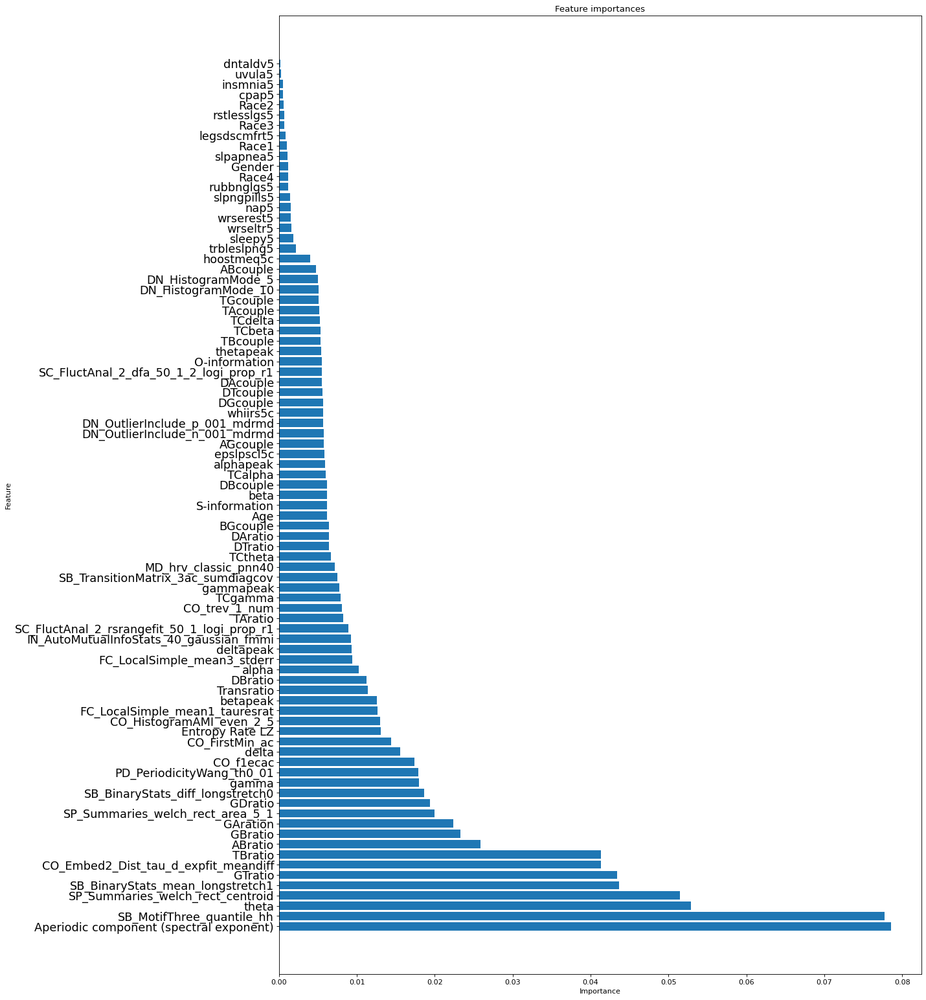

Predictions: ['Awake' 'Awake' 'Awake' ... '1 minutes before sleep'
 '1 minutes before sleep' '1 minutes before sleep']


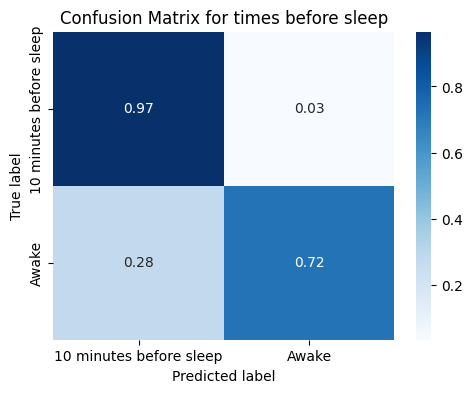

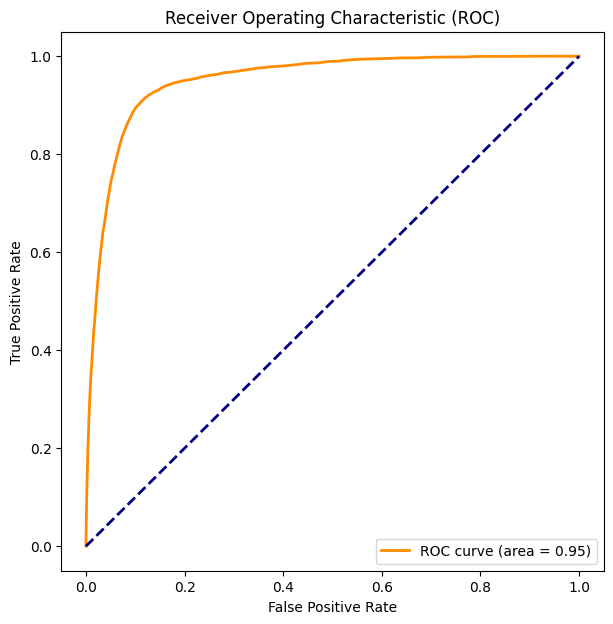

Accuracy: 0.7353205128205128
                        precision    recall  f1-score   support

1 minutes before sleep       0.10      0.83      0.19      1144
                 Awake       0.99      0.73      0.84     30056

              accuracy                           0.74     31200
             macro avg       0.55      0.78      0.51     31200
          weighted avg       0.96      0.74      0.82     31200

F1 pre-sleep:  0.84195820255684
F1 awake:  0.18624359479700434


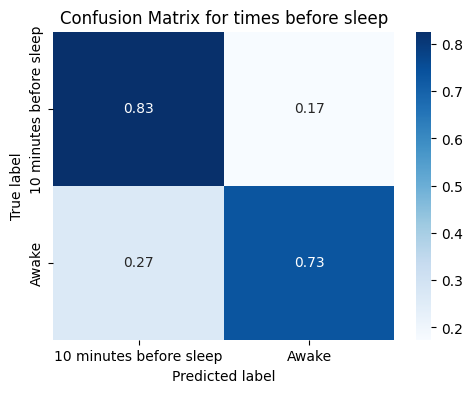

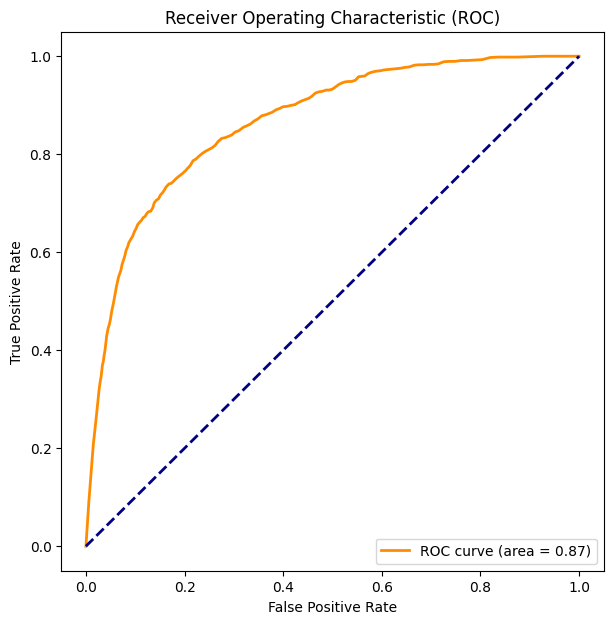

[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 2

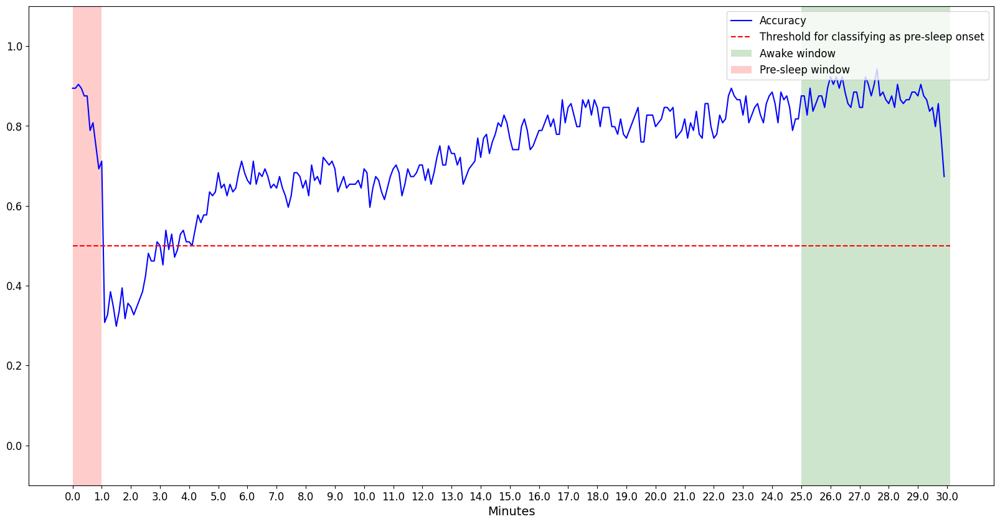

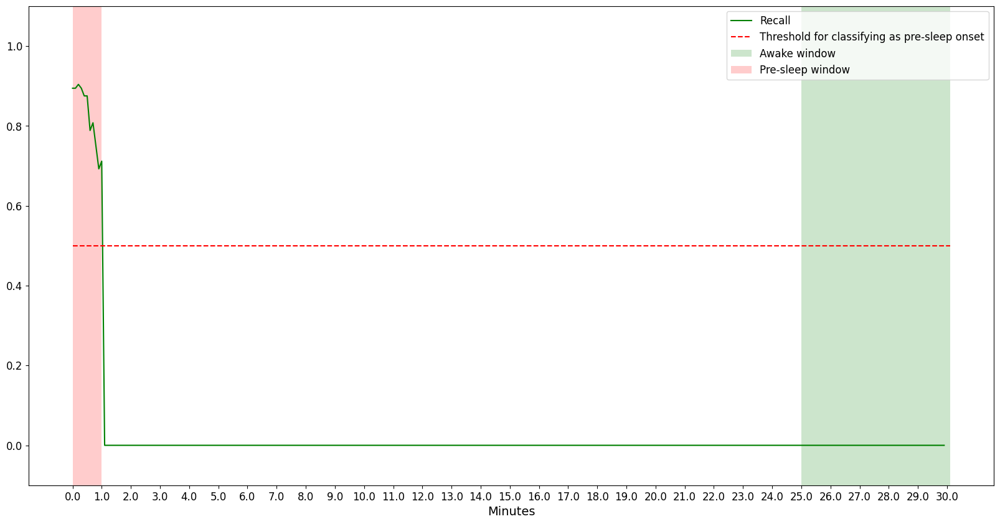

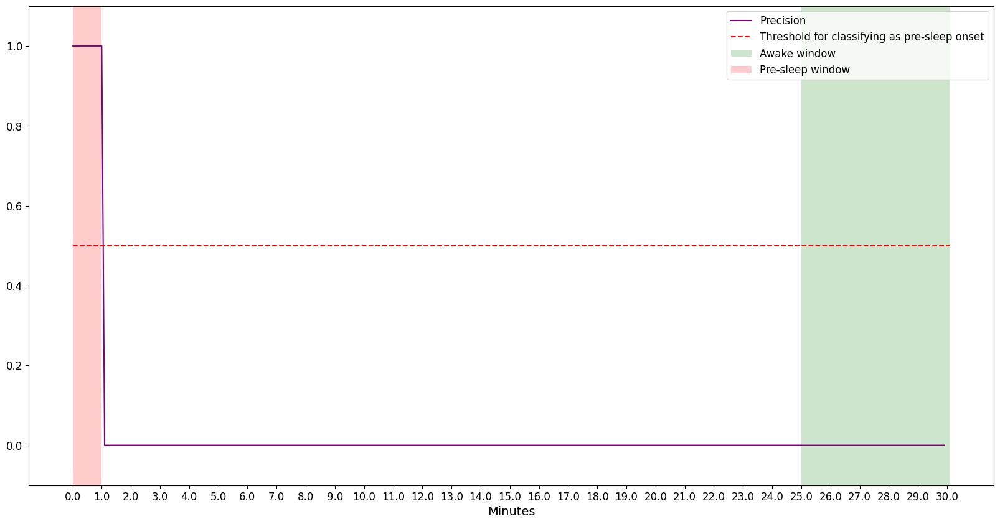

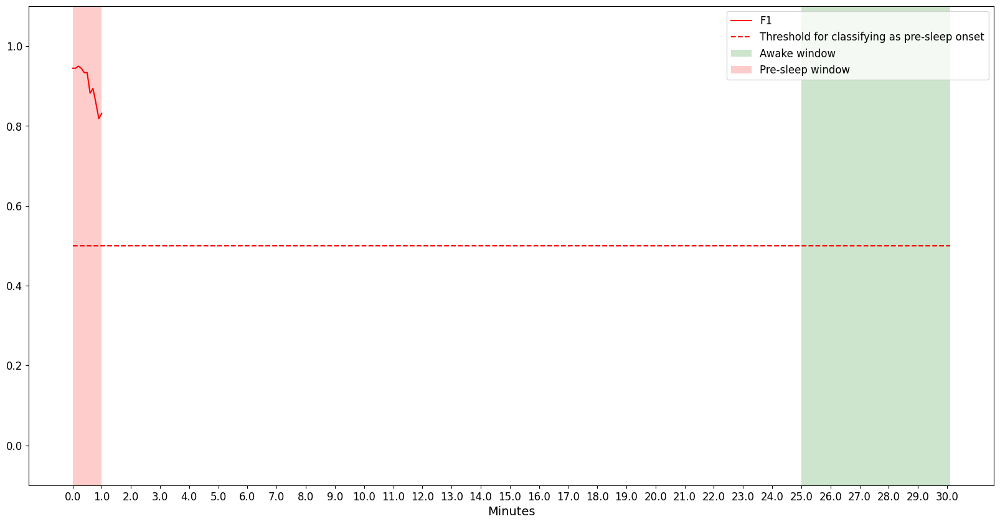

Probability of sleep as predicted by the model


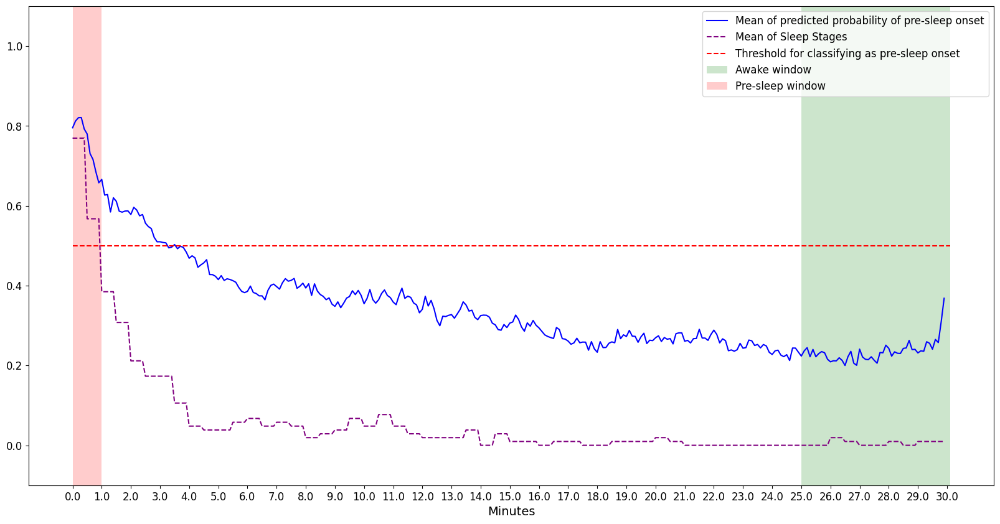

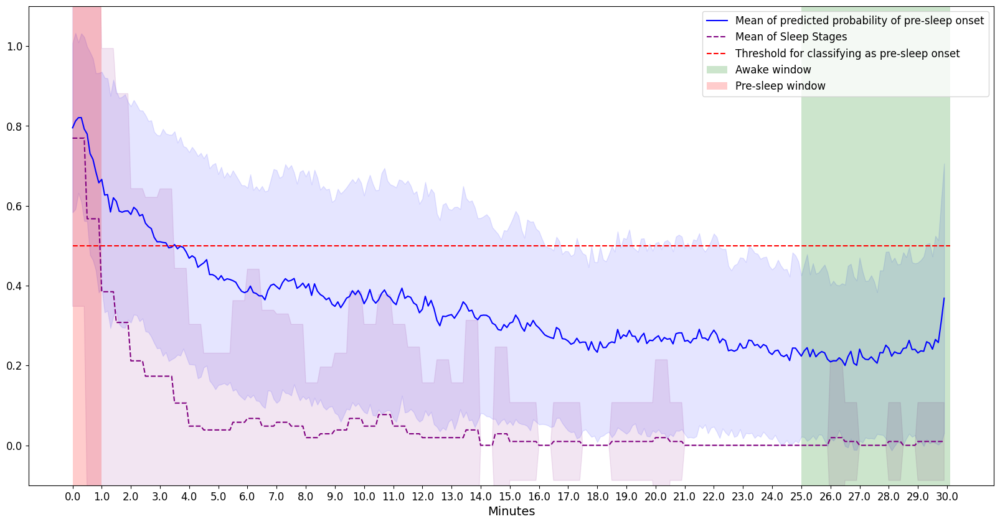

-------------------------------Averaging of accuracy over 30 seconds---------------------------------
Accuracy


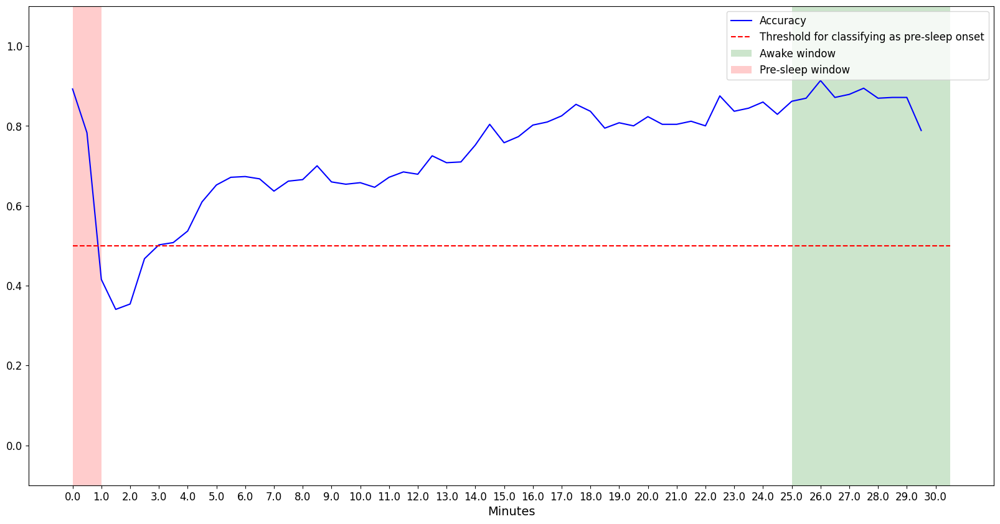

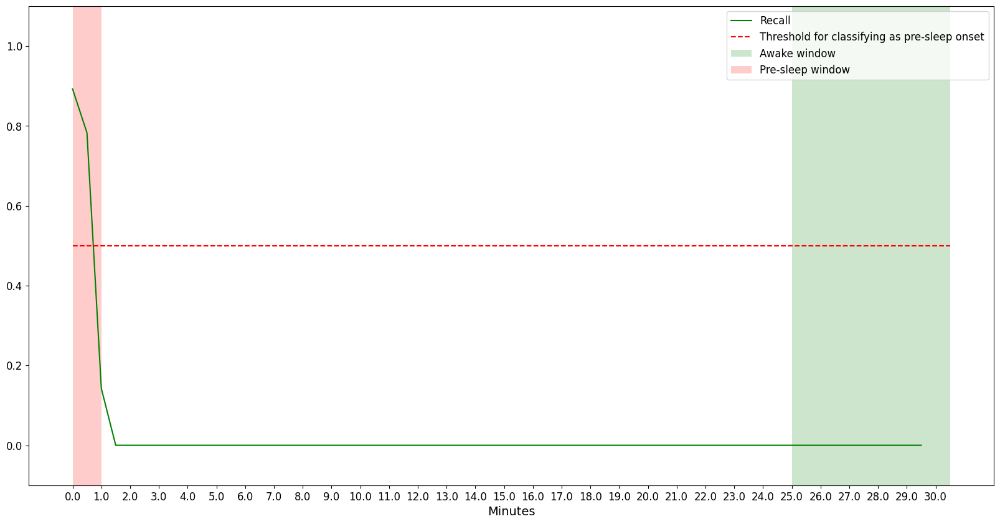

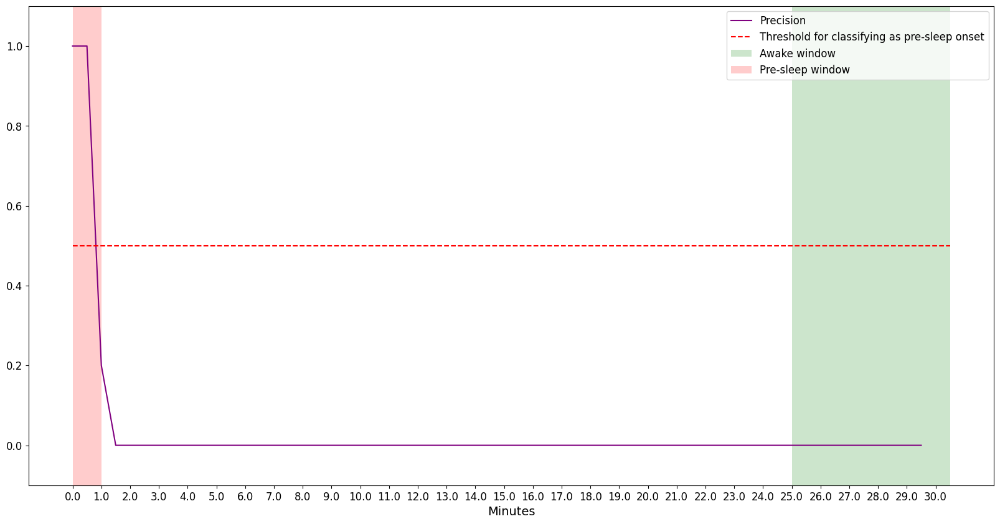

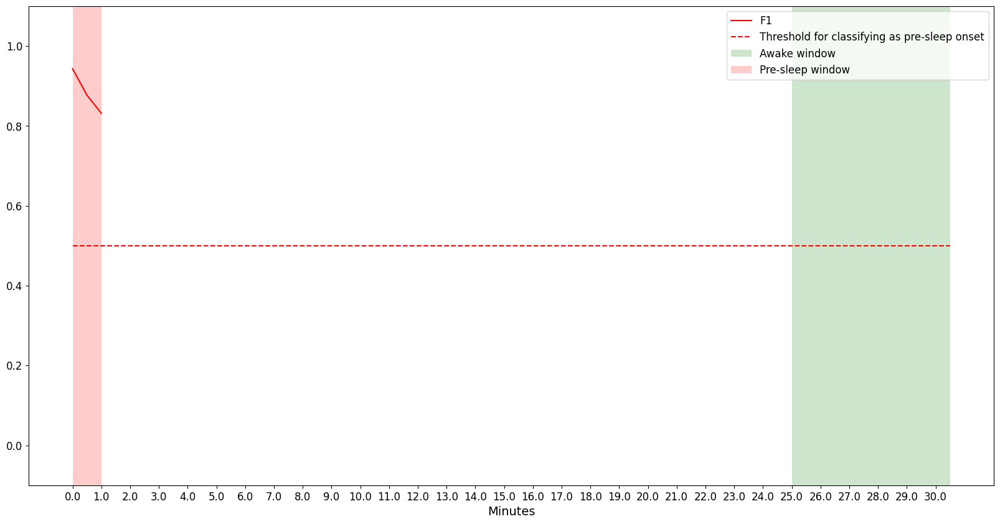

Probability of sleep as predicted by the model
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]


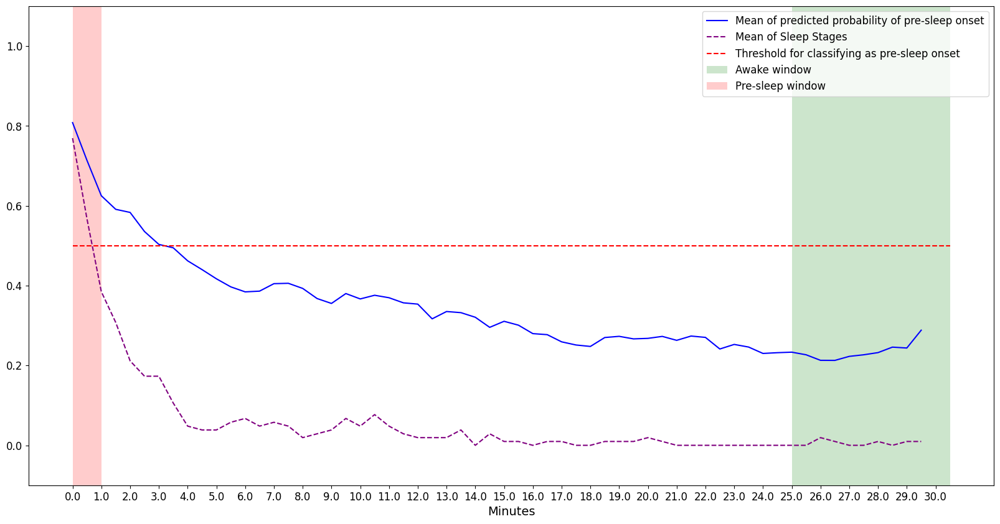

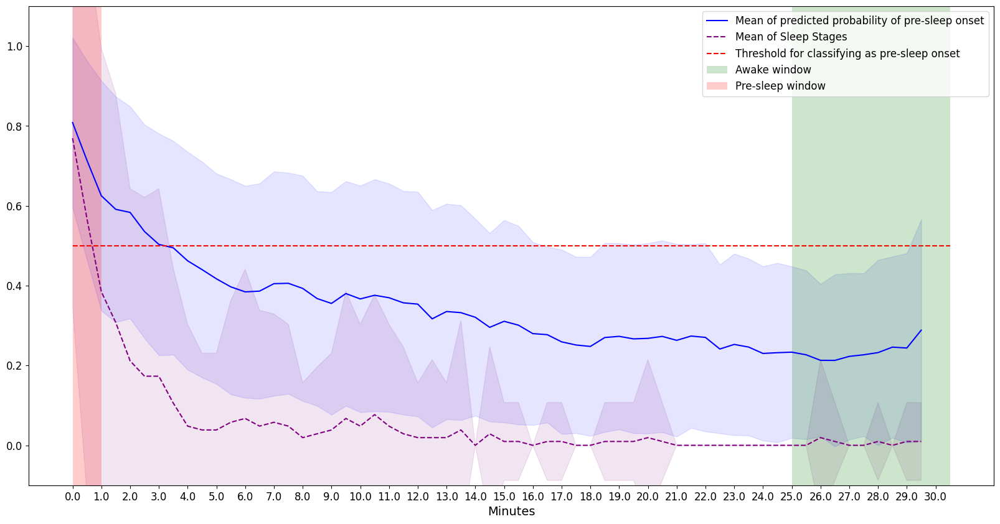

[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]


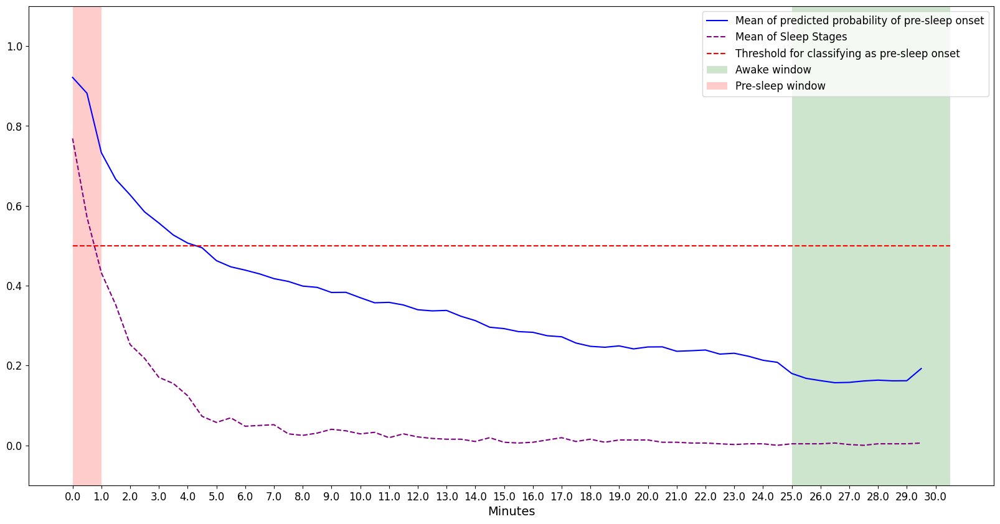

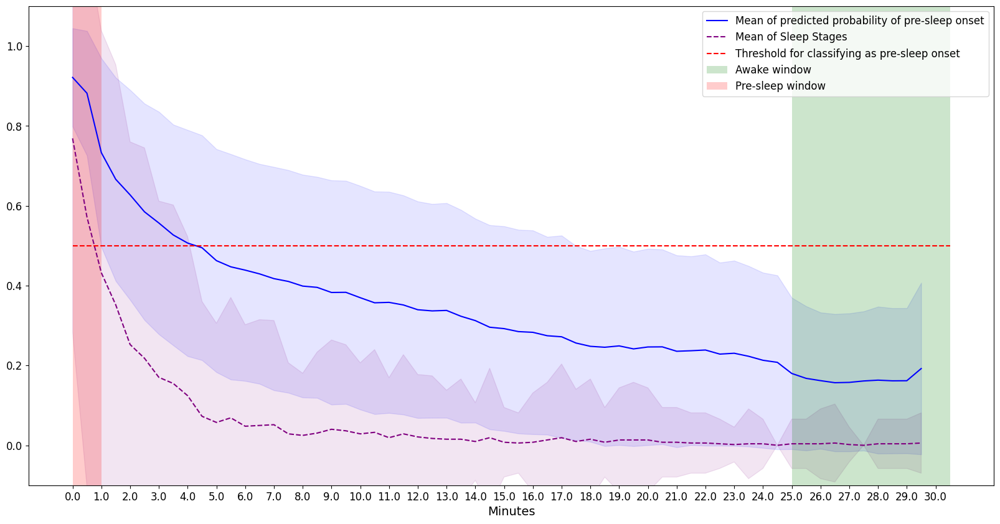

Mean Absolute Error: 0.25
Accuracy: 95.58 %.
Mean Squared Error: 0.15
Root Mean Squared Error: 0.39
R2: 1.0


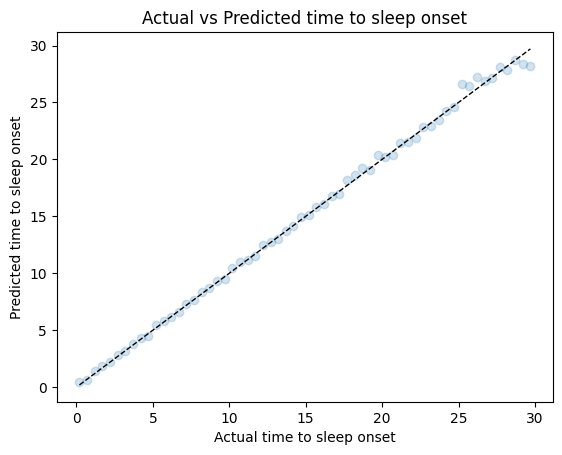

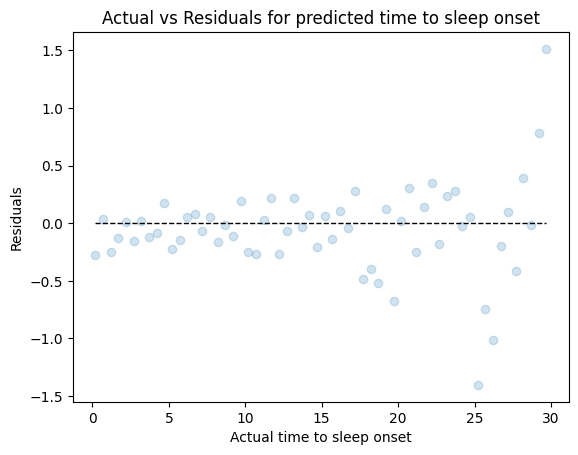

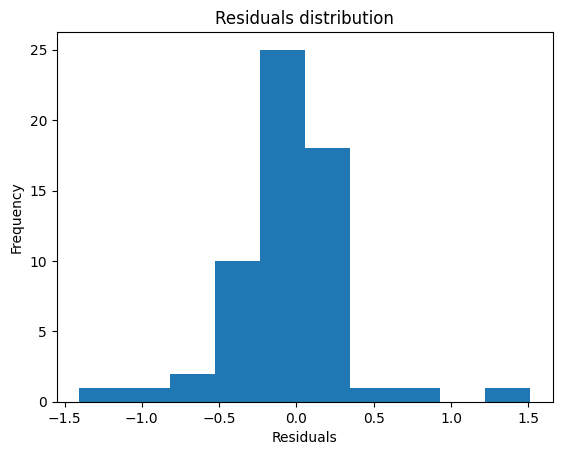

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


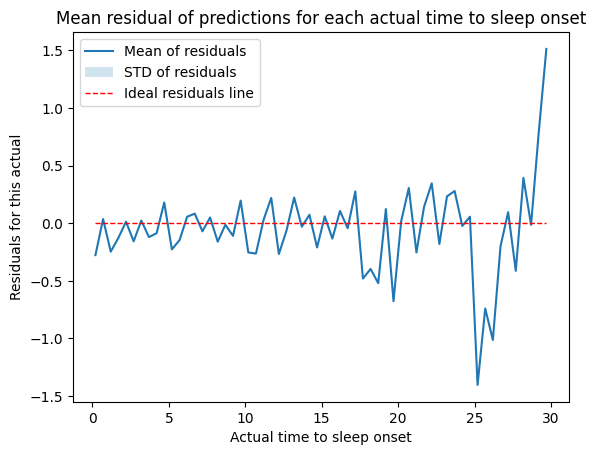

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


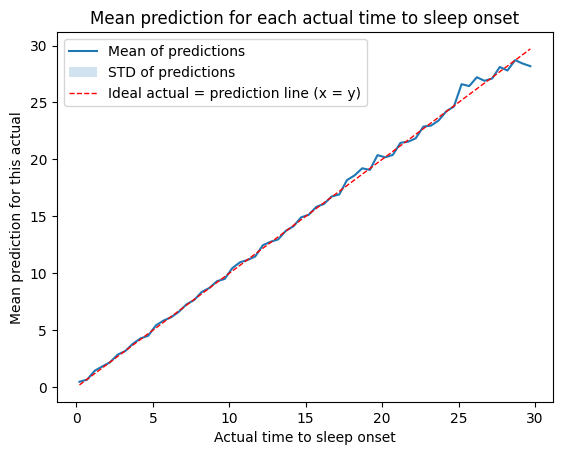

Mean Absolute Error: 8.95
Accuracy: -17.07 %.
Mean Squared Error: 129.62
Root Mean Squared Error: 11.38
R2: -0.73


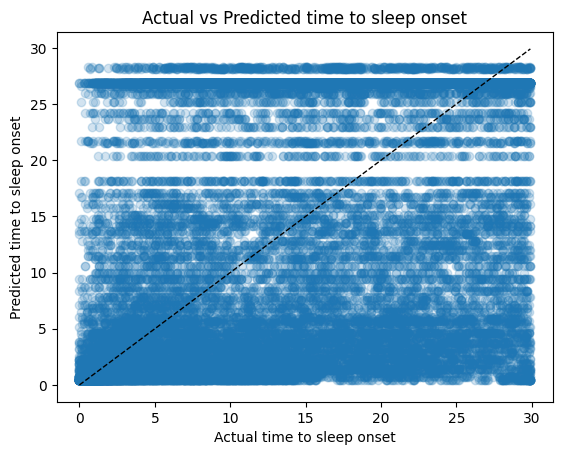

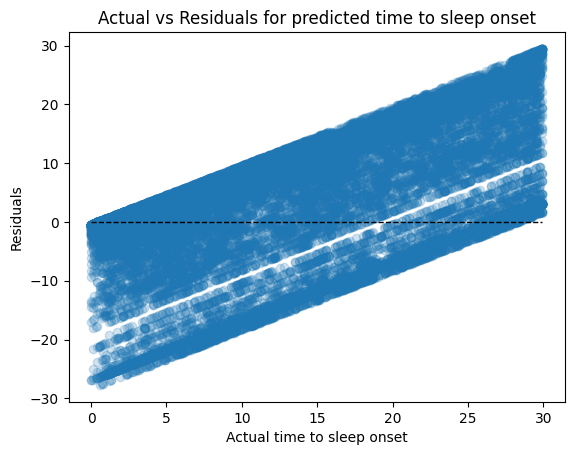

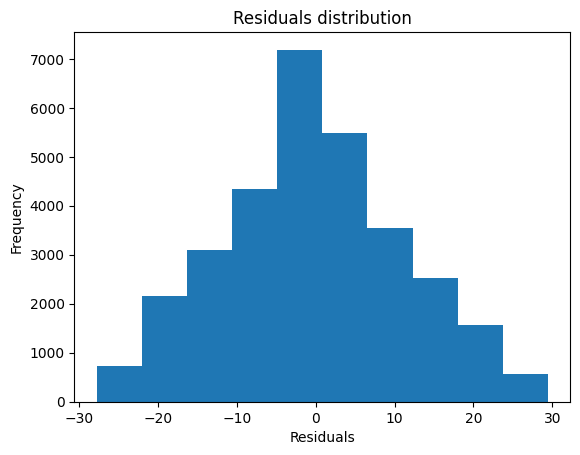

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


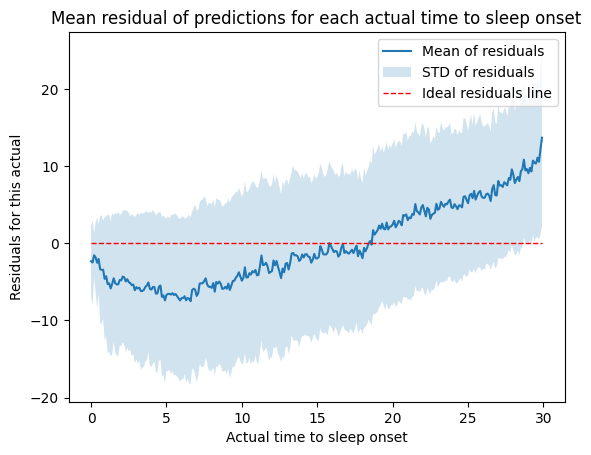

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


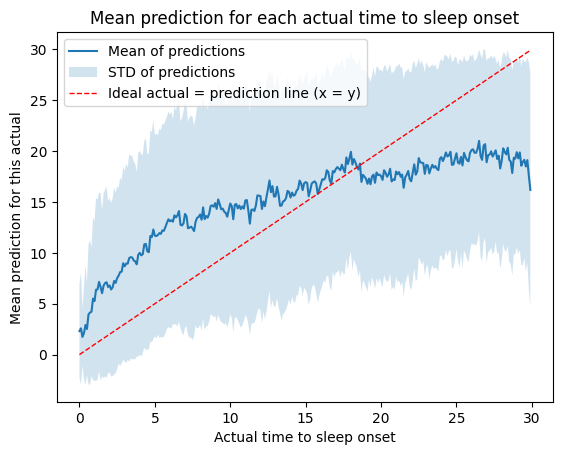

Predict for participant:  1077
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 9.08
Accuracy: 34.93 %.
Mean Squared Error: 133.44
Root Mean Squared Error: 11.55
R2: -0.78


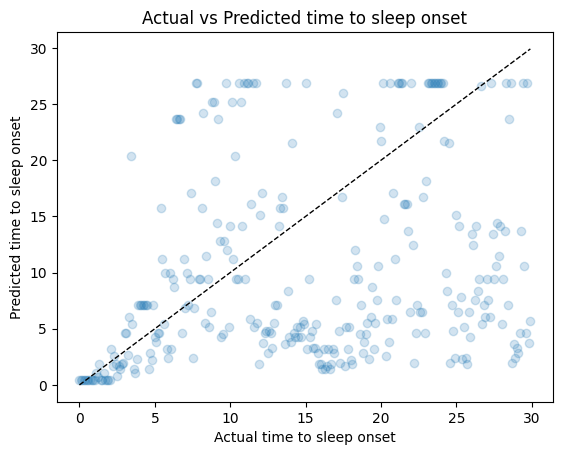

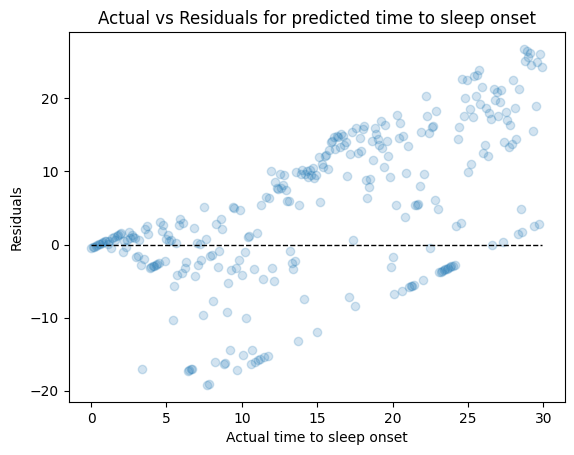

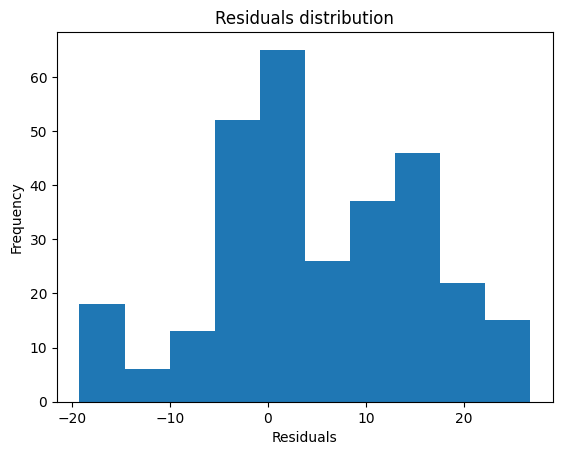

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


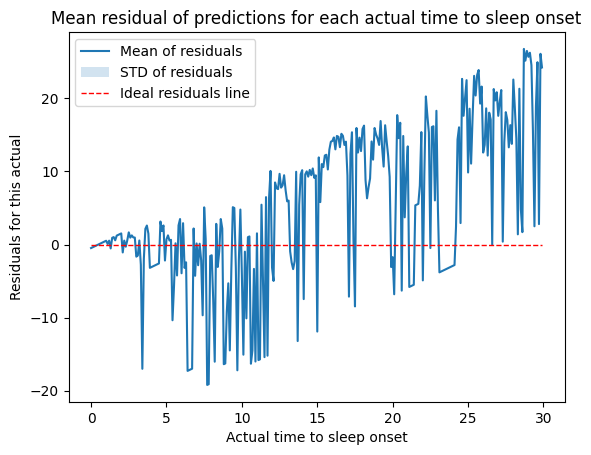

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


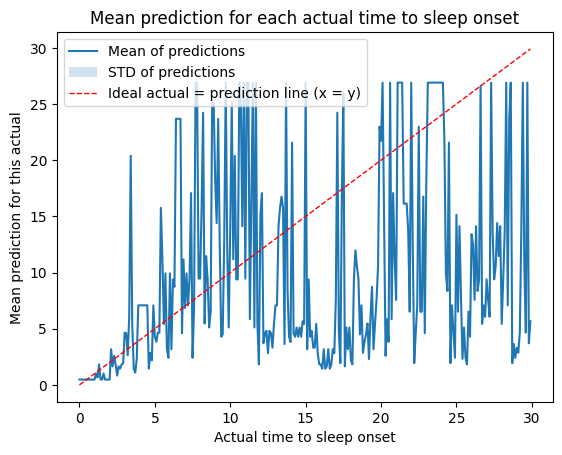

Predict for participant:  1301
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 8.94
Accuracy: 13.43 %.
Mean Squared Error: 131.29
Root Mean Squared Error: 11.46
R2: -0.75


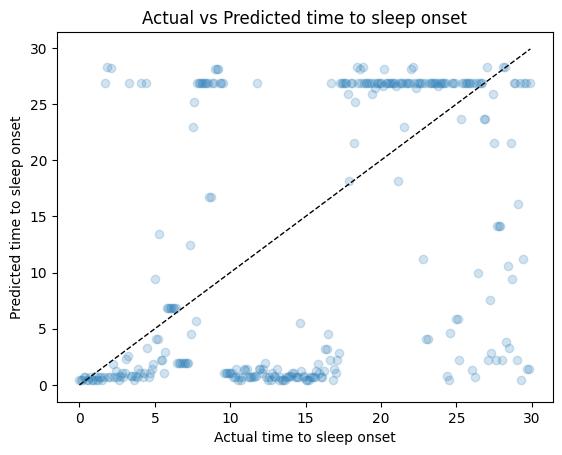

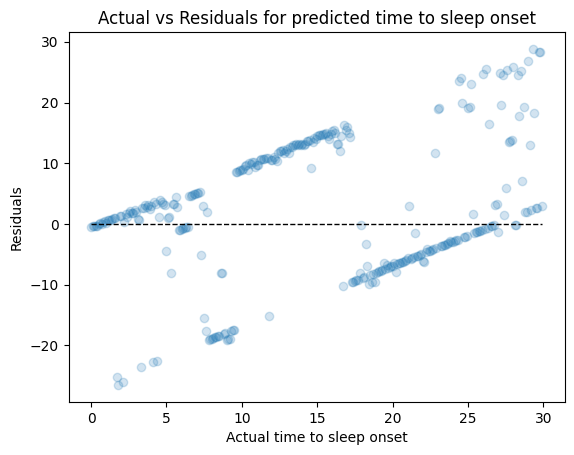

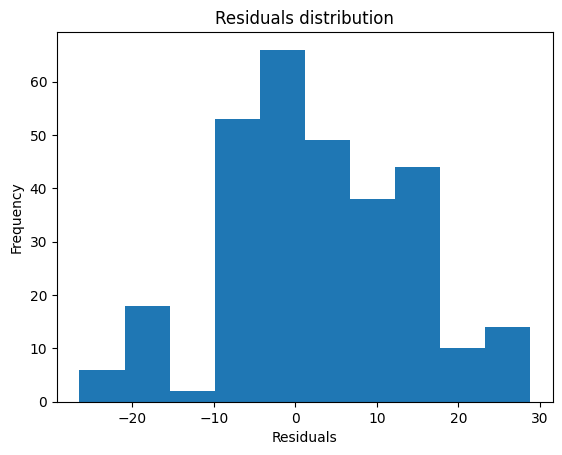

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


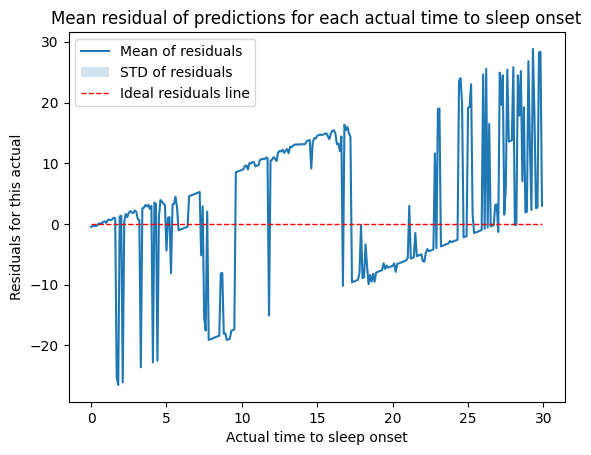

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


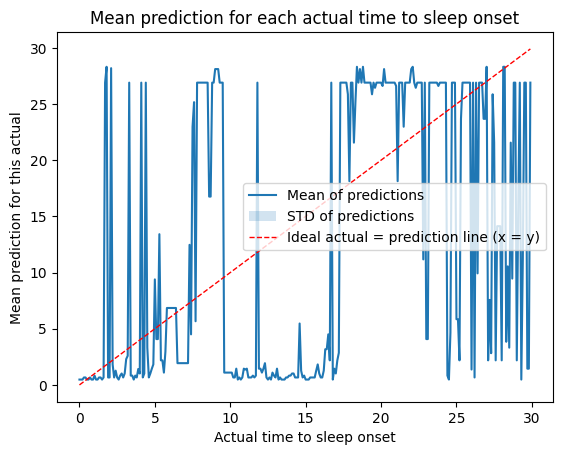

Predict for participant:  1744
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 12.1
Accuracy: 22.89 %.
Mean Squared Error: 220.26
Root Mean Squared Error: 14.84
R2: -1.94


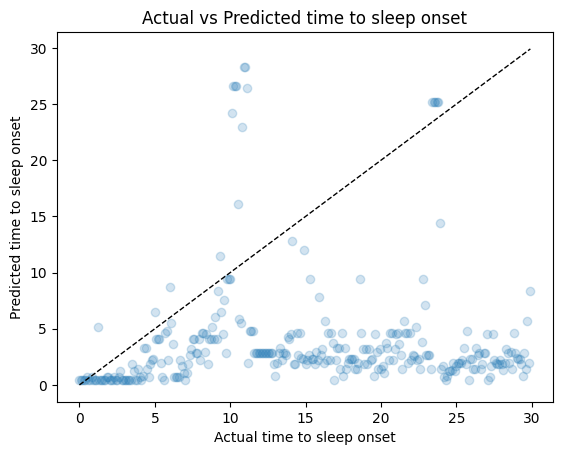

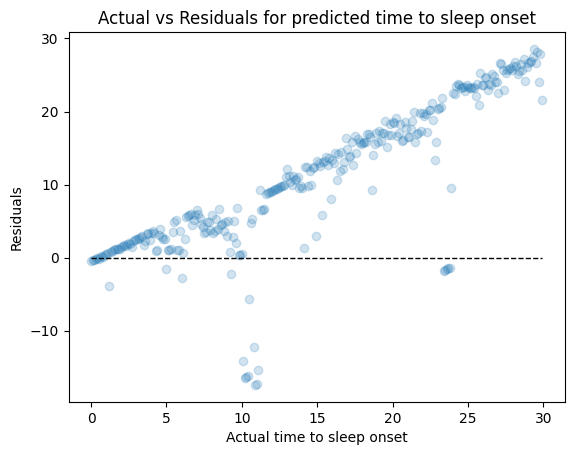

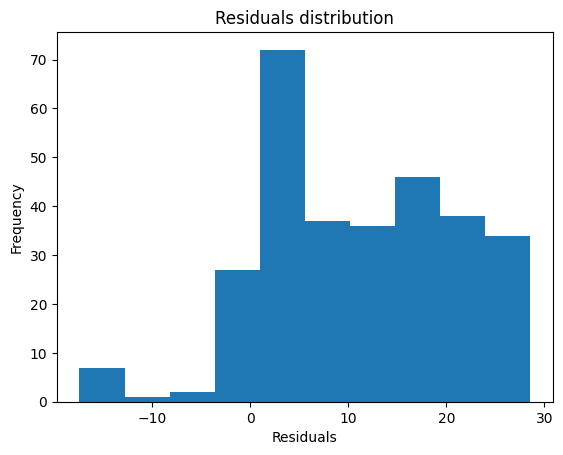

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


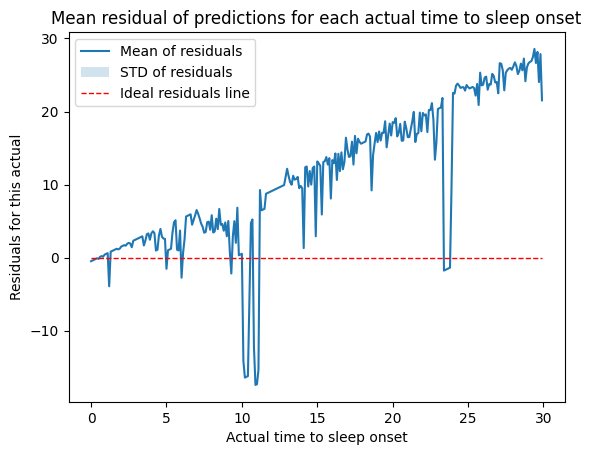

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


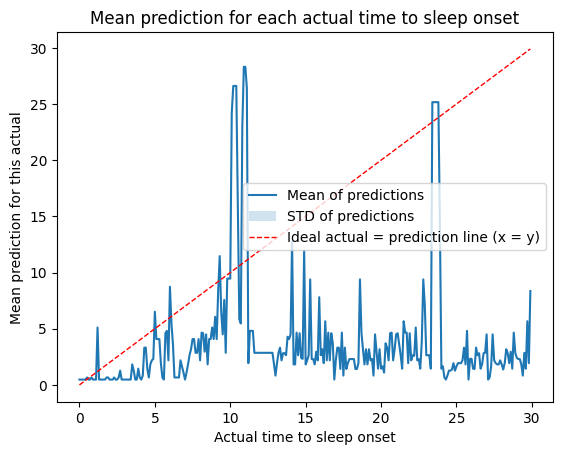

Predict for participant:  2039
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 8.54
Accuracy: -5.73 %.
Mean Squared Error: 121.8
Root Mean Squared Error: 11.04
R2: -0.62


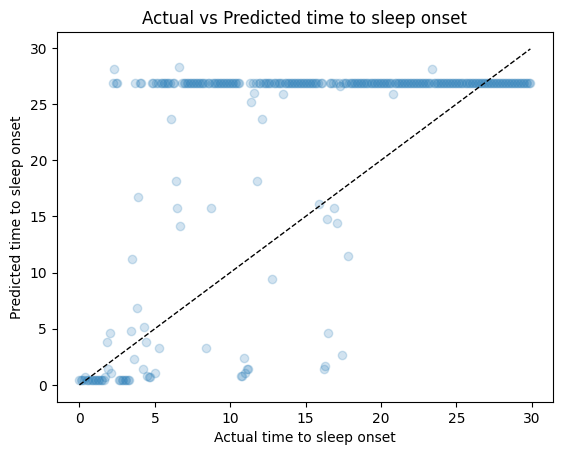

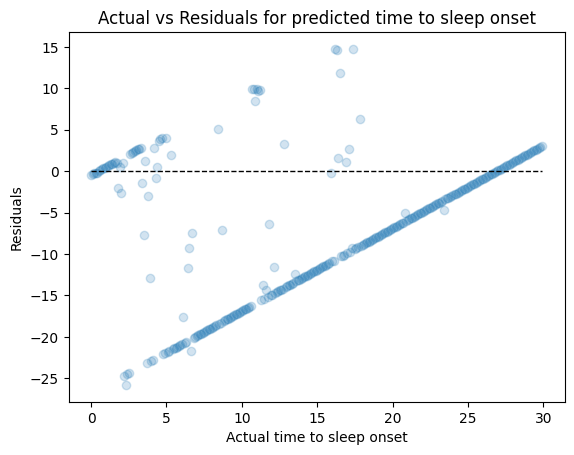

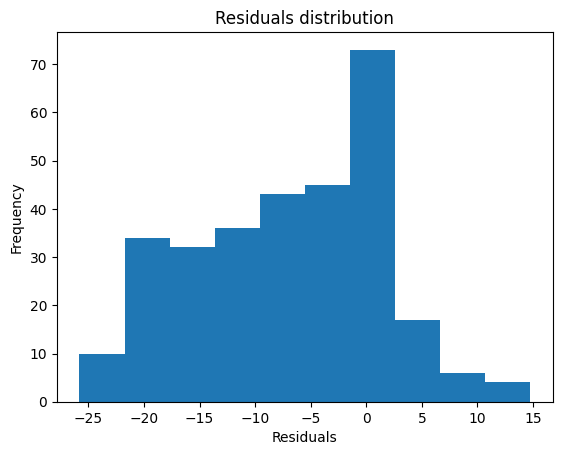

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


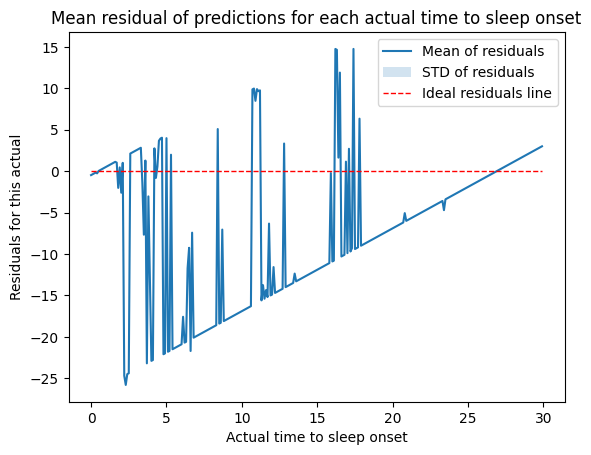

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


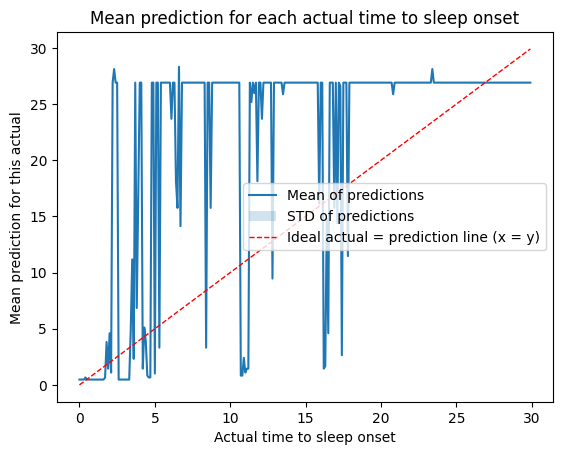

Predict for participant:  2167
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 6.71
Accuracy: 12.61 %.
Mean Squared Error: 80.04
Root Mean Squared Error: 8.95
R2: -0.07


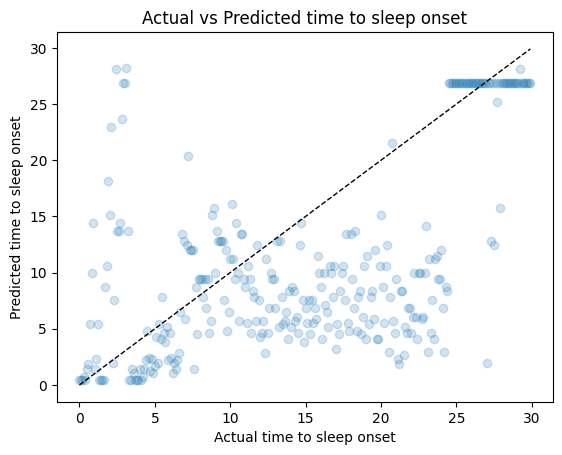

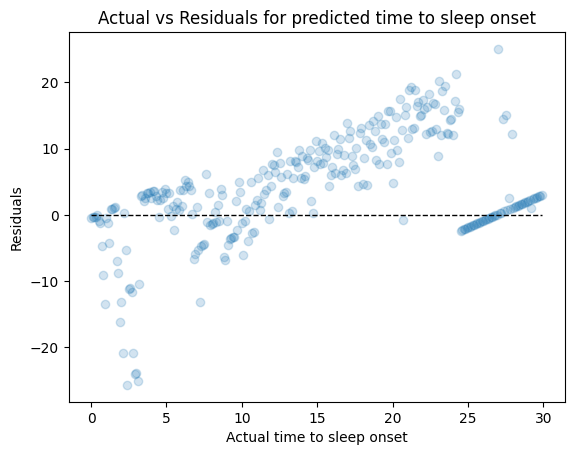

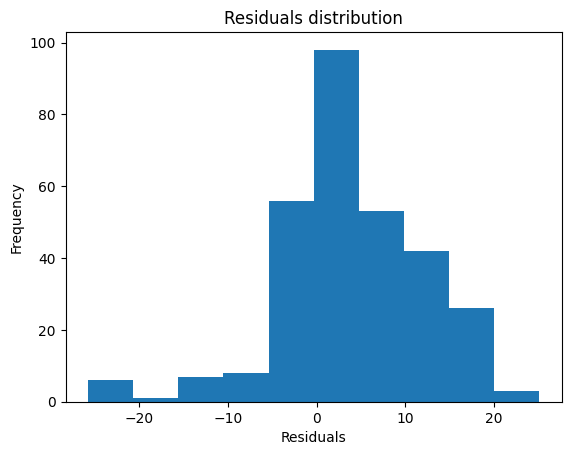

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


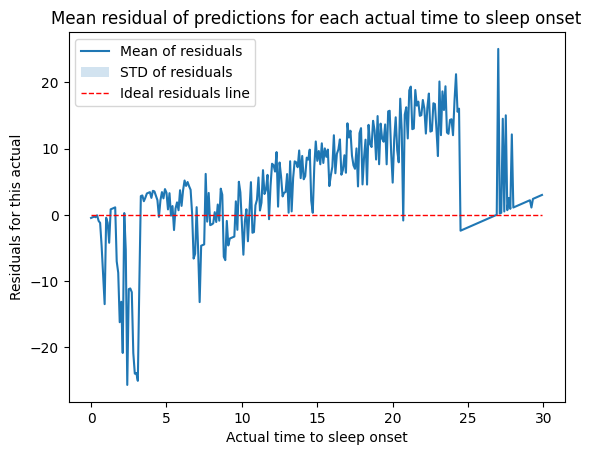

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


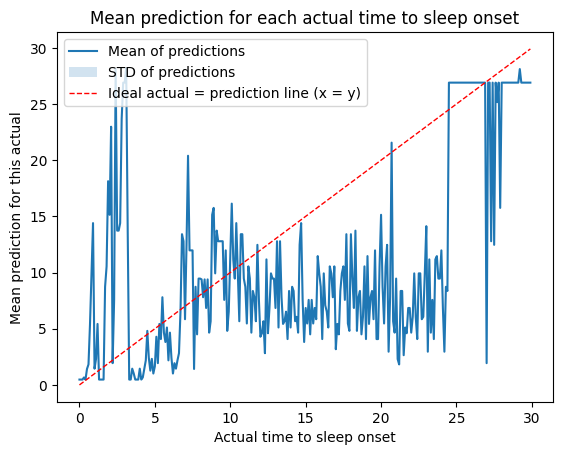

Predict for participant:  3106
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 9.17
Accuracy: 11.16 %.
Mean Squared Error: 135.52
Root Mean Squared Error: 11.64
R2: -0.81


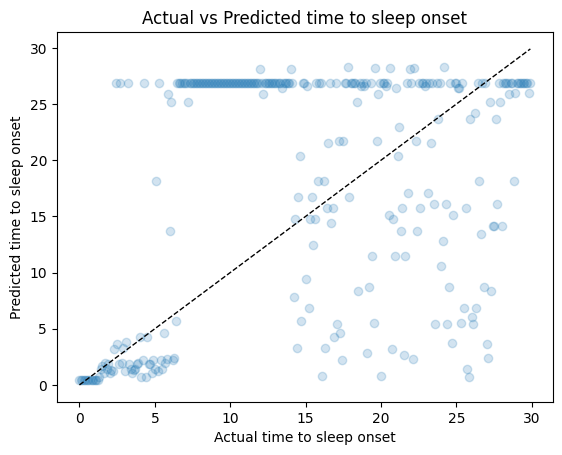

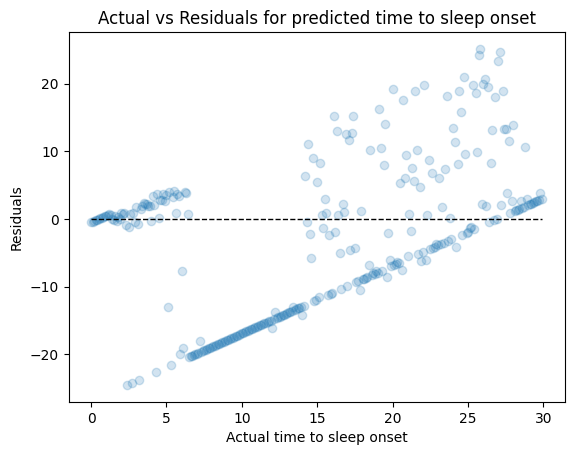

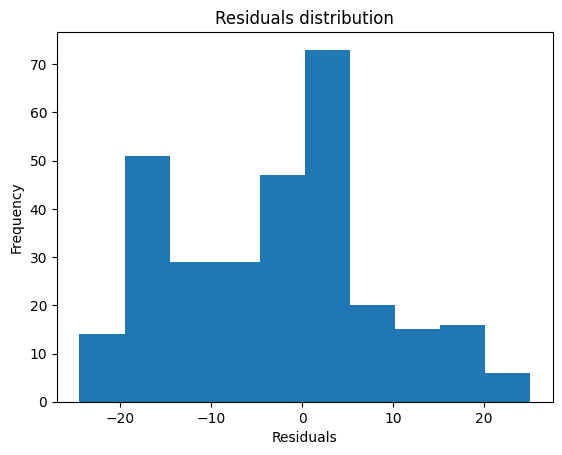

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


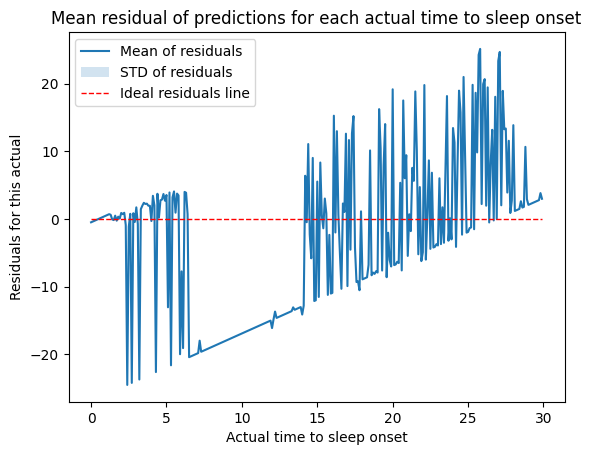

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


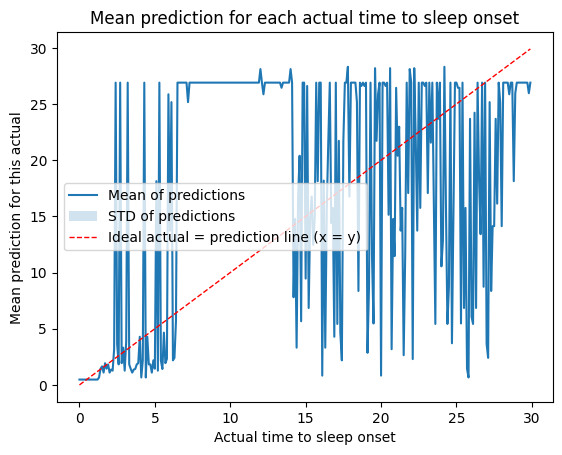

Predict for participant:  5009
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 6.89
Accuracy: 38.08 %.
Mean Squared Error: 82.41
Root Mean Squared Error: 9.08
R2: -0.1


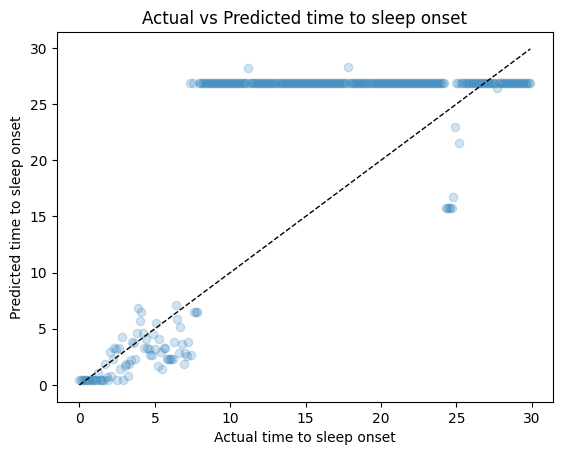

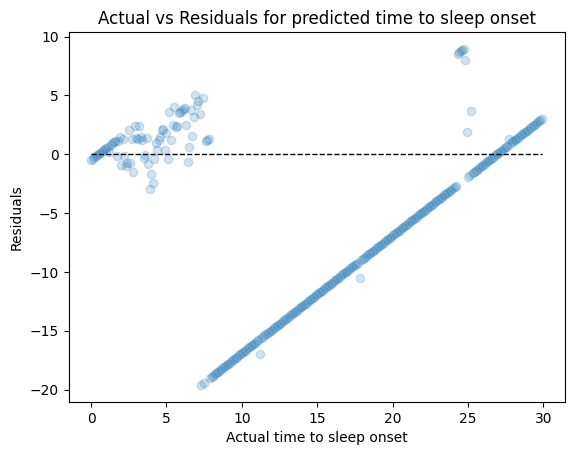

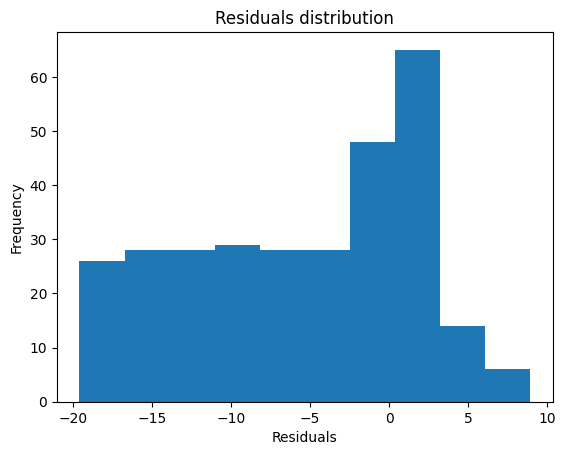

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


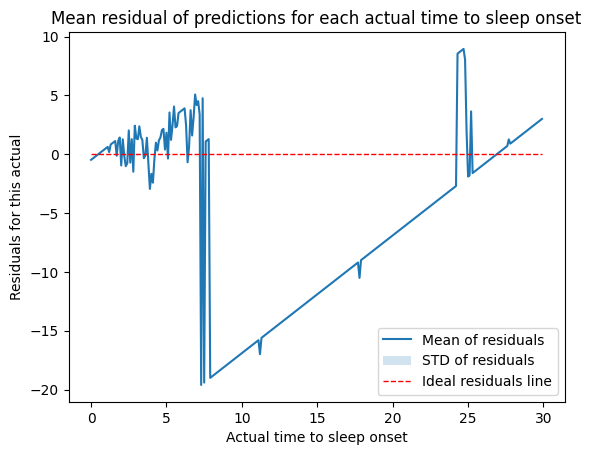

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


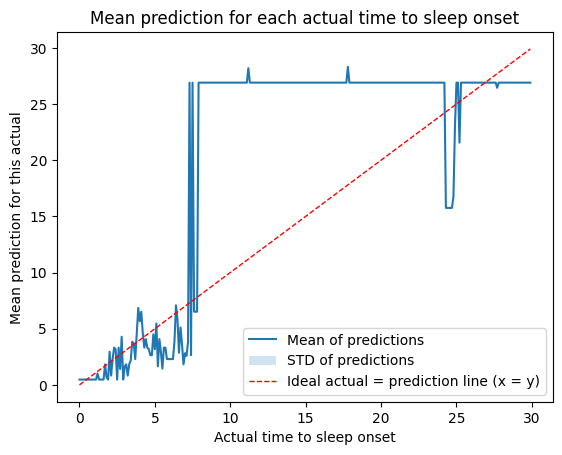

Predict for participant:  5162
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 7.89
Accuracy: 15.2 %.
Mean Squared Error: 103.04
Root Mean Squared Error: 10.15
R2: -0.37


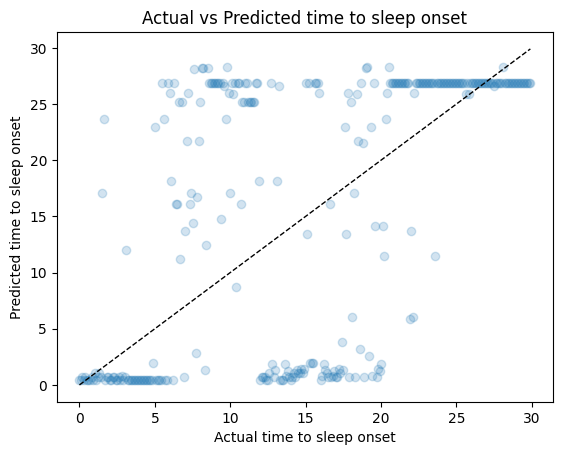

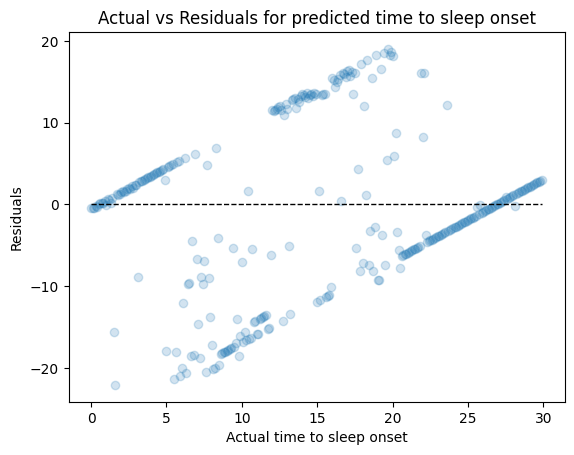

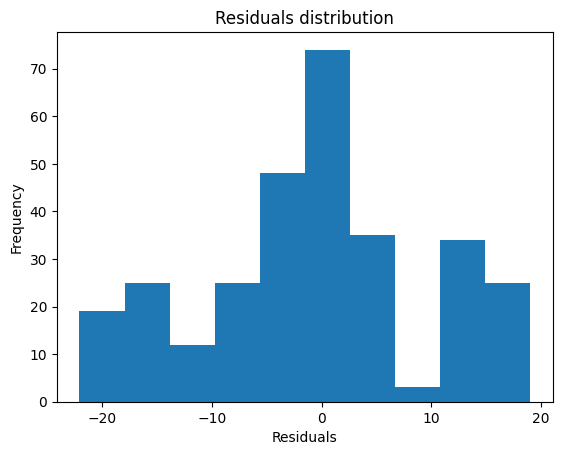

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


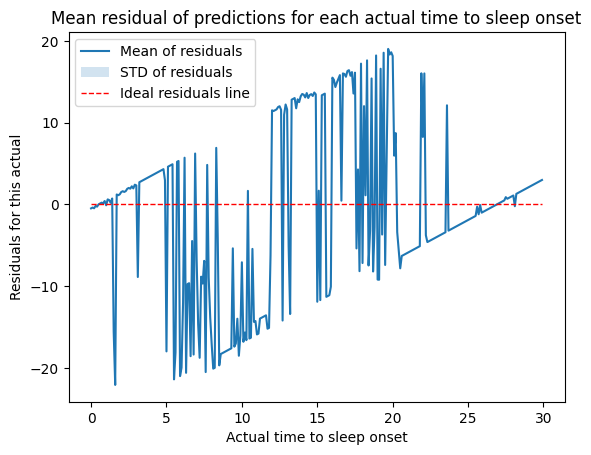

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


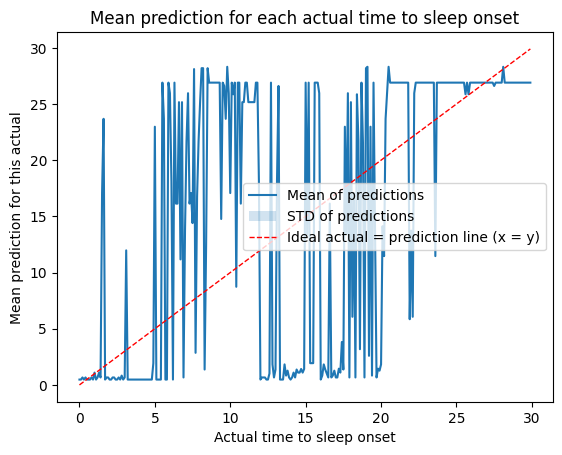

Predict for participant:  6313
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 5.12
Accuracy: 41.72 %.
Mean Squared Error: 42.34
Root Mean Squared Error: 6.51
R2: 0.44


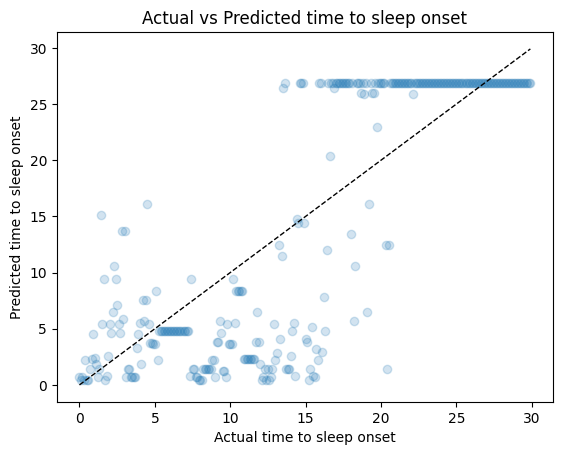

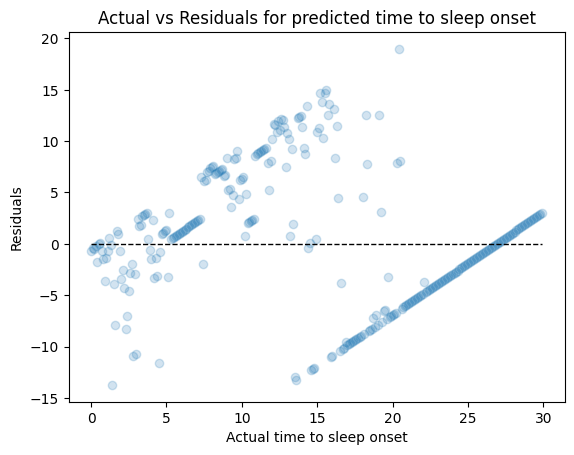

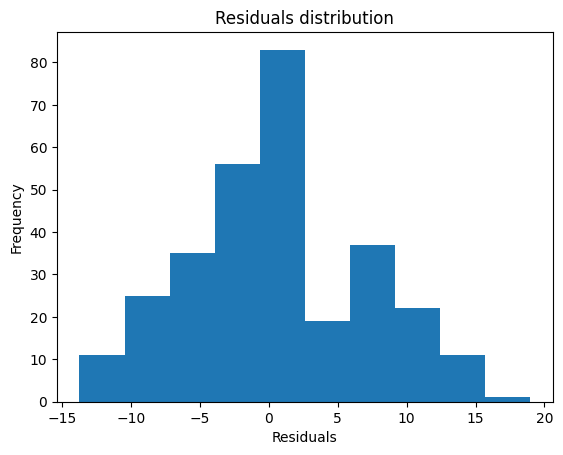

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


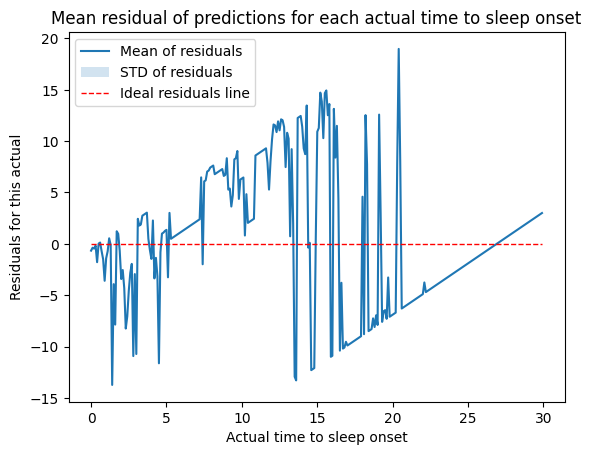

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


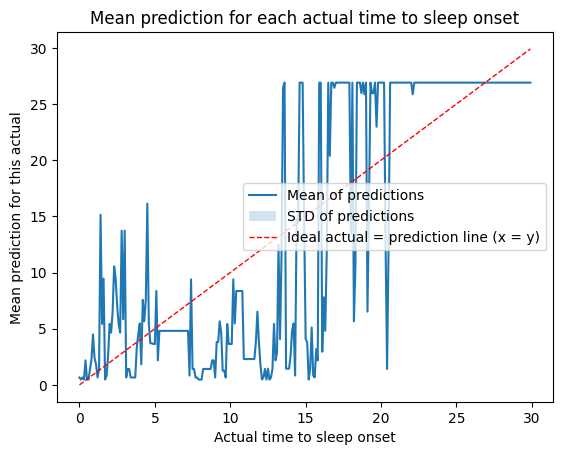

Predict for participant:  6653
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 11.12
Accuracy: -185.77 %.
Mean Squared Error: 181.16
Root Mean Squared Error: 13.46
R2: -1.42


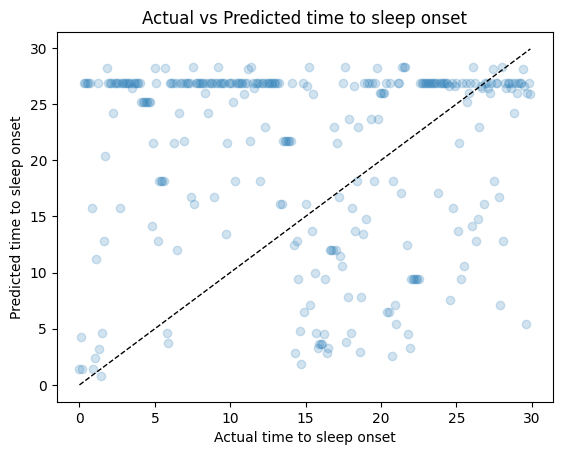

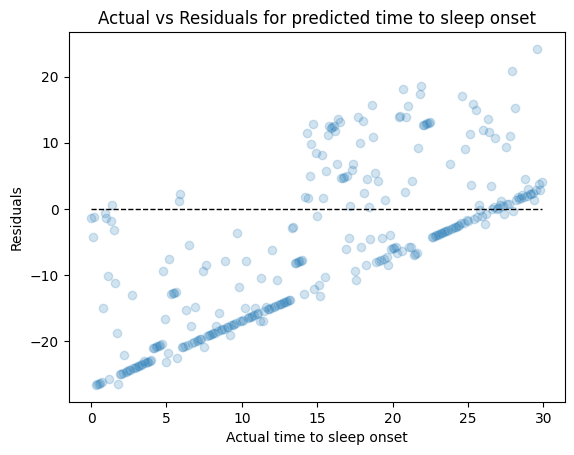

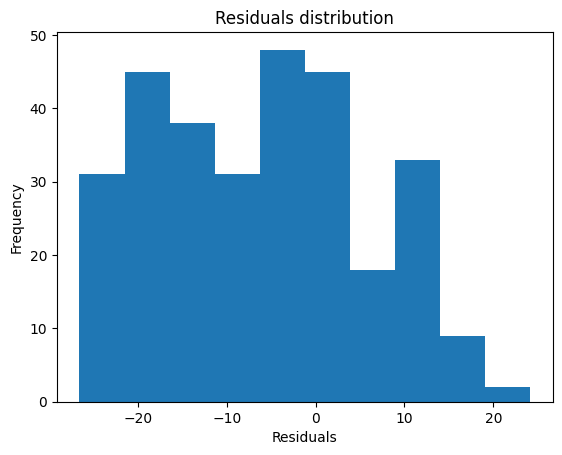

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


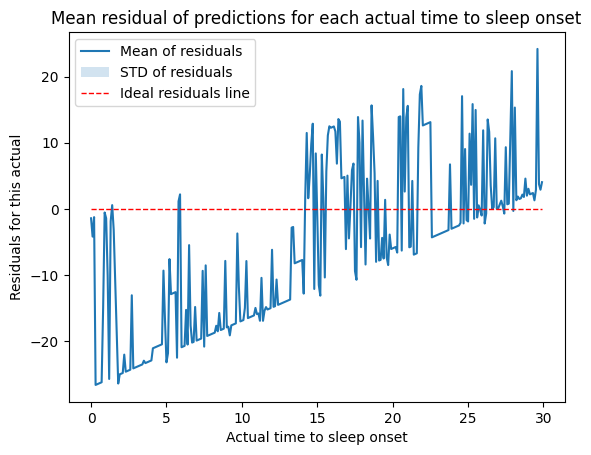

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


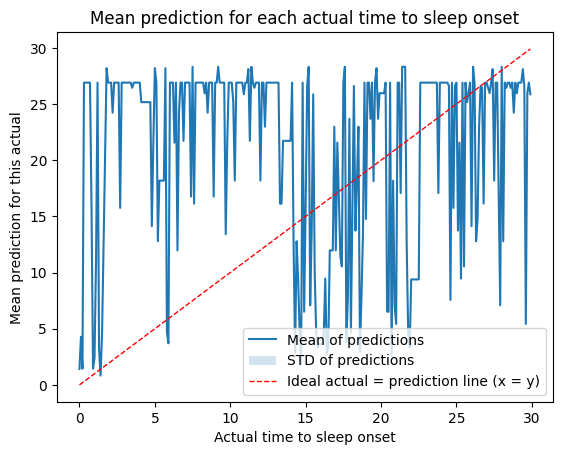



______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 2.5 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 25+ minutes ------------------------------------------------




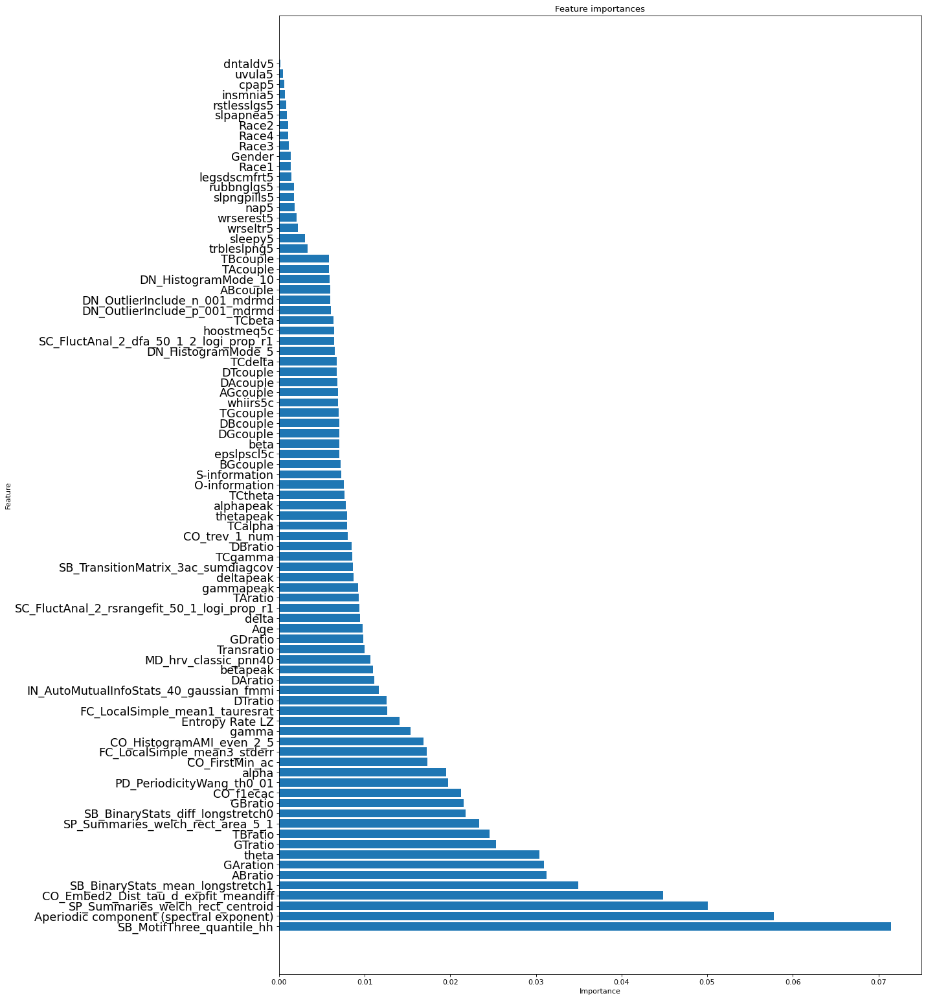

Predictions: ['Awake' 'Awake' 'Awake' ... '2.5 minutes before sleep'
 '2.5 minutes before sleep' '2.5 minutes before sleep']


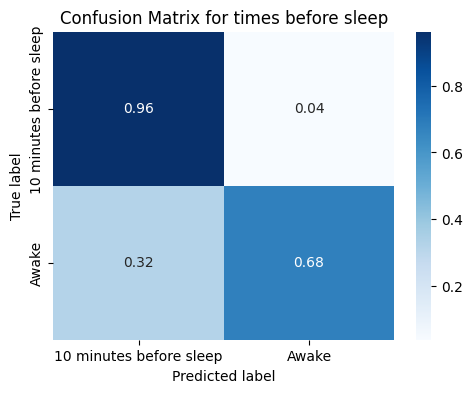

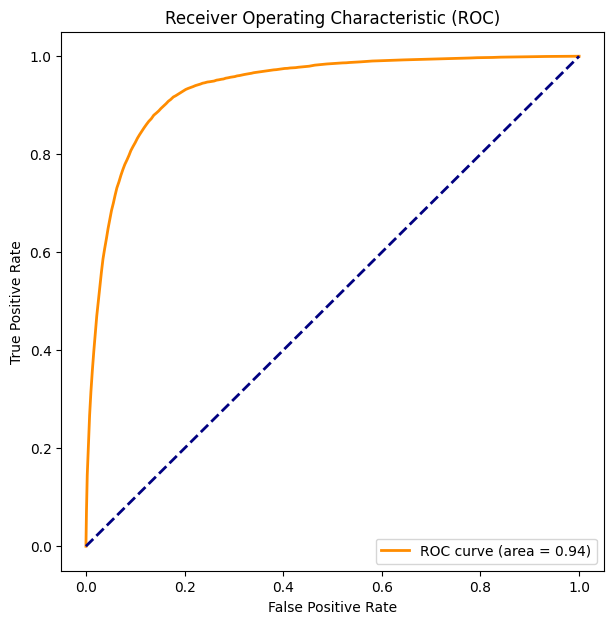

Accuracy: 0.6841666666666667
                          precision    recall  f1-score   support

2.5 minutes before sleep       0.19      0.81      0.31      2704
                   Awake       0.97      0.67      0.80     28496

                accuracy                           0.68     31200
               macro avg       0.58      0.74      0.55     31200
            weighted avg       0.91      0.68      0.75     31200

F1 pre-sleep:  0.7953563714902807
F1 awake:  0.30839416058394165


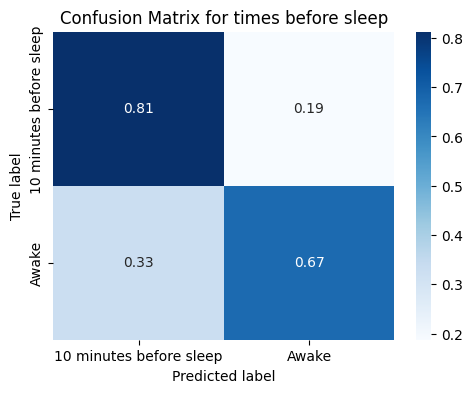

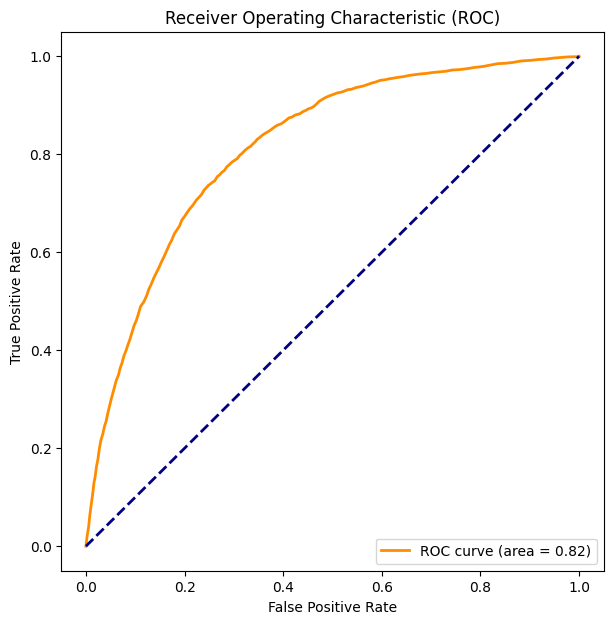

[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 2

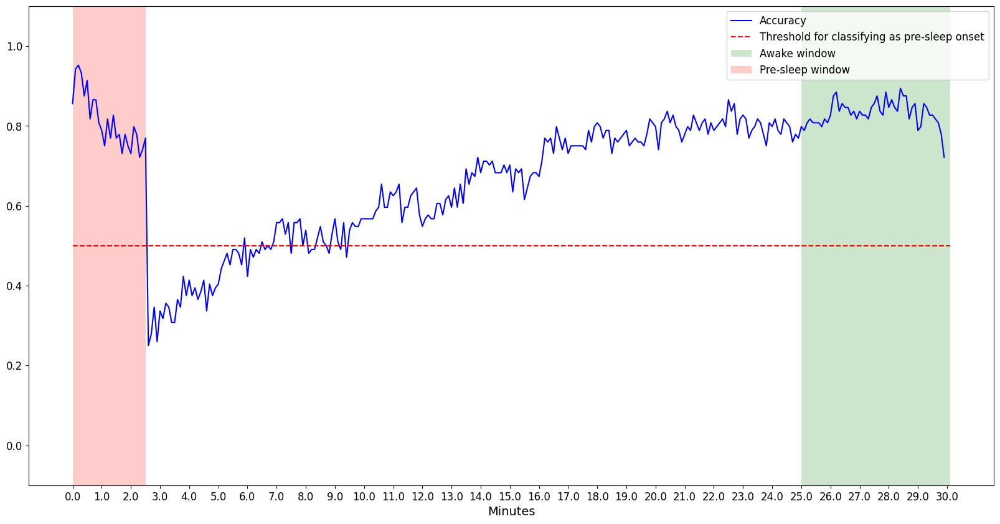

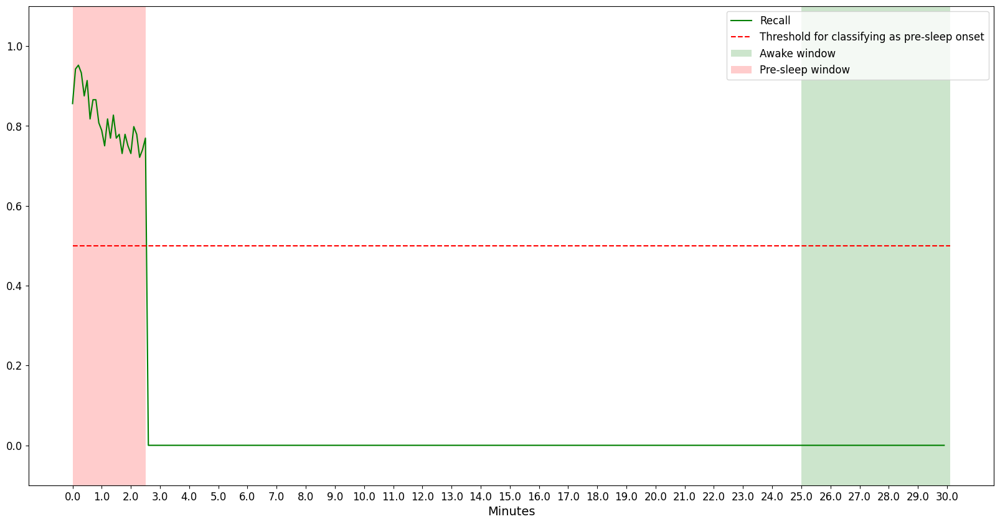

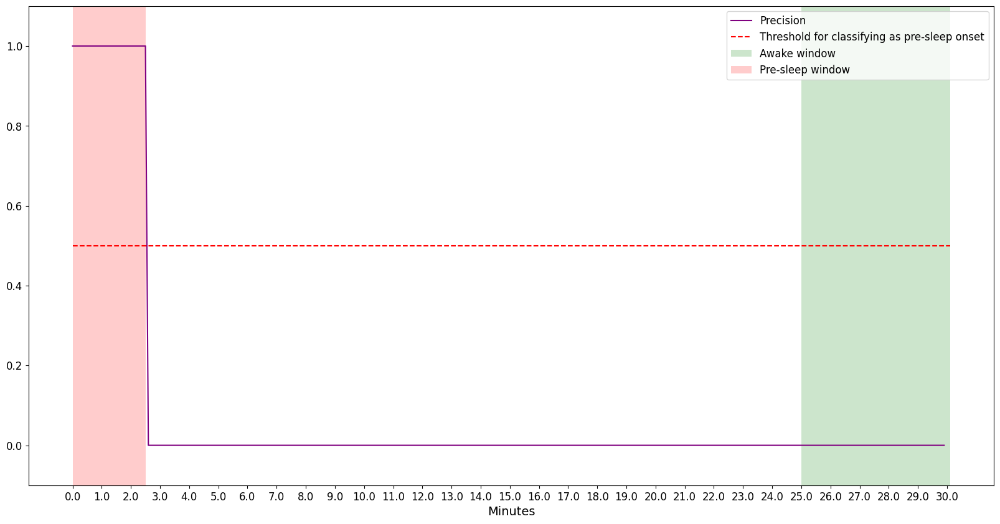

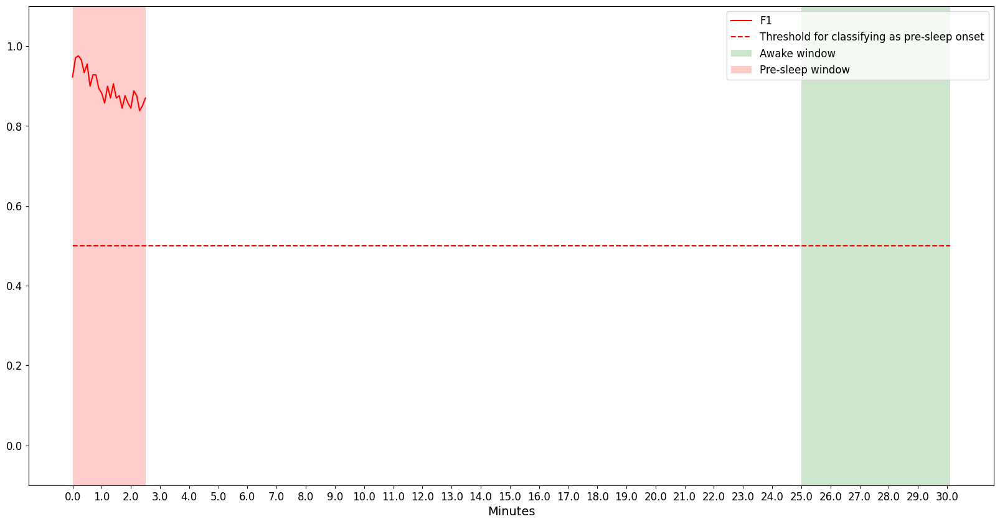

Probability of sleep as predicted by the model


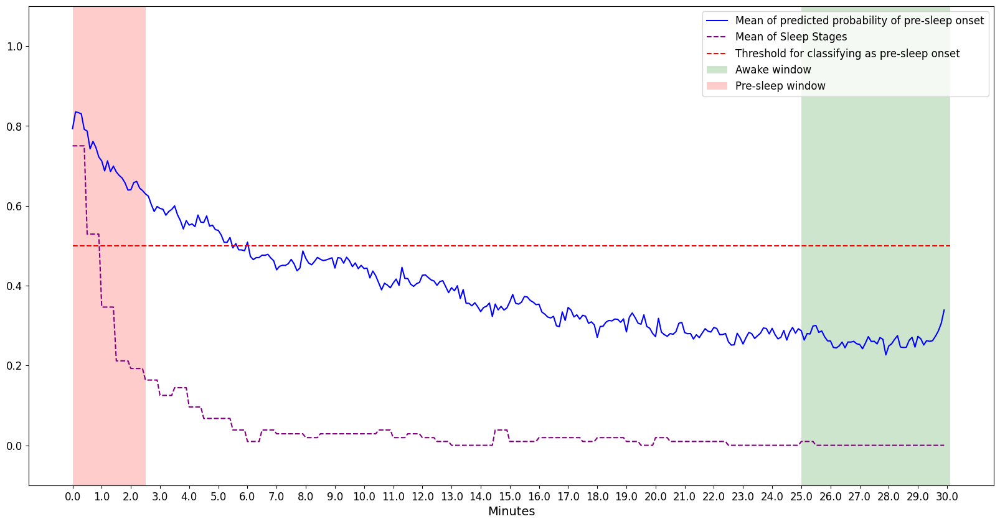

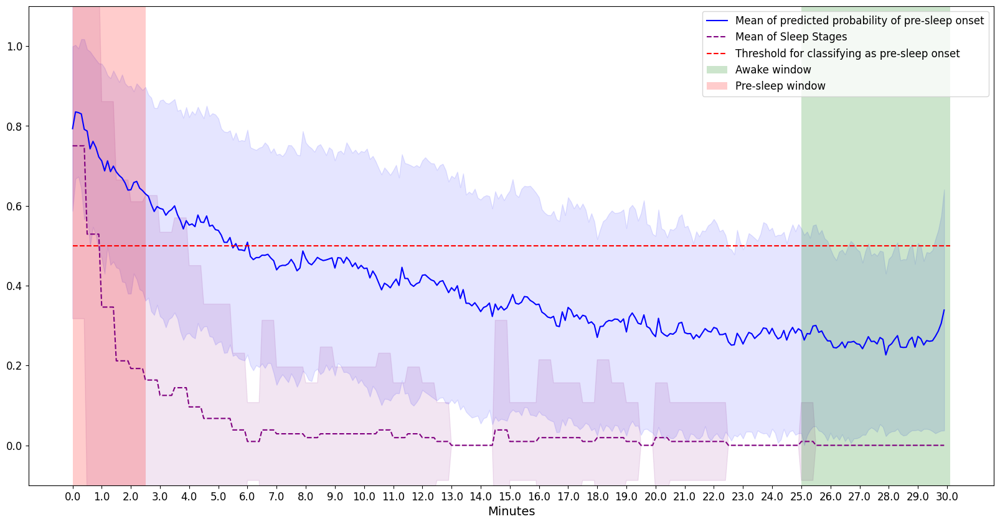

-------------------------------Averaging of accuracy over 30 seconds---------------------------------
Accuracy


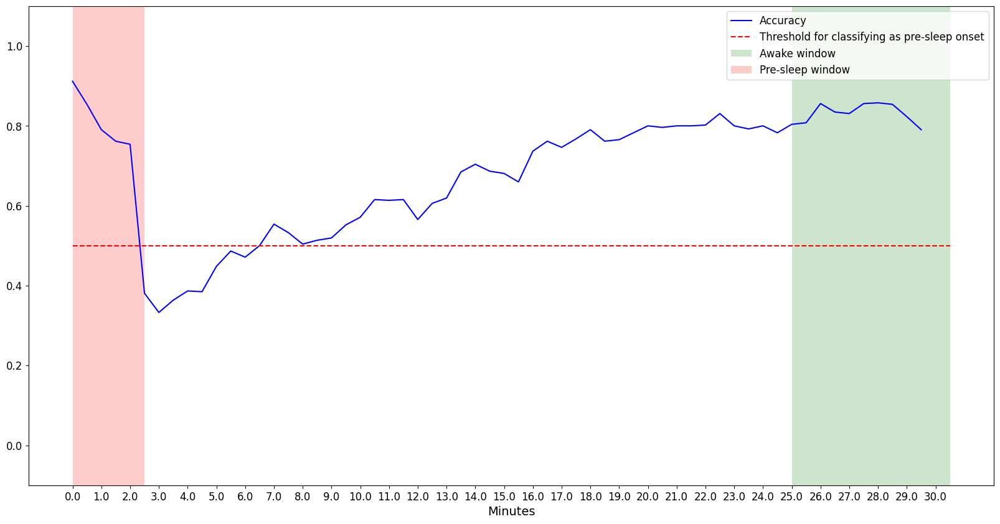

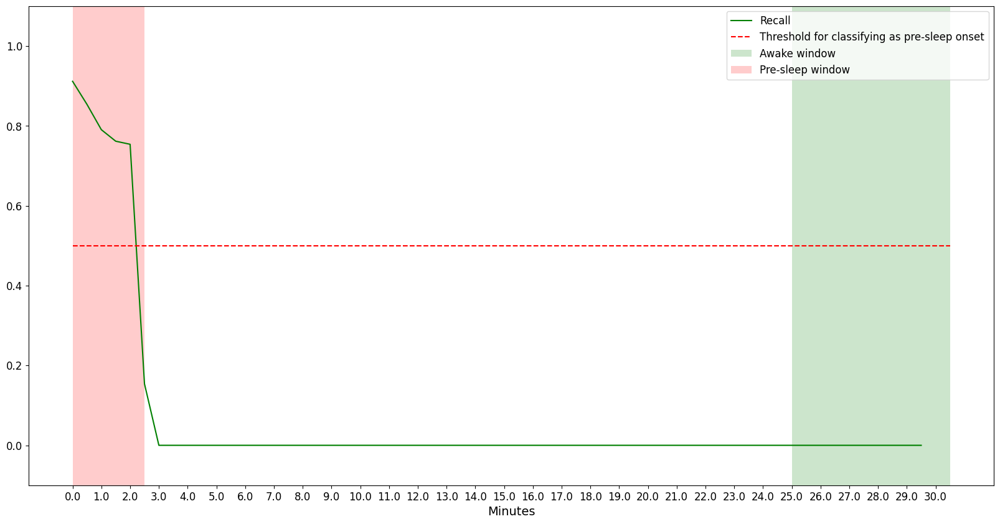

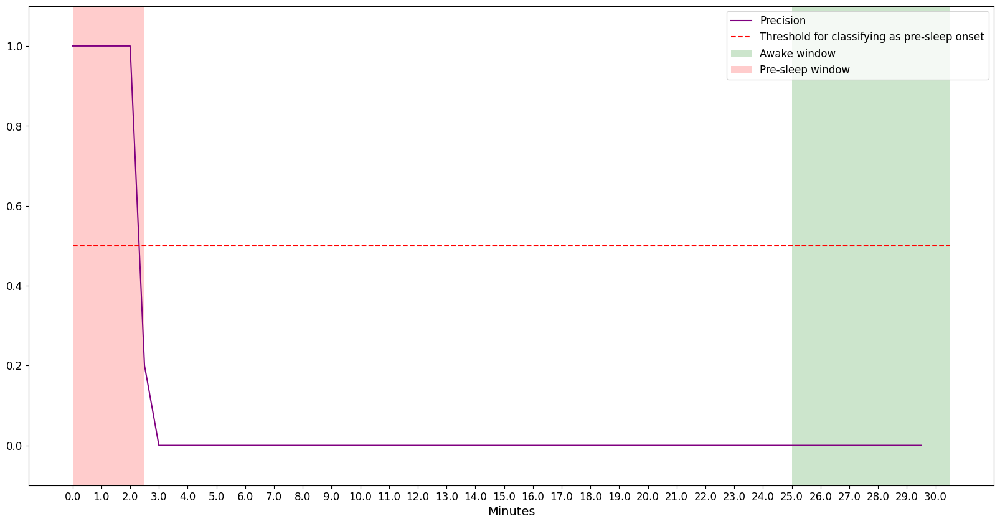

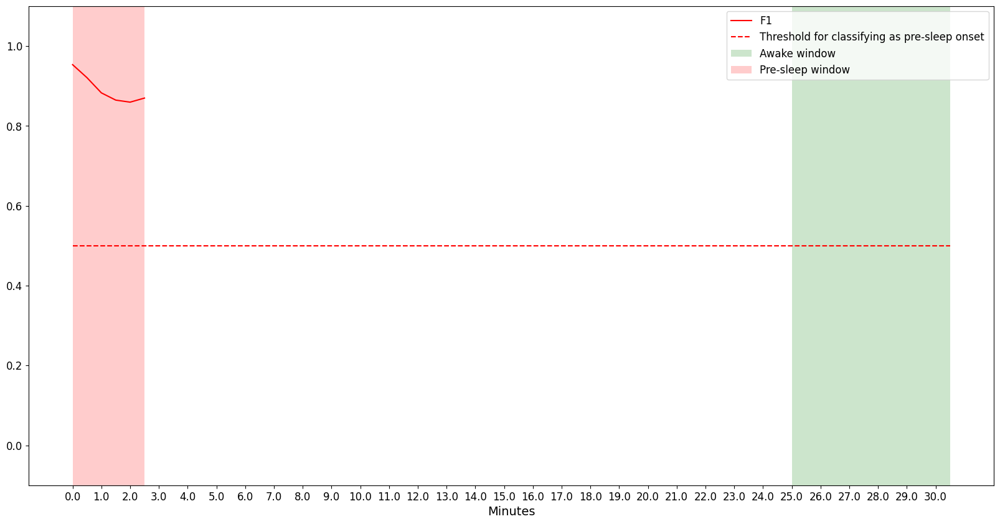

Probability of sleep as predicted by the model
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]


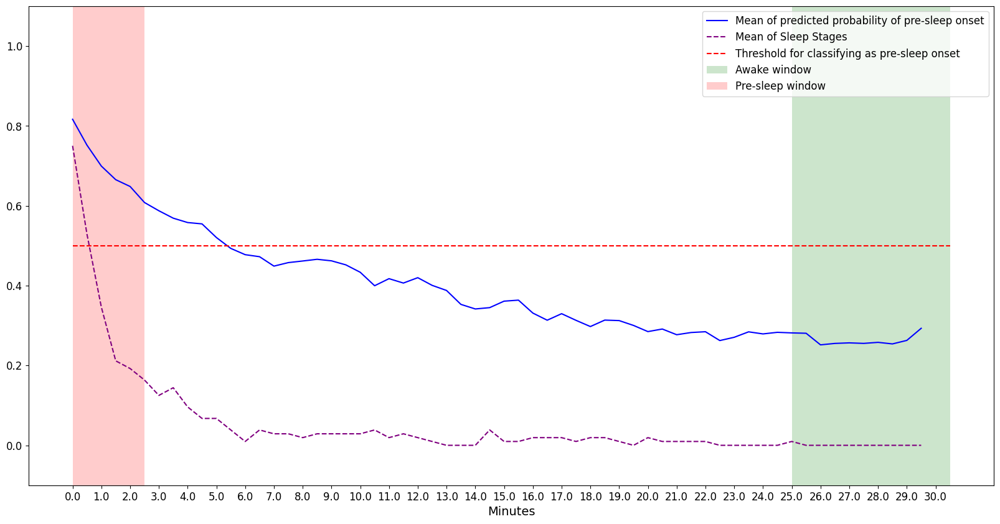

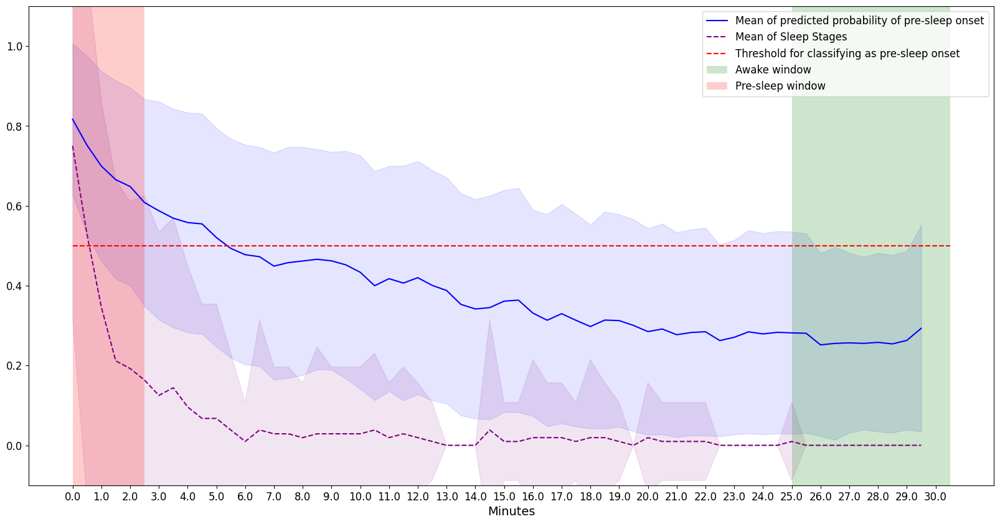

[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]


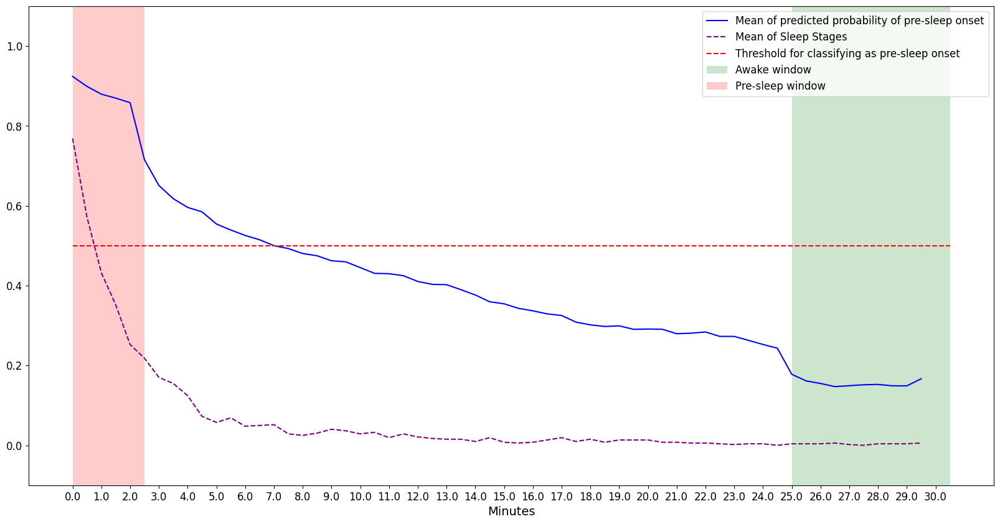

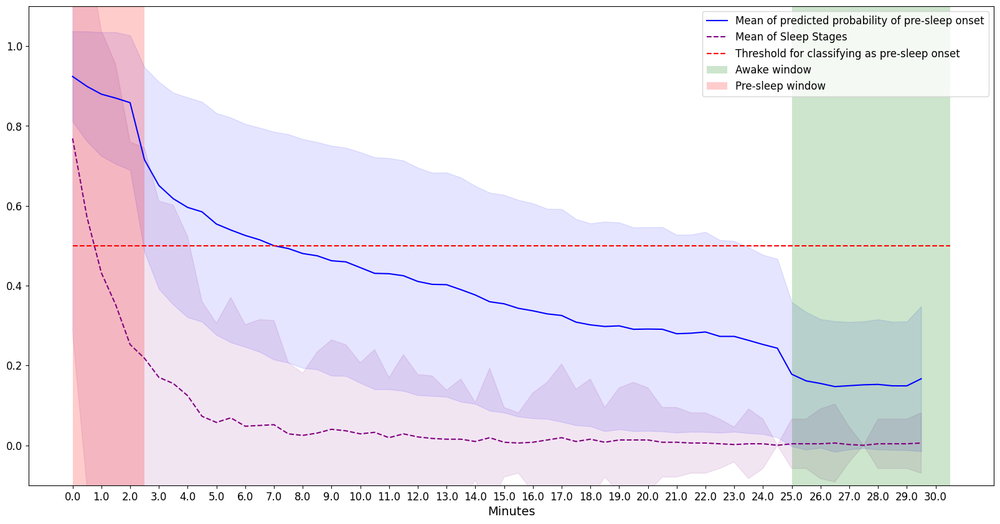

Mean Absolute Error: 0.23
Accuracy: 95.42 %.
Mean Squared Error: 0.12
Root Mean Squared Error: 0.35
R2: 1.0


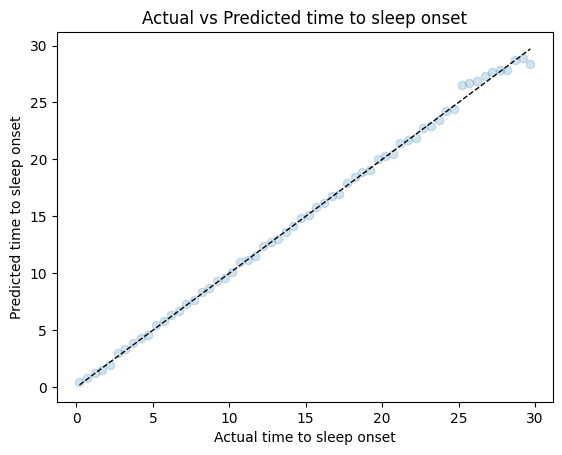

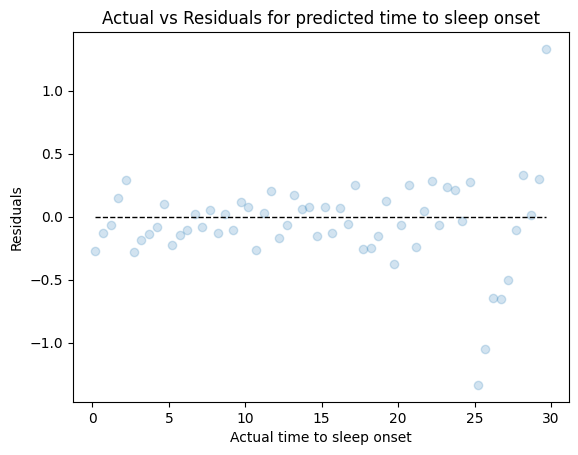

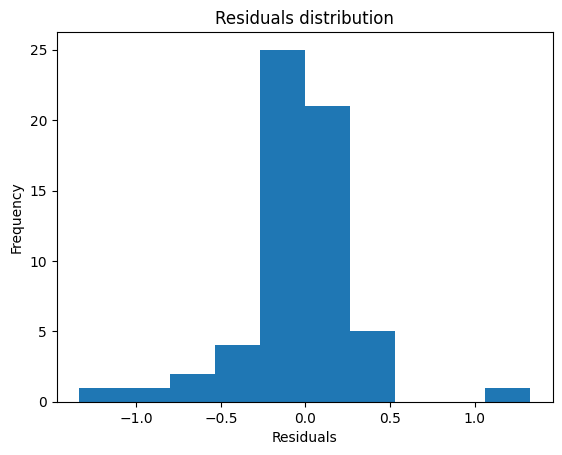

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


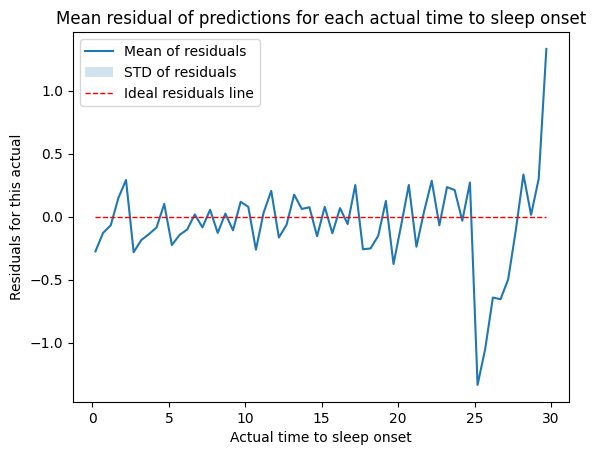

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


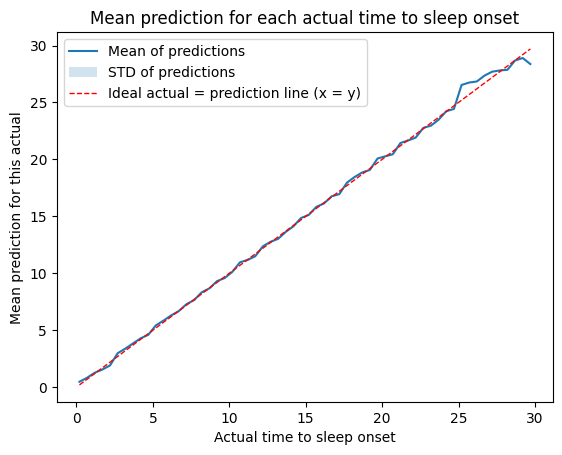

Mean Absolute Error: 8.4
Accuracy: -11.24 %.
Mean Squared Error: 116.94
Root Mean Squared Error: 10.81
R2: -0.56


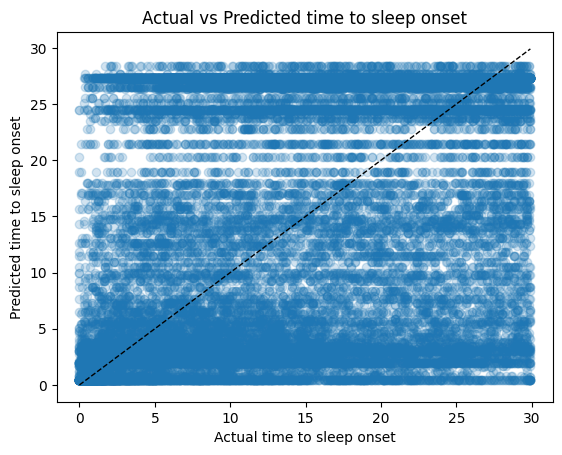

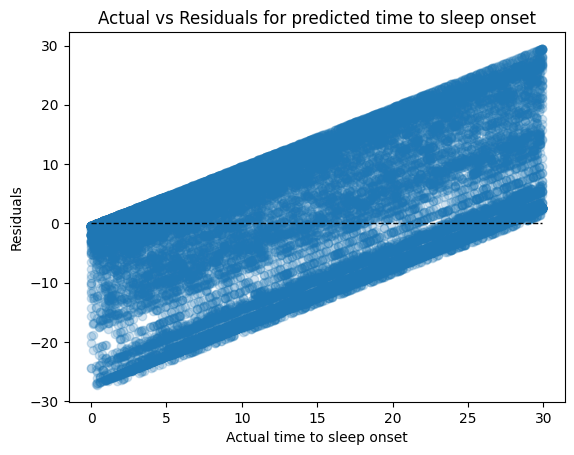

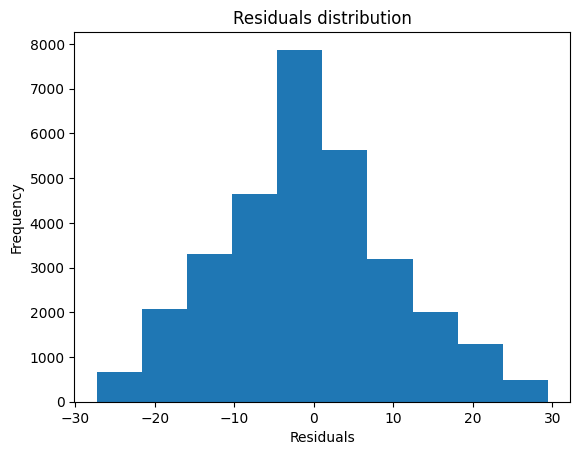

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


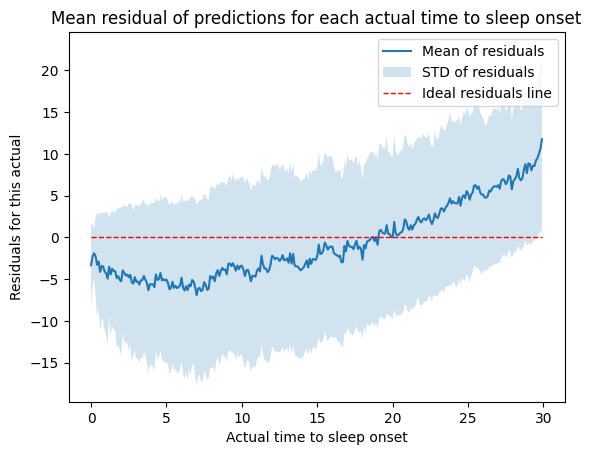

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


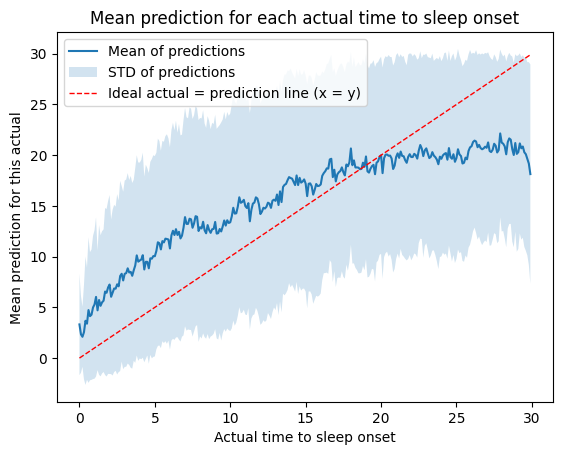

Predict for participant:  1077
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 8.75
Accuracy: 28.76 %.
Mean Squared Error: 121.03
Root Mean Squared Error: 11.0
R2: -0.61


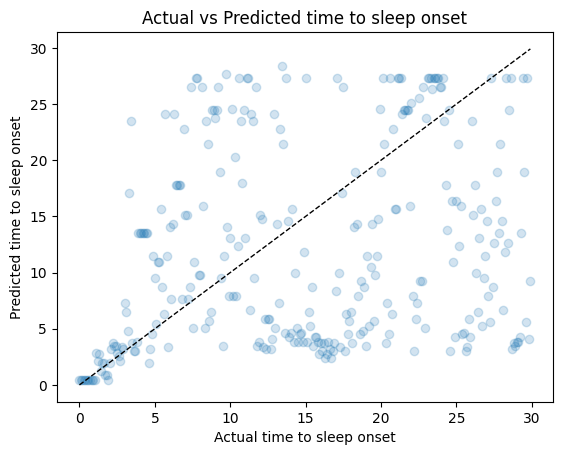

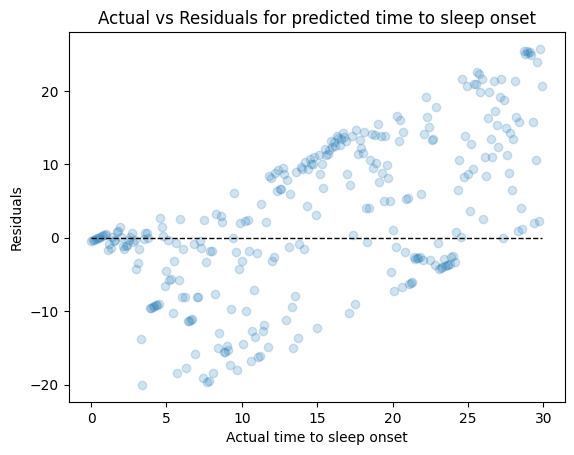

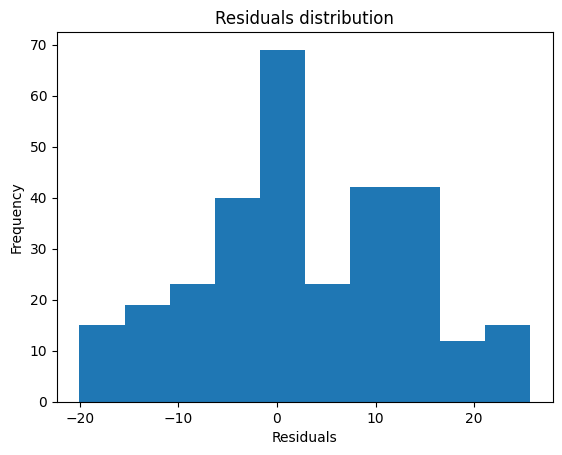

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


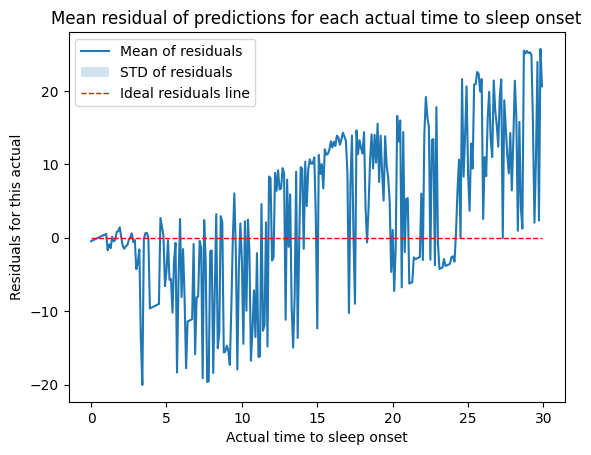

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


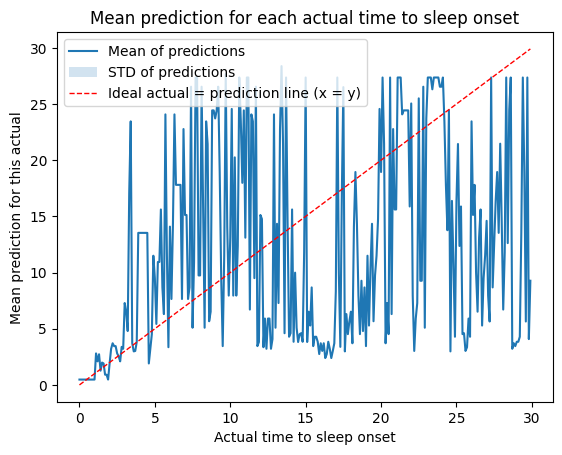

Predict for participant:  1301
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 8.43
Accuracy: 18.43 %.
Mean Squared Error: 111.45
Root Mean Squared Error: 10.56
R2: -0.49


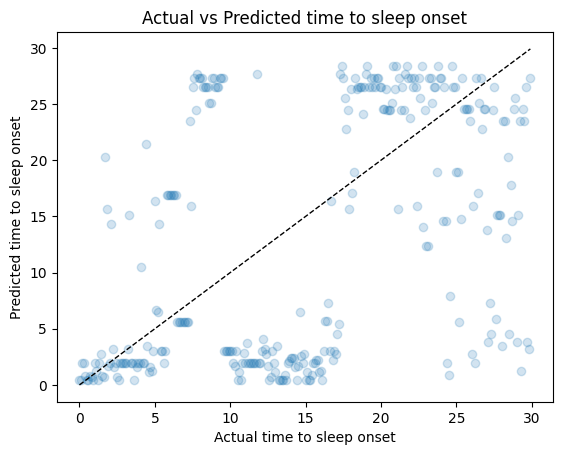

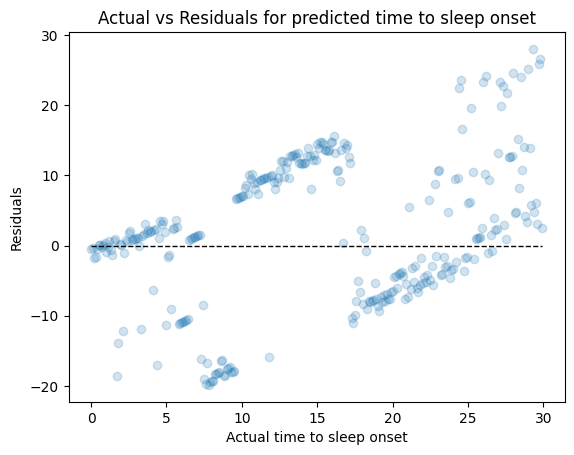

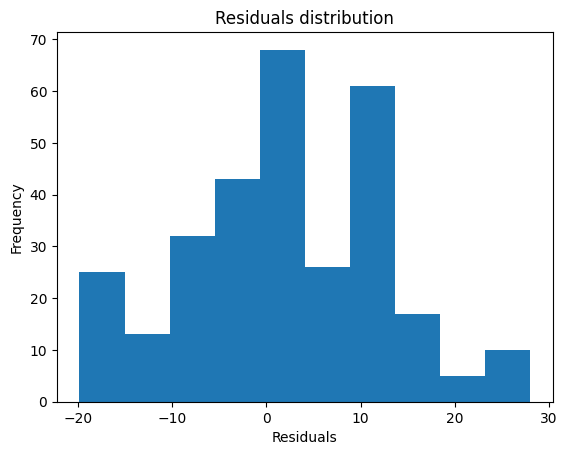

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


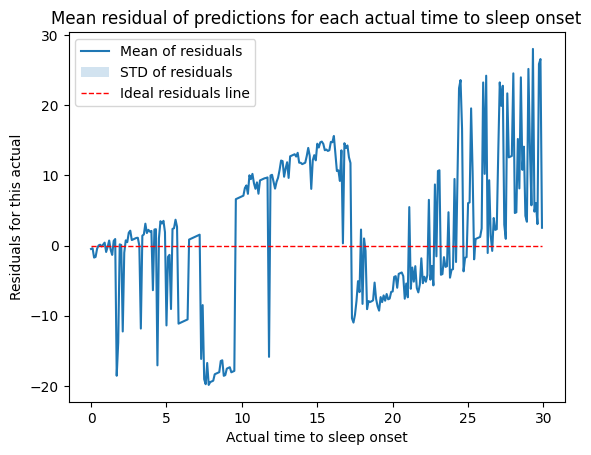

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


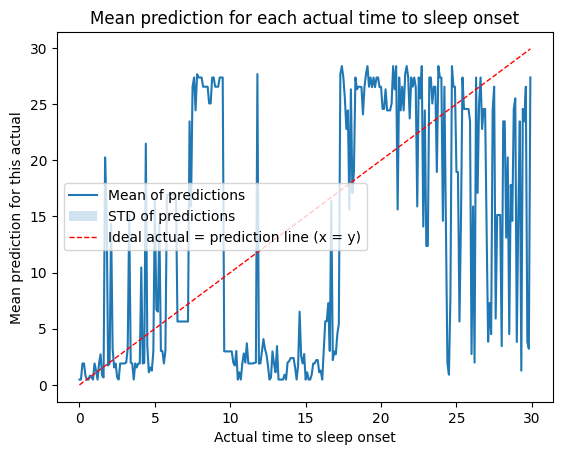

Predict for participant:  1744
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 11.2
Accuracy: 25.95 %.
Mean Squared Error: 194.88
Root Mean Squared Error: 13.96
R2: -1.6


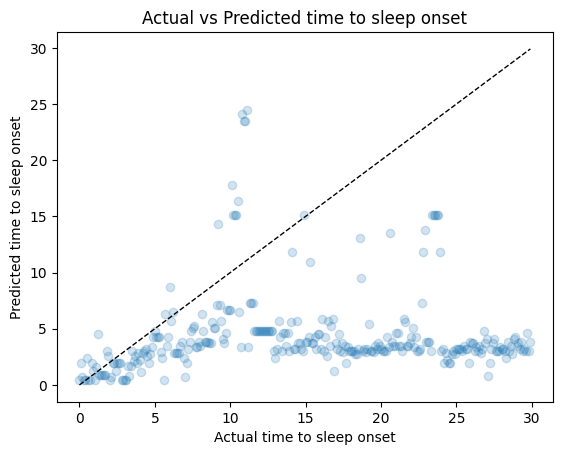

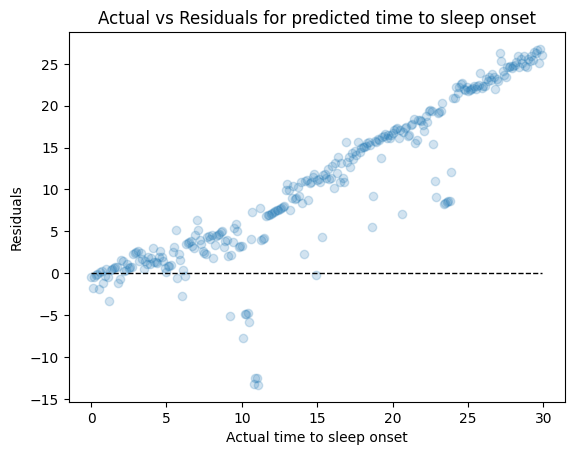

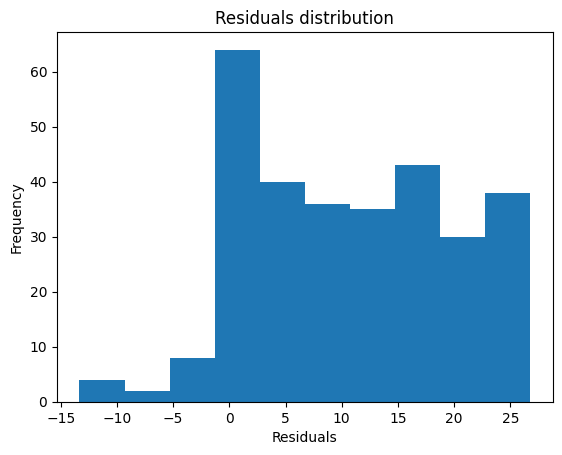

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


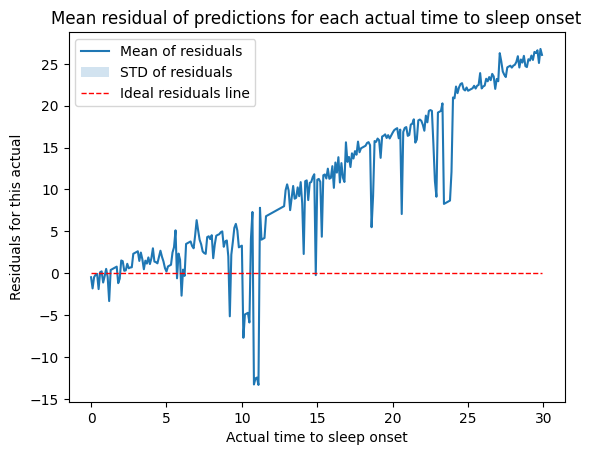

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


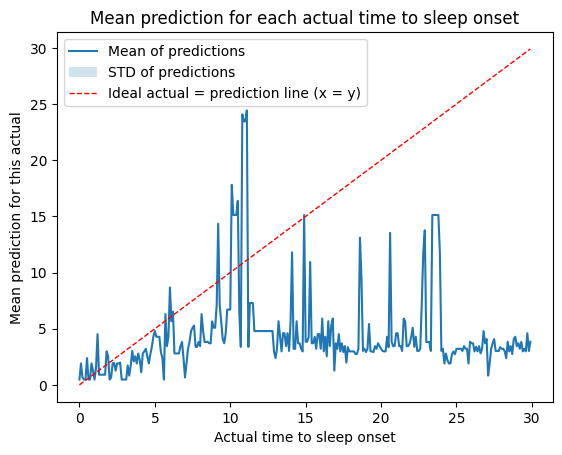

Predict for participant:  2039
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 8.86
Accuracy: -18.18 %.
Mean Squared Error: 128.08
Root Mean Squared Error: 11.32
R2: -0.71


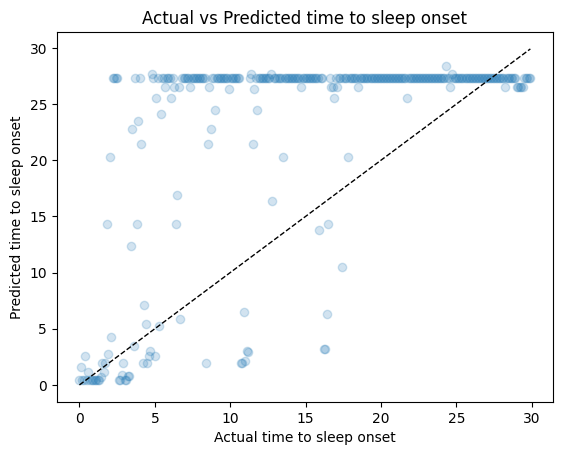

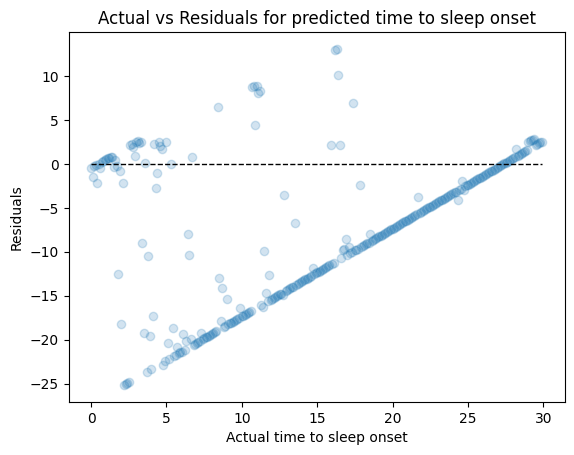

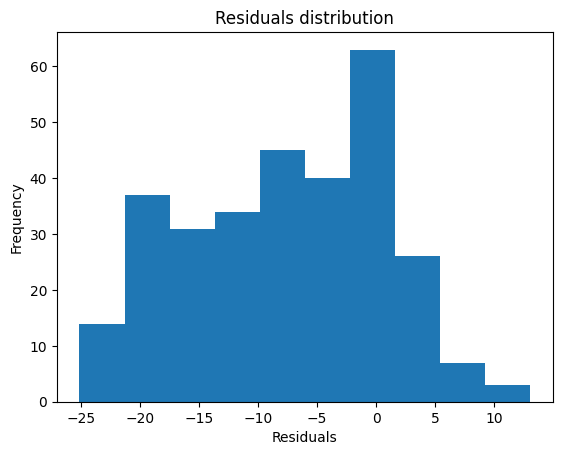

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


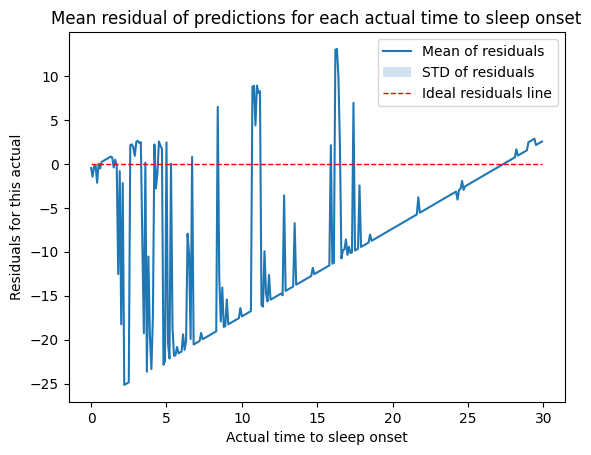

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


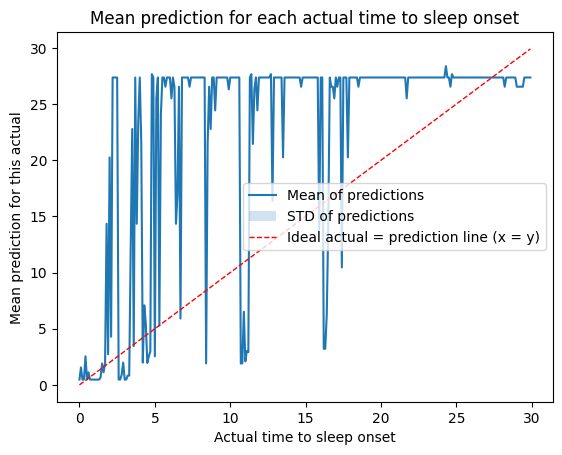

Predict for participant:  2167
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 7.48
Accuracy: 13.4 %.
Mean Squared Error: 91.31
Root Mean Squared Error: 9.56
R2: -0.22


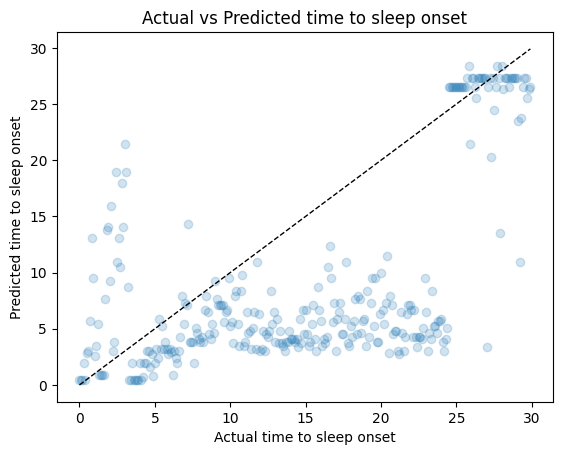

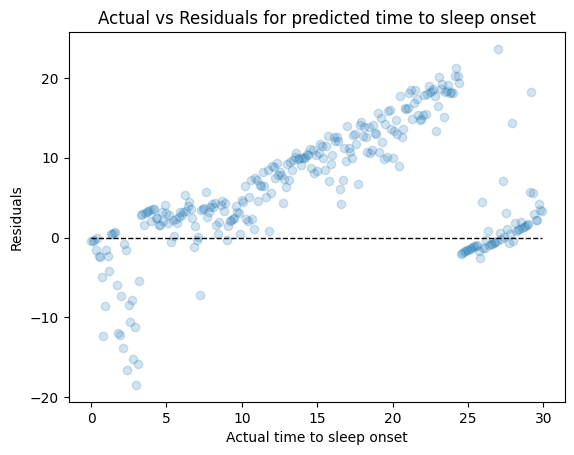

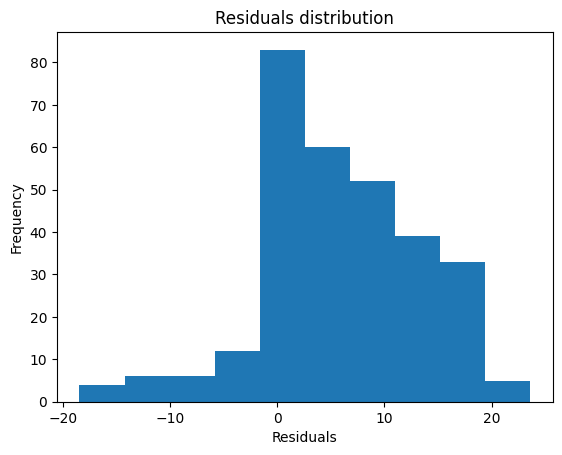

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


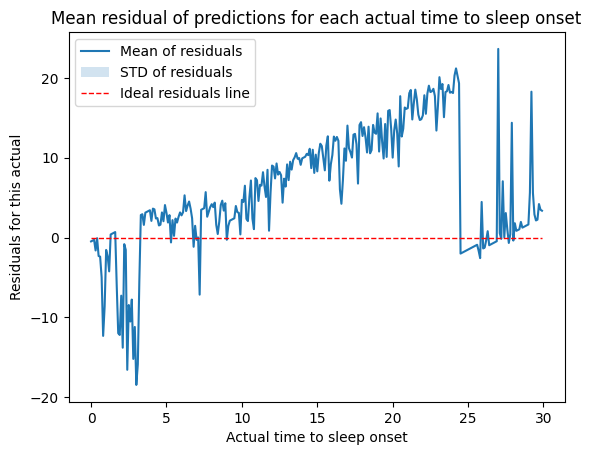

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


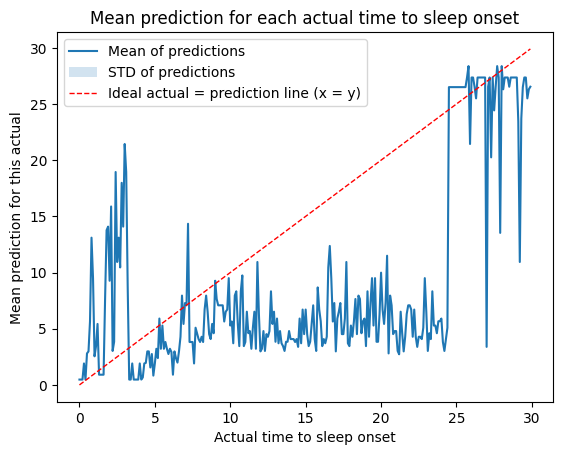

Predict for participant:  3106
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 8.29
Accuracy: 16.29 %.
Mean Squared Error: 116.09
Root Mean Squared Error: 10.77
R2: -0.55


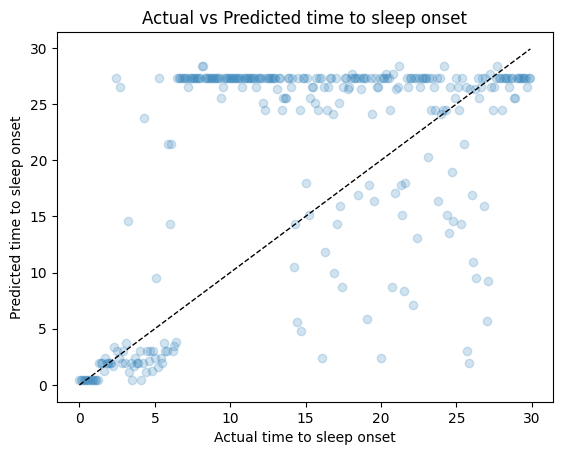

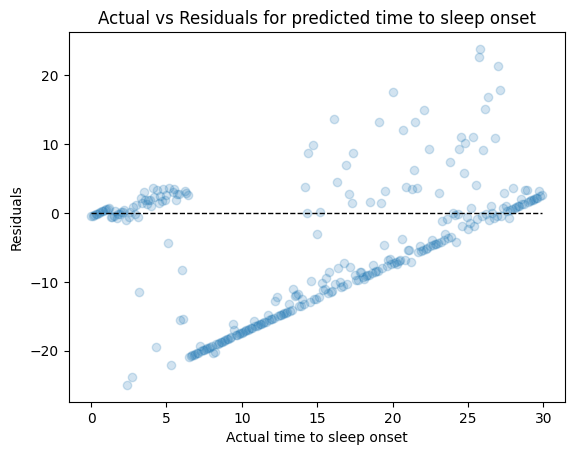

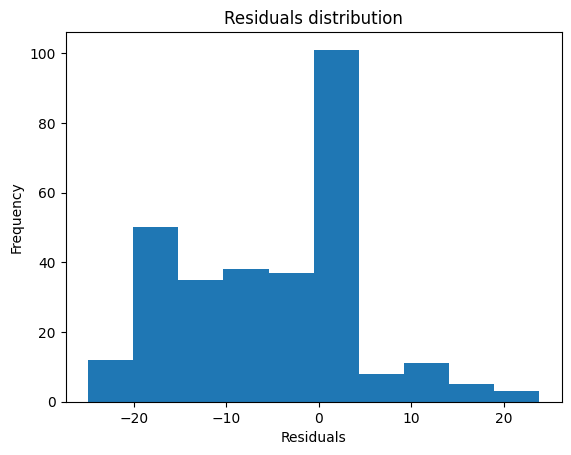

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


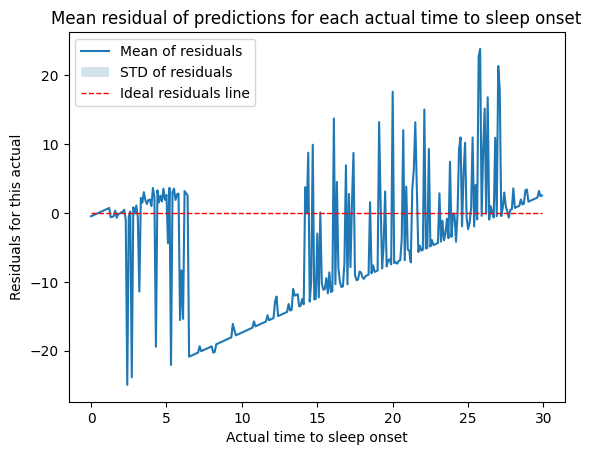

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


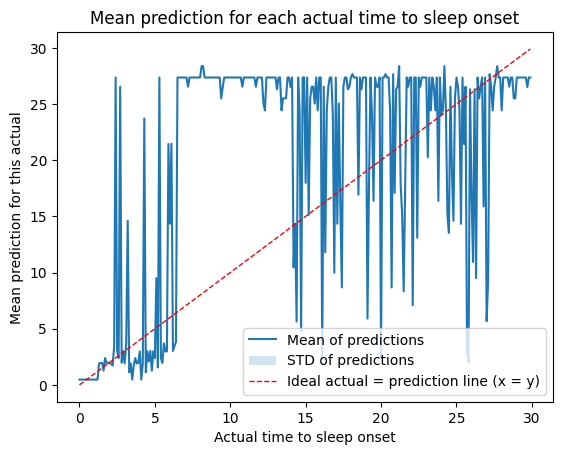

Predict for participant:  5009
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 6.99
Accuracy: 36.8 %.
Mean Squared Error: 86.12
Root Mean Squared Error: 9.28
R2: -0.15


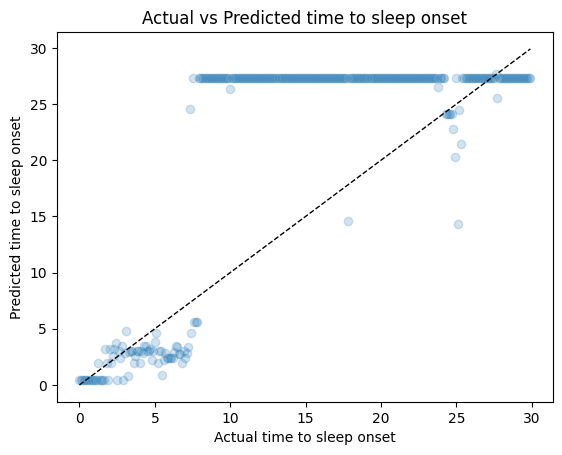

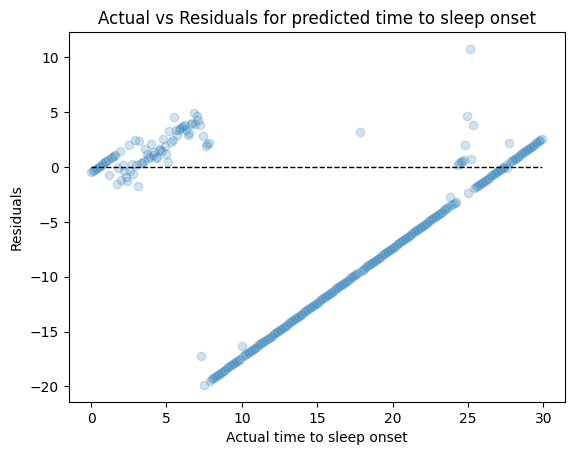

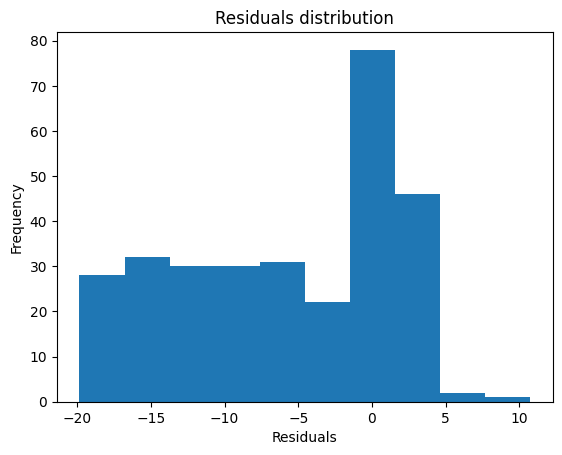

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


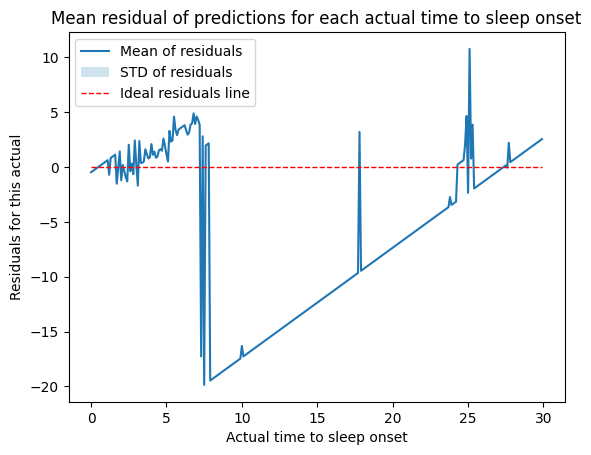

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


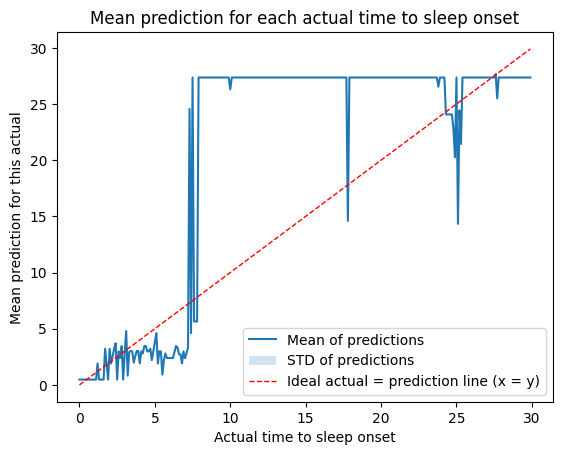

Predict for participant:  5162
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 6.33
Accuracy: 24.86 %.
Mean Squared Error: 68.54
Root Mean Squared Error: 8.28
R2: 0.09


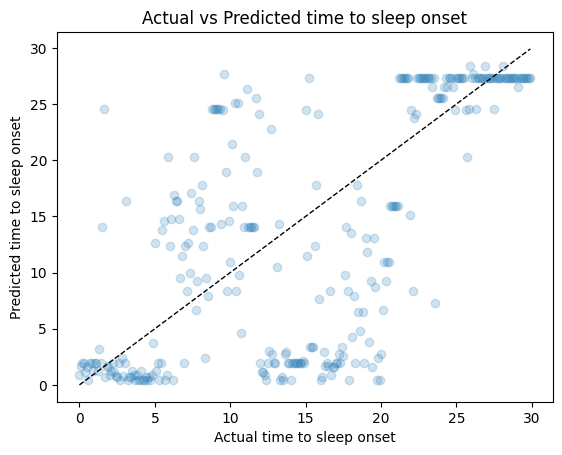

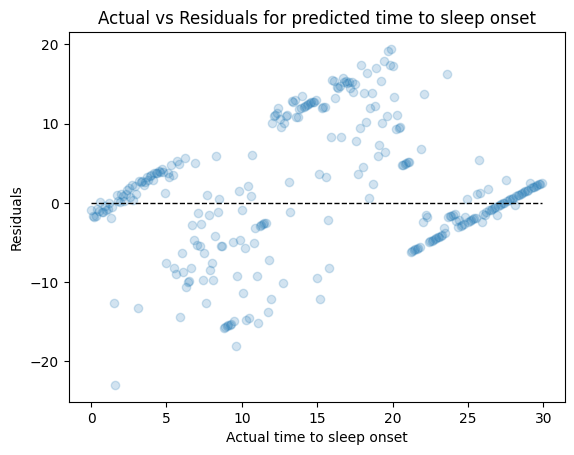

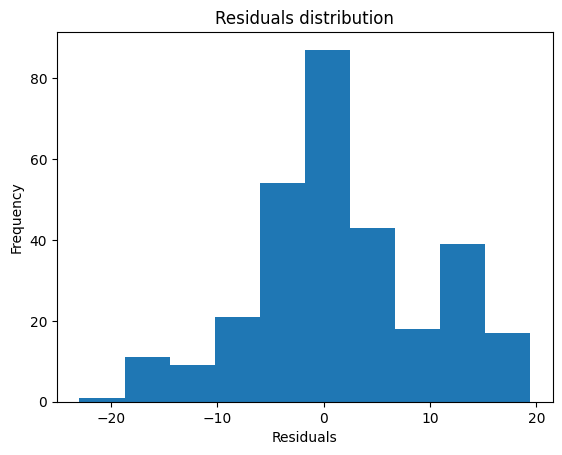

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


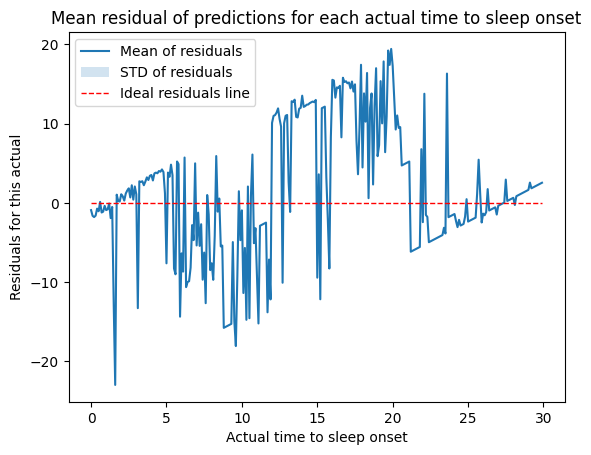

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


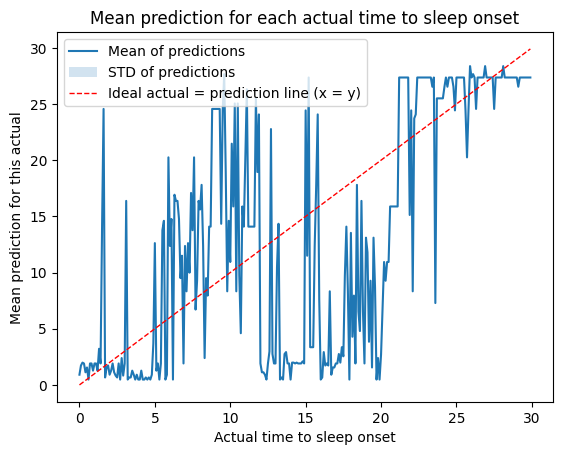

Predict for participant:  6313
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 5.6
Accuracy: 38.12 %.
Mean Squared Error: 47.38
Root Mean Squared Error: 6.88
R2: 0.37


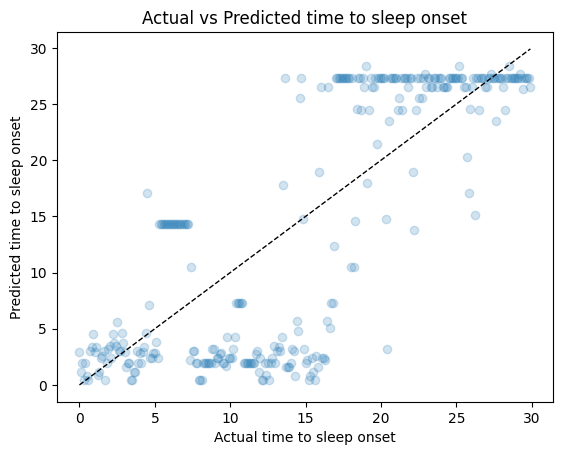

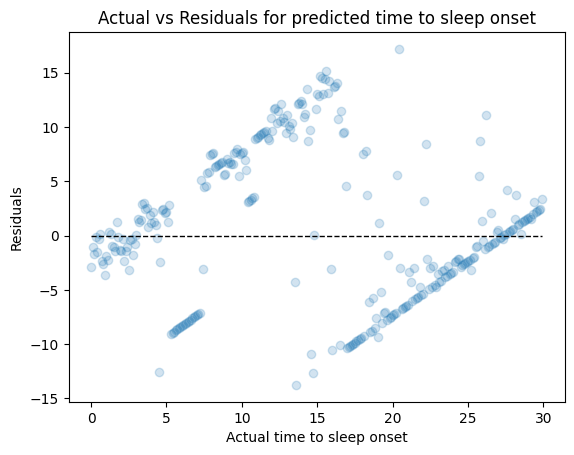

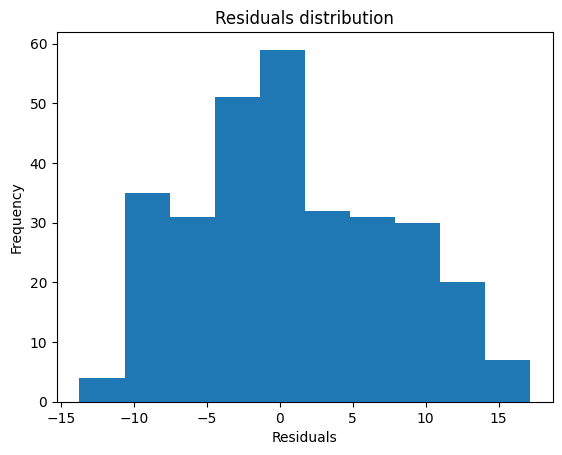

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


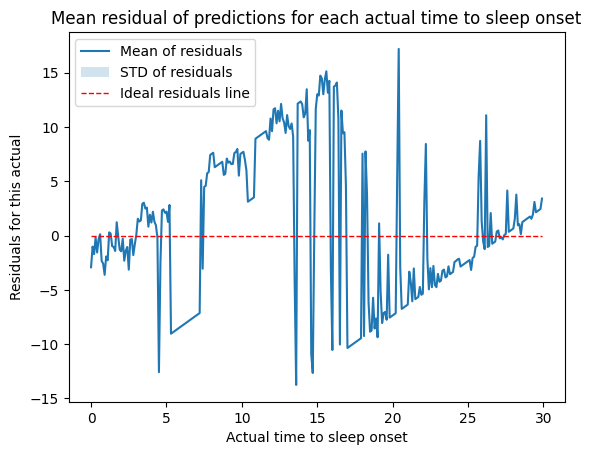

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


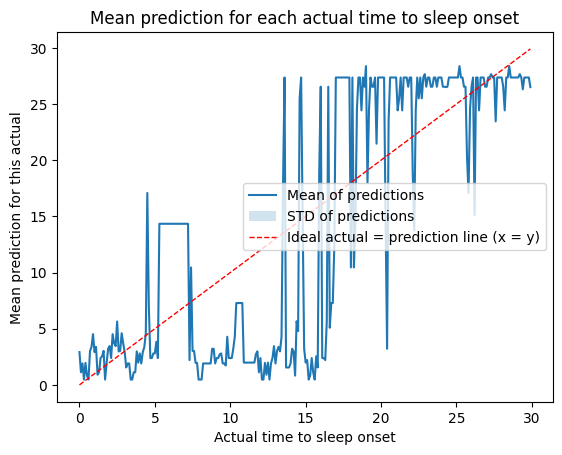

Predict for participant:  6653
--------------------------------------Evaluate regression ----------------------------------------
Mean Absolute Error: 9.91
Accuracy: -213.17 %.
Mean Squared Error: 153.21
Root Mean Squared Error: 12.38
R2: -1.04


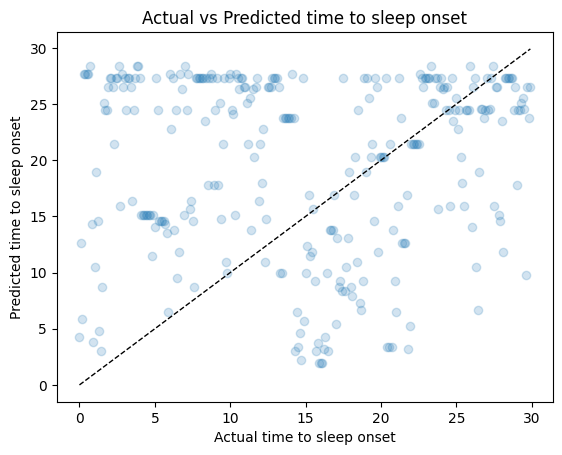

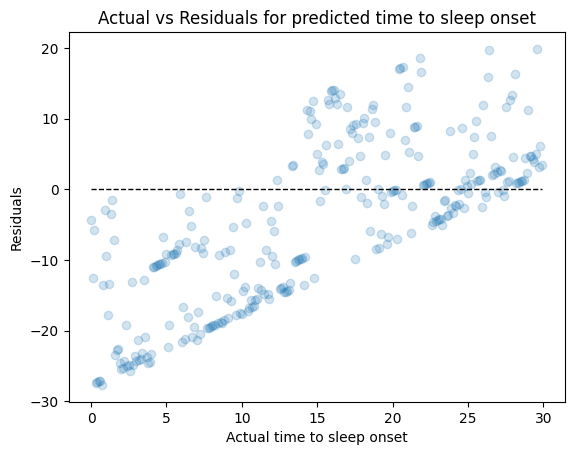

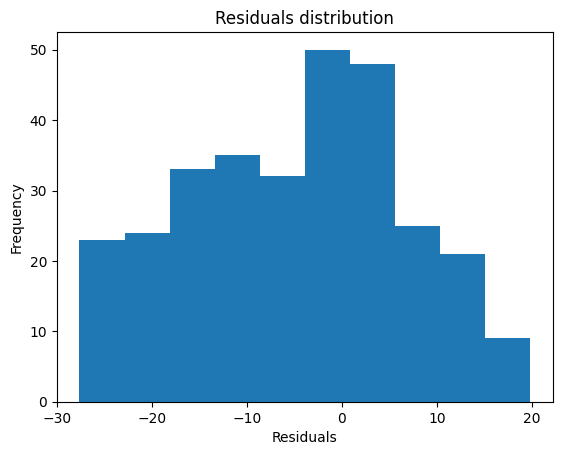

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:128: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')


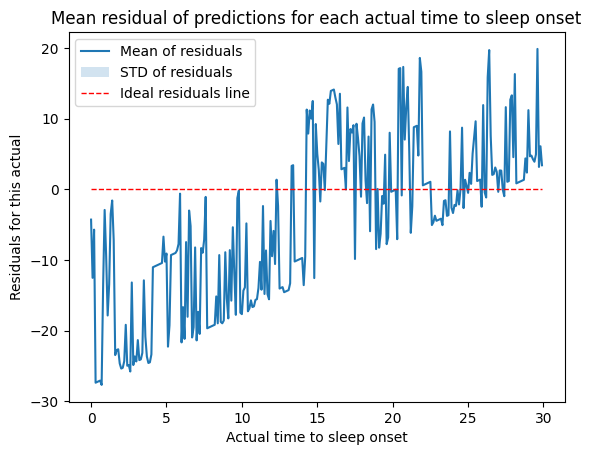

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/1160340103.py:149: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


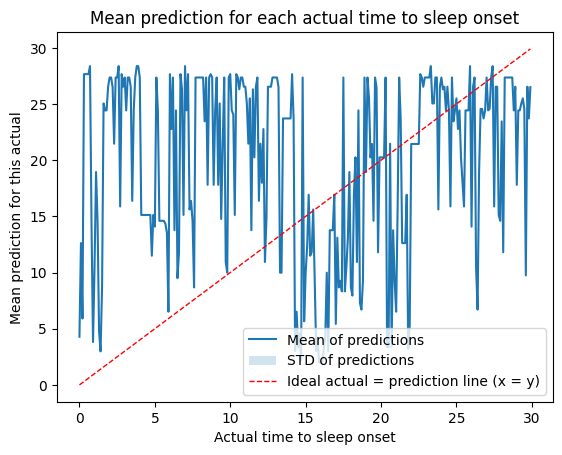

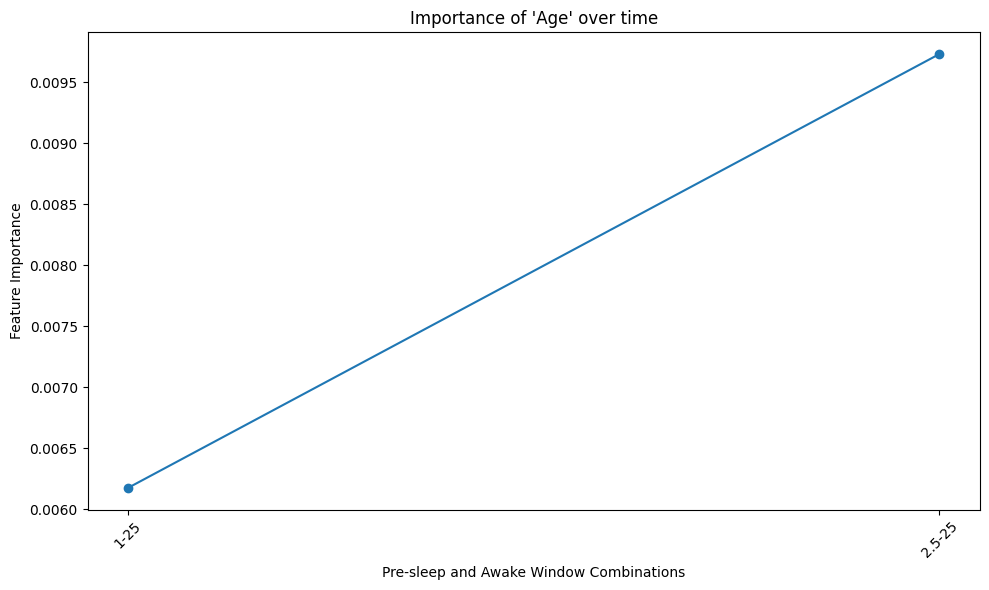

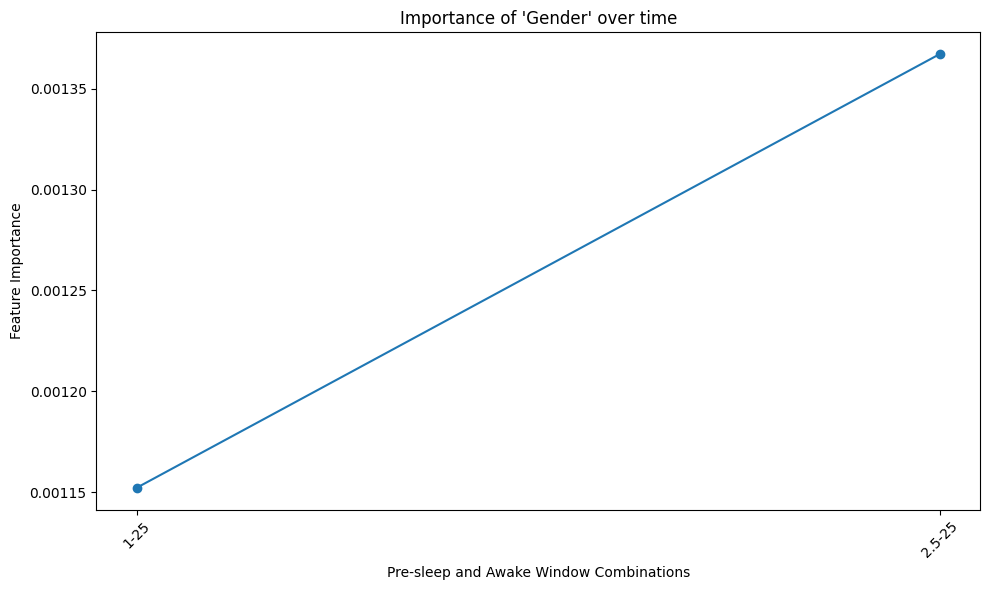

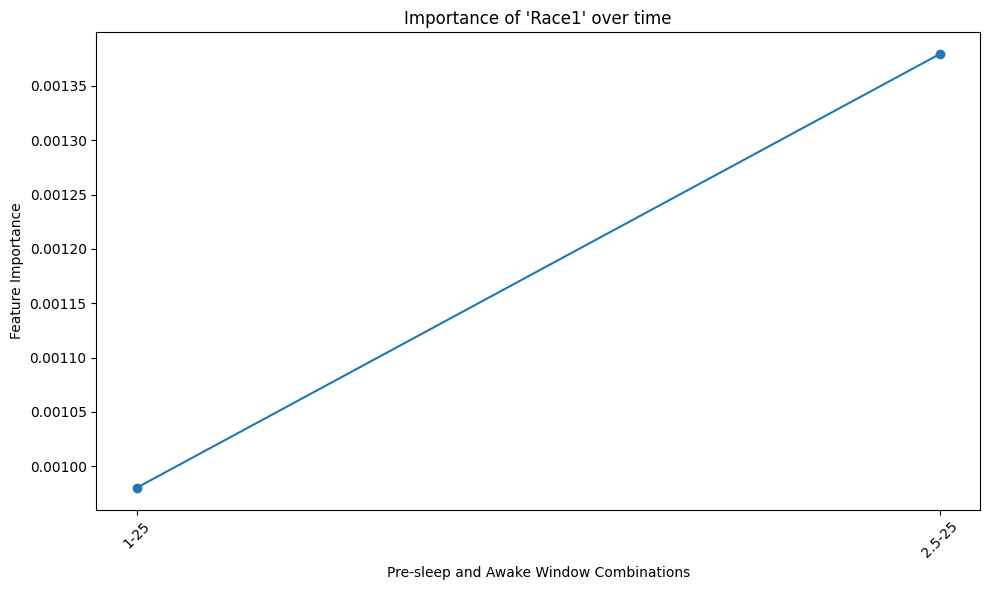

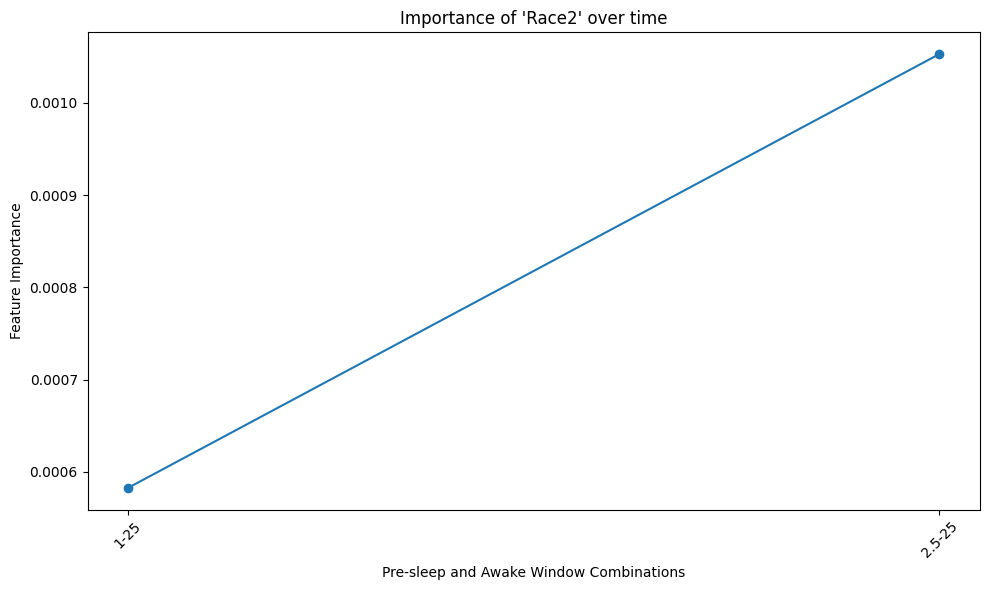

...

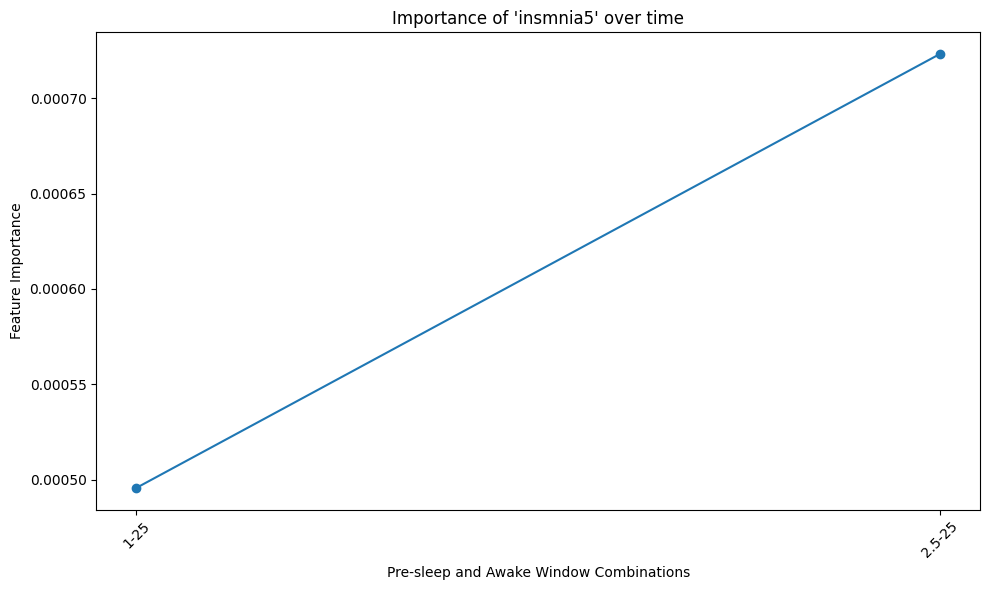

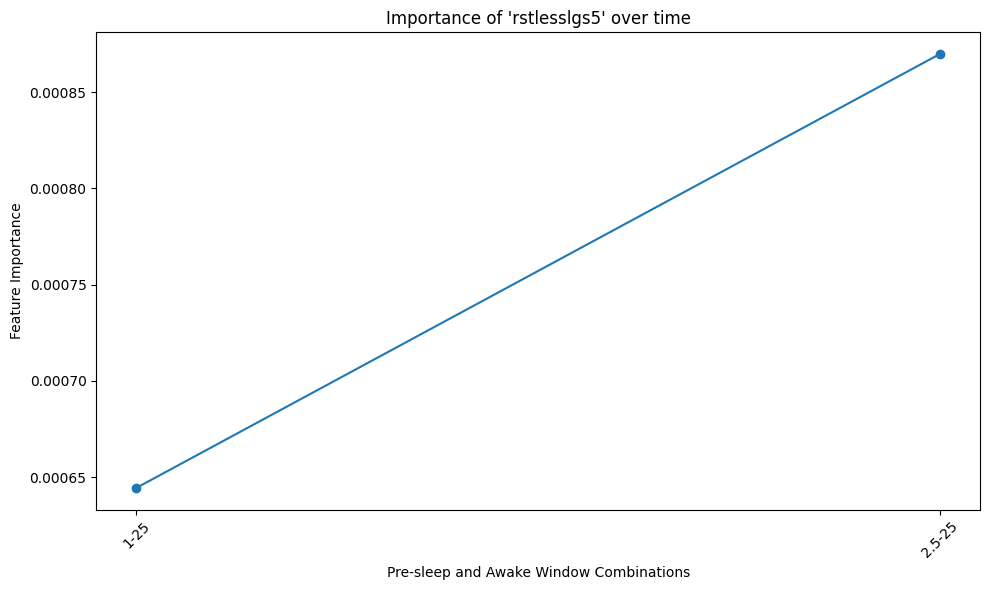

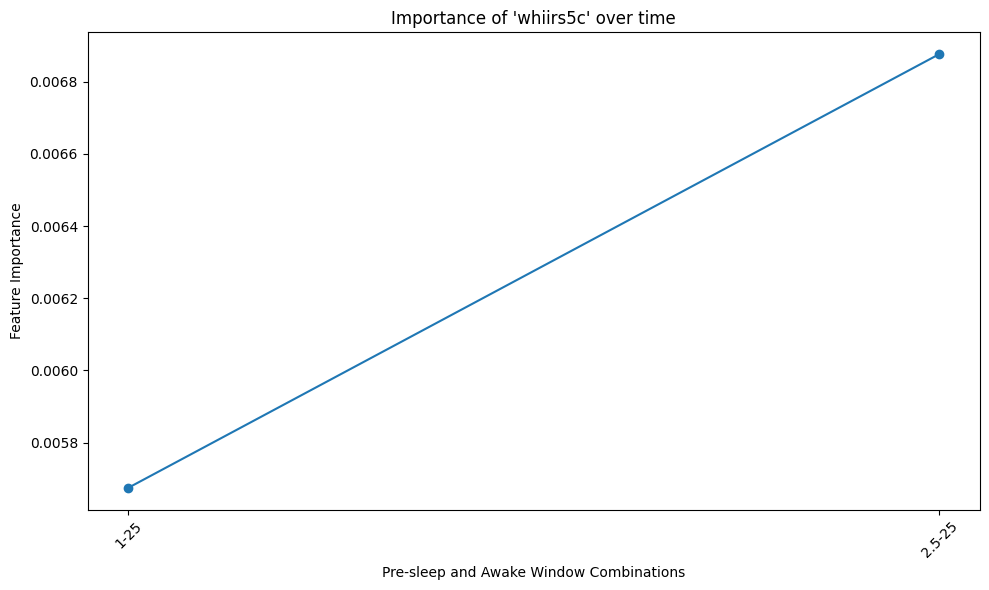

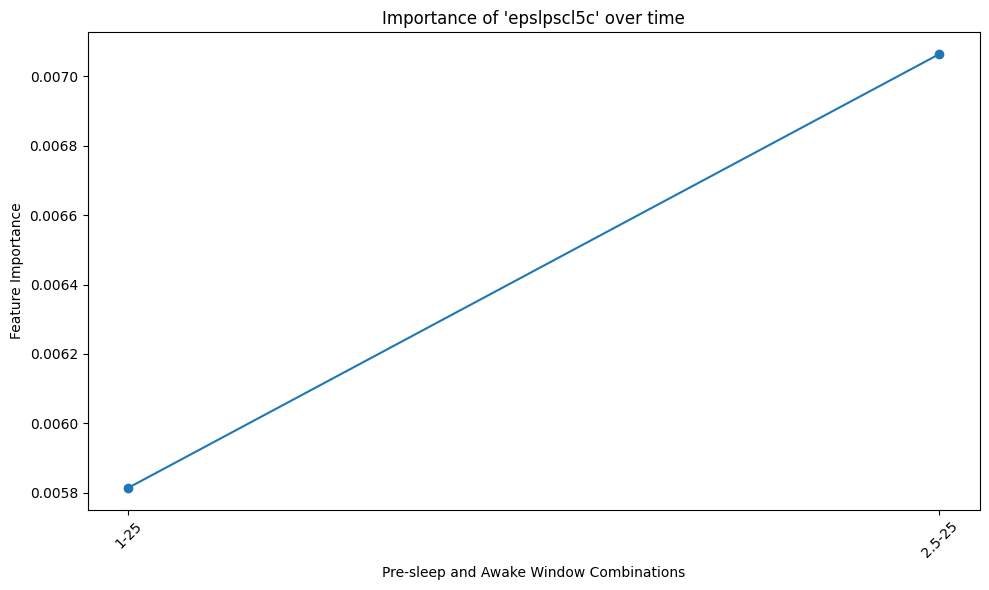

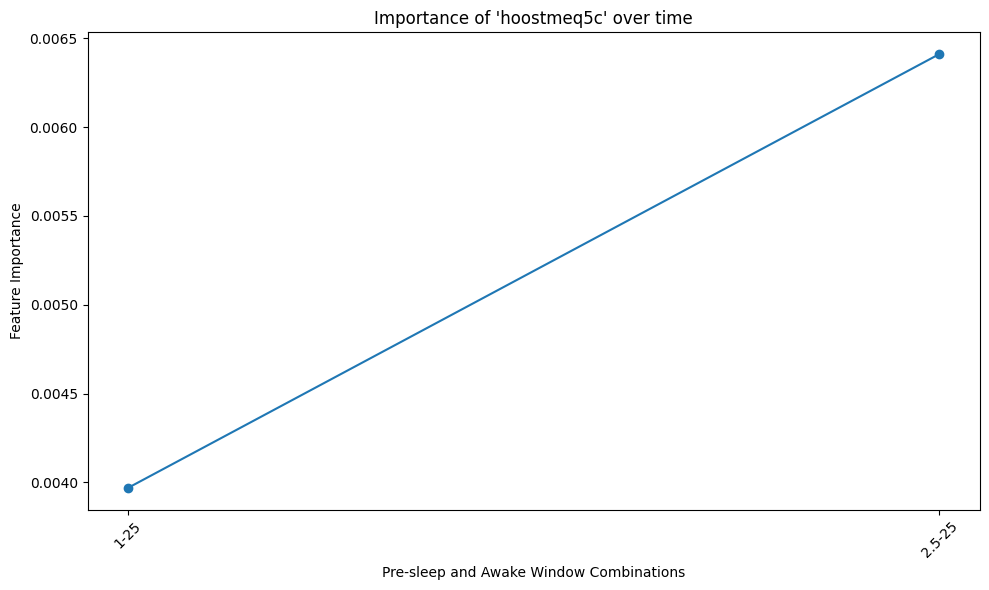

float64


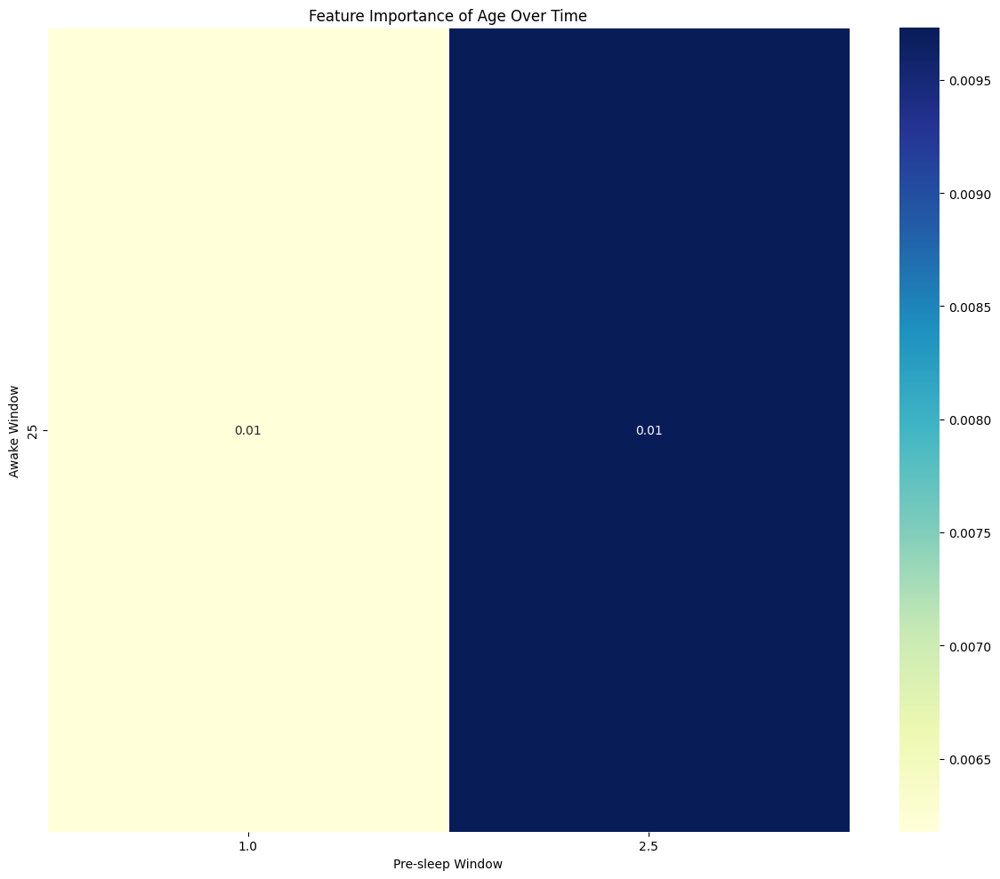

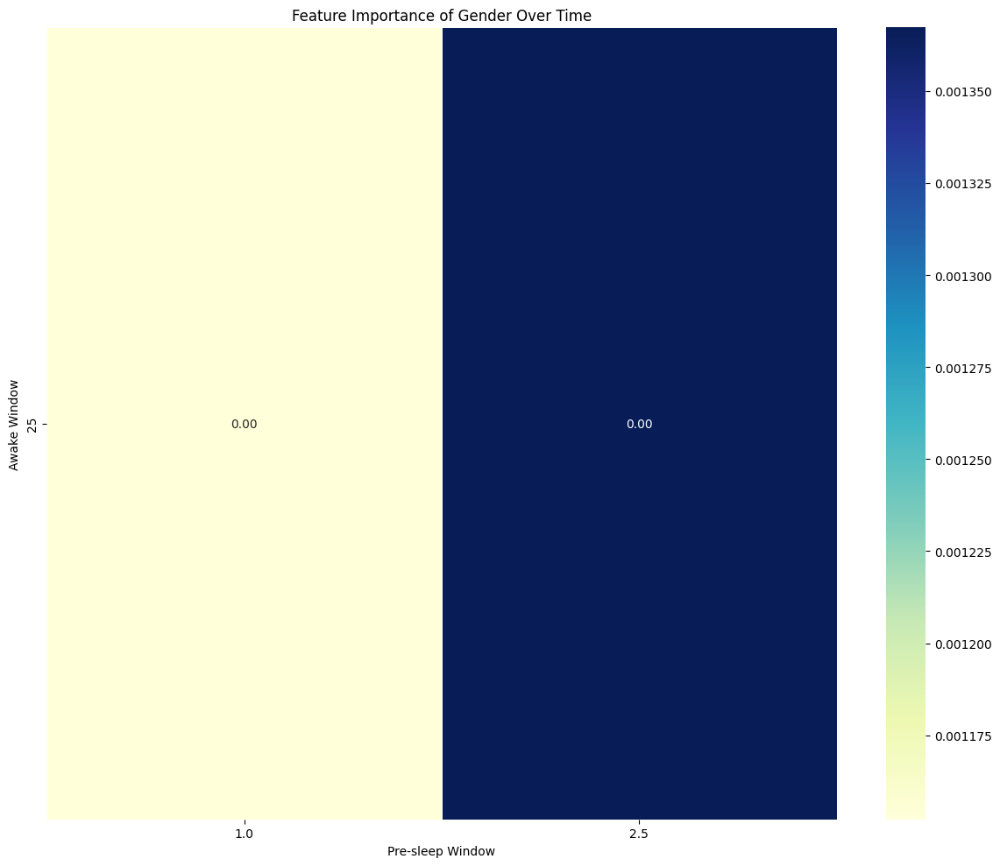

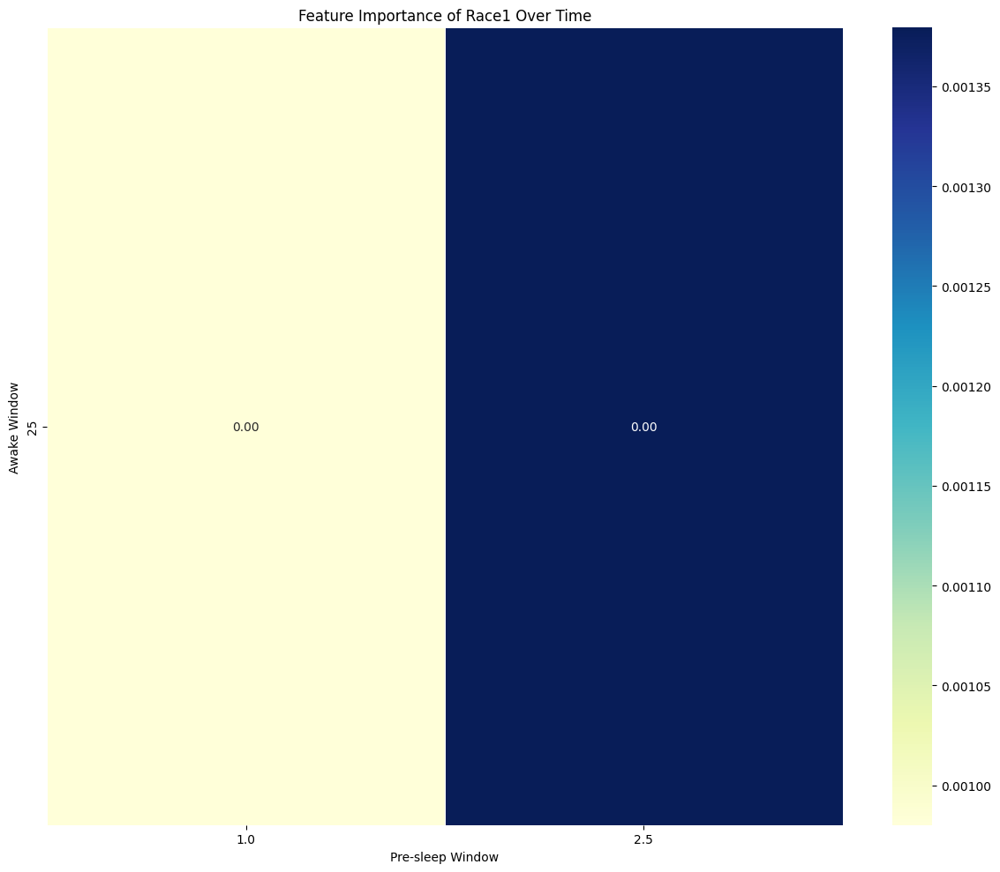

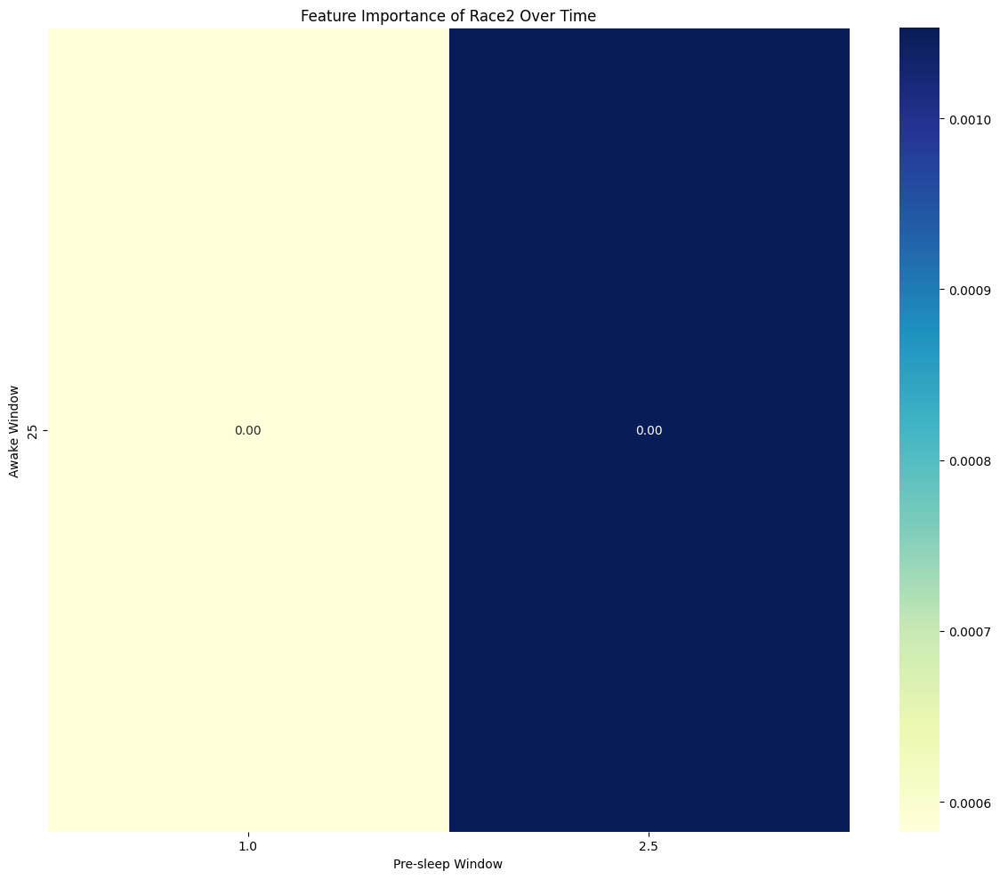

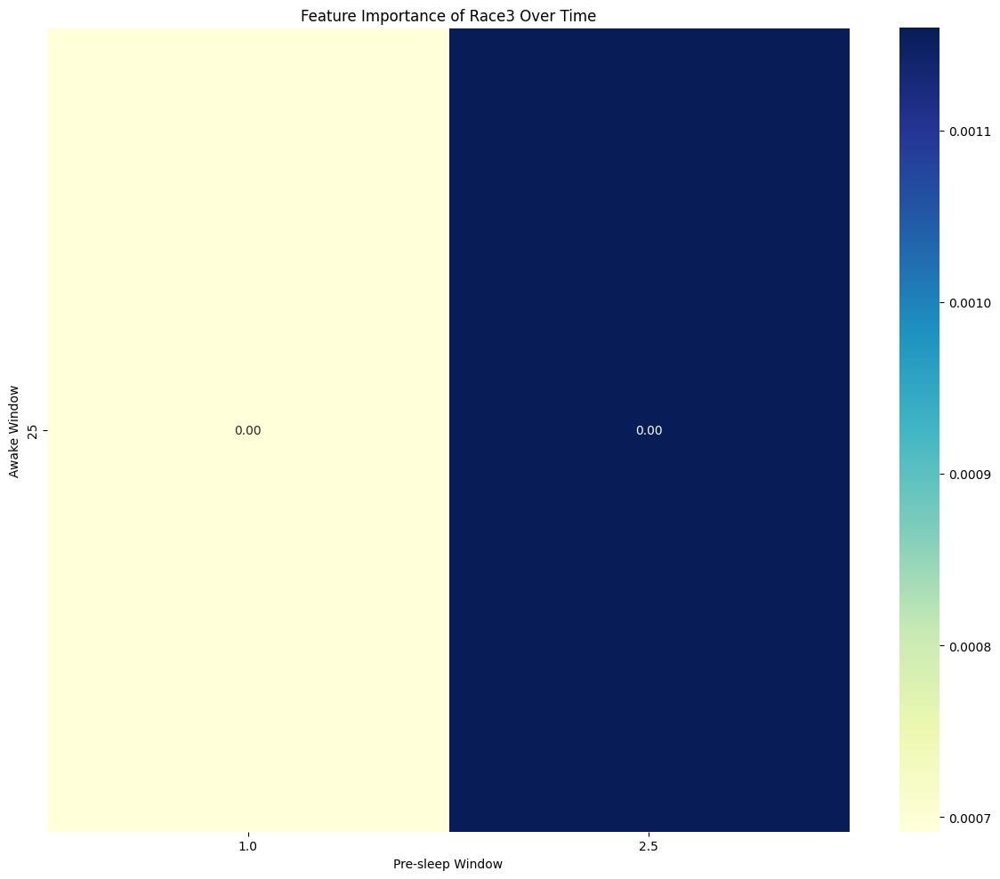

...

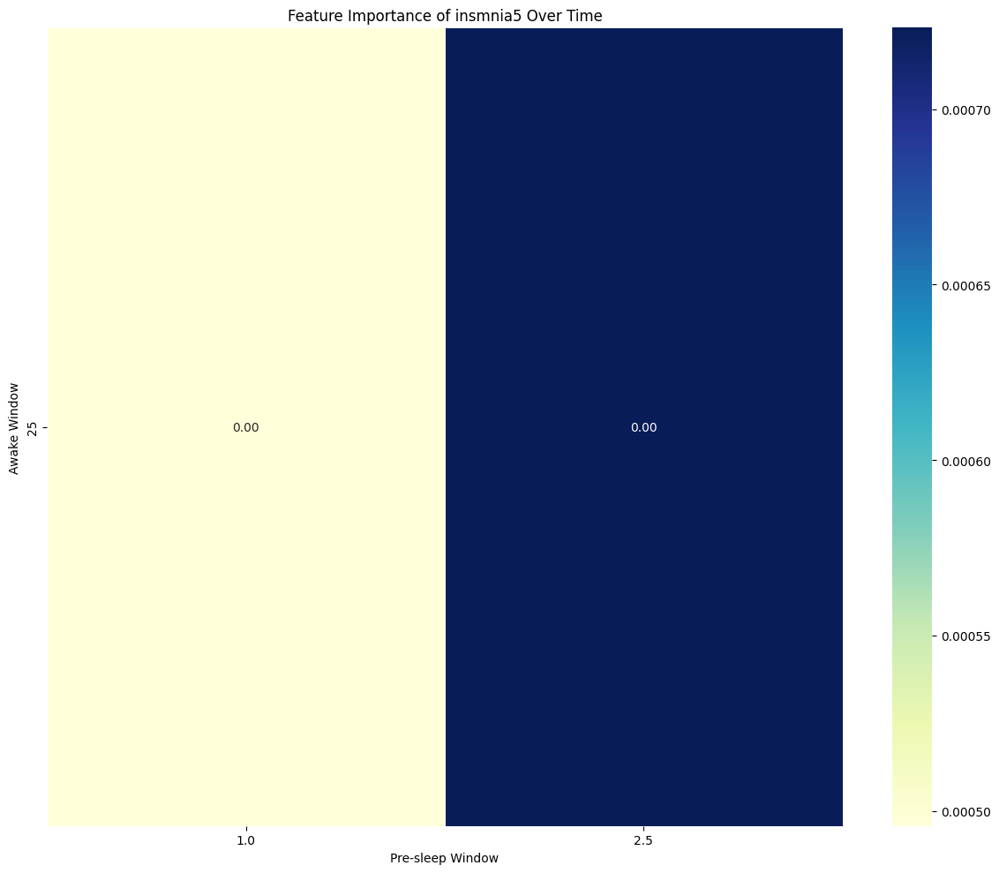

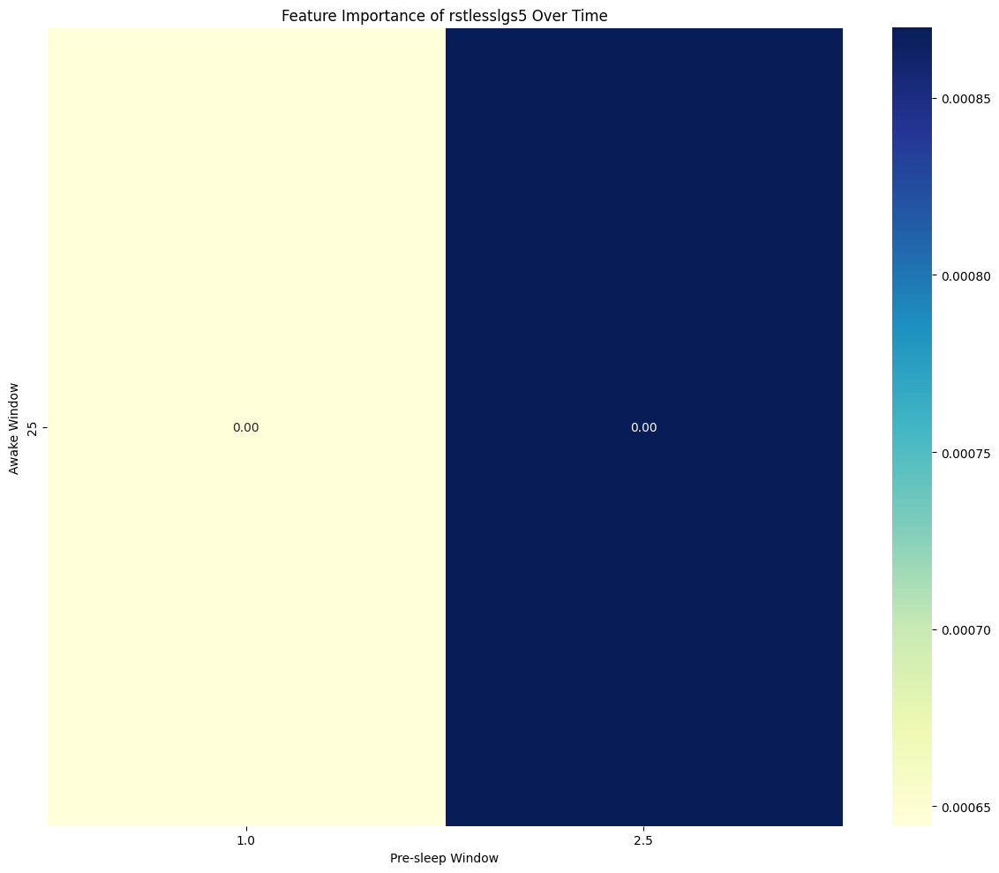

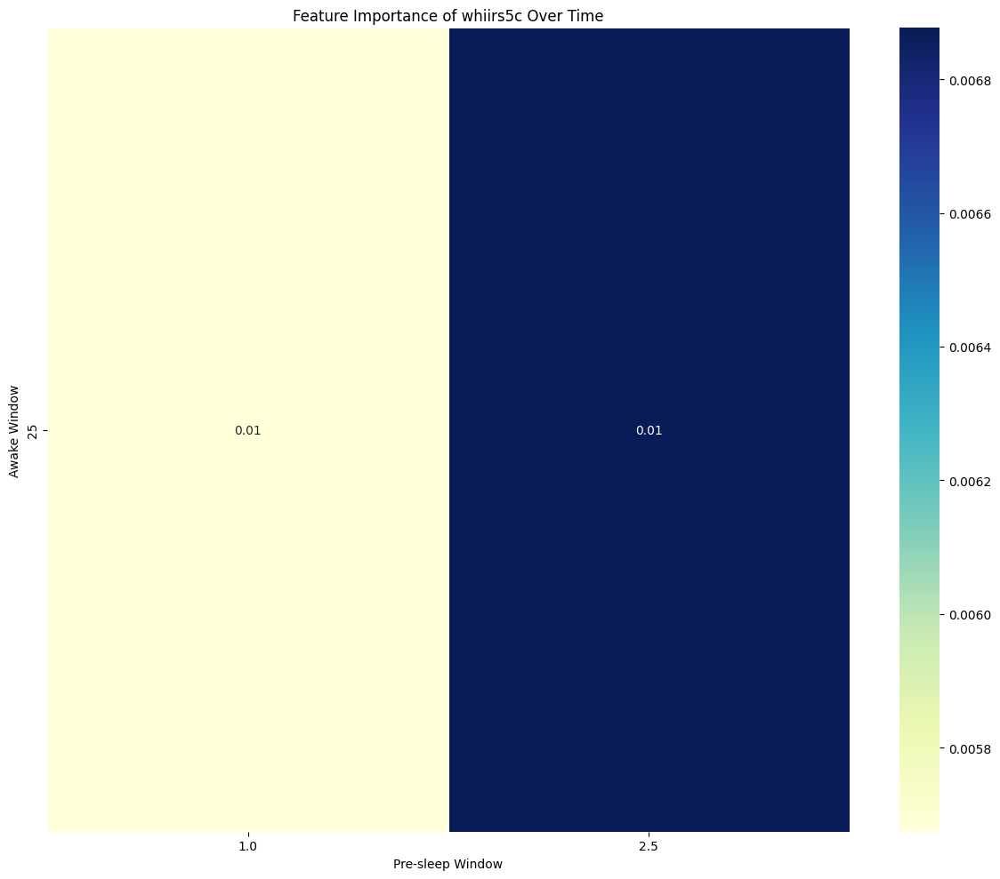

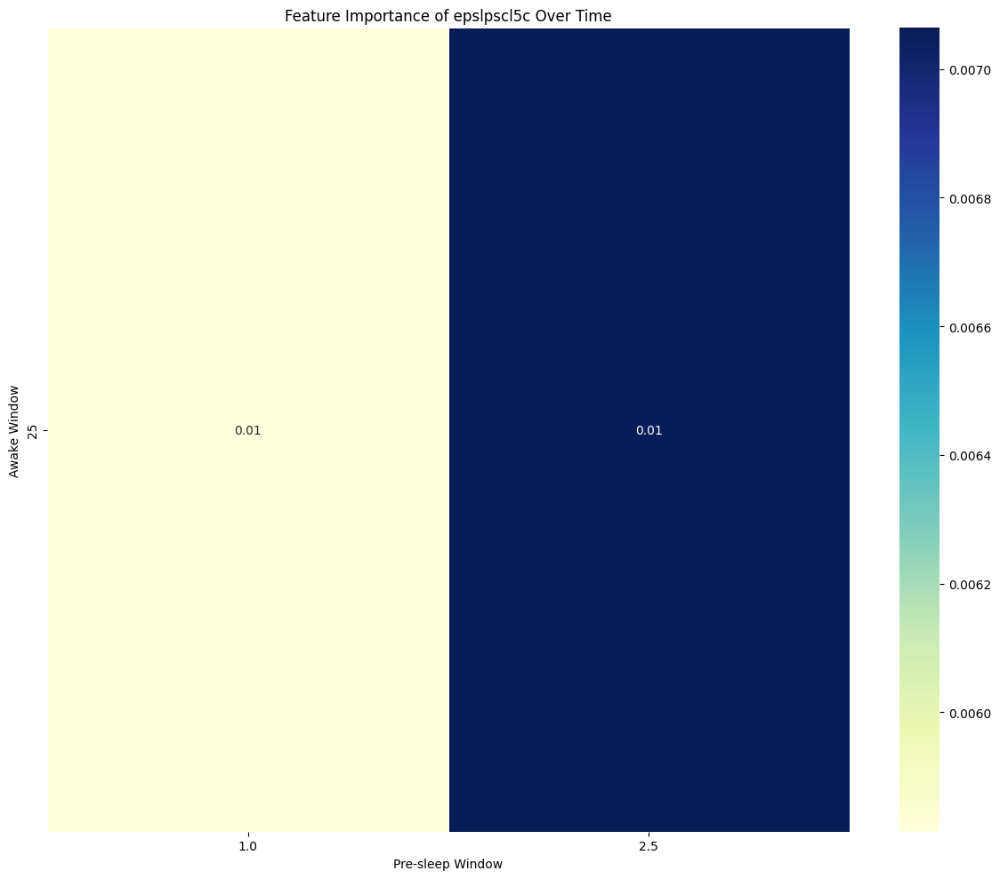

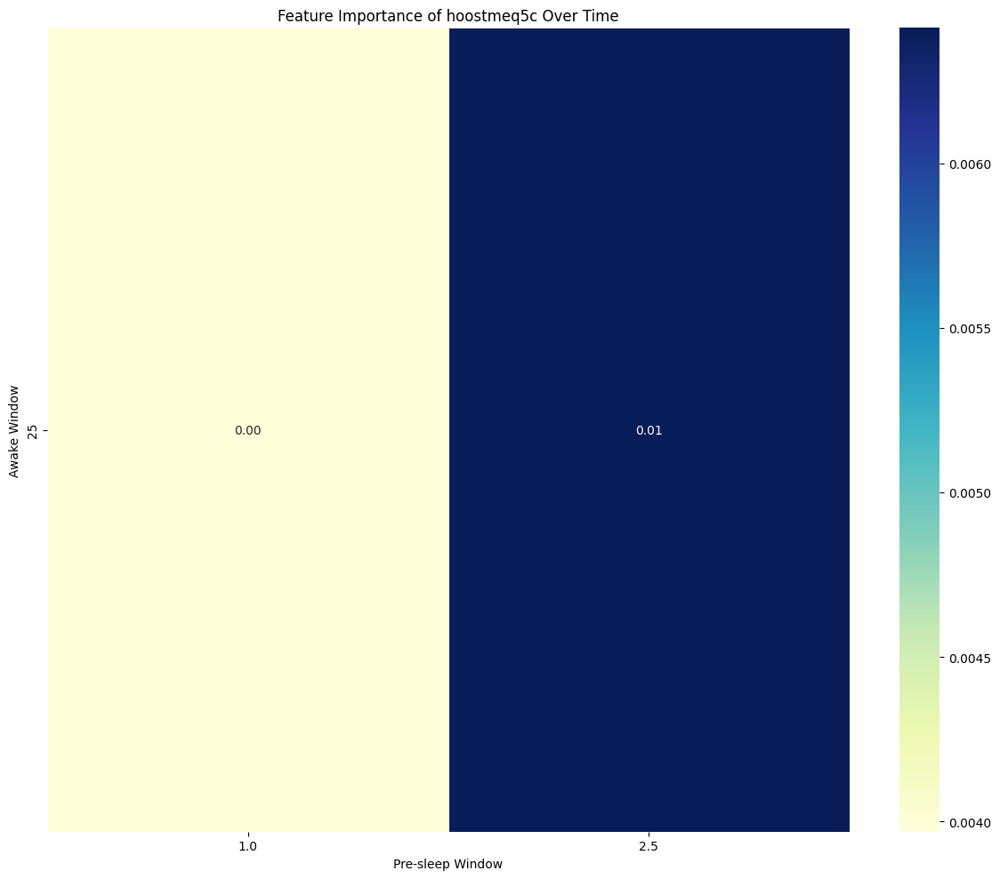

In [80]:
awake_windows_1 = [25]
awake_windows_25 = [25]
# create a dictionary of where pre_sleep_windows are the keys and awake_windows are the values
pre_sleep_awake_times = {1: awake_windows_1, 2.5: awake_windows_25}

classifier_type = 'brfc'

explore_classifier_sleep_probabilities(classifier_type, pre_sleep_awake_times, data_train, 
                                    output_path = 'Balanced_Random_Forest_check', ifsaveplots = True, ifplot = True, 
                                    selected_participant_data= select_data, selected_participants=selected_participants)

## Get the feature importances

In [97]:
windows = range(1, 31)
# create a dictionary of where pre_sleep_windows are the keys and awake_windows are the values
pre_sleep_awake_times = dict(zip(windows, windows))
print(pre_sleep_awake_times)

{1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8, 9: 9, 10: 10, 11: 11, 12: 12, 13: 13, 14: 14, 15: 15, 16: 16, 17: 17, 18: 18, 19: 19, 20: 20, 21: 21, 22: 22, 23: 23, 24: 24, 25: 25, 26: 26, 27: 27, 28: 28, 29: 29, 30: 30}


In [103]:
windows = range(1, 30)
# create a dictionary of where pre_sleep_windows are the keys and awake_windows are the values
pre_sleep_awake_times = {}
for i in windows:
    pre_sleep_awake_times[i] = [i]


classifier_type = 'brfc'

explore_classifier_sleep_probabilities(classifier_type, pre_sleep_awake_times, data_train, 
                                    output_path = 'Balanced_Random_Forest_Feature_analysis', ifsaveplots = True, ifplot = False, 
                                     selected_participant_data= select_data, selected_participants=selected_participants)



______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 1 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 1+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '1 minutes before sleep'
 '1 minutes before sleep' '1 minutes before sleep']
Accuracy: 0.8553835463073776
                        precision    recall  f1-score   support

1 minutes before sleep       0.19      0.80      0.31      1049
                 Awake       0.99      0.86      0.92     24854

              accuracy                           0.86     25903
             macro avg       0.59      0.83      0.61     25903
          weighted avg       0.96      0.86      0.89     25903

F1 pre-sleep:  0.9192463

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.48
Accuracy: -3.62 %.
Mean Squared Error: 120.37
Root Mean Squared Error: 10.97
R2: -0.58
Custom MSE: 14.47


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.42
Accuracy: 11.15 %.
Mean Squared Error: 197.74
Root Mean Squared Error: 14.06
R2: -1.5
Custom MSE: 10.88


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.75
Accuracy: 28.75 %.
Mean Squared Error: 83.37
Root Mean Squared Error: 9.13
R2: -0.17
Custom MSE: 7.6


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.65
Accuracy: 22.56 %.
Mean Squared Error: 89.85
Root Mean Squared Error: 9.48
R2: -0.31
Custom MSE: 8.05


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.41
Accuracy: -31.69 %.
Mean Squared Error: 120.0
Root Mean Squared Error: 10.95
R2: -0.67
Custom MSE: 14.93


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.83
Accuracy: 11.03 %.
Mean Squared Error: 177.58
Root Mean Squared Error: 13.33
R2: -1.28
Custom MSE: 9.53


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.14
Accuracy: -124.42 %.
Mean Squared Error: 140.82
Root Mean Squared Error: 11.87
R2: -0.75
Custom MSE: 41.74


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.7
Accuracy: 43.72 %.
Mean Squared Error: 111.8
Root Mean Squared Error: 10.57
R2: -0.45
Custom MSE: 5.81


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.99
Accuracy: 30.29 %.
Mean Squared Error: 89.85
Root Mean Squared Error: 9.48
R2: -0.2
Custom MSE: 8.81


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.6
Accuracy: 38.37 %.
Mean Squared Error: 76.68
Root Mean Squared Error: 8.76
R2: 0.04
Custom MSE: 5.55


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.19
Accuracy: -131.91 %.
Mean Squared Error: 185.2
Root Mean Squared Error: 13.61
R2: -1.44
Custom MSE: 45.94


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 2 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 2+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '2 minutes before sleep'
 '2 minutes before sleep' '2 minutes before sleep']
Accuracy: 0.7890439316108258
                        precision    recall  f1-score   support

2 minutes before sleep       0.23      0.73      0.35      2013
                 Awake       0.97      0.79      0.87     24073

              accuracy                           0.79     26086
             macro avg       0.60      0.76      0.61     26086
          weighted avg       0.91      0.79      0.83     26086

F1 pre-sleep:  0.8741567

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.6
Accuracy: -8.05 %.
Mean Squared Error: 122.96
Root Mean Squared Error: 11.09
R2: -0.61
Custom MSE: 14.61


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.0
Accuracy: -12.8 %.
Mean Squared Error: 208.29
Root Mean Squared Error: 14.43
R2: -1.64
Custom MSE: 15.41


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.94
Accuracy: 24.2 %.
Mean Squared Error: 88.29
Root Mean Squared Error: 9.4
R2: -0.24
Custom MSE: 8.04


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.29
Accuracy: 18.15 %.
Mean Squared Error: 124.98
Root Mean Squared Error: 11.18
R2: -0.83
Custom MSE: 8.26


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.99
Accuracy: -6.7 %.
Mean Squared Error: 111.0
Root Mean Squared Error: 10.54
R2: -0.55
Custom MSE: 9.14


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.23
Accuracy: 12.07 %.
Mean Squared Error: 217.69
Root Mean Squared Error: 14.75
R2: -1.8
Custom MSE: 10.57


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.8
Accuracy: -121.96 %.
Mean Squared Error: 132.42
Root Mean Squared Error: 11.51
R2: -0.65
Custom MSE: 47.74


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.49
Accuracy: 43.99 %.
Mean Squared Error: 106.49
Root Mean Squared Error: 10.32
R2: -0.38
Custom MSE: 5.55


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.06
Accuracy: 29.63 %.
Mean Squared Error: 89.95
Root Mean Squared Error: 9.48
R2: -0.21
Custom MSE: 8.54


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.88
Accuracy: 44.93 %.
Mean Squared Error: 63.9
Root Mean Squared Error: 7.99
R2: 0.2
Custom MSE: 3.83


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.97
Accuracy: -124.85 %.
Mean Squared Error: 180.58
Root Mean Squared Error: 13.44
R2: -1.38
Custom MSE: 40.09


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 3 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 3+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '3 minutes before sleep'
 '3 minutes before sleep' '3 minutes before sleep']
Accuracy: 0.723687308688486
                        precision    recall  f1-score   support

3 minutes before sleep       0.27      0.81      0.40      2941
                 Awake       0.97      0.71      0.82     22541

              accuracy                           0.72     25482
             macro avg       0.62      0.76      0.61     25482
          weighted avg       0.89      0.72      0.77     25482

F1 pre-sleep:  0.82012109

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.82
Accuracy: 10.55 %.
Mean Squared Error: 104.49
Root Mean Squared Error: 10.22
R2: -0.35
Custom MSE: 9.88


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.15
Accuracy: 21.21 %.
Mean Squared Error: 192.35
Root Mean Squared Error: 13.87
R2: -1.43
Custom MSE: 9.05


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.36
Accuracy: 14.34 %.
Mean Squared Error: 108.15
Root Mean Squared Error: 10.4
R2: -0.51
Custom MSE: 8.47


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.34
Accuracy: 8.62 %.
Mean Squared Error: 156.62
Root Mean Squared Error: 12.51
R2: -1.29
Custom MSE: 9.07


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.12
Accuracy: -14.98 %.
Mean Squared Error: 131.25
Root Mean Squared Error: 11.46
R2: -0.83
Custom MSE: 9.77


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.13
Accuracy: 7.97 %.
Mean Squared Error: 215.72
Root Mean Squared Error: 14.69
R2: -1.77
Custom MSE: 10.73


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.79
Accuracy: -119.59 %.
Mean Squared Error: 130.17
Root Mean Squared Error: 11.41
R2: -0.62
Custom MSE: 60.58


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.16
Accuracy: 39.39 %.
Mean Squared Error: 87.15
Root Mean Squared Error: 9.34
R2: -0.13
Custom MSE: 4.86


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.97
Accuracy: 37.41 %.
Mean Squared Error: 65.97
Root Mean Squared Error: 8.12
R2: 0.12
Custom MSE: 6.06


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.51
Accuracy: 31.94 %.
Mean Squared Error: 74.53
Root Mean Squared Error: 8.63
R2: 0.07
Custom MSE: 4.3


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.66
Accuracy: -113.04 %.
Mean Squared Error: 174.11
Root Mean Squared Error: 13.2
R2: -1.29
Custom MSE: 37.66


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 4 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 4+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '4 minutes before sleep'
 '4 minutes before sleep' '4 minutes before sleep']
Accuracy: 0.7177626780298668
                        precision    recall  f1-score   support

4 minutes before sleep       0.31      0.75      0.44      3824
                 Awake       0.94      0.71      0.81     22225

              accuracy                           0.72     26049
             macro avg       0.63      0.73      0.62     26049
          weighted avg       0.85      0.72      0.76     26049

F1 pre-sleep:  0.8116320

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.48
Accuracy: -8.88 %.
Mean Squared Error: 120.52
Root Mean Squared Error: 10.98
R2: -0.58
Custom MSE: 14.15


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.76
Accuracy: 16.17 %.
Mean Squared Error: 179.83
Root Mean Squared Error: 13.41
R2: -1.28
Custom MSE: 8.97


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.81
Accuracy: 18.06 %.
Mean Squared Error: 93.93
Root Mean Squared Error: 9.69
R2: -0.31
Custom MSE: 7.01


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.01
Accuracy: 1.82 %.
Mean Squared Error: 150.6
Root Mean Squared Error: 12.27
R2: -1.2
Custom MSE: 9.21


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.99
Accuracy: -11.09 %.
Mean Squared Error: 125.36
Root Mean Squared Error: 11.2
R2: -0.75
Custom MSE: 9.59


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.71
Accuracy: 3.44 %.
Mean Squared Error: 201.88
Root Mean Squared Error: 14.21
R2: -1.59
Custom MSE: 10.66


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.78
Accuracy: -120.22 %.
Mean Squared Error: 128.43
Root Mean Squared Error: 11.33
R2: -0.6
Custom MSE: 45.12


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.02
Accuracy: 31.24 %.
Mean Squared Error: 82.72
Root Mean Squared Error: 9.1
R2: -0.07
Custom MSE: 4.86


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.24
Accuracy: 20.38 %.
Mean Squared Error: 88.82
Root Mean Squared Error: 9.42
R2: -0.19
Custom MSE: 8.15


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.85
Accuracy: 27.91 %.
Mean Squared Error: 80.97
Root Mean Squared Error: 9.0
R2: -0.01
Custom MSE: 4.76


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.19
Accuracy: -106.52 %.
Mean Squared Error: 180.83
Root Mean Squared Error: 13.45
R2: -1.38
Custom MSE: 32.62


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 5 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 5+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '5 minutes before sleep'
 '5 minutes before sleep' '5 minutes before sleep']
Accuracy: 0.7554600237976433
                        precision    recall  f1-score   support

5 minutes before sleep       0.40      0.67      0.50      4709
                 Awake       0.91      0.77      0.84     21344

              accuracy                           0.76     26053
             macro avg       0.66      0.72      0.67     26053
          weighted avg       0.82      0.76      0.78     26053

F1 pre-sleep:  0.8383035

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.91
Accuracy: -16.02 %.
Mean Squared Error: 105.02
Root Mean Squared Error: 10.25
R2: -0.38
Custom MSE: 13.92


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.28
Accuracy: 13.15 %.
Mean Squared Error: 165.03
Root Mean Squared Error: 12.85
R2: -1.09
Custom MSE: 8.65


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.69
Accuracy: 23.18 %.
Mean Squared Error: 93.49
Root Mean Squared Error: 9.67
R2: -0.31
Custom MSE: 6.08


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.52
Accuracy: 8.75 %.
Mean Squared Error: 136.92
Root Mean Squared Error: 11.7
R2: -1.0
Custom MSE: 8.68


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.74
Accuracy: -22.48 %.
Mean Squared Error: 116.56
Root Mean Squared Error: 10.8
R2: -0.62
Custom MSE: 10.26


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.28
Accuracy: 1.14 %.
Mean Squared Error: 190.8
Root Mean Squared Error: 13.81
R2: -1.45
Custom MSE: 10.41


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.11
Accuracy: -117.44 %.
Mean Squared Error: 112.01
Root Mean Squared Error: 10.58
R2: -0.4
Custom MSE: 44.28


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.73
Accuracy: 26.54 %.
Mean Squared Error: 76.5
Root Mean Squared Error: 8.75
R2: 0.01
Custom MSE: 4.71


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.78
Accuracy: 21.49 %.
Mean Squared Error: 82.47
Root Mean Squared Error: 9.08
R2: -0.11
Custom MSE: 8.52


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.17
Accuracy: 19.4 %.
Mean Squared Error: 71.73
Root Mean Squared Error: 8.47
R2: 0.1
Custom MSE: 4.54


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.34
Accuracy: -117.7 %.
Mean Squared Error: 159.3
Root Mean Squared Error: 12.62
R2: -1.1
Custom MSE: 33.22


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 6 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 6+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '6 minutes before sleep'
 '6 minutes before sleep' '6 minutes before sleep']
Accuracy: 0.6959993857022192
                        precision    recall  f1-score   support

6 minutes before sleep       0.39      0.77      0.52      5575
                 Awake       0.91      0.68      0.78     20471

              accuracy                           0.70     26046
             macro avg       0.65      0.72      0.65     26046
          weighted avg       0.80      0.70      0.72     26046

F1 pre-sleep:  0.7777465

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.81
Accuracy: -5.25 %.
Mean Squared Error: 102.3
Root Mean Squared Error: 10.11
R2: -0.34
Custom MSE: 10.66


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.74
Accuracy: -2.92 %.
Mean Squared Error: 147.49
Root Mean Squared Error: 12.14
R2: -0.87
Custom MSE: 8.88


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.4
Accuracy: 19.98 %.
Mean Squared Error: 86.82
Root Mean Squared Error: 9.32
R2: -0.21
Custom MSE: 5.96


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.32
Accuracy: -17.82 %.
Mean Squared Error: 130.7
Root Mean Squared Error: 11.43
R2: -0.91
Custom MSE: 9.93


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.6
Accuracy: -30.27 %.
Mean Squared Error: 109.3
Root Mean Squared Error: 10.45
R2: -0.52
Custom MSE: 10.31


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.64
Accuracy: -1.06 %.
Mean Squared Error: 171.48
Root Mean Squared Error: 13.09
R2: -1.2
Custom MSE: 10.27


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.53
Accuracy: -72.88 %.
Mean Squared Error: 95.74
Root Mean Squared Error: 9.78
R2: -0.19
Custom MSE: 30.65


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.53
Accuracy: 26.77 %.
Mean Squared Error: 72.77
Root Mean Squared Error: 8.53
R2: 0.06
Custom MSE: 4.78


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.3
Accuracy: 11.28 %.
Mean Squared Error: 90.2
Root Mean Squared Error: 9.5
R2: -0.21
Custom MSE: 9.18


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.23
Accuracy: 20.85 %.
Mean Squared Error: 71.11
Root Mean Squared Error: 8.43
R2: 0.11
Custom MSE: 4.84


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.62
Accuracy: -99.41 %.
Mean Squared Error: 138.51
Root Mean Squared Error: 11.77
R2: -0.82
Custom MSE: 25.78


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 7 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 7+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '7 minutes before sleep'
 '7 minutes before sleep' '7 minutes before sleep']
Accuracy: 0.6792606055918635
                        precision    recall  f1-score   support

7 minutes before sleep       0.42      0.73      0.53      6451
                 Awake       0.88      0.66      0.76     19408

              accuracy                           0.68     25859
             macro avg       0.65      0.70      0.64     25859
          weighted avg       0.77      0.68      0.70     25859

F1 pre-sleep:  0.7559008

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.69
Accuracy: -13.83 %.
Mean Squared Error: 96.8
Root Mean Squared Error: 9.84
R2: -0.27
Custom MSE: 11.05


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.61
Accuracy: -12.26 %.
Mean Squared Error: 141.46
Root Mean Squared Error: 11.89
R2: -0.79
Custom MSE: 10.05


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.18
Accuracy: 18.79 %.
Mean Squared Error: 81.31
Root Mean Squared Error: 9.02
R2: -0.14
Custom MSE: 5.92


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.75
Accuracy: -19.35 %.
Mean Squared Error: 116.97
Root Mean Squared Error: 10.82
R2: -0.71
Custom MSE: 10.04


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.28
Accuracy: -39.92 %.
Mean Squared Error: 100.28
Root Mean Squared Error: 10.01
R2: -0.4
Custom MSE: 11.14


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.24
Accuracy: -8.46 %.
Mean Squared Error: 159.77
Root Mean Squared Error: 12.64
R2: -1.05
Custom MSE: 10.91


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.53
Accuracy: -102.03 %.
Mean Squared Error: 98.82
Root Mean Squared Error: 9.94
R2: -0.23
Custom MSE: 31.44


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.41
Accuracy: 4.99 %.
Mean Squared Error: 67.77
Root Mean Squared Error: 8.23
R2: 0.12
Custom MSE: 5.65


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.05
Accuracy: 25.05 %.
Mean Squared Error: 58.54
Root Mean Squared Error: 7.65
R2: 0.22
Custom MSE: 4.51


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.44
Accuracy: 12.89 %.
Mean Squared Error: 75.39
Root Mean Squared Error: 8.68
R2: 0.06
Custom MSE: 5.49


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.67
Accuracy: -111.42 %.
Mean Squared Error: 140.24
Root Mean Squared Error: 11.84
R2: -0.85
Custom MSE: 28.19


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 8 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 8+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '8 minutes before sleep'
 '8 minutes before sleep' '8 minutes before sleep']
Accuracy: 0.7057598086493576
                        precision    recall  f1-score   support

8 minutes before sleep       0.49      0.72      0.58      7330
                 Awake       0.86      0.70      0.77     18591

              accuracy                           0.71     25921
             macro avg       0.68      0.71      0.68     25921
          weighted avg       0.76      0.71      0.72     25921

F1 pre-sleep:  0.7732017

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.37
Accuracy: -22.08 %.
Mean Squared Error: 87.85
Root Mean Squared Error: 9.37
R2: -0.14
Custom MSE: 11.17


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.93
Accuracy: 3.1 %.
Mean Squared Error: 122.1
Root Mean Squared Error: 11.05
R2: -0.54
Custom MSE: 9.4


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.17
Accuracy: 16.44 %.
Mean Squared Error: 80.13
Root Mean Squared Error: 8.95
R2: -0.12
Custom MSE: 6.27


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.26
Accuracy: -23.19 %.
Mean Squared Error: 103.55
Root Mean Squared Error: 10.18
R2: -0.51
Custom MSE: 10.41


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.91
Accuracy: -50.78 %.
Mean Squared Error: 91.18
Root Mean Squared Error: 9.55
R2: -0.27
Custom MSE: 12.81


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.65
Accuracy: -16.13 %.
Mean Squared Error: 141.71
Root Mean Squared Error: 11.9
R2: -0.82
Custom MSE: 11.88


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.22
Accuracy: -89.7 %.
Mean Squared Error: 87.56
Root Mean Squared Error: 9.36
R2: -0.09
Custom MSE: 21.94


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.14
Accuracy: -6.11 %.
Mean Squared Error: 59.77
Root Mean Squared Error: 7.73
R2: 0.22
Custom MSE: 7.24


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.5
Accuracy: -5.23 %.
Mean Squared Error: 66.68
Root Mean Squared Error: 8.17
R2: 0.11
Custom MSE: 8.11


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.53
Accuracy: 2.9 %.
Mean Squared Error: 75.38
Root Mean Squared Error: 8.68
R2: 0.06
Custom MSE: 6.44


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.78
Accuracy: -100.85 %.
Mean Squared Error: 114.37
Root Mean Squared Error: 10.69
R2: -0.51
Custom MSE: 23.02


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 9 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 9+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '9 minutes before sleep'
 '9 minutes before sleep' '9 minutes before sleep']
Accuracy: 0.7092467194613413
                        precision    recall  f1-score   support

9 minutes before sleep       0.53      0.66      0.59      8180
                 Awake       0.83      0.73      0.78     17959

              accuracy                           0.71     26139
             macro avg       0.68      0.70      0.68     26139
          weighted avg       0.73      0.71      0.72     26139

F1 pre-sleep:  0.7754004

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.62
Accuracy: -42.23 %.
Mean Squared Error: 92.5
Root Mean Squared Error: 9.62
R2: -0.22
Custom MSE: 15.79


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.5
Accuracy: 1.72 %.
Mean Squared Error: 109.38
Root Mean Squared Error: 10.46
R2: -0.38
Custom MSE: 9.88


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.74
Accuracy: 7.37 %.
Mean Squared Error: 70.91
Root Mean Squared Error: 8.42
R2: 0.01
Custom MSE: 6.71


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.83
Accuracy: -36.71 %.
Mean Squared Error: 92.07
Root Mean Squared Error: 9.6
R2: -0.34
Custom MSE: 11.88


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.84
Accuracy: -60.05 %.
Mean Squared Error: 89.95
Root Mean Squared Error: 9.48
R2: -0.25
Custom MSE: 14.01


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.31
Accuracy: -24.48 %.
Mean Squared Error: 132.14
Root Mean Squared Error: 11.5
R2: -0.7
Custom MSE: 12.86


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.73
Accuracy: -103.32 %.
Mean Squared Error: 100.08
Root Mean Squared Error: 10.0
R2: -0.25
Custom MSE: 28.34


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.38
Accuracy: -16.34 %.
Mean Squared Error: 64.8
Root Mean Squared Error: 8.05
R2: 0.16
Custom MSE: 6.92


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.01
Accuracy: -4.72 %.
Mean Squared Error: 55.44
Root Mean Squared Error: 7.45
R2: 0.26
Custom MSE: 6.74


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.76
Accuracy: -4.31 %.
Mean Squared Error: 77.81
Root Mean Squared Error: 8.82
R2: 0.03
Custom MSE: 7.18


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.46
Accuracy: -112.85 %.
Mean Squared Error: 130.37
Root Mean Squared Error: 11.42
R2: -0.72
Custom MSE: 25.77


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 10 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 10+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '10 minutes before sleep'
 '10 minutes before sleep' '10 minutes before sleep']
Accuracy: 0.6724729171537682
                         precision    recall  f1-score   support

10 minutes before sleep       0.52      0.68      0.59      8967
                  Awake       0.80      0.67      0.73     16695

               accuracy                           0.67     25662
              macro avg       0.66      0.68      0.66     25662
           weighted avg       0.70      0.67      0.68     25662

F1 pre-sleep:

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.42
Accuracy: -39.72 %.
Mean Squared Error: 85.72
Root Mean Squared Error: 9.26
R2: -0.12
Custom MSE: 14.38


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.54
Accuracy: -41.04 %.
Mean Squared Error: 102.29
Root Mean Squared Error: 10.11
R2: -0.29
Custom MSE: 13.29


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.76
Accuracy: 5.66 %.
Mean Squared Error: 69.6
Root Mean Squared Error: 8.34
R2: 0.03
Custom MSE: 7.35


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.61
Accuracy: -16.08 %.
Mean Squared Error: 87.46
Root Mean Squared Error: 9.35
R2: -0.28
Custom MSE: 11.96


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.66
Accuracy: -77.13 %.
Mean Squared Error: 83.32
Root Mean Squared Error: 9.13
R2: -0.16
Custom MSE: 17.07


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.1
Accuracy: -35.99 %.
Mean Squared Error: 124.68
Root Mean Squared Error: 11.17
R2: -0.6
Custom MSE: 14.8


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.59
Accuracy: -112.84 %.
Mean Squared Error: 88.6
Root Mean Squared Error: 9.41
R2: -0.1
Custom MSE: 27.2


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.29
Accuracy: -1.05 %.
Mean Squared Error: 62.25
Root Mean Squared Error: 7.89
R2: 0.19
Custom MSE: 7.02


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.97
Accuracy: 24.49 %.
Mean Squared Error: 56.92
Root Mean Squared Error: 7.54
R2: 0.24
Custom MSE: 5.28


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.0
Accuracy: -14.4 %.
Mean Squared Error: 77.31
Root Mean Squared Error: 8.79
R2: 0.03
Custom MSE: 8.11


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.11
Accuracy: -119.96 %.
Mean Squared Error: 118.1
Root Mean Squared Error: 10.87
R2: -0.55
Custom MSE: 26.26


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 11 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 11+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '11 minutes before sleep'
 '11 minutes before sleep' '11 minutes before sleep']
Accuracy: 0.6896457871612427
                         precision    recall  f1-score   support

11 minutes before sleep       0.58      0.69      0.63      9781
                  Awake       0.78      0.69      0.73     15938

               accuracy                           0.69     25719
              macro avg       0.68      0.69      0.68     25719
           weighted avg       0.70      0.69      0.69     25719

F1 pre-sleep:

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.34
Accuracy: -54.23 %.
Mean Squared Error: 80.27
Root Mean Squared Error: 8.96
R2: -0.05
Custom MSE: 15.55


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.37
Accuracy: -65.37 %.
Mean Squared Error: 95.86
Root Mean Squared Error: 9.79
R2: -0.21
Custom MSE: 16.2


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.66
Accuracy: -13.49 %.
Mean Squared Error: 66.29
Root Mean Squared Error: 8.14
R2: 0.07
Custom MSE: 9.28


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.58
Accuracy: -43.04 %.
Mean Squared Error: 85.07
Root Mean Squared Error: 9.22
R2: -0.24
Custom MSE: 14.64


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.43
Accuracy: -85.99 %.
Mean Squared Error: 78.01
Root Mean Squared Error: 8.83
R2: -0.09
Custom MSE: 18.19


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.13
Accuracy: -43.0 %.
Mean Squared Error: 125.39
Root Mean Squared Error: 11.2
R2: -0.61
Custom MSE: 16.35


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.62
Accuracy: -132.6 %.
Mean Squared Error: 90.63
Root Mean Squared Error: 9.52
R2: -0.13
Custom MSE: 30.59


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.25
Accuracy: -33.66 %.
Mean Squared Error: 58.27
Root Mean Squared Error: 7.63
R2: 0.24
Custom MSE: 8.78


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.52
Accuracy: -21.43 %.
Mean Squared Error: 61.77
Root Mean Squared Error: 7.86
R2: 0.17
Custom MSE: 8.16


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.22
Accuracy: -33.28 %.
Mean Squared Error: 76.54
Root Mean Squared Error: 8.75
R2: 0.04
Custom MSE: 10.04


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.94
Accuracy: -125.78 %.
Mean Squared Error: 113.04
Root Mean Squared Error: 10.63
R2: -0.49
Custom MSE: 26.73


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 12 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 12+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '12 minutes before sleep'
 '12 minutes before sleep' '12 minutes before sleep']
Accuracy: 0.6953377143523739
                         precision    recall  f1-score   support

12 minutes before sleep       0.63      0.67      0.65     10803
                  Awake       0.75      0.71      0.73     14914

               accuracy                           0.70     25717
              macro avg       0.69      0.69      0.69     25717
           weighted avg       0.70      0.70      0.70     25717

F1 pre-sleep:

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.09
Accuracy: -49.58 %.
Mean Squared Error: 73.87
Root Mean Squared Error: 8.59
R2: 0.03
Custom MSE: 15.03


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.9
Accuracy: -57.53 %.
Mean Squared Error: 85.21
Root Mean Squared Error: 9.23
R2: -0.08
Custom MSE: 16.62


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.63
Accuracy: -17.8 %.
Mean Squared Error: 66.41
Root Mean Squared Error: 8.15
R2: 0.07
Custom MSE: 10.11


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.27
Accuracy: -68.39 %.
Mean Squared Error: 74.23
Root Mean Squared Error: 8.62
R2: -0.08
Custom MSE: 17.43


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.48
Accuracy: -106.22 %.
Mean Squared Error: 76.86
Root Mean Squared Error: 8.77
R2: -0.07
Custom MSE: 22.74


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.59
Accuracy: -64.74 %.
Mean Squared Error: 107.79
Root Mean Squared Error: 10.38
R2: -0.38
Custom MSE: 18.95


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.48
Accuracy: -113.72 %.
Mean Squared Error: 80.09
Root Mean Squared Error: 8.95
R2: 0.0
Custom MSE: 24.83


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.58
Accuracy: -58.95 %.
Mean Squared Error: 60.56
Root Mean Squared Error: 7.78
R2: 0.21
Custom MSE: 12.42


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.51
Accuracy: -5.79 %.
Mean Squared Error: 47.25
Root Mean Squared Error: 6.87
R2: 0.37
Custom MSE: 7.6


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.7
Accuracy: -19.32 %.
Mean Squared Error: 66.39
Root Mean Squared Error: 8.15
R2: 0.17
Custom MSE: 8.36


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.28
Accuracy: -134.16 %.
Mean Squared Error: 96.31
Root Mean Squared Error: 9.81
R2: -0.27
Custom MSE: 28.85


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 13 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 13+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '13 minutes before sleep'
 '13 minutes before sleep' '13 minutes before sleep']
Accuracy: 0.6986100386100386
                         precision    recall  f1-score   support

13 minutes before sleep       0.65      0.70      0.67     11543
                  Awake       0.74      0.70      0.72     14357

               accuracy                           0.70     25900
              macro avg       0.70      0.70      0.70     25900
           weighted avg       0.70      0.70      0.70     25900

F1 pre-sleep:

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.2
Accuracy: -59.15 %.
Mean Squared Error: 75.45
Root Mean Squared Error: 8.69
R2: 0.01
Custom MSE: 16.95


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.63
Accuracy: -33.57 %.
Mean Squared Error: 77.68
Root Mean Squared Error: 8.81
R2: 0.02
Custom MSE: 14.49


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.44
Accuracy: -25.57 %.
Mean Squared Error: 63.05
Root Mean Squared Error: 7.94
R2: 0.12
Custom MSE: 11.17


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.51
Accuracy: -102.2 %.
Mean Squared Error: 78.38
Root Mean Squared Error: 8.85
R2: -0.15
Custom MSE: 22.67


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.36
Accuracy: -115.96 %.
Mean Squared Error: 73.39
Root Mean Squared Error: 8.57
R2: -0.02
Custom MSE: 24.92


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.79
Accuracy: -66.67 %.
Mean Squared Error: 169.17
Root Mean Squared Error: 13.01
R2: -1.17
Custom MSE: 22.48


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.35
Accuracy: -137.77 %.
Mean Squared Error: 77.15
Root Mean Squared Error: 8.78
R2: 0.04
Custom MSE: 29.04


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.38
Accuracy: -41.61 %.
Mean Squared Error: 56.87
Root Mean Squared Error: 7.54
R2: 0.26
Custom MSE: 10.9


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.62
Accuracy: -49.8 %.
Mean Squared Error: 59.99
Root Mean Squared Error: 7.75
R2: 0.2
Custom MSE: 12.17


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.81
Accuracy: -33.34 %.
Mean Squared Error: 67.19
Root Mean Squared Error: 8.2
R2: 0.16
Custom MSE: 11.14


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.99
Accuracy: -139.94 %.
Mean Squared Error: 91.35
Root Mean Squared Error: 9.56
R2: -0.2
Custom MSE: 30.21


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 14 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 14+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '14 minutes before sleep'
 '14 minutes before sleep' '14 minutes before sleep']
Accuracy: 0.6894026092927443
                         precision    recall  f1-score   support

14 minutes before sleep       0.69      0.65      0.67     12559
                  Awake       0.69      0.73      0.71     13655

               accuracy                           0.69     26214
              macro avg       0.69      0.69      0.69     26214
           weighted avg       0.69      0.69      0.69     26214

F1 pre-sleep:

/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(av

[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 2

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.07
Accuracy: -73.37 %.
Mean Squared Error: 69.95
Root Mean Squared Error: 8.36
R2: 0.09
Custom MSE: 19.22


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.64
Accuracy: -106.85 %.
Mean Squared Error: 76.43
Root Mean Squared Error: 8.74
R2: 0.03
Custom MSE: 24.11


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.36
Accuracy: -29.98 %.
Mean Squared Error: 60.91
Root Mean Squared Error: 7.8
R2: 0.15
Custom MSE: 12.7


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.32
Accuracy: -100.02 %.
Mean Squared Error: 73.63
Root Mean Squared Error: 8.58
R2: -0.08
Custom MSE: 24.49


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.43
Accuracy: -134.02 %.
Mean Squared Error: 73.64
Root Mean Squared Error: 8.58
R2: -0.03
Custom MSE: 28.48


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.0
Accuracy: -97.38 %.
Mean Squared Error: 117.29
Root Mean Squared Error: 10.83
R2: -0.51
Custom MSE: 25.16


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.38
Accuracy: -141.62 %.
Mean Squared Error: 75.91
Root Mean Squared Error: 8.71
R2: 0.05
Custom MSE: 30.87


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.63
Accuracy: -38.34 %.
Mean Squared Error: 61.07
Root Mean Squared Error: 7.81
R2: 0.21
Custom MSE: 11.82


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.21
Accuracy: 8.03 %.
Mean Squared Error: 54.47
Root Mean Squared Error: 7.38
R2: 0.27
Custom MSE: 6.47


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.65
Accuracy: -38.55 %.
Mean Squared Error: 63.8
Root Mean Squared Error: 7.99
R2: 0.2
Custom MSE: 11.9


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.82
Accuracy: -149.02 %.
Mean Squared Error: 85.36
Root Mean Squared Error: 9.24
R2: -0.12
Custom MSE: 31.69


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 15 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 15+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '15 minutes before sleep'
 '15 minutes before sleep' '15 minutes before sleep']
Accuracy: 0.6774577116336159
                         precision    recall  f1-score   support

15 minutes before sleep       0.70      0.64      0.67     13309
                  Awake       0.65      0.72      0.69     12762

               accuracy                           0.68     26071
              macro avg       0.68      0.68      0.68     26071
           weighted avg       0.68      0.68      0.68     26071

F1 pre-sleep:

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.04
Accuracy: -70.72 %.
Mean Squared Error: 69.23
Root Mean Squared Error: 8.32
R2: 0.1
Custom MSE: 19.44


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.0
Accuracy: -39.38 %.
Mean Squared Error: 67.15
Root Mean Squared Error: 8.19
R2: 0.15
Custom MSE: 16.64


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.1
Accuracy: -25.44 %.
Mean Squared Error: 55.41
Root Mean Squared Error: 7.44
R2: 0.22
Custom MSE: 12.53


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.17
Accuracy: -133.19 %.
Mean Squared Error: 92.04
Root Mean Squared Error: 9.59
R2: -0.34
Custom MSE: 30.17


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.29
Accuracy: -145.71 %.
Mean Squared Error: 70.46
Root Mean Squared Error: 8.39
R2: 0.02
Custom MSE: 31.71


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.26
Accuracy: -86.79 %.
Mean Squared Error: 153.03
Root Mean Squared Error: 12.37
R2: -0.97
Custom MSE: 27.29


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.31
Accuracy: -150.25 %.
Mean Squared Error: 74.26
Root Mean Squared Error: 8.62
R2: 0.07
Custom MSE: 34.47


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.48
Accuracy: -50.53 %.
Mean Squared Error: 58.41
Root Mean Squared Error: 7.64
R2: 0.24
Custom MSE: 12.91


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.0
Accuracy: -8.37 %.
Mean Squared Error: 49.95
Root Mean Squared Error: 7.07
R2: 0.33
Custom MSE: 7.6


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.89
Accuracy: -61.96 %.
Mean Squared Error: 65.37
Root Mean Squared Error: 8.09
R2: 0.18
Custom MSE: 15.21


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.18
Accuracy: -160.21 %.
Mean Squared Error: 73.08
Root Mean Squared Error: 8.55
R2: 0.04
Custom MSE: 34.74


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 16 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 16+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '16 minutes before sleep'
 '16 minutes before sleep' '16 minutes before sleep']
Accuracy: 0.6629416282642089
                         precision    recall  f1-score   support

16 minutes before sleep       0.71      0.64      0.67     14165
                  Awake       0.62      0.69      0.65     11875

               accuracy                           0.66     26040
              macro avg       0.66      0.66      0.66     26040
           weighted avg       0.67      0.66      0.66     26040

F1 pre-sleep:

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.04
Accuracy: -62.51 %.
Mean Squared Error: 71.03
Root Mean Squared Error: 8.43
R2: 0.07
Custom MSE: 18.89


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.7
Accuracy: -39.46 %.
Mean Squared Error: 50.33
Root Mean Squared Error: 7.09
R2: 0.36
Custom MSE: 15.71


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.56
Accuracy: -42.32 %.
Mean Squared Error: 64.51
Root Mean Squared Error: 8.03
R2: 0.1
Custom MSE: 15.56


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.87
Accuracy: -96.58 %.
Mean Squared Error: 86.04
Root Mean Squared Error: 9.28
R2: -0.26
Custom MSE: 26.58


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.68
Accuracy: -162.82 %.
Mean Squared Error: 80.43
Root Mean Squared Error: 8.97
R2: -0.12
Custom MSE: 36.24


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.64
Accuracy: -100.72 %.
Mean Squared Error: 192.66
Root Mean Squared Error: 13.88
R2: -1.47
Custom MSE: 26.82


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.35
Accuracy: -174.01 %.
Mean Squared Error: 74.85
Root Mean Squared Error: 8.65
R2: 0.07
Custom MSE: 39.49


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.2
Accuracy: -39.83 %.
Mean Squared Error: 54.37
Root Mean Squared Error: 7.37
R2: 0.29
Custom MSE: 12.67


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.66
Accuracy: 20.13 %.
Mean Squared Error: 46.17
Root Mean Squared Error: 6.79
R2: 0.38
Custom MSE: 5.9


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.76
Accuracy: 12.7 %.
Mean Squared Error: 47.95
Root Mean Squared Error: 6.92
R2: 0.4
Custom MSE: 5.69


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.95
Accuracy: -178.16 %.
Mean Squared Error: 86.64
Root Mean Squared Error: 9.31
R2: -0.14
Custom MSE: 39.69


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 17 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 17+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '17 minutes before sleep'
 '17 minutes before sleep' '17 minutes before sleep']
Accuracy: 0.6700738216922203
                         precision    recall  f1-score   support

17 minutes before sleep       0.74      0.66      0.70     15185
                  Awake       0.60      0.68      0.64     11230

               accuracy                           0.67     26415
              macro avg       0.67      0.67      0.67     26415
           weighted avg       0.68      0.67      0.67     26415

F1 pre-sleep:

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.03
Accuracy: -72.66 %.
Mean Squared Error: 71.41
Root Mean Squared Error: 8.45
R2: 0.06
Custom MSE: 21.89


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.67
Accuracy: -0.41 %.
Mean Squared Error: 49.13
Root Mean Squared Error: 7.01
R2: 0.38
Custom MSE: 8.43


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.76
Accuracy: -35.4 %.
Mean Squared Error: 66.75
Root Mean Squared Error: 8.17
R2: 0.07
Custom MSE: 15.4


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.28
Accuracy: -139.96 %.
Mean Squared Error: 146.17
Root Mean Squared Error: 12.09
R2: -1.14
Custom MSE: 33.35


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.63
Accuracy: -178.46 %.
Mean Squared Error: 78.12
Root Mean Squared Error: 8.84
R2: -0.09
Custom MSE: 40.79


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 13.06
Accuracy: -91.3 %.
Mean Squared Error: 237.81
Root Mean Squared Error: 15.42
R2: -2.05
Custom MSE: 27.94


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.14
Accuracy: -176.77 %.
Mean Squared Error: 74.22
Root Mean Squared Error: 8.61
R2: 0.08
Custom MSE: 41.85


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.35
Accuracy: -17.1 %.
Mean Squared Error: 41.88
Root Mean Squared Error: 6.47
R2: 0.46
Custom MSE: 9.11


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.42
Accuracy: 26.99 %.
Mean Squared Error: 43.26
Root Mean Squared Error: 6.58
R2: 0.42
Custom MSE: 5.05


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.9
Accuracy: -25.72 %.
Mean Squared Error: 49.56
Root Mean Squared Error: 7.04
R2: 0.38
Custom MSE: 10.13


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.63
Accuracy: -188.51 %.
Mean Squared Error: 83.51
Root Mean Squared Error: 9.14
R2: -0.1
Custom MSE: 43.31


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 18 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 18+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '18 minutes before sleep'
 '18 minutes before sleep' '18 minutes before sleep']
Accuracy: 0.6616238988893144
                         precision    recall  f1-score   support

18 minutes before sleep       0.78      0.62      0.69     15954
                  Awake       0.55      0.73      0.63     10156

               accuracy                           0.66     26110
              macro avg       0.66      0.67      0.66     26110
           weighted avg       0.69      0.66      0.67     26110

F1 pre-sleep:

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.82
Accuracy: -66.18 %.
Mean Squared Error: 68.18
Root Mean Squared Error: 8.26
R2: 0.11
Custom MSE: 20.83


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.89
Accuracy: -63.59 %.
Mean Squared Error: 68.74
Root Mean Squared Error: 8.29
R2: 0.13
Custom MSE: 15.84


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.38
Accuracy: -37.88 %.
Mean Squared Error: 61.55
Root Mean Squared Error: 7.85
R2: 0.14
Custom MSE: 15.99


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.38
Accuracy: -124.35 %.
Mean Squared Error: 152.27
Root Mean Squared Error: 12.34
R2: -1.22
Custom MSE: 34.62


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.2
Accuracy: -196.47 %.
Mean Squared Error: 91.13
Root Mean Squared Error: 9.55
R2: -0.27
Custom MSE: 46.04


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 13.94
Accuracy: -80.63 %.
Mean Squared Error: 265.46
Root Mean Squared Error: 16.29
R2: -2.41
Custom MSE: 26.81


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.49
Accuracy: -180.96 %.
Mean Squared Error: 78.85
Root Mean Squared Error: 8.88
R2: 0.02
Custom MSE: 45.1


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.27
Accuracy: -35.9 %.
Mean Squared Error: 41.63
Root Mean Squared Error: 6.45
R2: 0.46
Custom MSE: 10.75


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.7
Accuracy: 2.1 %.
Mean Squared Error: 47.1
Root Mean Squared Error: 6.86
R2: 0.37
Custom MSE: 8.05


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.91
Accuracy: -16.24 %.
Mean Squared Error: 48.77
Root Mean Squared Error: 6.98
R2: 0.39
Custom MSE: 9.24


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.06
Accuracy: -209.73 %.
Mean Squared Error: 92.23
Root Mean Squared Error: 9.6
R2: -0.21
Custom MSE: 49.4


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 19 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 19+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '19 minutes before sleep'
 '19 minutes before sleep' '19 minutes before sleep']
Accuracy: 0.643373586647181
                         precision    recall  f1-score   support

19 minutes before sleep       0.79      0.61      0.69     16747
                  Awake       0.50      0.71      0.58      9255

               accuracy                           0.64     26002
              macro avg       0.64      0.66      0.64     26002
           weighted avg       0.69      0.64      0.65     26002

F1 pre-sleep: 

/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(av

[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 2

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.98
Accuracy: -64.19 %.
Mean Squared Error: 74.95
Root Mean Squared Error: 8.66
R2: 0.02
Custom MSE: 22.61


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 4.57
Accuracy: 29.63 %.
Mean Squared Error: 33.78
Root Mean Squared Error: 5.81
R2: 0.57
Custom MSE: 4.28


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.91
Accuracy: -43.12 %.
Mean Squared Error: 86.42
Root Mean Squared Error: 9.3
R2: -0.21
Custom MSE: 16.82


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.13
Accuracy: -135.51 %.
Mean Squared Error: 116.15
Root Mean Squared Error: 10.78
R2: -0.7
Custom MSE: 39.04


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.22
Accuracy: -211.98 %.
Mean Squared Error: 110.36
Root Mean Squared Error: 10.51
R2: -0.54
Custom MSE: 50.97


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 14.05
Accuracy: -74.12 %.
Mean Squared Error: 271.85
Root Mean Squared Error: 16.49
R2: -2.49
Custom MSE: 24.52


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.63
Accuracy: -197.14 %.
Mean Squared Error: 82.87
Root Mean Squared Error: 9.1
R2: -0.03
Custom MSE: 49.14


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.08
Accuracy: 4.69 %.
Mean Squared Error: 38.95
Root Mean Squared Error: 6.24
R2: 0.49
Custom MSE: 6.34


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.49
Accuracy: 25.25 %.
Mean Squared Error: 44.97
Root Mean Squared Error: 6.71
R2: 0.4
Custom MSE: 5.89


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 4.99
Accuracy: 10.09 %.
Mean Squared Error: 36.89
Root Mean Squared Error: 6.07
R2: 0.54
Custom MSE: 6.47


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.73
Accuracy: -217.03 %.
Mean Squared Error: 85.59
Root Mean Squared Error: 9.25
R2: -0.13
Custom MSE: 52.63


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 20 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 20+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '20 minutes before sleep'
 '20 minutes before sleep' '20 minutes before sleep']
Accuracy: 0.6430288461538461
                         precision    recall  f1-score   support

20 minutes before sleep       0.81      0.62      0.70     17398
                  Awake       0.47      0.70      0.56      8394

               accuracy                           0.64     25792
              macro avg       0.64      0.66      0.63     25792
           weighted avg       0.70      0.64      0.65     25792

F1 pre-sleep:

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.91
Accuracy: -59.39 %.
Mean Squared Error: 75.56
Root Mean Squared Error: 8.69
R2: 0.02
Custom MSE: 21.96


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 4.86
Accuracy: 45.43 %.
Mean Squared Error: 42.96
Root Mean Squared Error: 6.55
R2: 0.46
Custom MSE: 2.94


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.25
Accuracy: -52.84 %.
Mean Squared Error: 114.39
Root Mean Squared Error: 10.7
R2: -0.6
Custom MSE: 19.36


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.64
Accuracy: -136.22 %.
Mean Squared Error: 158.8
Root Mean Squared Error: 12.6
R2: -1.32
Custom MSE: 34.02


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.75
Accuracy: -203.59 %.
Mean Squared Error: 123.23
Root Mean Squared Error: 11.1
R2: -0.72
Custom MSE: 47.58


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 14.33
Accuracy: -73.5 %.
Mean Squared Error: 276.86
Root Mean Squared Error: 16.64
R2: -2.56
Custom MSE: 23.53


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.95
Accuracy: -194.28 %.
Mean Squared Error: 91.5
Root Mean Squared Error: 9.57
R2: -0.14
Custom MSE: 52.94


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 4.75
Accuracy: 31.8 %.
Mean Squared Error: 34.68
Root Mean Squared Error: 5.89
R2: 0.55
Custom MSE: 4.8


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.81
Accuracy: 11.21 %.
Mean Squared Error: 51.81
Root Mean Squared Error: 7.2
R2: 0.31
Custom MSE: 7.25


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.03
Accuracy: -4.09 %.
Mean Squared Error: 37.16
Root Mean Squared Error: 6.1
R2: 0.53
Custom MSE: 7.86


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.11
Accuracy: -235.65 %.
Mean Squared Error: 95.96
Root Mean Squared Error: 9.8
R2: -0.26
Custom MSE: 59.06


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 21 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 21+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '21 minutes before sleep'
 '21 minutes before sleep' '21 minutes before sleep']
Accuracy: 0.626090297790586
                         precision    recall  f1-score   support

21 minutes before sleep       0.83      0.60      0.69     18491
                  Awake       0.41      0.69      0.52      7534

               accuracy                           0.63     26025
              macro avg       0.62      0.65      0.61     26025
           weighted avg       0.71      0.63      0.64     26025

F1 pre-sleep: 

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.03
Accuracy: -55.43 %.
Mean Squared Error: 78.32
Root Mean Squared Error: 8.85
R2: -0.03
Custom MSE: 21.44


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.73
Accuracy: 50.1 %.
Mean Squared Error: 57.68
Root Mean Squared Error: 7.59
R2: 0.27
Custom MSE: 3.32


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.55
Accuracy: -58.82 %.
Mean Squared Error: 118.45
Root Mean Squared Error: 10.88
R2: -0.66
Custom MSE: 20.79


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.89
Accuracy: -100.16 %.
Mean Squared Error: 166.06
Root Mean Squared Error: 12.89
R2: -1.43
Custom MSE: 30.89


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.63
Accuracy: -243.41 %.
Mean Squared Error: 145.89
Root Mean Squared Error: 12.08
R2: -1.03
Custom MSE: 61.98


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 14.35
Accuracy: -77.15 %.
Mean Squared Error: 278.91
Root Mean Squared Error: 16.7
R2: -2.58
Custom MSE: 26.1


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.21
Accuracy: -204.0 %.
Mean Squared Error: 100.23
Root Mean Squared Error: 10.01
R2: -0.25
Custom MSE: 59.71


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.53
Accuracy: 23.82 %.
Mean Squared Error: 46.91
Root Mean Squared Error: 6.85
R2: 0.39
Custom MSE: 5.17


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.83
Accuracy: 24.72 %.
Mean Squared Error: 54.86
Root Mean Squared Error: 7.41
R2: 0.26
Custom MSE: 7.3


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.03
Accuracy: -3.44 %.
Mean Squared Error: 40.05
Root Mean Squared Error: 6.33
R2: 0.5
Custom MSE: 8.16


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.24
Accuracy: -255.81 %.
Mean Squared Error: 101.89
Root Mean Squared Error: 10.09
R2: -0.34
Custom MSE: 63.09


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 22 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 22+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '22 minutes before sleep'
 '22 minutes before sleep' '22 minutes before sleep']
Accuracy: 0.6156941649899397
                         precision    recall  f1-score   support

22 minutes before sleep       0.86      0.58      0.69     19235
                  Awake       0.37      0.72      0.49      6609

               accuracy                           0.62     25844
              macro avg       0.61      0.65      0.59     25844
           weighted avg       0.73      0.62      0.64     25844

F1 pre-sleep:

/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(av

[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 2

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.52
Accuracy: -66.29 %.
Mean Squared Error: 90.96
Root Mean Squared Error: 9.54
R2: -0.19
Custom MSE: 23.63


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.09
Accuracy: 47.02 %.
Mean Squared Error: 65.07
Root Mean Squared Error: 8.07
R2: 0.18
Custom MSE: 3.51


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.84
Accuracy: -62.02 %.
Mean Squared Error: 149.37
Root Mean Squared Error: 12.22
R2: -1.09
Custom MSE: 21.56


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.23
Accuracy: -84.79 %.
Mean Squared Error: 174.74
Root Mean Squared Error: 13.22
R2: -1.55
Custom MSE: 25.59


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.09
Accuracy: -189.21 %.
Mean Squared Error: 110.78
Root Mean Squared Error: 10.53
R2: -0.54
Custom MSE: 40.43


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 14.25
Accuracy: -46.04 %.
Mean Squared Error: 279.72
Root Mean Squared Error: 16.72
R2: -2.59
Custom MSE: 20.74


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.44
Accuracy: -214.65 %.
Mean Squared Error: 107.64
Root Mean Squared Error: 10.37
R2: -0.34
Custom MSE: 63.27


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.16
Accuracy: 31.44 %.
Mean Squared Error: 40.65
Root Mean Squared Error: 6.38
R2: 0.47
Custom MSE: 4.68


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.91
Accuracy: 29.91 %.
Mean Squared Error: 57.52
Root Mean Squared Error: 7.58
R2: 0.23
Custom MSE: 6.85


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 4.57
Accuracy: 38.2 %.
Mean Squared Error: 32.27
Root Mean Squared Error: 5.68
R2: 0.6
Custom MSE: 3.18


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.51
Accuracy: -264.99 %.
Mean Squared Error: 109.87
Root Mean Squared Error: 10.48
R2: -0.45
Custom MSE: 67.04


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 23 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 23+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '23 minutes before sleep'
 '23 minutes before sleep' '23 minutes before sleep']
Accuracy: 0.6050393946485685
                         precision    recall  f1-score   support

23 minutes before sleep       0.86      0.59      0.70     19851
                  Awake       0.32      0.67      0.43      5787

               accuracy                           0.61     25638
              macro avg       0.59      0.63      0.56     25638
           weighted avg       0.74      0.61      0.64     25638

F1 pre-sleep:

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.46
Accuracy: -54.86 %.
Mean Squared Error: 90.39
Root Mean Squared Error: 9.51
R2: -0.18
Custom MSE: 22.26


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.19
Accuracy: 44.91 %.
Mean Squared Error: 65.13
Root Mean Squared Error: 8.07
R2: 0.18
Custom MSE: 3.61


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.77
Accuracy: -45.7 %.
Mean Squared Error: 128.19
Root Mean Squared Error: 11.32
R2: -0.79
Custom MSE: 18.18


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.59
Accuracy: -81.86 %.
Mean Squared Error: 187.36
Root Mean Squared Error: 13.69
R2: -1.74
Custom MSE: 24.26


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.3
Accuracy: -217.71 %.
Mean Squared Error: 141.25
Root Mean Squared Error: 11.88
R2: -0.97
Custom MSE: 54.1


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 14.29
Accuracy: -32.67 %.
Mean Squared Error: 282.42
Root Mean Squared Error: 16.81
R2: -2.63
Custom MSE: 17.18


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.65
Accuracy: -206.91 %.
Mean Squared Error: 98.85
Root Mean Squared Error: 9.94
R2: -0.23
Custom MSE: 65.16


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.63
Accuracy: 35.45 %.
Mean Squared Error: 48.65
Root Mean Squared Error: 6.98
R2: 0.37
Custom MSE: 4.72


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.05
Accuracy: 26.5 %.
Mean Squared Error: 60.73
Root Mean Squared Error: 7.79
R2: 0.19
Custom MSE: 7.19


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 4.79
Accuracy: 38.79 %.
Mean Squared Error: 38.77
Root Mean Squared Error: 6.23
R2: 0.51
Custom MSE: 3.66


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.62
Accuracy: -255.55 %.
Mean Squared Error: 113.17
Root Mean Squared Error: 10.64
R2: -0.49
Custom MSE: 65.84


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 24 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 24+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '24 minutes before sleep'
 '24 minutes before sleep' '24 minutes before sleep']
Accuracy: 0.6137631265145979
                         precision    recall  f1-score   support

24 minutes before sleep       0.88      0.60      0.72     21027
                  Awake       0.28      0.67      0.40      4970

               accuracy                           0.61     25997
              macro avg       0.58      0.63      0.56     25997
           weighted avg       0.77      0.61      0.65     25997

F1 pre-sleep:

/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/Caskroom/miniforge/base/envs/myenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(av

[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 27.2, 27.7, 28.2, 28.7, 29.2, 29.7, 30.0]
[0.2, 0.7, 1.2, 1.7, 2.2, 2.7, 3.2, 3.7, 4.2, 4.7, 5.2, 5.7, 6.2, 6.7, 7.2, 7.7, 8.2, 8.7, 9.2, 9.7, 10.2, 10.7, 11.2, 11.7, 12.2, 12.7, 13.2, 13.7, 14.2, 14.7, 15.2, 15.7, 16.2, 16.7, 17.2, 17.7, 18.2, 18.7, 19.2, 19.7, 20.2, 20.7, 21.2, 21.7, 22.2, 22.7, 23.2, 23.7, 24.2, 24.7, 25.2, 25.7, 26.2, 26.7, 2

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.76
Accuracy: -45.73 %.
Mean Squared Error: 98.82
Root Mean Squared Error: 9.94
R2: -0.3
Custom MSE: 21.02


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.03
Accuracy: 36.23 %.
Mean Squared Error: 88.24
Root Mean Squared Error: 9.39
R2: -0.12
Custom MSE: 4.89


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.48
Accuracy: -50.45 %.
Mean Squared Error: 145.98
Root Mean Squared Error: 12.08
R2: -1.04
Custom MSE: 19.14


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.68
Accuracy: -95.28 %.
Mean Squared Error: 185.74
Root Mean Squared Error: 13.63
R2: -1.71
Custom MSE: 31.69


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.29
Accuracy: -153.88 %.
Mean Squared Error: 122.47
Root Mean Squared Error: 11.07
R2: -0.71
Custom MSE: 37.65


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 14.34
Accuracy: -34.35 %.
Mean Squared Error: 282.84
Root Mean Squared Error: 16.82
R2: -2.63
Custom MSE: 16.7


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.56
Accuracy: -200.12 %.
Mean Squared Error: 117.09
Root Mean Squared Error: 10.82
R2: -0.46
Custom MSE: 67.82


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.89
Accuracy: 35.6 %.
Mean Squared Error: 53.39
Root Mean Squared Error: 7.31
R2: 0.31
Custom MSE: 5.29


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.27
Accuracy: 26.76 %.
Mean Squared Error: 67.92
Root Mean Squared Error: 8.24
R2: 0.09
Custom MSE: 7.81


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 4.72
Accuracy: 44.06 %.
Mean Squared Error: 35.58
Root Mean Squared Error: 5.97
R2: 0.55
Custom MSE: 3.15


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.44
Accuracy: -280.63 %.
Mean Squared Error: 135.36
Root Mean Squared Error: 11.63
R2: -0.78
Custom MSE: 64.45


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 25 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 25+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '25 minutes before sleep'
 '25 minutes before sleep' '25 minutes before sleep']
Accuracy: 0.6241628514132204
                         precision    recall  f1-score   support

25 minutes before sleep       0.91      0.61      0.73     22168
                  Awake       0.25      0.69      0.37      4261

               accuracy                           0.62     26429
              macro avg       0.58      0.65      0.55     26429
           weighted avg       0.81      0.62      0.67     26429

F1 pre-sleep:

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.77
Accuracy: -46.49 %.
Mean Squared Error: 100.05
Root Mean Squared Error: 10.0
R2: -0.31
Custom MSE: 21.87


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.97
Accuracy: 37.32 %.
Mean Squared Error: 135.16
Root Mean Squared Error: 11.63
R2: -0.71
Custom MSE: 6.58


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.22
Accuracy: -37.84 %.
Mean Squared Error: 116.23
Root Mean Squared Error: 10.78
R2: -0.63
Custom MSE: 15.65


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.53
Accuracy: -107.16 %.
Mean Squared Error: 217.59
Root Mean Squared Error: 14.75
R2: -2.18
Custom MSE: 33.62


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.09
Accuracy: -166.31 %.
Mean Squared Error: 167.57
Root Mean Squared Error: 12.94
R2: -1.33
Custom MSE: 43.15


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 14.28
Accuracy: -41.07 %.
Mean Squared Error: 282.72
Root Mean Squared Error: 16.81
R2: -2.63
Custom MSE: 16.28


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.56
Accuracy: -220.19 %.
Mean Squared Error: 121.84
Root Mean Squared Error: 11.04
R2: -0.52
Custom MSE: 74.7


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.86
Accuracy: 39.56 %.
Mean Squared Error: 53.45
Root Mean Squared Error: 7.31
R2: 0.31
Custom MSE: 4.48


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.49
Accuracy: 13.52 %.
Mean Squared Error: 70.59
Root Mean Squared Error: 8.4
R2: 0.05
Custom MSE: 8.76


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.02
Accuracy: 46.68 %.
Mean Squared Error: 42.05
Root Mean Squared Error: 6.48
R2: 0.47
Custom MSE: 3.45


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.52
Accuracy: -277.55 %.
Mean Squared Error: 135.53
Root Mean Squared Error: 11.64
R2: -0.78
Custom MSE: 67.65


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 26 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 26+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '26 minutes before sleep'
 '26 minutes before sleep' '26 minutes before sleep']
Accuracy: 0.5749381953028431
                         precision    recall  f1-score   support

26 minutes before sleep       0.93      0.55      0.69     22570
                  Awake       0.19      0.73      0.31      3318

               accuracy                           0.57     25888
              macro avg       0.56      0.64      0.50     25888
           weighted avg       0.84      0.57      0.64     25888

F1 pre-sleep:

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.89
Accuracy: -53.45 %.
Mean Squared Error: 103.12
Root Mean Squared Error: 10.15
R2: -0.35
Custom MSE: 23.8


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.48
Accuracy: 36.79 %.
Mean Squared Error: 98.03
Root Mean Squared Error: 9.9
R2: -0.24
Custom MSE: 5.01


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.75
Accuracy: -43.4 %.
Mean Squared Error: 130.68
Root Mean Squared Error: 11.43
R2: -0.83
Custom MSE: 17.99


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.94
Accuracy: -73.38 %.
Mean Squared Error: 198.1
Root Mean Squared Error: 14.07
R2: -1.89
Custom MSE: 23.94


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.15
Accuracy: -116.77 %.
Mean Squared Error: 151.91
Root Mean Squared Error: 12.33
R2: -1.12
Custom MSE: 27.06


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 14.43
Accuracy: -32.21 %.
Mean Squared Error: 285.17
Root Mean Squared Error: 16.89
R2: -2.66
Custom MSE: 17.78


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.18
Accuracy: -202.7 %.
Mean Squared Error: 133.8
Root Mean Squared Error: 11.57
R2: -0.67
Custom MSE: 75.7


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.05
Accuracy: 39.56 %.
Mean Squared Error: 56.72
Root Mean Squared Error: 7.53
R2: 0.26
Custom MSE: 4.83


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.92
Accuracy: 20.82 %.
Mean Squared Error: 81.96
Root Mean Squared Error: 9.05
R2: -0.1
Custom MSE: 8.98


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 5.57
Accuracy: 47.47 %.
Mean Squared Error: 48.43
Root Mean Squared Error: 6.96
R2: 0.39
Custom MSE: 3.61


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.26
Accuracy: -296.31 %.
Mean Squared Error: 155.81
Root Mean Squared Error: 12.48
R2: -1.05
Custom MSE: 76.96


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 27 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 27+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '27 minutes before sleep'
 '27 minutes before sleep' '27 minutes before sleep']
Accuracy: 0.592468264073774
                         precision    recall  f1-score   support

27 minutes before sleep       0.94      0.58      0.72     23506
                  Awake       0.14      0.67      0.23      2411

               accuracy                           0.59     25917
              macro avg       0.54      0.63      0.48     25917
           weighted avg       0.87      0.59      0.68     25917

F1 pre-sleep: 

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.49
Accuracy: -73.12 %.
Mean Squared Error: 117.51
Root Mean Squared Error: 10.84
R2: -0.54
Custom MSE: 28.05


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.25
Accuracy: 34.91 %.
Mean Squared Error: 138.65
Root Mean Squared Error: 11.78
R2: -0.75
Custom MSE: 6.82


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.89
Accuracy: -40.97 %.
Mean Squared Error: 137.91
Root Mean Squared Error: 11.74
R2: -0.93
Custom MSE: 18.15


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.56
Accuracy: -64.82 %.
Mean Squared Error: 219.01
Root Mean Squared Error: 14.8
R2: -2.2
Custom MSE: 22.86


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.33
Accuracy: -134.33 %.
Mean Squared Error: 154.95
Root Mean Squared Error: 12.45
R2: -1.16
Custom MSE: 31.64


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 14.18
Accuracy: -5.44 %.
Mean Squared Error: 282.63
Root Mean Squared Error: 16.81
R2: -2.63
Custom MSE: 13.97


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.0
Accuracy: -217.85 %.
Mean Squared Error: 134.76
Root Mean Squared Error: 11.61
R2: -0.68
Custom MSE: 81.42


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.58
Accuracy: 36.97 %.
Mean Squared Error: 65.28
Root Mean Squared Error: 8.08
R2: 0.15
Custom MSE: 5.22


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.51
Accuracy: 14.14 %.
Mean Squared Error: 95.22
Root Mean Squared Error: 9.76
R2: -0.28
Custom MSE: 10.26


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.22
Accuracy: 46.55 %.
Mean Squared Error: 63.22
Root Mean Squared Error: 7.95
R2: 0.21
Custom MSE: 3.92


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.69
Accuracy: -271.66 %.
Mean Squared Error: 164.9
Root Mean Squared Error: 12.84
R2: -1.17
Custom MSE: 66.13


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 28 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 28+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '28 minutes before sleep'
 '28 minutes before sleep' '28 minutes before sleep']
Accuracy: 0.6217616580310881
                         precision    recall  f1-score   support

28 minutes before sleep       0.96      0.62      0.76     24090
                  Awake       0.10      0.61      0.17      1579

               accuracy                           0.62     25669
              macro avg       0.53      0.62      0.46     25669
           weighted avg       0.91      0.62      0.72     25669

F1 pre-sleep:

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.51
Accuracy: -36.73 %.
Mean Squared Error: 118.23
Root Mean Squared Error: 10.87
R2: -0.55
Custom MSE: 21.13


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.52
Accuracy: 33.47 %.
Mean Squared Error: 144.36
Root Mean Squared Error: 12.01
R2: -0.83
Custom MSE: 7.04


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.55
Accuracy: -19.59 %.
Mean Squared Error: 129.5
Root Mean Squared Error: 11.38
R2: -0.81
Custom MSE: 14.38


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.41
Accuracy: -56.72 %.
Mean Squared Error: 214.0
Root Mean Squared Error: 14.63
R2: -2.13
Custom MSE: 19.98


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.83
Accuracy: -44.12 %.
Mean Squared Error: 151.92
Root Mean Squared Error: 12.33
R2: -1.12
Custom MSE: 18.1


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 14.44
Accuracy: 4.09 %.
Mean Squared Error: 287.69
Root Mean Squared Error: 16.96
R2: -2.7
Custom MSE: 14.22


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.02
Accuracy: -166.95 %.
Mean Squared Error: 131.68
Root Mean Squared Error: 11.48
R2: -0.64
Custom MSE: 68.28


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.87
Accuracy: 36.17 %.
Mean Squared Error: 72.01
Root Mean Squared Error: 8.49
R2: 0.07
Custom MSE: 5.59


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.49
Accuracy: 18.1 %.
Mean Squared Error: 95.57
Root Mean Squared Error: 9.78
R2: -0.28
Custom MSE: 10.13


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.47
Accuracy: 34.3 %.
Mean Squared Error: 69.99
Root Mean Squared Error: 8.37
R2: 0.12
Custom MSE: 4.86


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.29
Accuracy: -259.58 %.
Mean Squared Error: 159.18
Root Mean Squared Error: 12.62
R2: -1.1
Custom MSE: 69.68


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 29 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 29+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' '29 minutes before sleep' ... '29 minutes before sleep'
 '29 minutes before sleep' '29 minutes before sleep']
Accuracy: 0.6212321831918374
                         precision    recall  f1-score   support

29 minutes before sleep       0.98      0.62      0.76     24944
                  Awake       0.05      0.66      0.09       734

               accuracy                           0.62     25678
              macro avg       0.52      0.64      0.43     25678
           weighted avg       0.96      0.62      0.74     25

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 8.7
Accuracy: -27.41 %.
Mean Squared Error: 123.65
Root Mean Squared Error: 11.12
R2: -0.62
Custom MSE: 18.34


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.36
Accuracy: 36.56 %.
Mean Squared Error: 140.31
Root Mean Squared Error: 11.85
R2: -0.78
Custom MSE: 7.48


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.78
Accuracy: -44.74 %.
Mean Squared Error: 158.39
Root Mean Squared Error: 12.59
R2: -1.22
Custom MSE: 19.4


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 12.95
Accuracy: -93.11 %.
Mean Squared Error: 233.37
Root Mean Squared Error: 15.28
R2: -2.41
Custom MSE: 32.36


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 11.57
Accuracy: -204.85 %.
Mean Squared Error: 185.08
Root Mean Squared Error: 13.6
R2: -1.58
Custom MSE: 50.11


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 14.26
Accuracy: -0.09 %.
Mean Squared Error: 284.29
Root Mean Squared Error: 16.86
R2: -2.65
Custom MSE: 14.12


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 9.52
Accuracy: -156.95 %.
Mean Squared Error: 140.44
Root Mean Squared Error: 11.85
R2: -0.75
Custom MSE: 72.86


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.9
Accuracy: 36.96 %.
Mean Squared Error: 72.65
Root Mean Squared Error: 8.52
R2: 0.06
Custom MSE: 5.38


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 7.96
Accuracy: 15.33 %.
Mean Squared Error: 102.9
Root Mean Squared Error: 10.14
R2: -0.38
Custom MSE: 10.57


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 6.46
Accuracy: 37.67 %.
Mean Squared Error: 63.84
Root Mean Squared Error: 7.99
R2: 0.2
Custom MSE: 4.73


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


Mean Absolute Error: 10.99
Accuracy: -269.66 %.
Mean Squared Error: 174.62
Root Mean Squared Error: 13.21
R2: -1.3
Custom MSE: 69.87


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:132: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1, color='red')
/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_933/3954028740.py:153: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1, color='red')


int64


## Try on clean onset data

In [113]:
data_train_clean_onset = pd.read_csv('data_train_clean_onset.csv')

In [121]:
windows = range(1, 30)
# create a dictionary of where pre_sleep_windows are the keys and awake_windows are the values
pre_sleep_awake_times = {}
for i in windows:
    pre_sleep_awake_times[i] = [i]


classifier_type = 'brfc'

explore_classifier_sleep_probabilities(classifier_type, pre_sleep_awake_times, data_train_clean_onset, 
                                    output_path = 'Balanced_Random_Forest_Feature_analysis_clean_onset', ifsaveplots = True, ifplot = False)



______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 1 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 1+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '1 minutes before sleep'
 '1 minutes before sleep' '1 minutes before sleep']
Accuracy: 0.8648465007103588
                        precision    recall  f1-score   support

1 minutes before sleep       0.20      0.80      0.33       663
                 Awake       0.99      0.87      0.92     15526

              accuracy                           0.86     16189
             macro avg       0.60      0.83      0.63     16189
          weighted avg       0.96      0.86      0.90     16189

Now trying only on the u

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 2 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 2+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '2 minutes before sleep'
 '2 minutes before sleep' '2 minutes before sleep']
Accuracy: 0.811498644318462
                        precision    recall  f1-score   support

2 minutes before sleep       0.26      0.78      0.39      1258
                 Awake       0.98      0.81      0.89     14970

              accuracy                           0.81     16228
             macro avg       0.62      0.80      0.64     16228
          weighted avg       0.92      0.81      0.85     16228

Now trying only on the un

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 3 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 3+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '3 minutes before sleep'
 '3 minutes before sleep' '3 minutes before sleep']
Accuracy: 0.7257440932801473
                        precision    recall  f1-score   support

3 minutes before sleep       0.25      0.72      0.37      1844
                 Awake       0.95      0.73      0.82     14451

              accuracy                           0.73     16295
             macro avg       0.60      0.72      0.60     16295
          weighted avg       0.87      0.73      0.77     16295

Now trying only on the u

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 4 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 4+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '4 minutes before sleep'
 '4 minutes before sleep' '4 minutes before sleep']
Accuracy: 0.743128435782109
                        precision    recall  f1-score   support

4 minutes before sleep       0.34      0.76      0.47      2391
                 Awake       0.95      0.74      0.83     13617

              accuracy                           0.74     16008
             macro avg       0.64      0.75      0.65     16008
          weighted avg       0.86      0.74      0.78     16008

Now trying only on the un

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 5 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 5+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '5 minutes before sleep'
 '5 minutes before sleep' '5 minutes before sleep']
Accuracy: 0.7222740561049947
                        precision    recall  f1-score   support

5 minutes before sleep       0.37      0.72      0.49      2971
                 Awake       0.92      0.72      0.81     13106

              accuracy                           0.72     16077
             macro avg       0.65      0.72      0.65     16077
          weighted avg       0.82      0.72      0.75     16077

Now trying only on the u

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 6 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 6+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '6 minutes before sleep'
 '6 minutes before sleep' '6 minutes before sleep']
Accuracy: 0.6819209039548022
                        precision    recall  f1-score   support

6 minutes before sleep       0.38      0.74      0.50      3468
                 Awake       0.90      0.67      0.77     12462

              accuracy                           0.68     15930
             macro avg       0.64      0.70      0.63     15930
          weighted avg       0.79      0.68      0.71     15930

Now trying only on the u

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 7 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 7+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '7 minutes before sleep'
 '7 minutes before sleep' '7 minutes before sleep']
Accuracy: 0.7138509316770186
                        precision    recall  f1-score   support

7 minutes before sleep       0.45      0.71      0.55      3996
                 Awake       0.88      0.71      0.79     12104

              accuracy                           0.71     16100
             macro avg       0.67      0.71      0.67     16100
          weighted avg       0.78      0.71      0.73     16100

Now trying only on the u

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 8 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 8+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '8 minutes before sleep'
 '8 minutes before sleep' '8 minutes before sleep']
Accuracy: 0.681823883592574
                        precision    recall  f1-score   support

8 minutes before sleep       0.46      0.73      0.56      4479
                 Awake       0.86      0.66      0.75     11465

              accuracy                           0.68     15944
             macro avg       0.66      0.70      0.66     15944
          weighted avg       0.75      0.68      0.70     15944

Now trying only on the un

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 9 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 9+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '9 minutes before sleep'
 '9 minutes before sleep' '9 minutes before sleep']
Accuracy: 0.6827218063566082
                        precision    recall  f1-score   support

9 minutes before sleep       0.49      0.69      0.57      5057
                 Awake       0.83      0.68      0.75     11241

              accuracy                           0.68     16298
             macro avg       0.66      0.68      0.66     16298
          weighted avg       0.72      0.68      0.69     16298

Now trying only on the u

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 10 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 10+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '10 minutes before sleep'
 '10 minutes before sleep' '10 minutes before sleep']
Accuracy: 0.7024414736709973
                         precision    recall  f1-score   support

10 minutes before sleep       0.55      0.73      0.63      5518
                  Awake       0.83      0.69      0.75     10415

               accuracy                           0.70     15933
              macro avg       0.69      0.71      0.69     15933
           weighted avg       0.73      0.70      0.71     15933

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 11 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 11+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '11 minutes before sleep'
 '11 minutes before sleep' '11 minutes before sleep']
Accuracy: 0.709018928615613
                         precision    recall  f1-score   support

11 minutes before sleep       0.60      0.72      0.65      6115
                  Awake       0.81      0.70      0.75     10051

               accuracy                           0.71     16166
              macro avg       0.70      0.71      0.70     16166
           weighted avg       0.73      0.71      0.71     16166

Now trying onl

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 12 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 12+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '12 minutes before sleep'
 '12 minutes before sleep' '12 minutes before sleep']
Accuracy: 0.6701062400781537
                         precision    recall  f1-score   support

12 minutes before sleep       0.58      0.66      0.62      6588
                  Awake       0.75      0.67      0.71      9790

               accuracy                           0.67     16378
              macro avg       0.66      0.67      0.66     16378
           weighted avg       0.68      0.67      0.67     16378

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 13 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 13+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '13 minutes before sleep'
 '13 minutes before sleep' '13 minutes before sleep']
Accuracy: 0.707606024324154
                         precision    recall  f1-score   support

13 minutes before sleep       0.67      0.68      0.67      7078
                  Awake       0.74      0.73      0.73      8791

               accuracy                           0.71     15869
              macro avg       0.70      0.70      0.70     15869
           weighted avg       0.71      0.71      0.71     15869

Now trying onl

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 14 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 14+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '14 minutes before sleep'
 '14 minutes before sleep' '14 minutes before sleep']
Accuracy: 0.6885469661248294
                         precision    recall  f1-score   support

14 minutes before sleep       0.66      0.71      0.69      7659
                  Awake       0.72      0.67      0.69      8459

               accuracy                           0.69     16118
              macro avg       0.69      0.69      0.69     16118
           weighted avg       0.69      0.69      0.69     16118

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 15 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 15+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '15 minutes before sleep'
 '15 minutes before sleep' '15 minutes before sleep']
Accuracy: 0.6812699206299606
                         precision    recall  f1-score   support

15 minutes before sleep       0.71      0.64      0.67      8142
                  Awake       0.66      0.72      0.69      7859

               accuracy                           0.68     16001
              macro avg       0.68      0.68      0.68     16001
           weighted avg       0.68      0.68      0.68     16001

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 16 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 16+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '16 minutes before sleep'
 '16 minutes before sleep' '16 minutes before sleep']
Accuracy: 0.6933902990701181
                         precision    recall  f1-score   support

16 minutes before sleep       0.75      0.66      0.70      8666
                  Awake       0.64      0.74      0.69      7250

               accuracy                           0.69     15916
              macro avg       0.70      0.70      0.69     15916
           weighted avg       0.70      0.69      0.69     15916

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 17 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 17+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '17 minutes before sleep'
 '17 minutes before sleep' '17 minutes before sleep']
Accuracy: 0.686053007262119
                         precision    recall  f1-score   support

17 minutes before sleep       0.75      0.67      0.71      9203
                  Awake       0.62      0.71      0.66      6908

               accuracy                           0.69     16111
              macro avg       0.69      0.69      0.68     16111
           weighted avg       0.70      0.69      0.69     16111

Now trying onl

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 18 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 18+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '18 minutes before sleep'
 '18 minutes before sleep' '18 minutes before sleep']
Accuracy: 0.6779766731117071
                         precision    recall  f1-score   support

18 minutes before sleep       0.78      0.66      0.71      9768
                  Awake       0.57      0.70      0.63      6265

               accuracy                           0.68     16033
              macro avg       0.67      0.68      0.67     16033
           weighted avg       0.70      0.68      0.68     16033

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 19 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 19+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '19 minutes before sleep'
 '19 minutes before sleep' '19 minutes before sleep']
Accuracy: 0.6730117661553625
                         precision    recall  f1-score   support

19 minutes before sleep       0.78      0.68      0.73     10413
                  Awake       0.54      0.67      0.59      5820

               accuracy                           0.67     16233
              macro avg       0.66      0.67      0.66     16233
           weighted avg       0.70      0.67      0.68     16233

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 20 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 20+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '20 minutes before sleep'
 '20 minutes before sleep' '20 minutes before sleep']
Accuracy: 0.6560243963156585
                         precision    recall  f1-score   support

20 minutes before sleep       0.82      0.63      0.71     10877
                  Awake       0.48      0.71      0.57      5191

               accuracy                           0.66     16068
              macro avg       0.65      0.67      0.64     16068
           weighted avg       0.71      0.66      0.67     16068

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 21 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 21+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '21 minutes before sleep'
 '21 minutes before sleep' '21 minutes before sleep']
Accuracy: 0.6277132761231701
                         precision    recall  f1-score   support

21 minutes before sleep       0.84      0.58      0.69     11191
                  Awake       0.42      0.74      0.54      4657

               accuracy                           0.63     15848
              macro avg       0.63      0.66      0.61     15848
           weighted avg       0.72      0.63      0.64     15848

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 22 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 22+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '22 minutes before sleep'
 '22 minutes before sleep' '22 minutes before sleep']
Accuracy: 0.6601680040120361
                         precision    recall  f1-score   support

22 minutes before sleep       0.84      0.67      0.74     11792
                  Awake       0.40      0.63      0.49      4160

               accuracy                           0.66     15952
              macro avg       0.62      0.65      0.62     15952
           weighted avg       0.72      0.66      0.68     15952

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 23 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 23+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '23 minutes before sleep'
 '23 minutes before sleep' '23 minutes before sleep']
Accuracy: 0.5959320352226218
                         precision    recall  f1-score   support

23 minutes before sleep       0.84      0.58      0.69     12376
                  Awake       0.32      0.63      0.42      3750

               accuracy                           0.60     16126
              macro avg       0.58      0.61      0.56     16126
           weighted avg       0.72      0.60      0.63     16126

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 24 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 24+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '24 minutes before sleep'
 '24 minutes before sleep' '24 minutes before sleep']
Accuracy: 0.6156477668672791
                         precision    recall  f1-score   support

24 minutes before sleep       0.89      0.60      0.72     12753
                  Awake       0.29      0.67      0.40      3032

               accuracy                           0.62     15785
              macro avg       0.59      0.64      0.56     15785
           weighted avg       0.77      0.62      0.66     15785

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 25 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 25+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '25 minutes before sleep'
 '25 minutes before sleep' '25 minutes before sleep']
Accuracy: 0.6028422310255926
                         precision    recall  f1-score   support

25 minutes before sleep       0.91      0.59      0.71     13289
                  Awake       0.25      0.69      0.36      2614

               accuracy                           0.60     15903
              macro avg       0.58      0.64      0.54     15903
           weighted avg       0.80      0.60      0.65     15903

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 26 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 26+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '26 minutes before sleep'
 '26 minutes before sleep' '26 minutes before sleep']
Accuracy: 0.6077984555006963
                         precision    recall  f1-score   support

26 minutes before sleep       0.92      0.60      0.73     13757
                  Awake       0.19      0.63      0.29      2041

               accuracy                           0.61     15798
              macro avg       0.55      0.62      0.51     15798
           weighted avg       0.82      0.61      0.67     15798

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 27 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 27+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '27 minutes before sleep'
 '27 minutes before sleep' '27 minutes before sleep']
Accuracy: 0.6231296758104738
                         precision    recall  f1-score   support

27 minutes before sleep       0.95      0.61      0.75     14497
                  Awake       0.16      0.71      0.27      1543

               accuracy                           0.62     16040
              macro avg       0.56      0.66      0.51     16040
           weighted avg       0.88      0.62      0.70     16040

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 28 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 28+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '28 minutes before sleep'
 '28 minutes before sleep' '28 minutes before sleep']
Accuracy: 0.6203533308796466
                         precision    recall  f1-score   support

28 minutes before sleep       0.96      0.62      0.75     15281
                  Awake       0.09      0.57      0.16      1021

               accuracy                           0.62     16302
              macro avg       0.52      0.60      0.46     16302
           weighted avg       0.90      0.62      0.72     16302

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]




______________________________________________________________________________________________________________
                                    PRE-SLEEP WINDOW: 29 minutes                                   
______________________________________________________________________________________________________________


--------------------------------------- AWAKE-WINDOW: 29+ minutes ------------------------------------------------


Predictions: ['Awake' 'Awake' 'Awake' ... '29 minutes before sleep'
 '29 minutes before sleep' '29 minutes before sleep']
Accuracy: 0.5890272422729284
                         precision    recall  f1-score   support

29 minutes before sleep       0.98      0.59      0.73     15351
                  Awake       0.05      0.69      0.09       470

               accuracy                           0.59     15821
              macro avg       0.52      0.64      0.41     15821
           weighted avg       0.96      0.59      0.72     15821

Now trying on

/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


Probability of sleep as predicted by the model


/var/folders/4z/0d9t18bj63v8jxhgj_4bvm0r0000gn/T/ipykernel_33994/3571353021.py:34: RuntimeWarning: Mean of empty slice
  return [np.nanmean(data[i:i+window_for_averaging]) for i in range(0, len(data), window_for_averaging)]


int64
